## Deep learning model for HAR with LSTM

In [4]:
# Importing Dependencies
import os
import numpy as np
import pandas as pd
from matplotlib import pyplot
from sklearn.preprocessing import StandardScaler
from keras.models import Sequential
from keras.layers import Flatten, Dropout, Dense, LSTM
from keras.layers.core import Dense, Dropout
from keras.layers.convolutional import Conv1D, MaxPooling1D
from keras.utils import to_categorical

In [5]:
# Activities are the class labels
# It is a 6 class classification
ACTIVITIES = {
    0: 'WALKING',
    1: 'WALKING_UPSTAIRS',
    2: 'WALKING_DOWNSTAIRS',
    3: 'SITTING',
    4: 'STANDING',
    5: 'LAYING',
}

# Utility function to print the confusion matrix
def confusion_matrix(Y_true, Y_pred):
    Y_true = pd.Series([ACTIVITIES[y] for y in np.argmax(Y_true, axis=1)])
    Y_pred = pd.Series([ACTIVITIES[y] for y in np.argmax(Y_pred, axis=1)])

    return pd.crosstab(Y_true, Y_pred, rownames=['True'], colnames=['Pred'])

In [6]:
# Data directory
DATADIR= os.path.join(os.getcwd(), 'datasets', 'UCI_HAR_Dataset')
# Signals are from Accelerometer and Gyroscope
# The signals are in x,y,z directions
SIGNALS = ["body_acc_x", "body_acc_y", "body_acc_z",
    "body_gyro_x", "body_gyro_y", "body_gyro_z",
    "total_acc_x", "total_acc_y", "total_acc_z"]

In [7]:
# Utility function to load the load
def load_signals(subset):
    signals_data = []

    for signal in SIGNALS:
        filename= DATADIR + f'/UCI_HAR_Dataset/{subset}/Inertial Signals/{signal}_{subset}.txt'
        signals_data.append(pd.read_csv(filename, delim_whitespace=True, header=None).values) 
    # Resultant shape is (7352 train/2947 test samples, 128 timesteps, 9 signals)
    return np.transpose(signals_data, (1, 2, 0))

In [8]:
def load_y(subset):
    filename= DATADIR + f'/UCI_HAR_Dataset/{subset}/y_{subset}.txt'
    y = pd.read_csv(filename, delim_whitespace=True, header=None)[0]
    return pd.get_dummies(y).values

In [9]:
def load_data():
    X_train, X_test = load_signals('train'), load_signals('test')
    y_train, y_test = load_y('train'), load_y('test')
    return X_train, y_train, X_test,  y_test

In [10]:
# setting up seed for random values
np.random.seed(42)
tf.random.set_seed(42)

In [11]:
# Utility function to count the number of classes
def _count_classes(y):
    return len(set([tuple(category) for category in y]))

In [12]:
# Loading the train and test data
X_train, Y_train, X_test,  Y_test = load_data()

In [13]:
timesteps = len(X_train[0])
input_dim = len(X_train[0][0])
n_classes = _count_classes(Y_train)
#n_classes  = 6
print(timesteps)
print(input_dim)
print(len(X_train))

128
9
7352


### Base model

In [11]:
# Initiliazing the sequential model
base_model = Sequential()
# Configuring the parameters
base_model.add(LSTM(32, input_shape=(timesteps, input_dim)))
# Adding a dropout layer
base_model.add(Dropout(0.5))
# Adding a dense output layer with sigmoid activation
base_model.add(Dense(n_classes, activation='sigmoid'))
base_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 32)                5376      
                                                                 
 dropout (Dropout)           (None, 32)                0         
                                                                 
 dense (Dense)               (None, 6)                 198       
                                                                 
Total params: 5,574
Trainable params: 5,574
Non-trainable params: 0
_________________________________________________________________


In [12]:
# Compiling the model
base_model.compile(loss='categorical_crossentropy',
              optimizer='rmsprop',
              metrics=['accuracy'])

# Training the model
History= base_model.fit(X_train,
          Y_train,
          batch_size=batch_size,
          validation_data=(X_test, Y_test),
          epochs=epochs)

Epoch 1/30
460/460 [==============================] - 24s 48ms/step - loss: 1.1404 - accuracy: 0.5177 - val_loss: 0.8758 - val_accuracy: 0.6474
Epoch 2/30
460/460 [==============================] - 21s 46ms/step - loss: 0.7674 - accuracy: 0.6586 - val_loss: 0.8386 - val_accuracy: 0.6668
Epoch 3/30
460/460 [==============================] - 20s 43ms/step - loss: 0.6343 - accuracy: 0.7301 - val_loss: 0.7868 - val_accuracy: 0.7258
Epoch 4/30
460/460 [==============================] - 21s 45ms/step - loss: 0.5645 - accuracy: 0.7609 - val_loss: 0.7133 - val_accuracy: 0.7655
Epoch 5/30
460/460 [==============================] - 20s 45ms/step - loss: 0.4947 - accuracy: 0.8171 - val_loss: 0.6515 - val_accuracy: 0.7910
Epoch 6/30
460/460 [==============================] - 20s 44ms/step - loss: 0.3652 - accuracy: 0.8832 - val_loss: 0.5446 - val_accuracy: 0.8490
Epoch 7/30
460/460 [==============================] - 18s 40ms/step - loss: 0.3007 - accuracy: 0.9055 - val_loss: 0.5842 - val_accuracy:

### Multi-layer LSTM

In [13]:
# Initiliazing the sequential model
lstm_model = Sequential()
# Configuring the parameters
lstm_model.add(LSTM(32,return_sequences=True,input_shape=(timesteps, input_dim)))
# Adding a dropout layer
lstm_model.add(Dropout(0.5))

lstm_model.add(LSTM(28,input_shape=(timesteps, input_dim)))
# Adding a dropout layer
lstm_model.add(Dropout(0.6))
# Adding a dense output layer with sigmoid activation
lstm_model.add(Dense(n_classes, activation='sigmoid'))
lstm_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_1 (LSTM)               (None, 128, 32)           5376      
                                                                 
 dropout_1 (Dropout)         (None, 128, 32)           0         
                                                                 
 lstm_2 (LSTM)               (None, 28)                6832      
                                                                 
 dropout_2 (Dropout)         (None, 28)                0         
                                                                 
 dense_1 (Dense)             (None, 6)                 174       
                                                                 
Total params: 12,382
Trainable params: 12,382
Non-trainable params: 0
_________________________________________________________________


In [14]:
# Compiling the model
lstm_model.compile(loss='categorical_crossentropy',
              optimizer='rmsprop',
              metrics=['accuracy'])

# Training the model
lstm_History= lstm_model.fit(X_train,
          Y_train,
          batch_size=batch_size,
          validation_data=(X_test, Y_test),
          epochs=epochs)

Epoch 1/30
460/460 [==============================] - 51s 100ms/step - loss: 1.0686 - accuracy: 0.5528 - val_loss: 0.7842 - val_accuracy: 0.7156
Epoch 2/30
460/460 [==============================] - 44s 97ms/step - loss: 0.5728 - accuracy: 0.7964 - val_loss: 0.5645 - val_accuracy: 0.8229
Epoch 3/30
460/460 [==============================] - 43s 94ms/step - loss: 0.3620 - accuracy: 0.8940 - val_loss: 0.5029 - val_accuracy: 0.8561
Epoch 4/30
460/460 [==============================] - 43s 93ms/step - loss: 0.2801 - accuracy: 0.9199 - val_loss: 0.4397 - val_accuracy: 0.8812
Epoch 5/30
460/460 [==============================] - 45s 97ms/step - loss: 0.2364 - accuracy: 0.9237 - val_loss: 0.4825 - val_accuracy: 0.8748
Epoch 6/30
460/460 [==============================] - 44s 97ms/step - loss: 0.2496 - accuracy: 0.9280 - val_loss: 0.4723 - val_accuracy: 0.8955
Epoch 7/30
460/460 [==============================] - 47s 101ms/step - loss: 0.1981 - accuracy: 0.9350 - val_loss: 0.7089 - val_accurac

### Regularized multi-layer LSTM

In [15]:
from keras.regularizers import l2

# Initiliazing the sequential model
reg_lstm_model = Sequential()
# Configuring the parameters
reg_lstm_model.add(LSTM(32,recurrent_regularizer=l2(0.003),return_sequences=True,input_shape=(timesteps, input_dim)))
# Adding a dropout layer
reg_lstm_model.add(Dropout(0.5))

reg_lstm_model.add(LSTM(28,input_shape=(timesteps, input_dim)))
# Adding a dropout layer
reg_lstm_model.add(Dropout(0.6))
# Adding a dense output layer with sigmoid activation
reg_lstm_model.add(Dense(n_classes, activation='sigmoid'))
reg_lstm_model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_3 (LSTM)               (None, 128, 32)           5376      
                                                                 
 dropout_3 (Dropout)         (None, 128, 32)           0         
                                                                 
 lstm_4 (LSTM)               (None, 28)                6832      
                                                                 
 dropout_4 (Dropout)         (None, 28)                0         
                                                                 
 dense_2 (Dense)             (None, 6)                 174       
                                                                 
Total params: 12,382
Trainable params: 12,382
Non-trainable params: 0
_________________________________________________________________


In [16]:
# Compiling the model
reg_lstm_model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

# Training the model
reg_lstm_History= reg_lstm_model.fit(X_train,
          Y_train,
          batch_size=batch_size,
          validation_data=(X_test, Y_test),
          epochs=10)

Epoch 1/10
460/460 [==============================] - 50s 99ms/step - loss: 1.1262 - accuracy: 0.5388 - val_loss: 0.8020 - val_accuracy: 0.6773
Epoch 2/10
460/460 [==============================] - 44s 96ms/step - loss: 0.7413 - accuracy: 0.7255 - val_loss: 0.5844 - val_accuracy: 0.8161
Epoch 3/10
460/460 [==============================] - 44s 96ms/step - loss: 0.6966 - accuracy: 0.7410 - val_loss: 0.7460 - val_accuracy: 0.7099
Epoch 4/10
460/460 [==============================] - 44s 96ms/step - loss: 0.5451 - accuracy: 0.8124 - val_loss: 0.6068 - val_accuracy: 0.8208
Epoch 5/10
460/460 [==============================] - 44s 96ms/step - loss: 0.4505 - accuracy: 0.8803 - val_loss: 0.7271 - val_accuracy: 0.7788
Epoch 6/10
460/460 [==============================] - 44s 96ms/step - loss: 0.3878 - accuracy: 0.8959 - val_loss: 0.4554 - val_accuracy: 0.8517
Epoch 7/10
460/460 [==============================] - 44s 96ms/step - loss: 0.3637 - accuracy: 0.9095 - val_loss: 0.5468 - val_accuracy:

## Hyperparameter Tuning Using Hyperas

In [71]:
import pandas as pd
import numpy as np
import os

import tensorflow as tf
from keras.models import Sequential, load_model
from keras.layers import Dropout, Dense, LSTM
from keras.regularizers import L2
from keras.callbacks import EarlyStopping, CSVLogger, ModelCheckpoint, ReduceLROnPlateau

from hyperopt import hp, fmin, tpe, STATUS_OK, Trials
from hyperas.utils import eval_hyperopt_space 

In [15]:
np.random.seed(36)
tf.random.set_seed(36)

In [16]:
# Loading the train and test data
X_train, X_test = load_signals('train'), load_signals('test')
y_train, y_test = load_y('train'), load_y('test')  # one-hot encoding(y value)

In [17]:
space= {
    'epochs': hp.choice('epochs', np.arange(10, 30, 5, dtype=int)),
    'batch_size': hp.choice('batch_size', np.array([np.power(2, i) for i in range(3,7)], dtype=int)),
    'n_hidden': hp.choice('n_hidden', np.flip(np.array(sorted([np.power(2, i) for i in range(6,8)]), dtype=int))),
    'dropout': hp.choice('dropout', np.array([0.5, 0.4, 0.3], dtype=float)),
    'activation': hp.choice('activation', ['relu', 'selu', 'leaky_relu'])
    }


args= {
    'timesteps': X_train.shape[1],
    'input_dim': X_train.shape[2],
    'n_classes': _count_classes(y_train)
}

In [18]:
def objective(space):
    model = Sequential()
    # Configuring the parameters
    model.add(LSTM(int(space['n_hidden']), return_sequences=True, activation= space['activation'],\
        recurrent_regularizer= L2(0.003), input_shape=(args['timesteps'], args['input_dim'])))
    model.add(Dropout(space['dropout']))
    
    model.add(LSTM(int(space['n_hidden']/2), return_sequences=True\
        , activation= space['activation']))
    model.add(Dropout(space['dropout']))

    model.add(LSTM(int(space['n_hidden']/2), return_sequences=False\
        , activation= space['activation']))
    model.add(Dropout(space['dropout']))

    model.add(Dense(args['n_classes'], activation='sigmoid'))
    model.summary()

    # Compiling the model
    model.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])
    
    es= EarlyStopping(monitor= 'loss', mode= 'min', verbose= 1, patience= 15)
    csvlogger= CSVLogger('src/log/log_lstm.log')

    history= model.fit(X_train, y_train,
                    validation_data= (X_test, y_test),
                    validation_split= 0.2,
                    batch_size= space['batch_size'],
                    epochs= space['epochs'], 
                    verbose= 1,
                    callbacks= [es, csvlogger])
    loss= np.amin(history.history['loss'])
    print('Best loss of epoch:', loss)
#     validation_loss= np.amin(history.history['val_loss'])
#     print('Best validation loss of epoch:', validation_loss)
    return {'loss': loss, 'status' : STATUS_OK, 'model':model, 'params': space}

In [19]:
trials= Trials()
best= fmin(fn= objective,
        space= space,
        algo= tpe.suggest,
        max_evals= 20,
        trials= trials)

Model: "sequential"                                                                                                                                                                                                                                                              

_________________________________________________________________                                                                                                                                                                                                                

 Layer (type)                Output Shape              Param #                                                                                                                                                                                                                   


 lstm (LSTM)                 (None, 128, 64)           18944                                                                                                                  

 41/230 [====>.........................] - ETA: 31s - loss: 2.3665 - accuracy: 0.2965                                                                                                                                                                                            


 70/230 [========>.....................] - ETA: 26s - loss: 2.1220 - accuracy: 0.3357                                                                                                                                                                                            


 99/230 [===========>..................] - ETA: 21s - loss: 134309.9219 - accuracy: 0.3516                                                                                                                                                                                      


129/230 [===============>..............] - ETA: 17s - loss: 103075.5234 - accuracy: 0.3619                                                                                                                                                                                      


158/230 [===================>..........] - ETA: 12s - loss: 84156.9688 - accuracy: 0.3659                                                                                                                                                                                        


187/230 [=======================>......] - ETA: 7s - loss: 71106.1953 - accuracy: 0.3718                                                                                                                                                                                        


216/230 [===========================>..] - ETA: 2s - loss: 46166292.0000 - accuracy: 0.3694                                                                                                                                                                                      


230/230 [==============================] - 50s 197ms/step - loss: 43403348.0000 - accuracy: 0.3677 - val_loss: 1.8252 - val_accuracy: 0.3244                                                                                                                                     

Epoch 2/10                                                                                                                                                                                                                                                                       

 13/230 [>.............................] - ETA: 35s - loss: 1.8184 - accuracy: 0.3678                                                                                                                                                                                            


 42/230 [====>.........................] - ETA: 31s - loss: 1.8224 - accuracy: 0.3452                                                                                                                                                                                            


 71/230 [========>.....................] - ETA: 27s - loss: 1.8224 - accuracy: 0.3468                                                                                                                                                                                            


100/230 [============>.................] - ETA: 22s - loss: 1.8213 - accuracy: 0.3528                                                                                                                                                                                            


129/230 [===============>..............] - ETA: 17s - loss: 1.8214 - accuracy: 0.3510                                                                                                                                                                                            


158/230 [===================>..........] - ETA: 12s - loss: 1.8215 - accuracy: 0.3544                                                                                                                                                                                            


187/230 [=======================>......] - ETA: 7s - loss: 1.8204 - accuracy: 0.3588                                                                                                                                                                                            


217/230 [===========================>..] - ETA: 2s - loss: 1.8199 - accuracy: 0.3603                                                                                                                                                                                            


230/230 [==============================] - 45s 194ms/step - loss: 1.8196 - accuracy: 0.3611 - val_loss: 1.8149 - val_accuracy: 0.3583                                                                                                                                           

Epoch 3/10                                                                                                                                                                                                                                                                       

 14/230 [>.............................] - ETA: 50s - loss: 1.8047 - accuracy: 0.4219                                                                                                                                                                                            


 43/230 [====>.........................] - ETA: 1:03 - loss: 1.8075 - accuracy: 0.4019                                                                                                                                                                                          


 73/230 [========>.....................] - ETA: 1:00 - loss: 1.8065 - accuracy: 0.3934                                                                                                                                                                                          


102/230 [============>.................] - ETA: 47s - loss: 1.8063 - accuracy: 0.3894                                                                                                                                                                                            


131/230 [================>.............] - ETA: 34s - loss: 1.8062 - accuracy: 0.3874                                                                                                                                                                                            


160/230 [===================>..........] - ETA: 22s - loss: 1.8058 - accuracy: 0.3867                                                                                                                                                                                            


189/230 [=======================>......] - ETA: 12s - loss: 1.8057 - accuracy: 0.3819                                                                                                                                                                                            


218/230 [===========================>..] - ETA: 3s - loss: 1.8044 - accuracy: 0.3823                                                                                                                                                                                            


230/230 [==============================] - 75s 326ms/step - loss: 1.8040 - accuracy: 0.3830 - val_loss: 1.8031 - val_accuracy: 0.3675                                                                                                                                           

Epoch 4/10                                                                                                                                                                                                                                                                       

 15/230 [>.............................] - ETA: 42s - loss: 1.7937 - accuracy: 0.3896                                                                                                                                                                                            


 44/230 [====>.........................] - ETA: 35s - loss: 1.7925 - accuracy: 0.3928                                                                                                                                                                                            


 73/230 [========>.....................] - ETA: 29s - loss: 1.7935 - accuracy: 0.3878                                                                                                                                                                                            


102/230 [============>.................] - ETA: 24s - loss: 1.7919 - accuracy: 0.3833                                                                                                                                                                                            


131/230 [================>.............] - ETA: 18s - loss: 1.7930 - accuracy: 0.3800                                                                                                                                                                                            


160/230 [===================>..........] - ETA: 12s - loss: 1.7932 - accuracy: 0.3771                                                                                                                                                                                            


189/230 [=======================>......] - ETA: 7s - loss: 1.7920 - accuracy: 0.3788                                                                                                                                                                                            


219/230 [===========================>..] - ETA: 2s - loss: 1.7912 - accuracy: 0.3799                                                                                                                                                                                            


230/230 [==============================] - 48s 208ms/step - loss: 1.7908 - accuracy: 0.3792 - val_loss: 1.7890 - val_accuracy: 0.3658                                                                                                                                           

Epoch 5/10                                                                                                                                                                                                                                                                       

 16/230 [=>............................] - ETA: 1:01 - loss: 1.7691 - accuracy: 0.4062                                                                                                                                                                                          


 45/230 [====>.........................] - ETA: 58s - loss: 1.7791 - accuracy: 0.3806                                                                                                                                                                                            


 74/230 [========>.....................] - ETA: 48s - loss: 1.7763 - accuracy: 0.3860                                                                                                                                                                                            


103/230 [============>.................] - ETA: 39s - loss: 1.7768 - accuracy: 0.3835                                                                                                                                                                                            


132/230 [================>.............] - ETA: 28s - loss: 1.7742 - accuracy: 0.3857                                                                                                                                                                                            


161/230 [====================>.........] - ETA: 19s - loss: 1.7752 - accuracy: 0.3797                                                                                                                                                                                            


190/230 [=======================>......] - ETA: 10s - loss: 1.7750 - accuracy: 0.3783                                                                                                                                                                                            


219/230 [===========================>..] - ETA: 2s - loss: 1.7746 - accuracy: 0.3760                                                                                                                                                                                            


230/230 [==============================] - 65s 282ms/step - loss: 1.7736 - accuracy: 0.3751 - val_loss: 1.7702 - val_accuracy: 0.3661                                                                                                                                           

Epoch 6/10                                                                                                                                                                                                                                                                       

 16/230 [=>............................] - ETA: 39s - loss: 1.7613 - accuracy: 0.3594                                                                                                                                                                                            


 45/230 [====>.........................] - ETA: 34s - loss: 1.7575 - accuracy: 0.3812                                                                                                                                                                                            


 74/230 [========>.....................] - ETA: 28s - loss: 1.7561 - accuracy: 0.3944                                                                                                                                                                                            


103/230 [============>.................] - ETA: 23s - loss: 1.7584 - accuracy: 0.3890                                                                                                                                                                                            


132/230 [================>.............] - ETA: 18s - loss: 1.7559 - accuracy: 0.3897                                                                                                                                                                                            


161/230 [====================>.........] - ETA: 12s - loss: 1.7527 - accuracy: 0.3907                                                                                                                                                                                            


190/230 [=======================>......] - ETA: 7s - loss: 1.7492 - accuracy: 0.3891                                                                                                                                                                                            


219/230 [===========================>..] - ETA: 2s - loss: 6489.5664 - accuracy: 0.3878                                                                                                                                                                                          


230/230 [==============================] - 47s 205ms/step - loss: 80733.3828 - accuracy: 0.3819 - val_loss: 2214.2734 - val_accuracy: 0.3366                                                                                                                                    

Epoch 7/10                                                                                                                                                                                                                                                                       

 16/230 [=>............................] - ETA: 40s - loss: 238836.1562 - accuracy: 0.2070                                                                                                                                                                                      


 46/230 [=====>........................] - ETA: 38s - loss: 205843972096.0000 - accuracy: 0.1970                                                                                                                                                                                


 76/230 [========>.....................] - ETA: 33s - loss: 124589768704.0000 - accuracy: 0.2044                                                                                                                                                                                


105/230 [============>.................] - ETA: 28s - loss: 90179264512.0000 - accuracy: 0.1970                                                                                                                                                                                  


134/230 [================>.............] - ETA: 21s - loss: 70662856704.0000 - accuracy: 0.1926                                                                                                                                                                                  


163/230 [====================>.........] - ETA: 14s - loss: 58090938368.0000 - accuracy: 0.1931                                                                                                                                                                                  


192/230 [========================>.....] - ETA: 7s - loss: 49316786176.0000 - accuracy: 0.1950                                                                                                                                                                                  


222/230 [===========================>..] - ETA: 1s - loss: 42652352512.0000 - accuracy: 0.1943                                                                                                                                                                                  


230/230 [==============================] - 51s 221ms/step - loss: 41213591552.0000 - accuracy: 0.1936 - val_loss: 1.9062 - val_accuracy: 0.1822                                                                                                                                 

Epoch 8/10                                                                                                                                                                                                                                                                       

 19/230 [=>............................] - ETA: 36s - loss: 1.8941 - accuracy: 0.2138                                                                                                                                                                                            


 48/230 [=====>........................] - ETA: 31s - loss: 1.8978 - accuracy: 0.1999                                                                                                                                                                                            


 77/230 [=========>....................] - ETA: 27s - loss: 1.8970 - accuracy: 0.1936                                                                                                                                                                                            


106/230 [============>.................] - ETA: 22s - loss: 1.8975 - accuracy: 0.1919                                                                                                                                                                                            


135/230 [================>.............] - ETA: 17s - loss: 1.8968 - accuracy: 0.1898                                                                                                                                                                                            


164/230 [====================>.........] - ETA: 12s - loss: 1.8962 - accuracy: 0.1886                                                                                                                                                                                            


193/230 [========================>.....] - ETA: 6s - loss: 1.8954 - accuracy: 0.1899                                                                                                                                                                                            


223/230 [============================>.] - ETA: 1s - loss: 1.8943 - accuracy: 0.1923                                                                                                                                                                                            


230/230 [==============================] - 46s 201ms/step - loss: 1.8938 - accuracy: 0.1931 - val_loss: 1.8984 - val_accuracy: 0.1822                                                                                                                                           

Epoch 9/10                                                                                                                                                                                                                                                                       

 20/230 [=>............................] - ETA: 35s - loss: 1.8842 - accuracy: 0.2156                                                                                                                                                                                            


 49/230 [=====>........................] - ETA: 31s - loss: 1.8882 - accuracy: 0.2041                                                                                                                                                                                            


 78/230 [=========>....................] - ETA: 27s - loss: 1.8922 - accuracy: 0.2003                                                                                                                                                                                            


107/230 [============>.................] - ETA: 21s - loss: 1.8915 - accuracy: 0.2021                                                                                                                                                                                            


136/230 [================>.............] - ETA: 16s - loss: 1.8897 - accuracy: 0.2075                                                                                                                                                                                            


165/230 [====================>.........] - ETA: 11s - loss: 1.8897 - accuracy: 0.2087                                                                                                                                                                                            


194/230 [========================>.....] - ETA: 6s - loss: 1.8899 - accuracy: 0.2094                                                                                                                                                                                            


224/230 [============================>.] - ETA: 1s - loss: 1.8889 - accuracy: 0.2126                                                                                                                                                                                            


230/230 [==============================] - 51s 223ms/step - loss: 1.8892 - accuracy: 0.2125 - val_loss: 1.8950 - val_accuracy: 0.1778                                                                                                                                           

Epoch 10/10                                                                                                                                                                                                                                                                      

 21/230 [=>............................] - ETA: 35s - loss: 1.8836 - accuracy: 0.2277                                                                                                                                                                                            


 50/230 [=====>........................] - ETA: 31s - loss: 1.8923 - accuracy: 0.2131                                                                                                                                                                                            


 79/230 [=========>....................] - ETA: 26s - loss: 1.8883 - accuracy: 0.2227                                                                                                                                                                                            


108/230 [=============>................] - ETA: 21s - loss: 1.8881 - accuracy: 0.2216                                                                                                                                                                                            


137/230 [================>.............] - ETA: 16s - loss: 1.8860 - accuracy: 0.2290                                                                                                                                                                                            


166/230 [====================>.........] - ETA: 11s - loss: 1.8859 - accuracy: 0.2300                                                                                                                                                                                            


195/230 [========================>.....] - ETA: 6s - loss: 1.8857 - accuracy: 0.2335                                                                                                                                                                                            


225/230 [============================>.] - ETA: 0s - loss: 1.8847 - accuracy: 0.2357                                                                                                                                                                                            


230/230 [==============================] - 47s 203ms/step - loss: 1.8849 - accuracy: 0.2356 - val_loss: 1.8928 - val_accuracy: 0.2335                                                                                                                                           

Best loss of epoch:                                                                                                                                                                                                                                                              
1.7736015319824219                                                                                                                                                                                                                                                               
Model: "sequential_1"                                                                                                                                                             

 34/919 [>.............................] - ETA: 2:06 - loss: 1.9546 - accuracy: 0.3051                                                                                                                                                                                          


 64/919 [=>............................] - ETA: 2:03 - loss: 430.3600 - accuracy: 0.3555                                                                                                                                                                                        


 93/919 [==>...........................] - ETA: 1:59 - loss: 2560976896.0000 - accuracy: 0.3871                                                                                                                                                                                  


122/919 [==>...........................] - ETA: 1:55 - loss: 1952220032.0000 - accuracy: 0.4088                                                                                                                                                                                  


151/919 [===>..........................] - ETA: 1:51 - loss: 1857228160.0000 - accuracy: 0.3998                                                                                                                                                                                  


180/919 [====>.........................] - ETA: 1:47 - loss: 1558008064.0000 - accuracy: 0.3674                                                                                                                                                                                  


209/919 [=====>........................] - ETA: 1:43 - loss: 1341825152.0000 - accuracy: 0.3439                                                                                                                                                                                  


238/919 [======>.......................] - ETA: 1:39 - loss: 1178327680.0000 - accuracy: 0.3262                                                                                                                                                                                  


267/919 [=======>......................] - ETA: 1:34 - loss: 1050344512.0000 - accuracy: 0.3146                                                                                                                                                                                  


296/919 [========>.....................] - ETA: 1:30 - loss: 947439104.0000 - accuracy: 0.3133                                                                                                                                                                                  


326/919 [=========>....................] - ETA: 1:27 - loss: 860251456.0000 - accuracy: 0.3121                                                                                                                                                                                  


356/919 [==========>...................] - ETA: 1:25 - loss: 787758336.0000 - accuracy: 0.3093                                                                                                                                                                                  


386/919 [===========>..................] - ETA: 1:23 - loss: 726533632.0000 - accuracy: 0.3093                                                                                                                                                                                  


416/919 [============>.................] - ETA: 1:20 - loss: 674139392.0000 - accuracy: 0.3128                                                                                                                                                                                  


446/919 [=============>................] - ETA: 1:17 - loss: 628793664.0000 - accuracy: 0.3117                                                                                                                                                                                  


476/919 [==============>...............] - ETA: 1:13 - loss: 589163840.0000 - accuracy: 0.3117                                                                                                                                                                                  


506/919 [===============>..............] - ETA: 1:09 - loss: 554233152.0000 - accuracy: 0.3115                                                                                                                                                                                  


536/919 [================>.............] - ETA: 1:04 - loss: 523212640.0000 - accuracy: 0.3111                                                                                                                                                                                  


566/919 [=================>............] - ETA: 1:00 - loss: 495480544.0000 - accuracy: 0.3145                                                                                                                                                                                  


595/919 [==================>...........] - ETA: 55s - loss: 471331072.0000 - accuracy: 0.3176                                                                                                                                                                                    


624/919 [===================>..........] - ETA: 51s - loss: 449426240.0000 - accuracy: 0.3193                                                                                                                                                                                    


653/919 [====================>.........] - ETA: 46s - loss: 429467040.0000 - accuracy: 0.3210                                                                                                                                                                                    


682/919 [=====================>........] - ETA: 42s - loss: 411205248.0000 - accuracy: 0.3235                                                                                                                                                                                    


711/919 [======================>.......] - ETA: 37s - loss: 394438336.0000 - accuracy: 0.3284                                                                                                                                                                                    


740/919 [=======================>......] - ETA: 32s - loss: 378980608.0000 - accuracy: 0.3272                                                                                                                                                                                    


769/919 [========================>.....] - ETA: 27s - loss: 364688736.0000 - accuracy: 0.3275                                                                                                                                                                                    


798/919 [=========================>....] - ETA: 21s - loss: 351435648.0000 - accuracy: 0.3258                                                                                                                                                                                    


827/919 [=========================>....] - ETA: 16s - loss: 339112032.0000 - accuracy: 0.3254                                                                                                                                                                                    


856/919 [==========================>...] - ETA: 11s - loss: 327623424.0000 - accuracy: 0.3243                                                                                                                                                                                    


885/919 [===========================>..] - ETA: 6s - loss: 316887744.0000 - accuracy: 0.3234                                                                                                                                                                                    


915/919 [============================>.] - ETA: 0s - loss: 306497984.0000 - accuracy: 0.3216                                                                                                                                                                                    


919/919 [==============================] - 202s 216ms/step - loss: 305163936.0000 - accuracy: 0.3215 - val_loss: 1.9048 - val_accuracy: 0.3380                                                                                                                                  

Epoch 2/15                                                                                                                                                                                                                                                                       

 23/919 [..............................] - ETA: 3:38 - loss: 1.8905 - accuracy: 0.3641                                                                                                                                                                                          


 53/919 [>.............................] - ETA: 3:36 - loss: 1.8876 - accuracy: 0.3561                                                                                                                                                                                          


 83/919 [=>............................] - ETA: 3:18 - loss: 1.8899 - accuracy: 0.3253                                                                                                                                                                                          


113/919 [==>...........................] - ETA: 3:08 - loss: 1.8881 - accuracy: 0.3385                                                                                                                                                                                          


143/919 [===>..........................] - ETA: 2:58 - loss: 1.8860 - accuracy: 0.3374                                                                                                                                                                                          


173/919 [====>.........................] - ETA: 2:50 - loss: 1.8883 - accuracy: 0.3309                                                                                                                                                                                          


203/919 [=====>........................] - ETA: 2:40 - loss: 1.8885 - accuracy: 0.3251                                                                                                                                                                                          


233/919 [======>.......................] - ETA: 2:31 - loss: 1.8900 - accuracy: 0.3262                                                                                                                                                                                          


263/919 [=======>......................] - ETA: 2:23 - loss: 1.8904 - accuracy: 0.3289                                                                                                                                                                                          


293/919 [========>.....................] - ETA: 2:16 - loss: 1.8901 - accuracy: 0.3289                                                                                                                                                                                          


323/919 [=========>....................] - ETA: 2:08 - loss: 1.8896 - accuracy: 0.3317                                                                                                                                                                                          


353/919 [==========>...................] - ETA: 2:01 - loss: 1.8909 - accuracy: 0.3268                                                                                                                                                                                          


383/919 [===========>..................] - ETA: 1:54 - loss: 1.8913 - accuracy: 0.3254                                                                                                                                                                                          


413/919 [============>.................] - ETA: 1:47 - loss: 1.8900 - accuracy: 0.3275                                                                                                                                                                                          


443/919 [=============>................] - ETA: 1:41 - loss: 1.8895 - accuracy: 0.3276                                                                                                                                                                                          


473/919 [==============>...............] - ETA: 1:37 - loss: 1.8890 - accuracy: 0.3303                                                                                                                                                                                          


503/919 [===============>..............] - ETA: 1:33 - loss: 1.8896 - accuracy: 0.3283                                                                                                                                                                                          


533/919 [================>.............] - ETA: 1:27 - loss: 1.8907 - accuracy: 0.3241                                                                                                                                                                                          


563/919 [=================>............] - ETA: 1:21 - loss: 1.8907 - accuracy: 0.3244                                                                                                                                                                                          


593/919 [==================>...........] - ETA: 1:15 - loss: 1.8907 - accuracy: 0.3269                                                                                                                                                                                          


623/919 [===================>..........] - ETA: 1:08 - loss: 1.8904 - accuracy: 0.3283                                                                                                                                                                                          


653/919 [====================>.........] - ETA: 1:01 - loss: 1.8898 - accuracy: 0.3308                                                                                                                                                                                          


682/919 [=====================>........] - ETA: 54s - loss: 1.8896 - accuracy: 0.3312                                                                                                                                                                                            


711/919 [======================>.......] - ETA: 47s - loss: 1.8893 - accuracy: 0.3325                                                                                                                                                                                            


740/919 [=======================>......] - ETA: 41s - loss: 1.8890 - accuracy: 0.3324                                                                                                                                                                                            


769/919 [========================>.....] - ETA: 34s - loss: 1.8890 - accuracy: 0.3321                                                                                                                                                                                            


798/919 [=========================>....] - ETA: 28s - loss: 1.8889 - accuracy: 0.3311                                                                                                                                                                                            


827/919 [=========================>....] - ETA: 21s - loss: 1.8891 - accuracy: 0.3306                                                                                                                                                                                            


856/919 [==========================>...] - ETA: 14s - loss: 1.8884 - accuracy: 0.3325                                                                                                                                                                                            


885/919 [===========================>..] - ETA: 7s - loss: 1.8883 - accuracy: 0.3332                                                                                                                                                                                            


915/919 [============================>.] - ETA: 0s - loss: 1.8885 - accuracy: 0.3310                                                                                                                                                                                            


919/919 [==============================] - 232s 253ms/step - loss: 1.8884 - accuracy: 0.3308 - val_loss: 1.8844 - val_accuracy: 0.3627                                                                                                                                          

Epoch 3/15                                                                                                                                                                                                                                                                       

 23/919 [..............................] - ETA: 3:35 - loss: 1.8677 - accuracy: 0.3587                                                                                                                                                                                          


 53/919 [>.............................] - ETA: 3:13 - loss: 1.8774 - accuracy: 0.3396                                                                                                                                                                                          


 83/919 [=>............................] - ETA: 3:03 - loss: 1.8724 - accuracy: 0.3584                                                                                                                                                                                          


113/919 [==>...........................] - ETA: 3:01 - loss: 1.8726 - accuracy: 0.3562                                                                                                                                                                                          


143/919 [===>..........................] - ETA: 2:44 - loss: 1.8723 - accuracy: 0.3549                                                                                                                                                                                          


173/919 [====>.........................] - ETA: 2:30 - loss: 1.8726 - accuracy: 0.3519                                                                                                                                                                                          


203/919 [=====>........................] - ETA: 2:18 - loss: 1.8731 - accuracy: 0.3479                                                                                                                                                                                          


233/919 [======>.......................] - ETA: 2:08 - loss: 1.8726 - accuracy: 0.3471                                                                                                                                                                                          


263/919 [=======>......................] - ETA: 2:00 - loss: 1.8723 - accuracy: 0.3455                                                                                                                                                                                          


293/919 [========>.....................] - ETA: 1:53 - loss: 1.8715 - accuracy: 0.3443                                                                                                                                                                                          


323/919 [=========>....................] - ETA: 1:46 - loss: 1.8713 - accuracy: 0.3471                                                                                                                                                                                          


353/919 [==========>...................] - ETA: 1:40 - loss: 1.8711 - accuracy: 0.3445                                                                                                                                                                                          


383/919 [===========>..................] - ETA: 1:33 - loss: 1.8715 - accuracy: 0.3424                                                                                                                                                                                          


413/919 [============>.................] - ETA: 1:28 - loss: 1.8719 - accuracy: 0.3414                                                                                                                                                                                          


443/919 [=============>................] - ETA: 1:22 - loss: 1.8719 - accuracy: 0.3423                                                                                                                                                                                          


473/919 [==============>...............] - ETA: 1:16 - loss: 1.8726 - accuracy: 0.3396                                                                                                                                                                                          


503/919 [===============>..............] - ETA: 1:11 - loss: 1.8721 - accuracy: 0.3410                                                                                                                                                                                          


533/919 [================>.............] - ETA: 1:05 - loss: 1.8719 - accuracy: 0.3394                                                                                                                                                                                          


563/919 [=================>............] - ETA: 59s - loss: 1.8704 - accuracy: 0.3424                                                                                                                                                                                           


592/919 [==================>...........] - ETA: 54s - loss: 1.8708 - accuracy: 0.3418                                                                                                                                                                                            


621/919 [===================>..........] - ETA: 49s - loss: 1.8710 - accuracy: 0.3398                                                                                                                                                                                            


650/919 [====================>.........] - ETA: 44s - loss: 1.8696 - accuracy: 0.3415                                                                                                                                                                                            


679/919 [=====================>........] - ETA: 39s - loss: 1.8698 - accuracy: 0.3397                                                                                                                                                                                            


708/919 [======================>.......] - ETA: 34s - loss: 1.8698 - accuracy: 0.3393                                                                                                                                                                                            


737/919 [=======================>......] - ETA: 29s - loss: 1.8693 - accuracy: 0.3392                                                                                                                                                                                            


766/919 [========================>.....] - ETA: 25s - loss: 1.8694 - accuracy: 0.3383                                                                                                                                                                                            


795/919 [========================>.....] - ETA: 20s - loss: 1.8691 - accuracy: 0.3377                                                                                                                                                                                            


824/919 [=========================>....] - ETA: 15s - loss: 1.8682 - accuracy: 0.3390                                                                                                                                                                                            


853/919 [==========================>...] - ETA: 10s - loss: 1.8678 - accuracy: 0.3388                                                                                                                                                                                            


882/919 [===========================>..] - ETA: 5s - loss: 1.8665 - accuracy: 0.3408                                                                                                                                                                                            


912/919 [============================>.] - ETA: 1s - loss: 1.8663 - accuracy: 0.3410                                                                                                                                                                                            


919/919 [==============================] - 166s 181ms/step - loss: 1.8662 - accuracy: 0.3413 - val_loss: 1.8590 - val_accuracy: 0.3627                                                                                                                                          

Epoch 4/15                                                                                                                                                                                                                                                                       

 20/919 [..............................] - ETA: 2:20 - loss: 1.8307 - accuracy: 0.3938                                                                                                                                                                                          


 50/919 [>.............................] - ETA: 2:09 - loss: 1.8488 - accuracy: 0.3550                                                                                                                                                                                          


 80/919 [=>............................] - ETA: 2:04 - loss: 1.8518 - accuracy: 0.3266                                                                                                                                                                                          


110/919 [==>...........................] - ETA: 2:05 - loss: 1.8480 - accuracy: 0.3307                                                                                                                                                                                          


140/919 [===>..........................] - ETA: 2:02 - loss: 1.8467 - accuracy: 0.3295                                                                                                                                                                                          


170/919 [====>.........................] - ETA: 2:00 - loss: 1.8428 - accuracy: 0.3346                                                                                                                                                                                          


200/919 [=====>........................] - ETA: 1:54 - loss: 1.8370 - accuracy: 0.3506                                                                                                                                                                                          


230/919 [======>.......................] - ETA: 1:49 - loss: 1.8380 - accuracy: 0.3522                                                                                                                                                                                          


259/919 [=======>......................] - ETA: 1:43 - loss: nan - accuracy: 0.3436                                                                                                                                                                                              


288/919 [========>.....................] - ETA: 1:38 - loss: nan - accuracy: 0.3286                                                                                                                                                                                              


317/919 [=========>....................] - ETA: 1:33 - loss: nan - accuracy: 0.3135                                                                                                                                                                                              


346/919 [==========>...................] - ETA: 1:28 - loss: nan - accuracy: 0.3017                                                                                                                                                                                              


375/919 [===========>..................] - ETA: 1:23 - loss: nan - accuracy: 0.2930                                                                                                                                                                                              


404/919 [============>.................] - ETA: 1:18 - loss: nan - accuracy: 0.2862                                                                                                                                                                                              


433/919 [=============>................] - ETA: 1:13 - loss: nan - accuracy: 0.2783                                                                                                                                                                                              


462/919 [==============>...............] - ETA: 1:09 - loss: nan - accuracy: 0.2703                                                                                                                                                                                              


491/919 [===============>..............] - ETA: 1:04 - loss: nan - accuracy: 0.2622                                                                                                                                                                                              


520/919 [===============>..............] - ETA: 1:00 - loss: nan - accuracy: 0.2572                                                                                                                                                                                              


550/919 [================>.............] - ETA: 55s - loss: nan - accuracy: 0.2523                                                                                                                                                                                              


580/919 [=================>............] - ETA: 50s - loss: nan - accuracy: 0.2489                                                                                                                                                                                              


610/919 [==================>...........] - ETA: 46s - loss: nan - accuracy: 0.2457                                                                                                                                                                                              


640/919 [===================>..........] - ETA: 41s - loss: nan - accuracy: 0.2418                                                                                                                                                                                              


670/919 [====================>.........] - ETA: 37s - loss: nan - accuracy: 0.2373                                                                                                                                                                                              


700/919 [=====================>........] - ETA: 32s - loss: nan - accuracy: 0.2361                                                                                                                                                                                              


730/919 [======================>.......] - ETA: 28s - loss: nan - accuracy: 0.2332                                                                                                                                                                                              


760/919 [=======================>......] - ETA: 23s - loss: nan - accuracy: 0.2285                                                                                                                                                                                              


790/919 [========================>.....] - ETA: 19s - loss: nan - accuracy: 0.2269                                                                                                                                                                                              


820/919 [=========================>....] - ETA: 14s - loss: nan - accuracy: 0.2244                                                                                                                                                                                              


850/919 [==========================>...] - ETA: 10s - loss: nan - accuracy: 0.2228                                                                                                                                                                                              


879/919 [===========================>..] - ETA: 5s - loss: nan - accuracy: 0.2204                                                                                                                                                                                                


908/919 [============================>.] - ETA: 1s - loss: nan - accuracy: 0.2201                                                                                                                                                                                                


919/919 [==============================] - 152s 166ms/step - loss: nan - accuracy: 0.2195 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                 

Epoch 5/15                                                                                                                                                                                                                                                                       

 16/919 [..............................] - ETA: 2:05 - loss: nan - accuracy: 0.1328                                                                                                                                                                                              


 45/919 [>.............................] - ETA: 2:02 - loss: nan - accuracy: 0.1472                                                                                                                                                                                              


 74/919 [=>............................] - ETA: 1:58 - loss: nan - accuracy: 0.1605                                                                                                                                                                                              


103/919 [==>...........................] - ETA: 1:55 - loss: nan - accuracy: 0.1772                                                                                                                                                                                              


132/919 [===>..........................] - ETA: 1:51 - loss: nan - accuracy: 0.1837                                                                                                                                                                                              


161/919 [====>.........................] - ETA: 1:47 - loss: nan - accuracy: 0.1793                                                                                                                                                                                              


190/919 [=====>........................] - ETA: 1:44 - loss: nan - accuracy: 0.1750                                                                                                                                                                                              


219/919 [======>.......................] - ETA: 1:40 - loss: nan - accuracy: 0.1712                                                                                                                                                                                              


248/919 [=======>......................] - ETA: 1:36 - loss: nan - accuracy: 0.1719                                                                                                                                                                                              


277/919 [========>.....................] - ETA: 1:31 - loss: nan - accuracy: 0.1737                                                                                                                                                                                              


306/919 [========>.....................] - ETA: 1:27 - loss: nan - accuracy: 0.1703                                                                                                                                                                                              


335/919 [=========>....................] - ETA: 1:23 - loss: nan - accuracy: 0.1709                                                                                                                                                                                              


364/919 [==========>...................] - ETA: 1:19 - loss: nan - accuracy: 0.1700                                                                                                                                                                                              


393/919 [===========>..................] - ETA: 1:15 - loss: nan - accuracy: 0.1714                                                                                                                                                                                              


422/919 [============>.................] - ETA: 1:11 - loss: nan - accuracy: 0.1697                                                                                                                                                                                              


451/919 [=============>................] - ETA: 1:07 - loss: nan - accuracy: 0.1702                                                                                                                                                                                              


480/919 [==============>...............] - ETA: 1:02 - loss: nan - accuracy: 0.1674                                                                                                                                                                                              


509/919 [===============>..............] - ETA: 58s - loss: nan - accuracy: 0.1694                                                                                                                                                                                              


539/919 [================>.............] - ETA: 54s - loss: nan - accuracy: 0.1679                                                                                                                                                                                              


569/919 [=================>............] - ETA: 50s - loss: nan - accuracy: 0.1694                                                                                                                                                                                              


599/919 [==================>...........] - ETA: 45s - loss: nan - accuracy: 0.1684                                                                                                                                                                                              


629/919 [===================>..........] - ETA: 41s - loss: nan - accuracy: 0.1675                                                                                                                                                                                              


659/919 [====================>.........] - ETA: 37s - loss: nan - accuracy: 0.1692                                                                                                                                                                                              


689/919 [=====================>........] - ETA: 33s - loss: nan - accuracy: 0.1700                                                                                                                                                                                              


719/919 [======================>.......] - ETA: 28s - loss: nan - accuracy: 0.1693                                                                                                                                                                                              


749/919 [=======================>......] - ETA: 24s - loss: nan - accuracy: 0.1687                                                                                                                                                                                              


779/919 [========================>.....] - ETA: 20s - loss: nan - accuracy: 0.1680                                                                                                                                                                                              


809/919 [=========================>....] - ETA: 15s - loss: nan - accuracy: 0.1675                                                                                                                                                                                              


839/919 [==========================>...] - ETA: 11s - loss: nan - accuracy: 0.1672                                                                                                                                                                                              


868/919 [===========================>..] - ETA: 7s - loss: nan - accuracy: 0.1671                                                                                                                                                                                                


897/919 [============================>.] - ETA: 3s - loss: nan - accuracy: 0.1661                                                                                                                                                                                                


919/919 [==============================] - 150s 163ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                 

Epoch 6/15                                                                                                                                                                                                                                                                       

  5/919 [..............................] - ETA: 2:14 - loss: nan - accuracy: 0.2000                                                                                                                                                                                              


 34/919 [>.............................] - ETA: 2:05 - loss: nan - accuracy: 0.1949                                                                                                                                                                                              


 63/919 [=>............................] - ETA: 1:59 - loss: nan - accuracy: 0.1806                                                                                                                                                                                              


 92/919 [==>...........................] - ETA: 1:56 - loss: nan - accuracy: 0.1780                                                                                                                                                                                              


121/919 [==>...........................] - ETA: 1:52 - loss: nan - accuracy: 0.1787                                                                                                                                                                                              


150/919 [===>..........................] - ETA: 1:48 - loss: nan - accuracy: 0.1767                                                                                                                                                                                              


179/919 [====>.........................] - ETA: 1:44 - loss: nan - accuracy: 0.1746                                                                                                                                                                                              


208/919 [=====>........................] - ETA: 1:40 - loss: nan - accuracy: 0.1713                                                                                                                                                                                              


237/919 [======>.......................] - ETA: 1:36 - loss: nan - accuracy: 0.1682                                                                                                                                                                                              


266/919 [=======>......................] - ETA: 1:32 - loss: nan - accuracy: 0.1678                                                                                                                                                                                              


295/919 [========>.....................] - ETA: 1:28 - loss: nan - accuracy: 0.1703                                                                                                                                                                                              


324/919 [=========>....................] - ETA: 1:24 - loss: nan - accuracy: 0.1686                                                                                                                                                                                              


353/919 [==========>...................] - ETA: 1:20 - loss: nan - accuracy: 0.1661                                                                                                                                                                                              


382/919 [===========>..................] - ETA: 1:16 - loss: nan - accuracy: 0.1662                                                                                                                                                                                              


411/919 [============>.................] - ETA: 1:12 - loss: nan - accuracy: 0.1667                                                                                                                                                                                              


440/919 [=============>................] - ETA: 1:08 - loss: nan - accuracy: 0.1676                                                                                                                                                                                              


469/919 [==============>...............] - ETA: 1:04 - loss: nan - accuracy: 0.1698                                                                                                                                                                                              


498/919 [===============>..............] - ETA: 59s - loss: nan - accuracy: 0.1702                                                                                                                                                                                               


528/919 [================>.............] - ETA: 55s - loss: nan - accuracy: 0.1690                                                                                                                                                                                              


558/919 [=================>............] - ETA: 51s - loss: nan - accuracy: 0.1685                                                                                                                                                                                              


588/919 [==================>...........] - ETA: 47s - loss: nan - accuracy: 0.1688                                                                                                                                                                                              


618/919 [===================>..........] - ETA: 42s - loss: nan - accuracy: 0.1669                                                                                                                                                                                              


648/919 [====================>.........] - ETA: 38s - loss: nan - accuracy: 0.1653                                                                                                                                                                                              


678/919 [=====================>........] - ETA: 34s - loss: nan - accuracy: 0.1650                                                                                                                                                                                              


708/919 [======================>.......] - ETA: 30s - loss: nan - accuracy: 0.1644                                                                                                                                                                                              


738/919 [=======================>......] - ETA: 25s - loss: nan - accuracy: 0.1643                                                                                                                                                                                              


768/919 [========================>.....] - ETA: 21s - loss: nan - accuracy: 0.1654                                                                                                                                                                                              


798/919 [=========================>....] - ETA: 17s - loss: nan - accuracy: 0.1662                                                                                                                                                                                              


828/919 [==========================>...] - ETA: 12s - loss: nan - accuracy: 0.1661                                                                                                                                                                                              


857/919 [==========================>...] - ETA: 8s - loss: nan - accuracy: 0.1664                                                                                                                                                                                                


886/919 [===========================>..] - ETA: 4s - loss: nan - accuracy: 0.1673                                                                                                                                                                                                


915/919 [============================>.] - ETA: 0s - loss: nan - accuracy: 0.1668                                                                                                                                                                                                


919/919 [==============================] - 148s 161ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                 

Epoch 7/15                                                                                                                                                                                                                                                                       

 23/919 [..............................] - ETA: 2:08 - loss: nan - accuracy: 0.1848                                                                                                                                                                                              


 52/919 [>.............................] - ETA: 2:03 - loss: nan - accuracy: 0.1875                                                                                                                                                                                              


 81/919 [=>............................] - ETA: 1:59 - loss: nan - accuracy: 0.1698                                                                                                                                                                                              


110/919 [==>...........................] - ETA: 1:55 - loss: nan - accuracy: 0.1693                                                                                                                                                                                              


139/919 [===>..........................] - ETA: 1:50 - loss: nan - accuracy: 0.1610                                                                                                                                                                                              


168/919 [====>.........................] - ETA: 1:46 - loss: nan - accuracy: 0.1607                                                                                                                                                                                              


197/919 [=====>........................] - ETA: 1:42 - loss: nan - accuracy: 0.1555                                                                                                                                                                                              


226/919 [======>.......................] - ETA: 1:38 - loss: nan - accuracy: 0.1532                                                                                                                                                                                              


255/919 [=======>......................] - ETA: 1:34 - loss: nan - accuracy: 0.1520                                                                                                                                                                                              


284/919 [========>.....................] - ETA: 1:30 - loss: nan - accuracy: 0.1562                                                                                                                                                                                              


313/919 [=========>....................] - ETA: 1:25 - loss: nan - accuracy: 0.1569                                                                                                                                                                                              


342/919 [==========>...................] - ETA: 1:21 - loss: nan - accuracy: 0.1575                                                                                                                                                                                              


371/919 [===========>..................] - ETA: 1:17 - loss: nan - accuracy: 0.1597                                                                                                                                                                                              


400/919 [============>.................] - ETA: 1:13 - loss: nan - accuracy: 0.1581                                                                                                                                                                                              


429/919 [=============>................] - ETA: 1:09 - loss: nan - accuracy: 0.1585                                                                                                                                                                                              


458/919 [=============>................] - ETA: 1:05 - loss: nan - accuracy: 0.1602                                                                                                                                                                                              


487/919 [==============>...............] - ETA: 1:01 - loss: nan - accuracy: 0.1612                                                                                                                                                                                              


516/919 [===============>..............] - ETA: 57s - loss: nan - accuracy: 0.1633                                                                                                                                                                                              


546/919 [================>.............] - ETA: 53s - loss: nan - accuracy: 0.1653                                                                                                                                                                                              


576/919 [=================>............] - ETA: 48s - loss: nan - accuracy: 0.1643                                                                                                                                                                                              


606/919 [==================>...........] - ETA: 44s - loss: nan - accuracy: 0.1619                                                                                                                                                                                              


636/919 [===================>..........] - ETA: 40s - loss: nan - accuracy: 0.1639                                                                                                                                                                                              


666/919 [====================>.........] - ETA: 36s - loss: nan - accuracy: 0.1646                                                                                                                                                                                              


696/919 [=====================>........] - ETA: 31s - loss: nan - accuracy: 0.1654                                                                                                                                                                                              


726/919 [======================>.......] - ETA: 27s - loss: nan - accuracy: 0.1670                                                                                                                                                                                              


756/919 [=======================>......] - ETA: 23s - loss: nan - accuracy: 0.1683                                                                                                                                                                                              


786/919 [========================>.....] - ETA: 18s - loss: nan - accuracy: 0.1684                                                                                                                                                                                              


816/919 [=========================>....] - ETA: 14s - loss: nan - accuracy: 0.1684                                                                                                                                                                                              


846/919 [==========================>...] - ETA: 10s - loss: nan - accuracy: 0.1680                                                                                                                                                                                              


875/919 [===========================>..] - ETA: 6s - loss: nan - accuracy: 0.1687                                                                                                                                                                                                


904/919 [============================>.] - ETA: 2s - loss: nan - accuracy: 0.1670                                                                                                                                                                                                


919/919 [==============================] - 148s 161ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                 

Epoch 8/15                                                                                                                                                                                                                                                                       

 12/919 [..............................] - ETA: 2:06 - loss: nan - accuracy: 0.1562                                                                                                                                                                                              


 41/919 [>.............................] - ETA: 2:02 - loss: nan - accuracy: 0.1494                                                                                                                                                                                              


 70/919 [=>............................] - ETA: 1:57 - loss: nan - accuracy: 0.1375                                                                                                                                                                                              


 99/919 [==>...........................] - ETA: 1:53 - loss: nan - accuracy: 0.1376                                                                                                                                                                                              


128/919 [===>..........................] - ETA: 1:49 - loss: nan - accuracy: 0.1543                                                                                                                                                                                              


157/919 [====>.........................] - ETA: 1:47 - loss: nan - accuracy: 0.1537                                                                                                                                                                                              


186/919 [=====>........................] - ETA: 1:43 - loss: nan - accuracy: 0.1573                                                                                                                                                                                              


215/919 [======>.......................] - ETA: 1:39 - loss: nan - accuracy: 0.1599                                                                                                                                                                                              


244/919 [======>.......................] - ETA: 1:35 - loss: nan - accuracy: 0.1624                                                                                                                                                                                              


273/919 [=======>......................] - ETA: 1:31 - loss: nan - accuracy: 0.1630                                                                                                                                                                                              


302/919 [========>.....................] - ETA: 1:26 - loss: nan - accuracy: 0.1598                                                                                                                                                                                              


331/919 [=========>....................] - ETA: 1:22 - loss: nan - accuracy: 0.1613                                                                                                                                                                                              


360/919 [==========>...................] - ETA: 1:18 - loss: nan - accuracy: 0.1608                                                                                                                                                                                              


389/919 [===========>..................] - ETA: 1:14 - loss: nan - accuracy: 0.1616                                                                                                                                                                                              


418/919 [============>.................] - ETA: 1:10 - loss: nan - accuracy: 0.1627                                                                                                                                                                                              


447/919 [=============>................] - ETA: 1:06 - loss: nan - accuracy: 0.1655                                                                                                                                                                                              


476/919 [==============>...............] - ETA: 1:02 - loss: nan - accuracy: 0.1636                                                                                                                                                                                              


505/919 [===============>..............] - ETA: 58s - loss: nan - accuracy: 0.1597                                                                                                                                                                                              


535/919 [================>.............] - ETA: 54s - loss: nan - accuracy: 0.1621                                                                                                                                                                                              


565/919 [=================>............] - ETA: 49s - loss: nan - accuracy: 0.1637                                                                                                                                                                                              


595/919 [==================>...........] - ETA: 45s - loss: nan - accuracy: 0.1624                                                                                                                                                                                              


625/919 [===================>..........] - ETA: 41s - loss: nan - accuracy: 0.1622                                                                                                                                                                                              


655/919 [====================>.........] - ETA: 37s - loss: nan - accuracy: 0.1635                                                                                                                                                                                              


685/919 [=====================>........] - ETA: 32s - loss: nan - accuracy: 0.1651                                                                                                                                                                                              


715/919 [======================>.......] - ETA: 28s - loss: nan - accuracy: 0.1640                                                                                                                                                                                              


745/919 [=======================>......] - ETA: 24s - loss: nan - accuracy: 0.1649                                                                                                                                                                                              


775/919 [========================>.....] - ETA: 20s - loss: nan - accuracy: 0.1644                                                                                                                                                                                              


805/919 [=========================>....] - ETA: 16s - loss: nan - accuracy: 0.1657                                                                                                                                                                                              


835/919 [==========================>...] - ETA: 11s - loss: nan - accuracy: 0.1666                                                                                                                                                                                              


864/919 [===========================>..] - ETA: 7s - loss: nan - accuracy: 0.1657                                                                                                                                                                                                


893/919 [============================>.] - ETA: 3s - loss: nan - accuracy: 0.1656                                                                                                                                                                                                


919/919 [==============================] - 146s 159ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                 

Epoch 9/15                                                                                                                                                                                                                                                                       

  1/919 [..............................] - ETA: 2:24 - loss: nan - accuracy: 0.1250                                                                                                                                                                                              


 30/919 [..............................] - ETA: 2:02 - loss: nan - accuracy: 0.1500                                                                                                                                                                                              


 59/919 [>.............................] - ETA: 1:58 - loss: nan - accuracy: 0.1716                                                                                                                                                                                              


 88/919 [=>............................] - ETA: 1:54 - loss: nan - accuracy: 0.1790                                                                                                                                                                                              


117/919 [==>...........................] - ETA: 1:50 - loss: nan - accuracy: 0.1816                                                                                                                                                                                              


146/919 [===>..........................] - ETA: 1:47 - loss: nan - accuracy: 0.1807                                                                                                                                                                                              


175/919 [====>.........................] - ETA: 1:43 - loss: nan - accuracy: 0.1721                                                                                                                                                                                              


204/919 [=====>........................] - ETA: 1:39 - loss: nan - accuracy: 0.1679                                                                                                                                                                                              


233/919 [======>.......................] - ETA: 1:35 - loss: nan - accuracy: 0.1663                                                                                                                                                                                              


262/919 [=======>......................] - ETA: 1:31 - loss: nan - accuracy: 0.1646                                                                                                                                                                                              


291/919 [========>.....................] - ETA: 1:27 - loss: nan - accuracy: 0.1649                                                                                                                                                                                              


320/919 [=========>....................] - ETA: 1:23 - loss: nan - accuracy: 0.1680                                                                                                                                                                                              


349/919 [==========>...................] - ETA: 1:19 - loss: nan - accuracy: 0.1669                                                                                                                                                                                              


378/919 [===========>..................] - ETA: 1:15 - loss: nan - accuracy: 0.1677                                                                                                                                                                                              


407/919 [============>.................] - ETA: 1:11 - loss: nan - accuracy: 0.1665                                                                                                                                                                                              


436/919 [=============>................] - ETA: 1:07 - loss: nan - accuracy: 0.1680                                                                                                                                                                                              


465/919 [==============>...............] - ETA: 1:03 - loss: nan - accuracy: 0.1685                                                                                                                                                                                              


494/919 [===============>..............] - ETA: 59s - loss: nan - accuracy: 0.1678                                                                                                                                                                                              


524/919 [================>.............] - ETA: 55s - loss: nan - accuracy: 0.1667                                                                                                                                                                                              


554/919 [=================>............] - ETA: 51s - loss: nan - accuracy: 0.1658                                                                                                                                                                                              


584/919 [==================>...........] - ETA: 46s - loss: nan - accuracy: 0.1646                                                                                                                                                                                              


614/919 [===================>..........] - ETA: 42s - loss: nan - accuracy: 0.1637                                                                                                                                                                                              


644/919 [====================>.........] - ETA: 38s - loss: nan - accuracy: 0.1638                                                                                                                                                                                              


674/919 [=====================>........] - ETA: 34s - loss: nan - accuracy: 0.1638                                                                                                                                                                                              


704/919 [=====================>........] - ETA: 30s - loss: nan - accuracy: 0.1648                                                                                                                                                                                              


734/919 [======================>.......] - ETA: 26s - loss: nan - accuracy: 0.1660                                                                                                                                                                                              


764/919 [=======================>......] - ETA: 21s - loss: nan - accuracy: 0.1670                                                                                                                                                                                              


794/919 [========================>.....] - ETA: 17s - loss: nan - accuracy: 0.1685                                                                                                                                                                                              


824/919 [=========================>....] - ETA: 13s - loss: nan - accuracy: 0.1675                                                                                                                                                                                              


853/919 [==========================>...] - ETA: 9s - loss: nan - accuracy: 0.1674                                                                                                                                                                                                


882/919 [===========================>..] - ETA: 5s - loss: nan - accuracy: 0.1679                                                                                                                                                                                                


911/919 [============================>.] - ETA: 1s - loss: nan - accuracy: 0.1658                                                                                                                                                                                                


919/919 [==============================] - 146s 159ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                 

Epoch 10/15                                                                                                                                                                                                                                                                      

 19/919 [..............................] - ETA: 2:06 - loss: nan - accuracy: 0.1776                                                                                                                                                                                              


 48/919 [>.............................] - ETA: 2:04 - loss: nan - accuracy: 0.1484                                                                                                                                                                                              


 77/919 [=>............................] - ETA: 1:58 - loss: nan - accuracy: 0.1623                                                                                                                                                                                              


106/919 [==>...........................] - ETA: 1:54 - loss: nan - accuracy: 0.1781                                                                                                                                                                                              


135/919 [===>..........................] - ETA: 1:50 - loss: nan - accuracy: 0.1759                                                                                                                                                                                              


164/919 [====>.........................] - ETA: 1:46 - loss: nan - accuracy: 0.1707                                                                                                                                                                                              


193/919 [=====>........................] - ETA: 1:42 - loss: nan - accuracy: 0.1762                                                                                                                                                                                              


222/919 [======>.......................] - ETA: 1:38 - loss: nan - accuracy: 0.1729                                                                                                                                                                                              


251/919 [=======>......................] - ETA: 1:34 - loss: nan - accuracy: 0.1683                                                                                                                                                                                              


280/919 [========>.....................] - ETA: 1:29 - loss: nan - accuracy: 0.1683                                                                                                                                                                                              


309/919 [=========>....................] - ETA: 1:26 - loss: nan - accuracy: 0.1679                                                                                                                                                                                              


338/919 [==========>...................] - ETA: 1:22 - loss: nan - accuracy: 0.1649                                                                                                                                                                                              


367/919 [==========>...................] - ETA: 1:19 - loss: nan - accuracy: 0.1672                                                                                                                                                                                              


396/919 [===========>..................] - ETA: 1:14 - loss: nan - accuracy: 0.1673                                                                                                                                                                                              


425/919 [============>.................] - ETA: 1:10 - loss: nan - accuracy: 0.1688                                                                                                                                                                                              


454/919 [=============>................] - ETA: 1:06 - loss: nan - accuracy: 0.1674                                                                                                                                                                                              


483/919 [==============>...............] - ETA: 1:02 - loss: nan - accuracy: 0.1677                                                                                                                                                                                              


512/919 [===============>..............] - ETA: 58s - loss: nan - accuracy: 0.1680                                                                                                                                                                                              


542/919 [================>.............] - ETA: 54s - loss: nan - accuracy: 0.1695                                                                                                                                                                                              


572/919 [=================>............] - ETA: 50s - loss: nan - accuracy: 0.1709                                                                                                                                                                                              


602/919 [==================>...........] - ETA: 45s - loss: nan - accuracy: 0.1717                                                                                                                                                                                              


632/919 [===================>..........] - ETA: 41s - loss: nan - accuracy: 0.1703                                                                                                                                                                                              


662/919 [====================>.........] - ETA: 37s - loss: nan - accuracy: 0.1698                                                                                                                                                                                              


692/919 [=====================>........] - ETA: 32s - loss: nan - accuracy: 0.1691                                                                                                                                                                                              


722/919 [======================>.......] - ETA: 28s - loss: nan - accuracy: 0.1683                                                                                                                                                                                              


752/919 [=======================>......] - ETA: 24s - loss: nan - accuracy: 0.1666                                                                                                                                                                                              


782/919 [========================>.....] - ETA: 19s - loss: nan - accuracy: 0.1662                                                                                                                                                                                              


812/919 [=========================>....] - ETA: 15s - loss: nan - accuracy: 0.1673                                                                                                                                                                                              


842/919 [==========================>...] - ETA: 11s - loss: nan - accuracy: 0.1664                                                                                                                                                                                              


871/919 [===========================>..] - ETA: 6s - loss: nan - accuracy: 0.1673                                                                                                                                                                                                


900/919 [============================>.] - ETA: 2s - loss: nan - accuracy: 0.1675                                                                                                                                                                                                


919/919 [==============================] - 152s 166ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                 

Epoch 11/15                                                                                                                                                                                                                                                                      

  8/919 [..............................] - ETA: 2:04 - loss: nan - accuracy: 0.2031                                                                                                                                                                                              


 37/919 [>.............................] - ETA: 2:12 - loss: nan - accuracy: 0.1757                                                                                                                                                                                              


 66/919 [=>............................] - ETA: 2:06 - loss: nan - accuracy: 0.1875                                                                                                                                                                                              


 95/919 [==>...........................] - ETA: 1:59 - loss: nan - accuracy: 0.1684                                                                                                                                                                                              


124/919 [===>..........................] - ETA: 1:56 - loss: nan - accuracy: 0.1673                                                                                                                                                                                              


153/919 [===>..........................] - ETA: 1:52 - loss: nan - accuracy: 0.1658                                                                                                                                                                                              


182/919 [====>.........................] - ETA: 1:47 - loss: nan - accuracy: 0.1628                                                                                                                                                                                              


211/919 [=====>........................] - ETA: 1:43 - loss: nan - accuracy: 0.1611                                                                                                                                                                                              


240/919 [======>.......................] - ETA: 1:38 - loss: nan - accuracy: 0.1594                                                                                                                                                                                              


269/919 [=======>......................] - ETA: 1:34 - loss: nan - accuracy: 0.1617                                                                                                                                                                                              


298/919 [========>.....................] - ETA: 1:30 - loss: nan - accuracy: 0.1628                                                                                                                                                                                              


327/919 [=========>....................] - ETA: 1:26 - loss: nan - accuracy: 0.1651                                                                                                                                                                                              


356/919 [==========>...................] - ETA: 1:22 - loss: nan - accuracy: 0.1633                                                                                                                                                                                              


385/919 [===========>..................] - ETA: 1:18 - loss: nan - accuracy: 0.1623                                                                                                                                                                                              


414/919 [============>.................] - ETA: 1:14 - loss: nan - accuracy: 0.1606                                                                                                                                                                                              


443/919 [=============>................] - ETA: 1:10 - loss: nan - accuracy: 0.1634                                                                                                                                                                                              


472/919 [==============>...............] - ETA: 1:05 - loss: nan - accuracy: 0.1645                                                                                                                                                                                              


501/919 [===============>..............] - ETA: 1:01 - loss: nan - accuracy: 0.1649                                                                                                                                                                                              


530/919 [================>.............] - ETA: 57s - loss: nan - accuracy: 0.1670                                                                                                                                                                                              


560/919 [=================>............] - ETA: 52s - loss: nan - accuracy: 0.1663                                                                                                                                                                                              


590/919 [==================>...........] - ETA: 48s - loss: nan - accuracy: 0.1663                                                                                                                                                                                              


620/919 [===================>..........] - ETA: 43s - loss: nan - accuracy: 0.1685                                                                                                                                                                                              


650/919 [====================>.........] - ETA: 39s - loss: nan - accuracy: 0.1683                                                                                                                                                                                              


680/919 [=====================>........] - ETA: 35s - loss: nan - accuracy: 0.1675                                                                                                                                                                                              


710/919 [======================>.......] - ETA: 30s - loss: nan - accuracy: 0.1669                                                                                                                                                                                              


740/919 [=======================>......] - ETA: 26s - loss: nan - accuracy: 0.1669                                                                                                                                                                                              


770/919 [========================>.....] - ETA: 21s - loss: nan - accuracy: 0.1656                                                                                                                                                                                              


800/919 [=========================>....] - ETA: 17s - loss: nan - accuracy: 0.1648                                                                                                                                                                                              


830/919 [==========================>...] - ETA: 13s - loss: nan - accuracy: 0.1664                                                                                                                                                                                              


859/919 [===========================>..] - ETA: 8s - loss: nan - accuracy: 0.1663                                                                                                                                                                                                


888/919 [===========================>..] - ETA: 4s - loss: nan - accuracy: 0.1667                                                                                                                                                                                                


917/919 [============================>.] - ETA: 0s - loss: nan - accuracy: 0.1667                                                                                                                                                                                                


919/919 [==============================] - 155s 168ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                 

Epoch 12/15                                                                                                                                                                                                                                                                      

 25/919 [..............................] - ETA: 2:05 - loss: nan - accuracy: 0.2000                                                                                                                                                                                              


 54/919 [>.............................] - ETA: 2:04 - loss: nan - accuracy: 0.1852                                                                                                                                                                                              


 83/919 [=>............................] - ETA: 2:01 - loss: nan - accuracy: 0.1581                                                                                                                                                                                              


112/919 [==>...........................] - ETA: 1:58 - loss: nan - accuracy: 0.1551                                                                                                                                                                                              


141/919 [===>..........................] - ETA: 1:54 - loss: nan - accuracy: 0.1676                                                                                                                                                                                              


170/919 [====>.........................] - ETA: 1:50 - loss: nan - accuracy: 0.1662                                                                                                                                                                                              


199/919 [=====>........................] - ETA: 1:45 - loss: nan - accuracy: 0.1690                                                                                                                                                                                              


228/919 [======>.......................] - ETA: 1:40 - loss: nan - accuracy: 0.1672                                                                                                                                                                                              


257/919 [=======>......................] - ETA: 1:36 - loss: nan - accuracy: 0.1697                                                                                                                                                                                              


286/919 [========>.....................] - ETA: 1:33 - loss: nan - accuracy: 0.1761                                                                                                                                                                                              


315/919 [=========>....................] - ETA: 1:29 - loss: nan - accuracy: 0.1726                                                                                                                                                                                              


344/919 [==========>...................] - ETA: 1:25 - loss: nan - accuracy: 0.1711                                                                                                                                                                                              


373/919 [===========>..................] - ETA: 1:20 - loss: nan - accuracy: 0.1702                                                                                                                                                                                              


402/919 [============>.................] - ETA: 1:16 - loss: nan - accuracy: 0.1667                                                                                                                                                                                              


431/919 [=============>................] - ETA: 1:11 - loss: nan - accuracy: 0.1700                                                                                                                                                                                              


460/919 [==============>...............] - ETA: 1:07 - loss: nan - accuracy: 0.1701                                                                                                                                                                                              


489/919 [==============>...............] - ETA: 1:03 - loss: nan - accuracy: 0.1731                                                                                                                                                                                              


518/919 [===============>..............] - ETA: 59s - loss: nan - accuracy: 0.1742                                                                                                                                                                                              


548/919 [================>.............] - ETA: 54s - loss: nan - accuracy: 0.1724                                                                                                                                                                                              


578/919 [=================>............] - ETA: 50s - loss: nan - accuracy: 0.1706                                                                                                                                                                                              


608/919 [==================>...........] - ETA: 45s - loss: nan - accuracy: 0.1682                                                                                                                                                                                              


638/919 [===================>..........] - ETA: 41s - loss: nan - accuracy: 0.1689                                                                                                                                                                                              


668/919 [====================>.........] - ETA: 37s - loss: nan - accuracy: 0.1682                                                                                                                                                                                              


698/919 [=====================>........] - ETA: 32s - loss: nan - accuracy: 0.1680                                                                                                                                                                                              


728/919 [======================>.......] - ETA: 28s - loss: nan - accuracy: 0.1678                                                                                                                                                                                              


758/919 [=======================>......] - ETA: 23s - loss: nan - accuracy: 0.1687                                                                                                                                                                                              


788/919 [========================>.....] - ETA: 19s - loss: nan - accuracy: 0.1688                                                                                                                                                                                              


818/919 [=========================>....] - ETA: 14s - loss: nan - accuracy: 0.1666                                                                                                                                                                                              


848/919 [==========================>...] - ETA: 10s - loss: nan - accuracy: 0.1676                                                                                                                                                                                              


877/919 [===========================>..] - ETA: 6s - loss: nan - accuracy: 0.1683                                                                                                                                                                                                


906/919 [============================>.] - ETA: 1s - loss: nan - accuracy: 0.1674                                                                                                                                                                                                


919/919 [==============================] - 155s 168ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                 

Epoch 13/15                                                                                                                                                                                                                                                                      

 14/919 [..............................] - ETA: 2:16 - loss: nan - accuracy: 0.1518                                                                                                                                                                                              


 43/919 [>.............................] - ETA: 2:13 - loss: nan - accuracy: 0.1831                                                                                                                                                                                              


 72/919 [=>............................] - ETA: 2:07 - loss: nan - accuracy: 0.1823                                                                                                                                                                                              


101/919 [==>...........................] - ETA: 2:01 - loss: nan - accuracy: 0.1757                                                                                                                                                                                              


130/919 [===>..........................] - ETA: 1:56 - loss: nan - accuracy: 0.1827                                                                                                                                                                                              


159/919 [====>.........................] - ETA: 1:53 - loss: nan - accuracy: 0.1722                                                                                                                                                                                              


188/919 [=====>........................] - ETA: 1:49 - loss: nan - accuracy: 0.1775                                                                                                                                                                                              


217/919 [======>.......................] - ETA: 1:45 - loss: nan - accuracy: 0.1780                                                                                                                                                                                              


246/919 [=======>......................] - ETA: 1:41 - loss: nan - accuracy: 0.1784                                                                                                                                                                                              


275/919 [=======>......................] - ETA: 1:36 - loss: nan - accuracy: 0.1741                                                                                                                                                                                              


304/919 [========>.....................] - ETA: 1:32 - loss: nan - accuracy: 0.1706                                                                                                                                                                                              


333/919 [=========>....................] - ETA: 1:27 - loss: nan - accuracy: 0.1667                                                                                                                                                                                              


362/919 [==========>...................] - ETA: 1:22 - loss: nan - accuracy: 0.1671                                                                                                                                                                                              


391/919 [===========>..................] - ETA: 1:18 - loss: nan - accuracy: 0.1630                                                                                                                                                                                              


420/919 [============>.................] - ETA: 1:14 - loss: nan - accuracy: 0.1640                                                                                                                                                                                              


449/919 [=============>................] - ETA: 1:10 - loss: nan - accuracy: 0.1651                                                                                                                                                                                              


478/919 [==============>...............] - ETA: 1:06 - loss: nan - accuracy: 0.1655                                                                                                                                                                                              


507/919 [===============>..............] - ETA: 1:01 - loss: nan - accuracy: 0.1667                                                                                                                                                                                              


536/919 [================>.............] - ETA: 57s - loss: nan - accuracy: 0.1674                                                                                                                                                                                              


566/919 [=================>............] - ETA: 52s - loss: nan - accuracy: 0.1689                                                                                                                                                                                              


596/919 [==================>...........] - ETA: 48s - loss: nan - accuracy: 0.1701                                                                                                                                                                                              


626/919 [===================>..........] - ETA: 43s - loss: nan - accuracy: 0.1699                                                                                                                                                                                              


656/919 [====================>.........] - ETA: 39s - loss: nan - accuracy: 0.1688                                                                                                                                                                                              


686/919 [=====================>........] - ETA: 34s - loss: nan - accuracy: 0.1689                                                                                                                                                                                              


716/919 [======================>.......] - ETA: 30s - loss: nan - accuracy: 0.1693                                                                                                                                                                                              


746/919 [=======================>......] - ETA: 25s - loss: nan - accuracy: 0.1689                                                                                                                                                                                              


776/919 [========================>.....] - ETA: 21s - loss: nan - accuracy: 0.1688                                                                                                                                                                                              


806/919 [=========================>....] - ETA: 16s - loss: nan - accuracy: 0.1676                                                                                                                                                                                              


836/919 [==========================>...] - ETA: 12s - loss: nan - accuracy: 0.1667                                                                                                                                                                                              


865/919 [===========================>..] - ETA: 8s - loss: nan - accuracy: 0.1666                                                                                                                                                                                                


894/919 [============================>.] - ETA: 3s - loss: nan - accuracy: 0.1676                                                                                                                                                                                                


919/919 [==============================] - 156s 170ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                 

Epoch 14/15                                                                                                                                                                                                                                                                      

  2/919 [..............................] - ETA: 2:02 - loss: nan - accuracy: 0.2500                                                                                                                                                                                              


 31/919 [>.............................] - ETA: 2:08 - loss: nan - accuracy: 0.1815                                                                                                                                                                                              


 60/919 [>.............................] - ETA: 2:01 - loss: nan - accuracy: 0.1667                                                                                                                                                                                              


 89/919 [=>............................] - ETA: 2:00 - loss: nan - accuracy: 0.1629                                                                                                                                                                                              


118/919 [==>...........................] - ETA: 1:57 - loss: nan - accuracy: 0.1578                                                                                                                                                                                              


147/919 [===>..........................] - ETA: 1:53 - loss: nan - accuracy: 0.1488                                                                                                                                                                                              


176/919 [====>.........................] - ETA: 1:48 - loss: nan - accuracy: 0.1562                                                                                                                                                                                              


205/919 [=====>........................] - ETA: 1:45 - loss: nan - accuracy: 0.1567                                                                                                                                                                                              


234/919 [======>.......................] - ETA: 1:42 - loss: nan - accuracy: 0.1576                                                                                                                                                                                              


263/919 [=======>......................] - ETA: 1:36 - loss: nan - accuracy: 0.1611                                                                                                                                                                                              


292/919 [========>.....................] - ETA: 1:32 - loss: nan - accuracy: 0.1622                                                                                                                                                                                              


321/919 [=========>....................] - ETA: 1:28 - loss: nan - accuracy: 0.1663                                                                                                                                                                                              


350/919 [==========>...................] - ETA: 1:23 - loss: nan - accuracy: 0.1668                                                                                                                                                                                              


379/919 [===========>..................] - ETA: 1:19 - loss: nan - accuracy: 0.1705                                                                                                                                                                                              


408/919 [============>.................] - ETA: 1:15 - loss: nan - accuracy: 0.1694                                                                                                                                                                                              


437/919 [=============>................] - ETA: 1:11 - loss: nan - accuracy: 0.1702                                                                                                                                                                                              


466/919 [==============>...............] - ETA: 1:07 - loss: nan - accuracy: 0.1703                                                                                                                                                                                              


495/919 [===============>..............] - ETA: 1:02 - loss: nan - accuracy: 0.1702                                                                                                                                                                                              


524/919 [================>.............] - ETA: 58s - loss: nan - accuracy: 0.1679                                                                                                                                                                                              


554/919 [=================>............] - ETA: 54s - loss: nan - accuracy: 0.1692                                                                                                                                                                                              


584/919 [==================>...........] - ETA: 49s - loss: nan - accuracy: 0.1682                                                                                                                                                                                              


614/919 [===================>..........] - ETA: 45s - loss: nan - accuracy: 0.1682                                                                                                                                                                                              


644/919 [====================>.........] - ETA: 40s - loss: nan - accuracy: 0.1677                                                                                                                                                                                              


674/919 [=====================>........] - ETA: 36s - loss: nan - accuracy: 0.1658                                                                                                                                                                                              


704/919 [=====================>........] - ETA: 32s - loss: nan - accuracy: 0.1660                                                                                                                                                                                              


734/919 [======================>.......] - ETA: 27s - loss: nan - accuracy: 0.1659                                                                                                                                                                                              


764/919 [=======================>......] - ETA: 23s - loss: nan - accuracy: 0.1664                                                                                                                                                                                              


794/919 [========================>.....] - ETA: 18s - loss: nan - accuracy: 0.1661                                                                                                                                                                                              


824/919 [=========================>....] - ETA: 14s - loss: nan - accuracy: 0.1650                                                                                                                                                                                              


854/919 [==========================>...] - ETA: 9s - loss: nan - accuracy: 0.1657                                                                                                                                                                                                


883/919 [===========================>..] - ETA: 5s - loss: nan - accuracy: 0.1666                                                                                                                                                                                                


912/919 [============================>.] - ETA: 1s - loss: nan - accuracy: 0.1674                                                                                                                                                                                                


919/919 [==============================] - 155s 169ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                 

Epoch 15/15                                                                                                                                                                                                                                                                      

 20/919 [..............................] - ETA: 2:19 - loss: nan - accuracy: 0.2062                                                                                                                                                                                              


 49/919 [>.............................] - ETA: 2:12 - loss: nan - accuracy: 0.1786                                                                                                                                                                                              


 78/919 [=>............................] - ETA: 2:07 - loss: nan - accuracy: 0.1587                                                                                                                                                                                              


107/919 [==>...........................] - ETA: 2:02 - loss: nan - accuracy: 0.1519                                                                                                                                                                                              


136/919 [===>..........................] - ETA: 1:57 - loss: nan - accuracy: 0.1581                                                                                                                                                                                              


165/919 [====>.........................] - ETA: 1:52 - loss: nan - accuracy: 0.1629                                                                                                                                                                                              


194/919 [=====>........................] - ETA: 1:47 - loss: nan - accuracy: 0.1656                                                                                                                                                                                              


223/919 [======>.......................] - ETA: 1:42 - loss: nan - accuracy: 0.1648                                                                                                                                                                                              


252/919 [=======>......................] - ETA: 1:38 - loss: nan - accuracy: 0.1652                                                                                                                                                                                              


281/919 [========>.....................] - ETA: 1:34 - loss: nan - accuracy: 0.1699                                                                                                                                                                                              


310/919 [=========>....................] - ETA: 1:29 - loss: nan - accuracy: 0.1698                                                                                                                                                                                              


339/919 [==========>...................] - ETA: 1:26 - loss: nan - accuracy: 0.1704                                                                                                                                                                                              


368/919 [===========>..................] - ETA: 1:21 - loss: nan - accuracy: 0.1698                                                                                                                                                                                              


397/919 [===========>..................] - ETA: 1:16 - loss: nan - accuracy: 0.1700                                                                                                                                                                                              


426/919 [============>.................] - ETA: 1:12 - loss: nan - accuracy: 0.1696                                                                                                                                                                                              


455/919 [=============>................] - ETA: 1:08 - loss: nan - accuracy: 0.1714                                                                                                                                                                                              


484/919 [==============>...............] - ETA: 1:04 - loss: nan - accuracy: 0.1715                                                                                                                                                                                              


513/919 [===============>..............] - ETA: 59s - loss: nan - accuracy: 0.1708                                                                                                                                                                                               


543/919 [================>.............] - ETA: 55s - loss: nan - accuracy: 0.1715                                                                                                                                                                                              


573/919 [=================>............] - ETA: 50s - loss: nan - accuracy: 0.1695                                                                                                                                                                                              


603/919 [==================>...........] - ETA: 46s - loss: nan - accuracy: 0.1685                                                                                                                                                                                              


633/919 [===================>..........] - ETA: 41s - loss: nan - accuracy: 0.1688                                                                                                                                                                                              


663/919 [====================>.........] - ETA: 37s - loss: nan - accuracy: 0.1678                                                                                                                                                                                              


693/919 [=====================>........] - ETA: 33s - loss: nan - accuracy: 0.1667                                                                                                                                                                                              


723/919 [======================>.......] - ETA: 28s - loss: nan - accuracy: 0.1661                                                                                                                                                                                              


753/919 [=======================>......] - ETA: 24s - loss: nan - accuracy: 0.1660                                                                                                                                                                                              


783/919 [========================>.....] - ETA: 20s - loss: nan - accuracy: 0.1676                                                                                                                                                                                              


813/919 [=========================>....] - ETA: 15s - loss: nan - accuracy: 0.1679                                                                                                                                                                                              


843/919 [==========================>...] - ETA: 11s - loss: nan - accuracy: 0.1673                                                                                                                                                                                              


872/919 [===========================>..] - ETA: 6s - loss: nan - accuracy: 0.1659                                                                                                                                                                                                


901/919 [============================>.] - ETA: 2s - loss: nan - accuracy: 0.1668                                                                                                                                                                                                


919/919 [==============================] - 154s 167ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                 

Best loss of epoch:                                                                                                                                                                                                                                                              
nan                                                                                                                                                                                                                                                                              
Model: "sequential_2"                                                                                                                                                            

 lstm_8 (LSTM)               (None, 32)                8320                                                                                                                                                                                                                      

 dropout_8 (Dropout)         (None, 32)                0                                                                                                                                                                                                                         

 dense_2 (Dense)             (None, 6)                 198                                                                                                                                                                                                                       


Total params: 39,878                                                                                                                                                          

 50/460 [==>...........................] - ETA: 1:00 - loss: 1.6569 - accuracy: 0.4125                                                                                                                                                                                          


 79/460 [====>.........................] - ETA: 55s - loss: 1.5925 - accuracy: 0.4288                                                                                                                                                                                            


108/460 [======>.......................] - ETA: 50s - loss: 1.5738 - accuracy: 0.4329                                                                                                                                                                                            


137/460 [=======>......................] - ETA: 47s - loss: 1.5343 - accuracy: 0.4434                                                                                                                                                                                            


166/460 [=========>....................] - ETA: 43s - loss: 1.5228 - accuracy: 0.4503                                                                                                                                                                                            


195/460 [===========>..................] - ETA: 39s - loss: 1.5111 - accuracy: 0.4500                                                                                                                                                                                            


224/460 [=============>................] - ETA: 35s - loss: 1.4968 - accuracy: 0.4520                                                                                                                                                                                            


253/460 [===============>..............] - ETA: 31s - loss: 1.4863 - accuracy: 0.4560                                                                                                                                                                                            


282/460 [=================>............] - ETA: 27s - loss: 1.4753 - accuracy: 0.4614                                                                                                                                                                                            


311/460 [===================>..........] - ETA: 23s - loss: 1.4665 - accuracy: 0.4662                                                                                                                                                                                            


340/460 [=====================>........] - ETA: 1:04:01 - loss: 1.4529 - accuracy: 0.4735                                                                                                                                                                                        


369/460 [=======================>......] - ETA: 44:44 - loss: 1.4436 - accuracy: 0.4766                                                                                                                                                                                          


398/460 [========================>.....] - ETA: 2:08:41 - loss: 1.4374 - accuracy: 0.4786                                                                                                                                                                                        


427/460 [==========================>...] - ETA: 1:03:50 - loss: 1.4313 - accuracy: 0.4786                                                                                                                                                                                        


456/460 [============================>.] - ETA: 7:14 - loss: 1.4233 - accuracy: 0.4816                                                                                                                                                                                          


460/460 [==============================] - 49474s 108s/step - loss: 1.4230 - accuracy: 0.4811 - val_loss: 1.2824 - val_accuracy: 0.5297                                                                                                                                         

Epoch 2/25                                                                                                                                                                                                                                                                       

 23/460 [>.............................] - ETA: 1:18 - loss: 1.2312 - accuracy: 0.5190                                                                                                                                                                                          


 53/460 [==>...........................] - ETA: 1:14 - loss: 1.2585 - accuracy: 0.5212                                                                                                                                                                                          


 83/460 [====>.........................] - ETA: 1:08 - loss: 1.2509 - accuracy: 0.5279                                                                                                                                                                                          


113/460 [======>.......................] - ETA: 1:05 - loss: 1.2563 - accuracy: 0.5321                                                                                                                                                                                          


143/460 [========>.....................] - ETA: 1:03 - loss: 1.2426 - accuracy: 0.5437                                                                                                                                                                                          


173/460 [==========>...................] - ETA: 59s - loss: 1.2558 - accuracy: 0.5372                                                                                                                                                                                            


202/460 [============>.................] - ETA: 53s - loss: 1.2525 - accuracy: 0.5377                                                                                                                                                                                            


231/460 [==============>...............] - ETA: 47s - loss: 1.2438 - accuracy: 0.5422                                                                                                                                                                                            


260/460 [===============>..............] - ETA: 40s - loss: 1.2446 - accuracy: 0.5397                                                                                                                                                                                            


289/460 [=================>............] - ETA: 33s - loss: 1.2463 - accuracy: 0.5402                                                                                                                                                                                            


318/460 [===================>..........] - ETA: 27s - loss: 1.2466 - accuracy: 0.5411                                                                                                                                                                                            


347/460 [=====================>........] - ETA: 21s - loss: 1.2395 - accuracy: 0.5450                                                                                                                                                                                            


376/460 [=======================>......] - ETA: 15s - loss: 1.2378 - accuracy: 0.5479                                                                                                                                                                                            


405/460 [=========================>....] - ETA: 10s - loss: 1.2326 - accuracy: 0.5503                                                                                                                                                                                            


435/460 [===========================>..] - ETA: 4s - loss: 1.2299 - accuracy: 0.5510                                                                                                                                                                                            


460/460 [==============================] - 92s 199ms/step - loss: 1.2251 - accuracy: 0.5526 - val_loss: 1.1993 - val_accuracy: 0.5796                                                                                                                                           

Epoch 3/25                                                                                                                                                                                                                                                                       

  2/460 [..............................] - ETA: 1:06 - loss: 1.0621 - accuracy: 0.5938                                                                                                                                                                                          


 32/460 [=>............................] - ETA: 1:03 - loss: 1.2767 - accuracy: 0.5234                                                                                                                                                                                          


 62/460 [===>..........................] - ETA: 1:01 - loss: 1.2326 - accuracy: 0.5504                                                                                                                                                                                          


 91/460 [====>.........................] - ETA: 56s - loss: 1.2189 - accuracy: 0.5584                                                                                                                                                                                            


120/460 [======>.......................] - ETA: 50s - loss: 1.2075 - accuracy: 0.5672                                                                                                                                                                                            


149/460 [========>.....................] - ETA: 45s - loss: 1.1955 - accuracy: 0.5701                                                                                                                                                                                            


178/460 [==========>...................] - ETA: 41s - loss: 1.1945 - accuracy: 0.5702                                                                                                                                                                                            


207/460 [============>.................] - ETA: 36s - loss: 1.1884 - accuracy: 0.5694                                                                                                                                                                                            


236/460 [==============>...............] - ETA: 32s - loss: 1.1819 - accuracy: 0.5699                                                                                                                                                                                            


265/460 [================>.............] - ETA: 28s - loss: 1.1788 - accuracy: 0.5698                                                                                                                                                                                            


294/460 [==================>...........] - ETA: 24s - loss: 1.1671 - accuracy: 0.5748                                                                                                                                                                                            


323/460 [====================>.........] - ETA: 20s - loss: 1.1553 - accuracy: 0.5820                                                                                                                                                                                            


352/460 [=====================>........] - ETA: 15s - loss: 1.1452 - accuracy: 0.5854                                                                                                                                                                                            


381/460 [=======================>......] - ETA: 11s - loss: 1.1371 - accuracy: 0.5904                                                                                                                                                                                            


410/460 [=========================>....] - ETA: 7s - loss: 1.1272 - accuracy: 0.5945                                                                                                                                                                                            


440/460 [===========================>..] - ETA: 2s - loss: 1.1143 - accuracy: 0.6006                                                                                                                                                                                            


460/460 [==============================] - 78s 169ms/step - loss: 1.1082 - accuracy: 0.6036 - val_loss: 1.0099 - val_accuracy: 0.6783                                                                                                                                           

Epoch 4/25                                                                                                                                                                                                                                                                       

  7/460 [..............................] - ETA: 1:16 - loss: 0.8430 - accuracy: 0.7411                                                                                                                                                                                          


 37/460 [=>............................] - ETA: 1:13 - loss: 0.9802 - accuracy: 0.6385                                                                                                                                                                                          


 67/460 [===>..........................] - ETA: 1:04 - loss: 0.9476 - accuracy: 0.6521                                                                                                                                                                                          


 96/460 [=====>........................] - ETA: 58s - loss: 0.9251 - accuracy: 0.6647                                                                                                                                                                                            


125/460 [=======>......................] - ETA: 53s - loss: 0.9259 - accuracy: 0.6710                                                                                                                                                                                            


154/460 [=========>....................] - ETA: 48s - loss: 0.9273 - accuracy: 0.6684                                                                                                                                                                                            


183/460 [==========>...................] - ETA: 43s - loss: 0.9177 - accuracy: 0.6718                                                                                                                                                                                            


212/460 [============>.................] - ETA: 38s - loss: 0.9098 - accuracy: 0.6787                                                                                                                                                                                            


241/460 [==============>...............] - ETA: 34s - loss: 0.8978 - accuracy: 0.6852                                                                                                                                                                                            


270/460 [================>.............] - ETA: 30s - loss: 0.8909 - accuracy: 0.6866                                                                                                                                                                                            


299/460 [==================>...........] - ETA: 26s - loss: 0.8908 - accuracy: 0.6869                                                                                                                                                                                            


328/460 [====================>.........] - ETA: 21s - loss: 0.8833 - accuracy: 0.6904                                                                                                                                                                                            


357/460 [======================>.......] - ETA: 17s - loss: 0.8762 - accuracy: 0.6933                                                                                                                                                                                            


386/460 [========================>.....] - ETA: 12s - loss: 0.8716 - accuracy: 0.6977                                                                                                                                                                                            


415/460 [==========================>...] - ETA: 7s - loss: 0.8691 - accuracy: 0.6980                                                                                                                                                                                            


445/460 [============================>.] - ETA: 2s - loss: 0.8661 - accuracy: 0.6997                                                                                                                                                                                            


460/460 [==============================] - 88s 190ms/step - loss: 0.8645 - accuracy: 0.6998 - val_loss: 0.8399 - val_accuracy: 0.7411                                                                                                                                           

Epoch 5/25                                                                                                                                                                                                                                                                       

 12/460 [..............................] - ETA: 1:06 - loss: 0.8597 - accuracy: 0.6979                                                                                                                                                                                          


 42/460 [=>............................] - ETA: 1:08 - loss: 0.7890 - accuracy: 0.7292                                                                                                                                                                                          


 72/460 [===>..........................] - ETA: 1:02 - loss: 0.7861 - accuracy: 0.7283                                                                                                                                                                                          


101/460 [=====>........................] - ETA: 55s - loss: 0.7884 - accuracy: 0.7290                                                                                                                                                                                            


130/460 [=======>......................] - ETA: 53s - loss: 0.7690 - accuracy: 0.7447                                                                                                                                                                                            


159/460 [=========>....................] - ETA: 49s - loss: 0.7776 - accuracy: 0.7398                                                                                                                                                                                            


188/460 [===========>..................] - ETA: 44s - loss: 0.7786 - accuracy: 0.7397                                                                                                                                                                                            


217/460 [=============>................] - ETA: 40s - loss: 0.7817 - accuracy: 0.7422                                                                                                                                                                                            


246/460 [===============>..............] - ETA: 35s - loss: 0.7805 - accuracy: 0.7403                                                                                                                                                                                            


275/460 [================>.............] - ETA: 30s - loss: 0.7718 - accuracy: 0.7450                                                                                                                                                                                            


304/460 [==================>...........] - ETA: 25s - loss: 0.7703 - accuracy: 0.7453                                                                                                                                                                                            


333/460 [====================>.........] - ETA: 20s - loss: 0.7609 - accuracy: 0.7521                                                                                                                                                                                            


362/460 [======================>.......] - ETA: 15s - loss: 0.7572 - accuracy: 0.7545                                                                                                                                                                                            


391/460 [========================>.....] - ETA: 10s - loss: 0.7593 - accuracy: 0.7532                                                                                                                                                                                            


420/460 [==========================>...] - ETA: 6s - loss: 0.7550 - accuracy: 0.7560                                                                                                                                                                                            


450/460 [============================>.] - ETA: 1s - loss: 0.7502 - accuracy: 0.7596                                                                                                                                                                                            


460/460 [==============================] - 78s 170ms/step - loss: 0.7480 - accuracy: 0.7612 - val_loss: 0.7373 - val_accuracy: 0.7869                                                                                                                                           

Epoch 6/25                                                                                                                                                                                                                                                                       

 17/460 [>.............................] - ETA: 1:02 - loss: 0.7007 - accuracy: 0.8272                                                                                                                                                                                          


 46/460 [==>...........................] - ETA: 54s - loss: 0.6484 - accuracy: 0.8247                                                                                                                                                                                            


 75/460 [===>..........................] - ETA: 50s - loss: 0.6312 - accuracy: 0.8325                                                                                                                                                                                            


104/460 [=====>........................] - ETA: 46s - loss: 0.6267 - accuracy: 0.8269                                                                                                                                                                                            


133/460 [=======>......................] - ETA: 43s - loss: 0.6256 - accuracy: 0.8327                                                                                                                                                                                            


162/460 [=========>....................] - ETA: 39s - loss: 0.6265 - accuracy: 0.8326                                                                                                                                                                                            


191/460 [===========>..................] - ETA: 35s - loss: 0.6332 - accuracy: 0.8279                                                                                                                                                                                            


220/460 [=============>................] - ETA: 31s - loss: 0.6299 - accuracy: 0.8301                                                                                                                                                                                            


249/460 [===============>..............] - ETA: 27s - loss: 0.6218 - accuracy: 0.8341                                                                                                                                                                                            


278/460 [=================>............] - ETA: 23s - loss: 0.6288 - accuracy: 0.8303                                                                                                                                                                                            


307/460 [===================>..........] - ETA: 19s - loss: 0.6294 - accuracy: 0.8304                                                                                                                                                                                            


336/460 [====================>.........] - ETA: 16s - loss: 0.6238 - accuracy: 0.8331                                                                                                                                                                                            


365/460 [======================>.......] - ETA: 12s - loss: 0.6191 - accuracy: 0.8346                                                                                                                                                                                            


394/460 [========================>.....] - ETA: 8s - loss: 0.6119 - accuracy: 0.8379                                                                                                                                                                                            


424/460 [==========================>...] - ETA: 4s - loss: 0.6093 - accuracy: 0.8383                                                                                                                                                                                            


454/460 [============================>.] - ETA: 0s - loss: 0.6060 - accuracy: 0.8388                                                                                                                                                                                            


460/460 [==============================] - 68s 148ms/step - loss: 0.6043 - accuracy: 0.8399 - val_loss: 0.7312 - val_accuracy: 0.7822                                                                                                                                           

Epoch 7/25                                                                                                                                                                                                                                                                       

 21/460 [>.............................] - ETA: 57s - loss: 0.5207 - accuracy: 0.8958                                                                                                                                                                                            


 50/460 [==>...........................] - ETA: 53s - loss: 0.5616 - accuracy: 0.8600                                                                                                                                                                                            


 79/460 [====>.........................] - ETA: 49s - loss: 0.5568 - accuracy: 0.8616                                                                                                                                                                                            


108/460 [======>.......................] - ETA: 46s - loss: 0.5398 - accuracy: 0.8686                                                                                                                                                                                            


137/460 [=======>......................] - ETA: 42s - loss: 0.5279 - accuracy: 0.8714                                                                                                                                                                                            


166/460 [=========>....................] - ETA: 38s - loss: 0.5210 - accuracy: 0.8739                                                                                                                                                                                            


195/460 [===========>..................] - ETA: 34s - loss: 0.5185 - accuracy: 0.8734                                                                                                                                                                                            


224/460 [=============>................] - ETA: 30s - loss: 0.5155 - accuracy: 0.8770                                                                                                                                                                                            


253/460 [===============>..............] - ETA: 26s - loss: 0.5128 - accuracy: 0.8792                                                                                                                                                                                            


282/460 [=================>............] - ETA: 23s - loss: 0.5198 - accuracy: 0.8761                                                                                                                                                                                            


311/460 [===================>..........] - ETA: 19s - loss: 0.5226 - accuracy: 0.8778                                                                                                                                                                                            


340/460 [=====================>........] - ETA: 15s - loss: 0.5217 - accuracy: 0.8767                                                                                                                                                                                            


369/460 [=======================>......] - ETA: 11s - loss: 0.5183 - accuracy: 0.8780                                                                                                                                                                                            


398/460 [========================>.....] - ETA: 8s - loss: 0.5138 - accuracy: 0.8803                                                                                                                                                                                            


428/460 [==========================>...] - ETA: 4s - loss: 0.5180 - accuracy: 0.8784                                                                                                                                                                                            


458/460 [============================>.] - ETA: 0s - loss: 0.5175 - accuracy: 0.8788                                                                                                                                                                                            


460/460 [==============================] - 67s 146ms/step - loss: 0.5173 - accuracy: 0.8789 - val_loss: 0.5943 - val_accuracy: 0.8714                                                                                                                                           

Epoch 8/25                                                                                                                                                                                                                                                                       

 25/460 [>.............................] - ETA: 57s - loss: 0.4318 - accuracy: 0.9075                                                                                                                                                                                            


 54/460 [==>...........................] - ETA: 52s - loss: 0.4391 - accuracy: 0.9074                                                                                                                                                                                            


 83/460 [====>.........................] - ETA: 48s - loss: 0.4746 - accuracy: 0.8946                                                                                                                                                                                            


112/460 [======>.......................] - ETA: 45s - loss: 0.4765 - accuracy: 0.8929                                                                                                                                                                                            


141/460 [========>.....................] - ETA: 41s - loss: 0.4650 - accuracy: 0.8963                                                                                                                                                                                            


170/460 [==========>...................] - ETA: 39s - loss: 0.4604 - accuracy: 0.8985                                                                                                                                                                                            


199/460 [===========>..................] - ETA: 35s - loss: 0.4592 - accuracy: 0.8992                                                                                                                                                                                            


228/460 [=============>................] - ETA: 31s - loss: 0.4624 - accuracy: 0.8999                                                                                                                                                                                            


257/460 [===============>..............] - ETA: 27s - loss: 0.4587 - accuracy: 0.9018                                                                                                                                                                                            


286/460 [=================>............] - ETA: 23s - loss: 0.4612 - accuracy: 0.9014                                                                                                                                                                                            


315/460 [===================>..........] - ETA: 19s - loss: 0.4605 - accuracy: 0.9020                                                                                                                                                                                            


344/460 [=====================>........] - ETA: 15s - loss: 0.4545 - accuracy: 0.9050                                                                                                                                                                                            


373/460 [=======================>......] - ETA: 11s - loss: 0.4525 - accuracy: 0.9057                                                                                                                                                                                            


402/460 [=========================>....] - ETA: 7s - loss: 0.4524 - accuracy: 0.9055                                                                                                                                                                                            


432/460 [===========================>..] - ETA: 3s - loss: 0.4487 - accuracy: 0.9070                                                                                                                                                                                            


460/460 [==============================] - 68s 148ms/step - loss: 0.4480 - accuracy: 0.9074 - val_loss: 0.7348 - val_accuracy: 0.8252                                                                                                                                           

Epoch 9/25                                                                                                                                                                                                                                                                       



 29/460 [>.............................] - ETA: 1:00 - loss: 0.4026 - accuracy: 0.9224                                                                                                                                                                                          


 58/460 [==>...........................] - ETA: 57s - loss: 0.4097 - accuracy: 0.9278                                                                                                                                                                                            


 87/460 [====>.........................] - ETA: 51s - loss: 0.3899 - accuracy: 0.9318                                                                                                                                                                                            


116/460 [======>.......................] - ETA: 46s - loss: 0.3997 - accuracy: 0.9278                                                                                                                                                                                            


145/460 [========>.....................] - ETA: 42s - loss: 0.3938 - accuracy: 0.9284                                                                                                                                                                                            


174/460 [==========>...................] - ETA: 38s - loss: 0.4044 - accuracy: 0.9242                                                                                                                                                                                            


203/460 [============>.................] - ETA: 34s - loss: 0.3984 - accuracy: 0.9267                                                                                                                                                                                            


232/460 [==============>...............] - ETA: 30s - loss: 0.3972 - accuracy: 0.9262                                                                                                                                                                                            


261/460 [================>.............] - ETA: 26s - loss: 0.3971 - accuracy: 0.9277                                                                                                                                                                                            


290/460 [=================>............] - ETA: 22s - loss: 0.4053 - accuracy: 0.9233                                                                                                                                                                                            


319/460 [===================>..........] - ETA: 18s - loss: 0.4052 - accuracy: 0.9230                                                                                                                                                                                            


348/460 [=====================>........] - ETA: 14s - loss: 0.4037 - accuracy: 0.9230                                                                                                                                                                                            


377/460 [=======================>......] - ETA: 11s - loss: 0.3993 - accuracy: 0.9247                                                                                                                                                                                            


406/460 [=========================>....] - ETA: 7s - loss: 0.3990 - accuracy: 0.9250                                                                                                                                                                                            


436/460 [===========================>..] - ETA: 3s - loss: 0.4063 - accuracy: 0.9233                                                                                                                                                                                            


460/460 [==============================] - 69s 151ms/step - loss: 0.4069 - accuracy: 0.9230 - val_loss: 0.5845 - val_accuracy: 0.8704                                                                                                                                           

Epoch 10/25                                                                                                                                                                                                                                                                      

  3/460 [..............................] - ETA: 56s - loss: 0.2899 - accuracy: 0.9792                                                                                                                                                                                            


 32/460 [=>............................] - ETA: 54s - loss: 0.3747 - accuracy: 0.9355                                                                                                                                                                                            


 61/460 [==>...........................] - ETA: 50s - loss: 0.3900 - accuracy: 0.9262                                                                                                                                                                                            


 90/460 [====>.........................] - ETA: 47s - loss: 0.3899 - accuracy: 0.9243                                                                                                                                                                                            


119/460 [======>.......................] - ETA: 43s - loss: 0.3805 - accuracy: 0.9233                                                                                                                                                                                            


148/460 [========>.....................] - ETA: 40s - loss: 0.3706 - accuracy: 0.9257                                                                                                                                                                                            


177/460 [==========>...................] - ETA: 36s - loss: 0.3775 - accuracy: 0.9237                                                                                                                                                                                            


206/460 [============>.................] - ETA: 32s - loss: 0.3736 - accuracy: 0.9245                                                                                                                                                                                            


235/460 [==============>...............] - ETA: 29s - loss: 0.3720 - accuracy: 0.9261                                                                                                                                                                                            


264/460 [================>.............] - ETA: 25s - loss: 0.3684 - accuracy: 0.9276                                                                                                                                                                                            


293/460 [==================>...........] - ETA: 21s - loss: 0.3675 - accuracy: 0.9283                                                                                                                                                                                            


322/460 [====================>.........] - ETA: 18s - loss: 0.3694 - accuracy: 0.9276                                                                                                                                                                                            


351/460 [=====================>........] - ETA: 14s - loss: 0.3675 - accuracy: 0.9286                                                                                                                                                                                            


380/460 [=======================>......] - ETA: 10s - loss: 0.3650 - accuracy: 0.9298                                                                                                                                                                                            


409/460 [=========================>....] - ETA: 6s - loss: 0.3654 - accuracy: 0.9297                                                                                                                                                                                            


439/460 [===========================>..] - ETA: 2s - loss: 0.3634 - accuracy: 0.9307                                                                                                                                                                                            


460/460 [==============================] - 69s 150ms/step - loss: 0.3657 - accuracy: 0.9305 - val_loss: 0.4583 - val_accuracy: 0.9002                                                                                                                                           

Epoch 11/25                                                                                                                                                                                                                                                                      

  6/460 [..............................] - ETA: 58s - loss: 0.3680 - accuracy: 0.9167                                                                                                                                                                                            


 35/460 [=>............................] - ETA: 54s - loss: 0.3363 - accuracy: 0.9268                                                                                                                                                                                            


 64/460 [===>..........................] - ETA: 50s - loss: 0.3285 - accuracy: 0.9375                                                                                                                                                                                            


 93/460 [=====>........................] - ETA: 47s - loss: 0.3246 - accuracy: 0.9375                                                                                                                                                                                            


122/460 [======>.......................] - ETA: 44s - loss: 0.3355 - accuracy: 0.9365                                                                                                                                                                                            


151/460 [========>.....................] - ETA: 40s - loss: 0.3271 - accuracy: 0.9396                                                                                                                                                                                            


180/460 [==========>...................] - ETA: 36s - loss: 0.3416 - accuracy: 0.9358                                                                                                                                                                                            


209/460 [============>.................] - ETA: 32s - loss: 0.3406 - accuracy: 0.9363                                                                                                                                                                                            


238/460 [==============>...............] - ETA: 29s - loss: 0.3427 - accuracy: 0.9341                                                                                                                                                                                            


267/460 [================>.............] - ETA: 25s - loss: 0.3408 - accuracy: 0.9335                                                                                                                                                                                            


296/460 [==================>...........] - ETA: 21s - loss: 0.3407 - accuracy: 0.9331                                                                                                                                                                                            


325/460 [====================>.........] - ETA: 18s - loss: 0.3408 - accuracy: 0.9329                                                                                                                                                                                            


354/460 [======================>.......] - ETA: 14s - loss: 0.3398 - accuracy: 0.9327                                                                                                                                                                                            


383/460 [=======================>......] - ETA: 10s - loss: 0.3400 - accuracy: 0.9339                                                                                                                                                                                            


412/460 [=========================>....] - ETA: 6s - loss: 0.3408 - accuracy: 0.9331                                                                                                                                                                                            


442/460 [===========================>..] - ETA: 2s - loss: 0.3384 - accuracy: 0.9345                                                                                                                                                                                            


460/460 [==============================] - 71s 155ms/step - loss: 0.3367 - accuracy: 0.9354 - val_loss: 0.4724 - val_accuracy: 0.9016                                                                                                                                           

Epoch 12/25                                                                                                                                                                                                                                                                      

  9/460 [..............................] - ETA: 1:02 - loss: 0.3281 - accuracy: 0.9444                                                                                                                                                                                          


 38/460 [=>............................] - ETA: 57s - loss: 0.4494 - accuracy: 0.9194                                                                                                                                                                                            


 67/460 [===>..........................] - ETA: 53s - loss: 0.4320 - accuracy: 0.9207                                                                                                                                                                                            


 96/460 [=====>........................] - ETA: 49s - loss: 0.4102 - accuracy: 0.9225                                                                                                                                                                                            


125/460 [=======>......................] - ETA: 46s - loss: 0.3848 - accuracy: 0.9290                                                                                                                                                                                            


154/460 [=========>....................] - ETA: 42s - loss: 0.3709 - accuracy: 0.9330                                                                                                                                                                                            


183/460 [==========>...................] - ETA: 38s - loss: 0.3624 - accuracy: 0.9337                                                                                                                                                                                            


212/460 [============>.................] - ETA: 34s - loss: 0.3502 - accuracy: 0.9369                                                                                                                                                                                            


241/460 [==============>...............] - ETA: 30s - loss: 0.3436 - accuracy: 0.9388                                                                                                                                                                                            


270/460 [================>.............] - ETA: 27s - loss: 0.3368 - accuracy: 0.9417                                                                                                                                                                                            


299/460 [==================>...........] - ETA: 23s - loss: 0.3436 - accuracy: 0.9390                                                                                                                                                                                            


328/460 [====================>.........] - ETA: 18s - loss: 0.3419 - accuracy: 0.9396                                                                                                                                                                                            


357/460 [======================>.......] - ETA: 14s - loss: 0.3439 - accuracy: 0.9396                                                                                                                                                                                            


386/460 [========================>.....] - ETA: 10s - loss: 0.3449 - accuracy: 0.9393                                                                                                                                                                                            


415/460 [==========================>...] - ETA: 6s - loss: 0.3419 - accuracy: 0.9396                                                                                                                                                                                            


445/460 [============================>.] - ETA: 2s - loss: 0.3419 - accuracy: 0.9388                                                                                                                                                                                            


460/460 [==============================] - 73s 158ms/step - loss: 0.3411 - accuracy: 0.9389 - val_loss: 0.6698 - val_accuracy: 0.8782                                                                                                                                           

Epoch 13/25                                                                                                                                                                                                                                                                      

 12/460 [..............................] - ETA: 1:00 - loss: 0.2837 - accuracy: 0.9479                                                                                                                                                                                          


 41/460 [=>............................] - ETA: 56s - loss: 0.3121 - accuracy: 0.9421                                                                                                                                                                                            


 70/460 [===>..........................] - ETA: 52s - loss: 0.3049 - accuracy: 0.9446                                                                                                                                                                                            


 99/460 [=====>........................] - ETA: 48s - loss: 0.3128 - accuracy: 0.9426                                                                                                                                                                                            


128/460 [=======>......................] - ETA: 45s - loss: 0.3155 - accuracy: 0.9414                                                                                                                                                                                            


157/460 [=========>....................] - ETA: 42s - loss: 0.3139 - accuracy: 0.9415                                                                                                                                                                                            


186/460 [===========>..................] - ETA: 40s - loss: 0.3158 - accuracy: 0.9425                                                                                                                                                                                            


215/460 [=============>................] - ETA: 35s - loss: 0.3205 - accuracy: 0.9407                                                                                                                                                                                            


244/460 [==============>...............] - ETA: 31s - loss: 0.3153 - accuracy: 0.9416                                                                                                                                                                                            


273/460 [================>.............] - ETA: 27s - loss: 0.3107 - accuracy: 0.9435                                                                                                                                                                                            


302/460 [==================>...........] - ETA: 22s - loss: 0.3081 - accuracy: 0.9441                                                                                                                                                                                            


331/460 [====================>.........] - ETA: 18s - loss: 0.3054 - accuracy: 0.9443                                                                                                                                                                                            


360/460 [======================>.......] - ETA: 14s - loss: 0.3121 - accuracy: 0.9425                                                                                                                                                                                            


389/460 [========================>.....] - ETA: 10s - loss: 0.3098 - accuracy: 0.9426                                                                                                                                                                                            


418/460 [==========================>...] - ETA: 6s - loss: 0.3089 - accuracy: 0.9424                                                                                                                                                                                            


448/460 [============================>.] - ETA: 1s - loss: 0.3107 - accuracy: 0.9420                                                                                                                                                                                            


460/460 [==============================] - 74s 162ms/step - loss: 0.3129 - accuracy: 0.9415 - val_loss: 0.6024 - val_accuracy: 0.8887                                                                                                                                           

Epoch 14/25                                                                                                                                                                                                                                                                      

 15/460 [..............................] - ETA: 1:04 - loss: 0.2827 - accuracy: 0.9417                                                                                                                                                                                          


 44/460 [=>............................] - ETA: 58s - loss: 0.2889 - accuracy: 0.9446                                                                                                                                                                                            


 73/460 [===>..........................] - ETA: 59s - loss: 0.2949 - accuracy: 0.9435                                                                                                                                                                                           


102/460 [=====>........................] - ETA: 54s - loss: 0.3324 - accuracy: 0.9381                                                                                                                                                                                            


131/460 [=======>......................] - ETA: 49s - loss: 0.3806 - accuracy: 0.9170                                                                                                                                                                                            


160/460 [=========>....................] - ETA: 44s - loss: 0.3717 - accuracy: 0.9191                                                                                                                                                                                            


189/460 [===========>..................] - ETA: 39s - loss: 0.3630 - accuracy: 0.9206                                                                                                                                                                                            


218/460 [=============>................] - ETA: 35s - loss: 0.3572 - accuracy: 0.9232                                                                                                                                                                                            


247/460 [===============>..............] - ETA: 30s - loss: 0.3530 - accuracy: 0.9246                                                                                                                                                                                            


276/460 [=================>............] - ETA: 26s - loss: 0.3457 - accuracy: 0.9271                                                                                                                                                                                            


305/460 [==================>...........] - ETA: 22s - loss: 0.3409 - accuracy: 0.9287                                                                                                                                                                                            


334/460 [====================>.........] - ETA: 18s - loss: 0.3359 - accuracy: 0.9315                                                                                                                                                                                            


363/460 [======================>.......] - ETA: 13s - loss: 0.3454 - accuracy: 0.9291                                                                                                                                                                                            


392/460 [========================>.....] - ETA: 9s - loss: 0.3498 - accuracy: 0.9278                                                                                                                                                                                            


422/460 [==========================>...] - ETA: 5s - loss: 0.3490 - accuracy: 0.9282                                                                                                                                                                                            


452/460 [============================>.] - ETA: 1s - loss: 0.3517 - accuracy: 0.9273                                                                                                                                                                                            


460/460 [==============================] - 75s 162ms/step - loss: 0.3538 - accuracy: 0.9264 - val_loss: 0.4744 - val_accuracy: 0.8935                                                                                                                                           

Epoch 15/25                                                                                                                                                                                                                                                                      

 19/460 [>.............................] - ETA: 1:03 - loss: 0.4204 - accuracy: 0.8816                                                                                                                                                                                          


 48/460 [==>...........................] - ETA: 59s - loss: 0.4016 - accuracy: 0.8958                                                                                                                                                                                            


 77/460 [====>.........................] - ETA: 54s - loss: 0.3557 - accuracy: 0.9156                                                                                                                                                                                            


106/460 [=====>........................] - ETA: 50s - loss: 0.3414 - accuracy: 0.9210                                                                                                                                                                                            


135/460 [=======>......................] - ETA: 46s - loss: 0.3233 - accuracy: 0.9301                                                                                                                                                                                            


164/460 [=========>....................] - ETA: 42s - loss: 0.3147 - accuracy: 0.9329                                                                                                                                                                                            


193/460 [===========>..................] - ETA: 37s - loss: 0.3092 - accuracy: 0.9346                                                                                                                                                                                            


222/460 [=============>................] - ETA: 33s - loss: 0.3082 - accuracy: 0.9369                                                                                                                                                                                            


251/460 [===============>..............] - ETA: 29s - loss: 0.2993 - accuracy: 0.9402                                                                                                                                                                                            


280/460 [=================>............] - ETA: 25s - loss: 0.2958 - accuracy: 0.9406                                                                                                                                                                                            


309/460 [===================>..........] - ETA: 21s - loss: 0.2929 - accuracy: 0.9424                                                                                                                                                                                            


338/460 [=====================>........] - ETA: 17s - loss: 0.2900 - accuracy: 0.9434                                                                                                                                                                                            


367/460 [======================>.......] - ETA: 13s - loss: 0.2874 - accuracy: 0.9453                                                                                                                                                                                            


396/460 [========================>.....] - ETA: 9s - loss: 0.2892 - accuracy: 0.9446                                                                                                                                                                                            


426/460 [==========================>...] - ETA: 4s - loss: 0.2862 - accuracy: 0.9451                                                                                                                                                                                            


456/460 [============================>.] - ETA: 0s - loss: 0.2855 - accuracy: 0.9454                                                                                                                                                                                            


460/460 [==============================] - 75s 163ms/step - loss: 0.2852 - accuracy: 0.9456 - val_loss: 0.6691 - val_accuracy: 0.8850                                                                                                                                           

Epoch 16/25                                                                                                                                                                                                                                                                      

 23/460 [>.............................] - ETA: 1:00 - loss: 0.6273 - accuracy: 0.9266                                                                                                                                                                                          


 52/460 [==>...........................] - ETA: 58s - loss: 0.8693 - accuracy: 0.8425                                                                                                                                                                                            


 81/460 [====>.........................] - ETA: 54s - loss: 0.7157 - accuracy: 0.8472                                                                                                                                                                                            


110/460 [======>.......................] - ETA: 50s - loss: 0.6521 - accuracy: 0.8614                                                                                                                                                                                            


139/460 [========>.....................] - ETA: 46s - loss: 0.5867 - accuracy: 0.8759                                                                                                                                                                                            


168/460 [=========>....................] - ETA: 42s - loss: 0.5473 - accuracy: 0.8839                                                                                                                                                                                            


197/460 [===========>..................] - ETA: 37s - loss: 0.5254 - accuracy: 0.8886                                                                                                                                                                                            


226/460 [=============>................] - ETA: 33s - loss: 0.5032 - accuracy: 0.8930                                                                                                                                                                                            


255/460 [===============>..............] - ETA: 29s - loss: 0.4883 - accuracy: 0.8971                                                                                                                                                                                            


284/460 [=================>............] - ETA: 25s - loss: 0.4697 - accuracy: 0.9012                                                                                                                                                                                            


313/460 [===================>..........] - ETA: 21s - loss: 0.4549 - accuracy: 0.9040                                                                                                                                                                                            


342/460 [=====================>........] - ETA: 17s - loss: 0.4810 - accuracy: 0.8975                                                                                                                                                                                            


371/460 [=======================>......] - ETA: 13s - loss: 0.4808 - accuracy: 0.8971                                                                                                                                                                                            


400/460 [=========================>....] - ETA: 8s - loss: 0.4696 - accuracy: 0.9003                                                                                                                                                                                            


430/460 [===========================>..] - ETA: 4s - loss: 0.4598 - accuracy: 0.9017                                                                                                                                                                                            


460/460 [==============================] - ETA: 0s - loss: 0.4520 - accuracy: 0.9029                                                                                                                                                                                            


460/460 [==============================] - 75s 162ms/step - loss: 0.4520 - accuracy: 0.9029 - val_loss: 0.4590 - val_accuracy: 0.8948                                                                                                                                           

Epoch 17/25                                                                                                                                                                                                                                                                      

 27/460 [>.............................] - ETA: 58s - loss: 0.2990 - accuracy: 0.9491                                                                                                                                                                                            


 56/460 [==>...........................] - ETA: 55s - loss: 0.3195 - accuracy: 0.9364                                                                                                                                                                                            


 85/460 [====>.........................] - ETA: 51s - loss: 0.3214 - accuracy: 0.9331                                                                                                                                                                                            


114/460 [======>.......................] - ETA: 48s - loss: 0.3135 - accuracy: 0.9331                                                                                                                                                                                            


143/460 [========>.....................] - ETA: 44s - loss: 0.3164 - accuracy: 0.9318                                                                                                                                                                                            


172/460 [==========>...................] - ETA: 41s - loss: 0.3178 - accuracy: 0.9320                                                                                                                                                                                            


201/460 [============>.................] - ETA: 38s - loss: 0.3087 - accuracy: 0.9366                                                                                                                                                                                            


230/460 [==============>...............] - ETA: 33s - loss: 0.3089 - accuracy: 0.9361                                                                                                                                                                                            


259/460 [===============>..............] - ETA: 29s - loss: 0.3070 - accuracy: 0.9353                                                                                                                                                                                            


288/460 [=================>............] - ETA: 25s - loss: 0.3037 - accuracy: 0.9371                                                                                                                                                                                            


317/460 [===================>..........] - ETA: 21s - loss: 0.3019 - accuracy: 0.9377                                                                                                                                                                                            


346/460 [=====================>........] - ETA: 16s - loss: 0.2985 - accuracy: 0.9389                                                                                                                                                                                            


375/460 [=======================>......] - ETA: 12s - loss: 0.2958 - accuracy: 0.9392                                                                                                                                                                                            


404/460 [=========================>....] - ETA: 8s - loss: 0.2947 - accuracy: 0.9400                                                                                                                                                                                            


434/460 [===========================>..] - ETA: 3s - loss: 0.2944 - accuracy: 0.9399                                                                                                                                                                                            


460/460 [==============================] - 75s 163ms/step - loss: 0.2954 - accuracy: 0.9385 - val_loss: 0.6416 - val_accuracy: 0.8894                                                                                                                                           

Epoch 18/25                                                                                                                                                                                                                                                                      

  1/460 [..............................] - ETA: 1:01 - loss: 0.2243 - accuracy: 1.0000                                                                                                                                                                                           


 31/460 [=>............................] - ETA: 1:01 - loss: 0.2721 - accuracy: 0.9335                                                                                                                                                                                          


 60/460 [==>...........................] - ETA: 59s - loss: 0.2645 - accuracy: 0.9354                                                                                                                                                                                            


 89/460 [====>.........................] - ETA: 58s - loss: 0.2812 - accuracy: 0.9298                                                                                                                                                                                            


118/460 [======>.......................] - ETA: 52s - loss: 0.2875 - accuracy: 0.9327                                                                                                                                                                                            


147/460 [========>.....................] - ETA: 47s - loss: 0.2921 - accuracy: 0.9307                                                                                                                                                                                            


176/460 [==========>...................] - ETA: 42s - loss: 0.2843 - accuracy: 0.9371                                                                                                                                                                                            


205/460 [============>.................] - ETA: 37s - loss: 0.2851 - accuracy: 0.9381                                                                                                                                                                                            


234/460 [==============>...............] - ETA: 33s - loss: 0.2848 - accuracy: 0.9399                                                                                                                                                                                            


263/460 [================>.............] - ETA: 29s - loss: 0.2817 - accuracy: 0.9404                                                                                                                                                                                            


292/460 [==================>...........] - ETA: 24s - loss: 0.2847 - accuracy: 0.9403                                                                                                                                                                                            


321/460 [===================>..........] - ETA: 20s - loss: 0.2816 - accuracy: 0.9408                                                                                                                                                                                            


350/460 [=====================>........] - ETA: 15s - loss: 0.2811 - accuracy: 0.9407                                                                                                                                                                                            


379/460 [=======================>......] - ETA: 11s - loss: 0.2877 - accuracy: 0.9388                                                                                                                                                                                            


408/460 [=========================>....] - ETA: 7s - loss: 0.2915 - accuracy: 0.9375                                                                                                                                                                                            


438/460 [===========================>..] - ETA: 3s - loss: 0.2914 - accuracy: 0.9375                                                                                                                                                                                            


460/460 [==============================] - 76s 164ms/step - loss: 0.2937 - accuracy: 0.9363 - val_loss: 0.3843 - val_accuracy: 0.8979                                                                                                                                           

Epoch 19/25                                                                                                                                                                                                                                                                      

  5/460 [..............................] - ETA: 59s - loss: 0.2384 - accuracy: 0.9500                                                                                                                                                                                            


 34/460 [=>............................] - ETA: 58s - loss: 0.2655 - accuracy: 0.9467                                                                                                                                                                                            


 63/460 [===>..........................] - ETA: 55s - loss: 0.2928 - accuracy: 0.9444                                                                                                                                                                                            


 92/460 [=====>........................] - ETA: 51s - loss: 0.3199 - accuracy: 0.9382                                                                                                                                                                                            


121/460 [======>.......................] - ETA: 47s - loss: 0.5305 - accuracy: 0.8884                                                                                                                                                                                            


150/460 [========>.....................] - ETA: 43s - loss: 0.5899 - accuracy: 0.8704                                                                                                                                                                                            


179/460 [==========>...................] - ETA: 39s - loss: 0.5912 - accuracy: 0.8628                                                                                                                                                                                            


208/460 [============>.................] - ETA: 35s - loss: 0.5658 - accuracy: 0.8687                                                                                                                                                                                            


237/460 [==============>...............] - ETA: 31s - loss: 0.5461 - accuracy: 0.8729                                                                                                                                                                                            


266/460 [================>.............] - ETA: 27s - loss: 0.5255 - accuracy: 0.8795                                                                                                                                                                                            


295/460 [==================>...........] - ETA: 23s - loss: 0.5079 - accuracy: 0.8831                                                                                                                                                                                            


324/460 [====================>.........] - ETA: 19s - loss: 0.4981 - accuracy: 0.8856                                                                                                                                                                                            


353/460 [======================>.......] - ETA: 15s - loss: 0.4896 - accuracy: 0.8877                                                                                                                                                                                            


382/460 [=======================>......] - ETA: 11s - loss: 0.4739 - accuracy: 0.8925                                                                                                                                                                                            


411/460 [=========================>....] - ETA: 7s - loss: 0.4612 - accuracy: 0.8960                                                                                                                                                                                            


441/460 [===========================>..] - ETA: 2s - loss: 0.4496 - accuracy: 0.8991                                                                                                                                                                                            


460/460 [==============================] - 74s 161ms/step - loss: 0.4424 - accuracy: 0.9013 - val_loss: 0.5263 - val_accuracy: 0.9026                                                                                                                                           

Epoch 20/25                                                                                                                                                                                                                                                                      

  8/460 [..............................] - ETA: 1:02 - loss: 0.3178 - accuracy: 0.9297                                                                                                                                                                                          


 37/460 [=>............................] - ETA: 59s - loss: 0.5423 - accuracy: 0.8970                                                                                                                                                                                            


 66/460 [===>..........................] - ETA: 57s - loss: 0.4466 - accuracy: 0.9100                                                                                                                                                                                            


 95/460 [=====>........................] - ETA: 53s - loss: 0.4146 - accuracy: 0.9105                                                                                                                                                                                            


124/460 [=======>......................] - ETA: 49s - loss: 0.3861 - accuracy: 0.9153                                                                                                                                                                                            


153/460 [========>.....................] - ETA: 45s - loss: 0.3994 - accuracy: 0.9142                                                                                                                                                                                            


182/460 [==========>...................] - ETA: 40s - loss: 0.4201 - accuracy: 0.9042                                                                                                                                                                                            


211/460 [============>.................] - ETA: 36s - loss: 0.4088 - accuracy: 0.9085                                                                                                                                                                                            


240/460 [==============>...............] - ETA: 32s - loss: 0.3980 - accuracy: 0.9109                                                                                                                                                                                            


269/460 [================>.............] - ETA: 28s - loss: 0.3853 - accuracy: 0.9150                                                                                                                                                                                            


298/460 [==================>...........] - ETA: 24s - loss: 0.3789 - accuracy: 0.9161                                                                                                                                                                                            


327/460 [====================>.........] - ETA: 19s - loss: 0.3682 - accuracy: 0.9190                                                                                                                                                                                            


356/460 [======================>.......] - ETA: 15s - loss: 0.3623 - accuracy: 0.9201                                                                                                                                                                                            


385/460 [========================>.....] - ETA: 11s - loss: 0.3573 - accuracy: 0.9213                                                                                                                                                                                            


414/460 [==========================>...] - ETA: 6s - loss: 0.3529 - accuracy: 0.9224                                                                                                                                                                                            


444/460 [===========================>..] - ETA: 2s - loss: 0.3713 - accuracy: 0.9171                                                                                                                                                                                            


460/460 [==============================] - 75s 164ms/step - loss: 0.3743 - accuracy: 0.9150 - val_loss: 0.5472 - val_accuracy: 0.8415                                                                                                                                           

Epoch 21/25                                                                                                                                                                                                                                                                      

 11/460 [..............................] - ETA: 1:01 - loss: 0.4258 - accuracy: 0.9091                                                                                                                                                                                          


 40/460 [=>............................] - ETA: 57s - loss: 0.4077 - accuracy: 0.8922                                                                                                                                                                                            


 69/460 [===>..........................] - ETA: 54s - loss: 0.3834 - accuracy: 0.9067                                                                                                                                                                                            


 98/460 [=====>........................] - ETA: 51s - loss: 0.3609 - accuracy: 0.9120                                                                                                                                                                                            


127/460 [=======>......................] - ETA: 47s - loss: 0.3502 - accuracy: 0.9144                                                                                                                                                                                            


156/460 [=========>....................] - ETA: 43s - loss: 0.3448 - accuracy: 0.9163                                                                                                                                                                                            


185/460 [===========>..................] - ETA: 40s - loss: 0.3291 - accuracy: 0.9226                                                                                                                                                                                            


214/460 [============>.................] - ETA: 36s - loss: 0.3310 - accuracy: 0.9244                                                                                                                                                                                            


243/460 [==============>...............] - ETA: 32s - loss: 0.3482 - accuracy: 0.9190                                                                                                                                                                                            


272/460 [================>.............] - ETA: 27s - loss: 0.3438 - accuracy: 0.9200                                                                                                                                                                                            


301/460 [==================>...........] - ETA: 23s - loss: 0.3387 - accuracy: 0.9209                                                                                                                                                                                            


330/460 [====================>.........] - ETA: 19s - loss: 0.3347 - accuracy: 0.9214                                                                                                                                                                                            


359/460 [======================>.......] - ETA: 14s - loss: 0.3302 - accuracy: 0.9227                                                                                                                                                                                            


388/460 [========================>.....] - ETA: 10s - loss: 0.3228 - accuracy: 0.9251                                                                                                                                                                                            


417/460 [==========================>...] - ETA: 6s - loss: 0.3171 - accuracy: 0.9273                                                                                                                                                                                            


447/460 [============================>.] - ETA: 1s - loss: 0.3123 - accuracy: 0.9288                                                                                                                                                                                            


460/460 [==============================] - 75s 163ms/step - loss: 0.3116 - accuracy: 0.9290 - val_loss: 0.3677 - val_accuracy: 0.9104                                                                                                                                           

Epoch 22/25                                                                                                                                                                                                                                                                      

 14/460 [..............................] - ETA: 1:06 - loss: 0.2404 - accuracy: 0.9375                                                                                                                                                                                          


 43/460 [=>............................] - ETA: 59s - loss: 0.2314 - accuracy: 0.9593                                                                                                                                                                                            


 72/460 [===>..........................] - ETA: 1:00 - loss: 0.2415 - accuracy: 0.9505                                                                                                                                                                                          


101/460 [=====>........................] - ETA: 54s - loss: 0.2425 - accuracy: 0.9505                                                                                                                                                                                            


130/460 [=======>......................] - ETA: 49s - loss: 0.2460 - accuracy: 0.9486                                                                                                                                                                                            


159/460 [=========>....................] - ETA: 44s - loss: 0.2416 - accuracy: 0.9501                                                                                                                                                                                            


188/460 [===========>..................] - ETA: 40s - loss: 0.2378 - accuracy: 0.9511                                                                                                                                                                                            


217/460 [=============>................] - ETA: 36s - loss: 0.2368 - accuracy: 0.9510                                                                                                                                                                                            


246/460 [===============>..............] - ETA: 31s - loss: 0.2406 - accuracy: 0.9497                                                                                                                                                                                            


275/460 [================>.............] - ETA: 27s - loss: 0.2436 - accuracy: 0.9500                                                                                                                                                                                            


304/460 [==================>...........] - ETA: 23s - loss: 0.2420 - accuracy: 0.9492                                                                                                                                                                                            


333/460 [====================>.........] - ETA: 18s - loss: 0.2462 - accuracy: 0.9476                                                                                                                                                                                            


362/460 [======================>.......] - ETA: 14s - loss: 0.2702 - accuracy: 0.9435                                                                                                                                                                                            


391/460 [========================>.....] - ETA: 10s - loss: 94600984.0000 - accuracy: 0.9043                                                                                                                                                                                    


420/460 [==========================>...] - ETA: 5s - loss: 321618693849088.0000 - accuracy: 0.8530                                                                                                                                                                              


450/460 [============================>.] - ETA: 1s - loss: 301966903214080.0000 - accuracy: 0.8072                                                                                                                                                                              


460/460 [==============================] - 77s 167ms/step - loss: 296296506195968.0000 - accuracy: 0.7942 - val_loss: 2587463516160.0000 - val_accuracy: 0.0455                                                                                                                 

Epoch 23/25                                                                                                                                                                                                                                                                      

 17/460 [>.............................] - ETA: 1:01 - loss: 1249848852480.0000 - accuracy: 0.1838                                                                                                                                                                              


 46/460 [==>...........................] - ETA: 57s - loss: 2490812334080.0000 - accuracy: 0.1766                                                                                                                                                                                


 75/460 [===>..........................] - ETA: 53s - loss: 5076573749248.0000 - accuracy: 0.1783                                                                                                                                                                                


104/460 [=====>........................] - ETA: 50s - loss: 3729982226432.0000 - accuracy: 0.1743                                                                                                                                                                                


133/460 [=======>......................] - ETA: 46s - loss: nan - accuracy: 0.1743                                                                                                                                                                                              


163/460 [=========>....................] - ETA: 42s - loss: nan - accuracy: 0.1683                                                                                                                                                                                              


193/460 [===========>..................] - ETA: 37s - loss: nan - accuracy: 0.1729                                                                                                                                                                                              


223/460 [=============>................] - ETA: 33s - loss: nan - accuracy: 0.1743                                                                                                                                                                                              


253/460 [===============>..............] - ETA: 29s - loss: nan - accuracy: 0.1705                                                                                                                                                                                              


283/460 [=================>............] - ETA: 25s - loss: nan - accuracy: 0.1701                                                                                                                                                                                              


313/460 [===================>..........] - ETA: 20s - loss: nan - accuracy: 0.1691                                                                                                                                                                                              


343/460 [=====================>........] - ETA: 16s - loss: nan - accuracy: 0.1684                                                                                                                                                                                              


373/460 [=======================>......] - ETA: 12s - loss: nan - accuracy: 0.1691                                                                                                                                                                                              


402/460 [=========================>....] - ETA: 8s - loss: nan - accuracy: 0.1688                                                                                                                                                                                                


431/460 [===========================>..] - ETA: 4s - loss: nan - accuracy: 0.1684                                                                                                                                                                                                


460/460 [==============================] - ETA: 0s - loss: nan - accuracy: 0.1684                                                                                                                                                                                                


460/460 [==============================] - 75s 163ms/step - loss: nan - accuracy: 0.1684 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                  

Epoch 24/25                                                                                                                                                                                                                                                                      

 27/460 [>.............................] - ETA: 58s - loss: nan - accuracy: 0.1644                                                                                                                                                                                              


 57/460 [==>...........................] - ETA: 57s - loss: nan - accuracy: 0.1513                                                                                                                                                                                              


 87/460 [====>.........................] - ETA: 53s - loss: nan - accuracy: 0.1545                                                                                                                                                                                              


117/460 [======>.......................] - ETA: 49s - loss: nan - accuracy: 0.1517                                                                                                                                                                                              


147/460 [========>.....................] - ETA: 45s - loss: nan - accuracy: 0.1548                                                                                                                                                                                              


177/460 [==========>...................] - ETA: 40s - loss: nan - accuracy: 0.1568                                                                                                                                                                                              


207/460 [============>.................] - ETA: 36s - loss: nan - accuracy: 0.1612                                                                                                                                                                                              


237/460 [==============>...............] - ETA: 32s - loss: nan - accuracy: 0.1640                                                                                                                                                                                              


267/460 [================>.............] - ETA: 28s - loss: nan - accuracy: 0.1650                                                                                                                                                                                              


297/460 [==================>...........] - ETA: 24s - loss: nan - accuracy: 0.1662                                                                                                                                                                                              


327/460 [====================>.........] - ETA: 19s - loss: nan - accuracy: 0.1653                                                                                                                                                                                              


357/460 [======================>.......] - ETA: 15s - loss: nan - accuracy: 0.1679                                                                                                                                                                                              


387/460 [========================>.....] - ETA: 10s - loss: nan - accuracy: 0.1681                                                                                                                                                                                              


416/460 [==========================>...] - ETA: 6s - loss: nan - accuracy: 0.1677                                                                                                                                                                                                


445/460 [============================>.] - ETA: 2s - loss: nan - accuracy: 0.1664                                                                                                                                                                                                


460/460 [==============================] - 76s 164ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                  

Epoch 25/25                                                                                                                                                                                                                                                                      

 12/460 [..............................] - ETA: 1:03 - loss: nan - accuracy: 0.1875                                                                                                                                                                                              


 41/460 [=>............................] - ETA: 1:00 - loss: nan - accuracy: 0.1799                                                                                                                                                                                              


 70/460 [===>..........................] - ETA: 55s - loss: nan - accuracy: 0.1705                                                                                                                                                                                              


100/460 [=====>........................] - ETA: 51s - loss: nan - accuracy: 0.1713                                                                                                                                                                                              


130/460 [=======>......................] - ETA: 47s - loss: nan - accuracy: 0.1639                                                                                                                                                                                              


160/460 [=========>....................] - ETA: 45s - loss: nan - accuracy: 0.1680                                                                                                                                                                                              


190/460 [===========>..................] - ETA: 40s - loss: nan - accuracy: 0.1684                                                                                                                                                                                              


220/460 [=============>................] - ETA: 36s - loss: nan - accuracy: 0.1662                                                                                                                                                                                              


250/460 [===============>..............] - ETA: 31s - loss: nan - accuracy: 0.1665                                                                                                                                                                                              


280/460 [=================>............] - ETA: 26s - loss: nan - accuracy: 0.1683                                                                                                                                                                                              


310/460 [===================>..........] - ETA: 22s - loss: nan - accuracy: 0.1677                                                                                                                                                                                              


340/460 [=====================>........] - ETA: 17s - loss: nan - accuracy: 0.1656                                                                                                                                                                                              


370/460 [=======================>......] - ETA: 13s - loss: nan - accuracy: 0.1642                                                                                                                                                                                              


399/460 [=========================>....] - ETA: 9s - loss: nan - accuracy: 0.1651                                                                                                                                                                                                


428/460 [==========================>...] - ETA: 4s - loss: nan - accuracy: 0.1654                                                                                                                                                                                                


457/460 [============================>.] - ETA: 0s - loss: nan - accuracy: 0.1664                                                                                                                                                                                                


460/460 [==============================] - 78s 169ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                                  

Best loss of epoch:                                                                                                                                                                                                                                                              
nan                                                                                                                                                                                                                                                                              
Model: "sequential_3"                                                                                                                                                            

 36/919 [>.............................] - ETA: 1:45 - loss: 43072.6875 - accuracy: 0.3750                                                                                                                                                                                      


 66/919 [=>............................] - ETA: 1:37 - loss: 107892280.0000 - accuracy: 0.3902                                                                                                                                                                                  


 95/919 [==>...........................] - ETA: 1:34 - loss: 74956744.0000 - accuracy: 0.3829                                                                                                                                                                                    


124/919 [===>..........................] - ETA: 1:30 - loss: 57426536.0000 - accuracy: 0.3790                                                                                                                                                                                    


153/919 [===>..........................] - ETA: 1:26 - loss: 46541768.0000 - accuracy: 0.3807                                                                                                                                                                                    


182/919 [====>.........................] - ETA: 1:22 - loss: 39125772.0000 - accuracy: 0.3819                                                                                                                                                                                    


211/919 [=====>........................] - ETA: 1:19 - loss: 33748296.0000 - accuracy: 0.3868                                                                                                                                                                                    


240/919 [======>.......................] - ETA: 1:15 - loss: 29670376.0000 - accuracy: 0.3906                                                                                                                                                                                    


269/919 [=======>......................] - ETA: 1:13 - loss: 26471712.0000 - accuracy: 0.3945                                                                                                                                                                                    


298/919 [========>.....................] - ETA: 1:09 - loss: 23895606.0000 - accuracy: 0.3968                                                                                                                                                                                    


327/919 [=========>....................] - ETA: 1:08 - loss: 21776424.0000 - accuracy: 0.4010                                                                                                                                                                                    


356/919 [==========>...................] - ETA: 1:05 - loss: 20002502.0000 - accuracy: 0.3950                                                                                                                                                                                    


385/919 [===========>..................] - ETA: 1:01 - loss: 18495820.0000 - accuracy: 0.3977                                                                                                                                                                                    


414/919 [============>.................] - ETA: 58s - loss: 17200218.0000 - accuracy: 0.3992                                                                                                                                                                                    


444/919 [=============>................] - ETA: 54s - loss: 16038041.0000 - accuracy: 0.4034                                                                                                                                                                                    


474/919 [==============>...............] - ETA: 51s - loss: 15022975.0000 - accuracy: 0.4024                                                                                                                                                                                    


504/919 [===============>..............] - ETA: 47s - loss: 14128751.0000 - accuracy: 0.4030                                                                                                                                                                                    


534/919 [================>.............] - ETA: 43s - loss: 13335001.0000 - accuracy: 0.4024                                                                                                                                                                                    


564/919 [=================>............] - ETA: 40s - loss: 12625692.0000 - accuracy: 0.4016                                                                                                                                                                                    


594/919 [==================>...........] - ETA: 37s - loss: 11988031.0000 - accuracy: 0.4011                                                                                                                                                                                    


624/919 [===================>..........] - ETA: 33s - loss: 11411683.0000 - accuracy: 0.4000                                                                                                                                                                                    


654/919 [====================>.........] - ETA: 30s - loss: 10888212.0000 - accuracy: 0.4018                                                                                                                                                                                    


684/919 [=====================>........] - ETA: 27s - loss: 10410658.0000 - accuracy: 0.4030                                                                                                                                                                                    


714/919 [======================>.......] - ETA: 23s - loss: 9973236.0000 - accuracy: 0.4051                                                                                                                                                                                      


743/919 [=======================>......] - ETA: 20s - loss: 9583971.0000 - accuracy: 0.4033                                                                                                                                                                                      


772/919 [========================>.....] - ETA: 16s - loss: 9223951.0000 - accuracy: 0.4028                                                                                                                                                                                      


801/919 [=========================>....] - ETA: 13s - loss: 8890000.0000 - accuracy: 0.4028                                                                                                                                                                                      


830/919 [==========================>...] - ETA: 10s - loss: 8579386.0000 - accuracy: 0.4017                                                                                                                                                                                      


859/919 [===========================>..] - ETA: 6s - loss: 8289744.5000 - accuracy: 0.4021                                                                                                                                                                                      


889/919 [============================>.] - ETA: 3s - loss: 8010000.5000 - accuracy: 0.4021                                                                                                                                                                                      


919/919 [==============================] - ETA: 0s - loss: 7748520.5000 - accuracy: 0.4007                                                                                                                                                                                      


919/919 [==============================] - 122s 129ms/step - loss: 7748520.5000 - accuracy: 0.4007 - val_loss: 1.5500 - val_accuracy: 0.3587                                                                                                                                    

Epoch 2/20                                                                                                                                                                                                                                                                       

 27/919 [..............................] - ETA: 1:34 - loss: 1.4072 - accuracy: 0.4491                                                                                                                                                                                          


 57/919 [>.............................] - ETA: 1:42 - loss: 1.9365 - accuracy: 0.4254                                                                                                                                                                                          


 87/919 [=>............................] - ETA: 1:43 - loss: 1.8020 - accuracy: 0.4296                                                                                                                                                                                          


117/919 [==>...........................] - ETA: 1:43 - loss: 1.7591 - accuracy: 0.4316                                                                                                                                                                                          


147/919 [===>..........................] - ETA: 1:41 - loss: 1.6870 - accuracy: 0.4345                                                                                                                                                                                          


177/919 [====>.........................] - ETA: 1:39 - loss: 1.6677 - accuracy: 0.4244                                                                                                                                                                                          


207/919 [=====>........................] - ETA: 1:38 - loss: 1.6480 - accuracy: 0.4191                                                                                                                                                                                          


237/919 [======>.......................] - ETA: 1:35 - loss: 1.6256 - accuracy: 0.4124                                                                                                                                                                                          


267/919 [=======>......................] - ETA: 1:32 - loss: 1.6374 - accuracy: 0.4125                                                                                                                                                                                          


297/919 [========>.....................] - ETA: 1:28 - loss: 1.6233 - accuracy: 0.4125                                                                                                                                                                                          


327/919 [=========>....................] - ETA: 1:24 - loss: 1.6152 - accuracy: 0.4121                                                                                                                                                                                          


357/919 [==========>...................] - ETA: 1:20 - loss: 1.6121 - accuracy: 0.4058                                                                                                                                                                                          


387/919 [===========>..................] - ETA: 1:16 - loss: 1.6043 - accuracy: 0.4057                                                                                                                                                                                          


417/919 [============>.................] - ETA: 1:12 - loss: 1.6036 - accuracy: 0.4062                                                                                                                                                                                          


447/919 [=============>................] - ETA: 1:08 - loss: 1.5932 - accuracy: 0.4072                                                                                                                                                                                          


477/919 [==============>...............] - ETA: 1:03 - loss: 1.5898 - accuracy: 0.4080                                                                                                                                                                                          


506/919 [===============>..............] - ETA: 59s - loss: 1.5864 - accuracy: 0.4042                                                                                                                                                                                            


535/919 [================>.............] - ETA: 55s - loss: 1.5862 - accuracy: 0.4054                                                                                                                                                                                            


564/919 [=================>............] - ETA: 51s - loss: 1.5823 - accuracy: 0.4051                                                                                                                                                                                            


593/919 [==================>...........] - ETA: 47s - loss: 1.5792 - accuracy: 0.4049                                                                                                                                                                                            


622/919 [===================>..........] - ETA: 42s - loss: 1.5899 - accuracy: 0.4039                                                                                                                                                                                            


651/919 [====================>.........] - ETA: 38s - loss: 1.5829 - accuracy: 0.4065                                                                                                                                                                                            


680/919 [=====================>........] - ETA: 34s - loss: 1.5797 - accuracy: 0.4062                                                                                                                                                                                            


709/919 [======================>.......] - ETA: 30s - loss: 1.5766 - accuracy: 0.4073                                                                                                                                                                                            


738/919 [=======================>......] - ETA: 26s - loss: 1.5755 - accuracy: 0.4072                                                                                                                                                                                            


767/919 [========================>.....] - ETA: 22s - loss: 1.5915 - accuracy: 0.4074                                                                                                                                                                                            


796/919 [========================>.....] - ETA: 18s - loss: 1.5901 - accuracy: 0.4072                                                                                                                                                                                            


825/919 [=========================>....] - ETA: 13s - loss: 1.5917 - accuracy: 0.4064                                                                                                                                                                                            


854/919 [==========================>...] - ETA: 9s - loss: 1.5873 - accuracy: 0.4073                                                                                                                                                                                            


884/919 [===========================>..] - ETA: 5s - loss: 1.5828 - accuracy: 0.4067                                                                                                                                                                                            


914/919 [============================>.] - ETA: 0s - loss: 1.5804 - accuracy: 0.4063                                                                                                                                                                                            


919/919 [==============================] - 153s 167ms/step - loss: 1.5807 - accuracy: 0.4068 - val_loss: 1.5198 - val_accuracy: 0.3658                                                                                                                                          

Epoch 3/20                                                                                                                                                                                                                                                                       

 22/919 [..............................] - ETA: 2:39 - loss: 1.5129 - accuracy: 0.4830                                                                                                                                                                                          


 52/919 [>.............................] - ETA: 2:31 - loss: 1.5088 - accuracy: 0.4303                                                                                                                                                                                          


 82/919 [=>............................] - ETA: 2:33 - loss: 1.4850 - accuracy: 0.4405                                                                                                                                                                                          


112/919 [==>...........................] - ETA: 2:27 - loss: 1.4798 - accuracy: 0.4353                                                                                                                                                                                          


142/919 [===>..........................] - ETA: 2:18 - loss: 1.4966 - accuracy: 0.4340                                                                                                                                                                                          


172/919 [====>.........................] - ETA: 2:11 - loss: 1.4975 - accuracy: 0.4281                                                                                                                                                                                          


202/919 [=====>........................] - ETA: 2:07 - loss: 1.4909 - accuracy: 0.4288                                                                                                                                                                                          


232/919 [======>.......................] - ETA: 2:00 - loss: 1.4921 - accuracy: 0.4289                                                                                                                                                                                          


262/919 [=======>......................] - ETA: 1:53 - loss: 1.5070 - accuracy: 0.4241                                                                                                                                                                                          


292/919 [========>.....................] - ETA: 1:44 - loss: 1.5021 - accuracy: 0.4238                                                                                                                                                                                          


322/919 [=========>....................] - ETA: 1:37 - loss: 1.5016 - accuracy: 0.4274                                                                                                                                                                                          


352/919 [==========>...................] - ETA: 1:29 - loss: 1.5005 - accuracy: 0.4254                                                                                                                                                                                          


382/919 [===========>..................] - ETA: 1:22 - loss: 1.5067 - accuracy: 0.4188                                                                                                                                                                                          


412/919 [============>.................] - ETA: 1:16 - loss: 1.5042 - accuracy: 0.4178                                                                                                                                                                                          


442/919 [=============>................] - ETA: 1:11 - loss: 1.6926 - accuracy: 0.4174                                                                                                                                                                                          


472/919 [==============>...............] - ETA: 1:05 - loss: 1.6842 - accuracy: 0.4166                                                                                                                                                                                          


502/919 [===============>..............] - ETA: 1:00 - loss: 1.6746 - accuracy: 0.4163                                                                                                                                                                                          


531/919 [================>.............] - ETA: 55s - loss: 1.6633 - accuracy: 0.4167                                                                                                                                                                                            


560/919 [=================>............] - ETA: 50s - loss: 1.6516 - accuracy: 0.4174                                                                                                                                                                                            


589/919 [==================>...........] - ETA: 46s - loss: 1.6815 - accuracy: 0.4191                                                                                                                                                                                            


618/919 [===================>..........] - ETA: 41s - loss: 1.6741 - accuracy: 0.4191                                                                                                                                                                                            


647/919 [====================>.........] - ETA: 37s - loss: 1.6634 - accuracy: 0.4214                                                                                                                                                                                            


676/919 [=====================>........] - ETA: 33s - loss: 1.6565 - accuracy: 0.4196                                                                                                                                                                                            


705/919 [======================>.......] - ETA: 30s - loss: 1.6486 - accuracy: 0.4199                                                                                                                                                                                            


734/919 [======================>.......] - ETA: 26s - loss: 1.6408 - accuracy: 0.4206                                                                                                                                                                                            


763/919 [=======================>......] - ETA: 22s - loss: 1.6436 - accuracy: 0.4204                                                                                                                                                                                            


792/919 [========================>.....] - ETA: 17s - loss: 1.6373 - accuracy: 0.4217                                                                                                                                                                                            


821/919 [=========================>....] - ETA: 13s - loss: 1.6291 - accuracy: 0.4219                                                                                                                                                                                            


850/919 [==========================>...] - ETA: 9s - loss: 1.6223 - accuracy: 0.4229                                                                                                                                                                                            


880/919 [===========================>..] - ETA: 5s - loss: 1.6152 - accuracy: 0.4251                                                                                                                                                                                            


910/919 [============================>.] - ETA: 1s - loss: 1.6100 - accuracy: 0.4258                                                                                                                                                                                            


919/919 [==============================] - 140s 152ms/step - loss: 1.6087 - accuracy: 0.4261 - val_loss: 1.4999 - val_accuracy: 0.4038                                                                                                                                          

Epoch 4/20                                                                                                                                                                                                                                                                       

 18/919 [..............................] - ETA: 1:40 - loss: 361.2241 - accuracy: 0.4236                                                                                                                                                                                        


 48/919 [>.............................] - ETA: 1:35 - loss: 136.3840 - accuracy: 0.4167                                                                                                                                                                                        


 77/919 [=>............................] - ETA: 1:34 - loss: 85.5727 - accuracy: 0.4156                                                                                                                                                                                          


106/919 [==>...........................] - ETA: 1:30 - loss: 62.5479 - accuracy: 0.4175                                                                                                                                                                                          


135/919 [===>..........................] - ETA: 1:28 - loss: 49.4251 - accuracy: 0.4185                                                                                                                                                                                          


164/919 [====>.........................] - ETA: 1:24 - loss: 40.9320 - accuracy: 0.4352                                                                                                                                                                                          


193/919 [=====>........................] - ETA: 1:21 - loss: 35.2039 - accuracy: 0.4443                                                                                                                                                                                          


222/919 [======>.......................] - ETA: 1:18 - loss: 30.7969 - accuracy: 0.4364                                                                                                                                                                                          


251/919 [=======>......................] - ETA: 1:15 - loss: 27.4104 - accuracy: 0.4353                                                                                                                                                                                          


280/919 [========>.....................] - ETA: 1:11 - loss: 24.7277 - accuracy: 0.4281                                                                                                                                                                                          


309/919 [=========>....................] - ETA: 1:09 - loss: 22.5486 - accuracy: 0.4264                                                                                                                                                                                          


338/919 [==========>...................] - ETA: 1:05 - loss: 20.7387 - accuracy: 0.4264                                                                                                                                                                                          


367/919 [==========>...................] - ETA: 1:02 - loss: 19.2126 - accuracy: 0.4264                                                                                                                                                                                          


396/919 [===========>..................] - ETA: 59s - loss: 17.9132 - accuracy: 0.4271                                                                                                                                                                                          


426/919 [============>.................] - ETA: 56s - loss: 16.7524 - accuracy: 0.4281                                                                                                                                                                                          


456/919 [=============>................] - ETA: 52s - loss: 15.7445 - accuracy: 0.4304                                                                                                                                                                                          


486/919 [==============>...............] - ETA: 49s - loss: 14.8639 - accuracy: 0.4295                                                                                                                                                                                          


516/919 [===============>..............] - ETA: 45s - loss: 14.0871 - accuracy: 0.4261                                                                                                                                                                                          


546/919 [================>.............] - ETA: 42s - loss: 13.3922 - accuracy: 0.4267                                                                                                                                                                                          


576/919 [=================>............] - ETA: 38s - loss: 12.7696 - accuracy: 0.4260                                                                                                                                                                                          


606/919 [==================>...........] - ETA: 35s - loss: 12.2160 - accuracy: 0.4241                                                                                                                                                                                          


636/919 [===================>..........] - ETA: 32s - loss: 11.7079 - accuracy: 0.4247                                                                                                                                                                                          


666/919 [====================>.........] - ETA: 28s - loss: 11.2454 - accuracy: 0.4268                                                                                                                                                                                          


696/919 [=====================>........] - ETA: 25s - loss: 10.8677 - accuracy: 0.4273                                                                                                                                                                                          


726/919 [======================>.......] - ETA: 22s - loss: 10.4826 - accuracy: 0.4277                                                                                                                                                                                          


756/919 [=======================>......] - ETA: 18s - loss: 10.1240 - accuracy: 0.4306                                                                                                                                                                                          


785/919 [========================>.....] - ETA: 15s - loss: 9.8031 - accuracy: 0.4299                                                                                                                                                                                            


814/919 [=========================>....] - ETA: 11s - loss: 9.5057 - accuracy: 0.4300                                                                                                                                                                                            


843/919 [==========================>...] - ETA: 8s - loss: 9.2290 - accuracy: 0.4290                                                                                                                                                                                            


873/919 [===========================>..] - ETA: 5s - loss: 8.9608 - accuracy: 0.4307                                                                                                                                                                                            


903/919 [============================>.] - ETA: 1s - loss: 8.7126 - accuracy: 0.4301                                                                                                                                                                                            


919/919 [==============================] - 119s 130ms/step - loss: 8.5865 - accuracy: 0.4305 - val_loss: 1.4868 - val_accuracy: 0.4014                                                                                                                                          

Epoch 5/20                                                                                                                                                                                                                                                                       

 11/919 [..............................] - ETA: 1:42 - loss: 1.3621 - accuracy: 0.4659                                                                                                                                                                                          


 41/919 [>.............................] - ETA: 1:40 - loss: 1.4420 - accuracy: 0.4329                                                                                                                                                                                          


 71/919 [=>............................] - ETA: 1:38 - loss: 1.4304 - accuracy: 0.4507                                                                                                                                                                                          


101/919 [==>...........................] - ETA: 1:37 - loss: 1.4482 - accuracy: 0.4344                                                                                                                                                                                          


131/919 [===>..........................] - ETA: 1:32 - loss: 1.4383 - accuracy: 0.4342                                                                                                                                                                                          


161/919 [====>.........................] - ETA: 1:28 - loss: 2.1954 - accuracy: 0.4286                                                                                                                                                                                          


191/919 [=====>........................] - ETA: 1:24 - loss: 2.0813 - accuracy: 0.4274                                                                                                                                                                                          


221/919 [======>.......................] - ETA: 1:20 - loss: 1.9861 - accuracy: 0.4361                                                                                                                                                                                          


251/919 [=======>......................] - ETA: 1:16 - loss: 1.9188 - accuracy: 0.4382                                                                                                                                                                                          


281/919 [========>.....................] - ETA: 1:12 - loss: 1.8662 - accuracy: 0.4391                                                                                                                                                                                          


311/919 [=========>....................] - ETA: 1:09 - loss: 1.8192 - accuracy: 0.4417                                                                                                                                                                                          


341/919 [==========>...................] - ETA: 1:05 - loss: 1.7931 - accuracy: 0.4377                                                                                                                                                                                          


371/919 [===========>..................] - ETA: 1:02 - loss: 1.7610 - accuracy: 0.4410                                                                                                                                                                                          


400/919 [============>.................] - ETA: 59s - loss: 1.7403 - accuracy: 0.4406                                                                                                                                                                                            


429/919 [=============>................] - ETA: 55s - loss: 1.7220 - accuracy: 0.4374                                                                                                                                                                                            


458/919 [=============>................] - ETA: 52s - loss: 1.7025 - accuracy: 0.4372                                                                                                                                                                                            


487/919 [==============>...............] - ETA: 50s - loss: 1.6840 - accuracy: 0.4374                                                                                                                                                                                            


516/919 [===============>..............] - ETA: 47s - loss: 1.6699 - accuracy: 0.4392                                                                                                                                                                                            


545/919 [================>.............] - ETA: 45s - loss: 1.6576 - accuracy: 0.4376                                                                                                                                                                                            


574/919 [=================>............] - ETA: 42s - loss: 1.6480 - accuracy: 0.4353                                                                                                                                                                                            


603/919 [==================>...........] - ETA: 39s - loss: 1.6428 - accuracy: 0.4330                                                                                                                                                                                            


632/919 [===================>..........] - ETA: 36s - loss: 1.6330 - accuracy: 0.4335                                                                                                                                                                                            


661/919 [====================>.........] - ETA: 33s - loss: 1.6244 - accuracy: 0.4336                                                                                                                                                                                            


690/919 [=====================>........] - ETA: 29s - loss: 1.6170 - accuracy: 0.4332                                                                                                                                                                                            


719/919 [======================>.......] - ETA: 26s - loss: 1.6113 - accuracy: 0.4332                                                                                                                                                                                            


748/919 [=======================>......] - ETA: 22s - loss: 1.6036 - accuracy: 0.4347                                                                                                                                                                                            


777/919 [========================>.....] - ETA: 18s - loss: 1.5977 - accuracy: 0.4337                                                                                                                                                                                            


806/919 [=========================>....] - ETA: 14s - loss: 1.5910 - accuracy: 0.4349                                                                                                                                                                                            


835/919 [==========================>...] - ETA: 11s - loss: 1.5860 - accuracy: 0.4347                                                                                                                                                                                            


864/919 [===========================>..] - ETA: 7s - loss: 1.5813 - accuracy: 0.4345                                                                                                                                                                                            


894/919 [============================>.] - ETA: 3s - loss: 1.5755 - accuracy: 0.4364                                                                                                                                                                                            


919/919 [==============================] - 140s 152ms/step - loss: 1.5780 - accuracy: 0.4361 - val_loss: 1.4724 - val_accuracy: 0.4204                                                                                                                                          

Epoch 6/20                                                                                                                                                                                                                                                                       

  2/919 [..............................] - ETA: 2:00 - loss: 1.5690 - accuracy: 0.3750                                                                                                                                                                                          


 32/919 [>.............................] - ETA: 1:59 - loss: 1.4228 - accuracy: 0.4727                                                                                                                                                                                          


 62/919 [=>............................] - ETA: 1:55 - loss: 1.6953 - accuracy: 0.4637                                                                                                                                                                                          


 92/919 [==>...........................] - ETA: 1:50 - loss: 1.6115 - accuracy: 0.4579                                                                                                                                                                                          


122/919 [==>...........................] - ETA: 1:46 - loss: 1.5813 - accuracy: 0.4529                                                                                                                                                                                          


152/919 [===>..........................] - ETA: 1:42 - loss: 1.5488 - accuracy: 0.4572                                                                                                                                                                                          


182/919 [====>.........................] - ETA: 1:38 - loss: 1.5394 - accuracy: 0.4464                                                                                                                                                                                          


212/919 [=====>........................] - ETA: 1:34 - loss: 1.5234 - accuracy: 0.4499                                                                                                                                                                                          


242/919 [======>.......................] - ETA: 1:31 - loss: 1.5037 - accuracy: 0.4582                                                                                                                                                                                          


272/919 [=======>......................] - ETA: 1:28 - loss: 1.5013 - accuracy: 0.4540                                                                                                                                                                                          


302/919 [========>.....................] - ETA: 1:24 - loss: 1.4982 - accuracy: 0.4532                                                                                                                                                                                          


332/919 [=========>....................] - ETA: 1:21 - loss: 1.4989 - accuracy: 0.4454                                                                                                                                                                                          


362/919 [==========>...................] - ETA: 1:17 - loss: 1.4986 - accuracy: 0.4434                                                                                                                                                                                          


392/919 [===========>..................] - ETA: 1:14 - loss: 1.4958 - accuracy: 0.4394                                                                                                                                                                                          


422/919 [============>.................] - ETA: 1:10 - loss: 1.4939 - accuracy: 0.4396                                                                                                                                                                                          


452/919 [=============>................] - ETA: 1:05 - loss: 1.4917 - accuracy: 0.4383                                                                                                                                                                                          


482/919 [==============>...............] - ETA: 1:01 - loss: 1.4850 - accuracy: 0.4419                                                                                                                                                                                          


511/919 [===============>..............] - ETA: 57s - loss: 1.4821 - accuracy: 0.4430                                                                                                                                                                                            


540/919 [================>.............] - ETA: 53s - loss: 1.4791 - accuracy: 0.4449                                                                                                                                                                                            


569/919 [=================>............] - ETA: 49s - loss: 1.4786 - accuracy: 0.4442                                                                                                                                                                                            


598/919 [==================>...........] - ETA: 44s - loss: 1.4760 - accuracy: 0.4461                                                                                                                                                                                            


627/919 [===================>..........] - ETA: 40s - loss: 1.4736 - accuracy: 0.4472                                                                                                                                                                                            


656/919 [====================>.........] - ETA: 36s - loss: 1.4702 - accuracy: 0.4497                                                                                                                                                                                            


685/919 [=====================>........] - ETA: 32s - loss: 1.4695 - accuracy: 0.4489                                                                                                                                                                                            


714/919 [======================>.......] - ETA: 28s - loss: 1.4678 - accuracy: 0.4475                                                                                                                                                                                            


743/919 [=======================>......] - ETA: 24s - loss: 1.4695 - accuracy: 0.4457                                                                                                                                                                                            


772/919 [========================>.....] - ETA: 20s - loss: 1.4674 - accuracy: 0.4464                                                                                                                                                                                            


801/919 [=========================>....] - ETA: 16s - loss: 1.4664 - accuracy: 0.4455                                                                                                                                                                                            


830/919 [==========================>...] - ETA: 12s - loss: 1.4667 - accuracy: 0.4444                                                                                                                                                                                            


859/919 [===========================>..] - ETA: 8s - loss: 1.4637 - accuracy: 0.4460                                                                                                                                                                                            


889/919 [============================>.] - ETA: 4s - loss: 1.4650 - accuracy: 0.4449                                                                                                                                                                                            


919/919 [==============================] - ETA: 0s - loss: 1.4660 - accuracy: 0.4437                                                                                                                                                                                            


919/919 [==============================] - 147s 160ms/step - loss: 1.4660 - accuracy: 0.4437 - val_loss: 1.4747 - val_accuracy: 0.4201                                                                                                                                          

Epoch 7/20                                                                                                                                                                                                                                                                       

 27/919 [..............................] - ETA: 2:06 - loss: 1.4313 - accuracy: 0.4444                                                                                                                                                                                          


 57/919 [>.............................] - ETA: 2:01 - loss: 1.4502 - accuracy: 0.4408                                                                                                                                                                                          


 87/919 [=>............................] - ETA: 1:57 - loss: 1.4473 - accuracy: 0.4526                                                                                                                                                                                          


117/919 [==>...........................] - ETA: 1:54 - loss: 1.4478 - accuracy: 0.4551                                                                                                                                                                                          


147/919 [===>..........................] - ETA: 1:50 - loss: 1.4473 - accuracy: 0.4566                                                                                                                                                                                          


177/919 [====>.........................] - ETA: 1:47 - loss: 1.4448 - accuracy: 0.4647                                                                                                                                                                                          


207/919 [=====>........................] - ETA: 1:44 - loss: 1.4311 - accuracy: 0.4692                                                                                                                                                                                          


237/919 [======>.......................] - ETA: 1:39 - loss: 1.4290 - accuracy: 0.4694                                                                                                                                                                                          


267/919 [=======>......................] - ETA: 1:34 - loss: 1.4236 - accuracy: 0.4728                                                                                                                                                                                          


297/919 [========>.....................] - ETA: 1:29 - loss: 1.4204 - accuracy: 0.4701                                                                                                                                                                                          


327/919 [=========>....................] - ETA: 1:23 - loss: 1.4229 - accuracy: 0.4694                                                                                                                                                                                          


357/919 [==========>...................] - ETA: 1:18 - loss: 1.4269 - accuracy: 0.4639                                                                                                                                                                                          


387/919 [===========>..................] - ETA: 1:12 - loss: 1.4288 - accuracy: 0.4590                                                                                                                                                                                          


417/919 [============>.................] - ETA: 1:08 - loss: 1.4304 - accuracy: 0.4580                                                                                                                                                                                          


447/919 [=============>................] - ETA: 1:03 - loss: 1.4297 - accuracy: 0.4600                                                                                                                                                                                          


476/919 [==============>...............] - ETA: 59s - loss: 1.4317 - accuracy: 0.4622                                                                                                                                                                                            


505/919 [===============>..............] - ETA: 54s - loss: 1.4326 - accuracy: 0.4619                                                                                                                                                                                            


534/919 [================>.............] - ETA: 50s - loss: 1.4346 - accuracy: 0.4600                                                                                                                                                                                            


563/919 [=================>............] - ETA: 46s - loss: 1.4337 - accuracy: 0.4594                                                                                                                                                                                            


592/919 [==================>...........] - ETA: 42s - loss: 1.4321 - accuracy: 0.4611                                                                                                                                                                                            


621/919 [===================>..........] - ETA: 38s - loss: 1.4340 - accuracy: 0.4589                                                                                                                                                                                            


650/919 [====================>.........] - ETA: 34s - loss: 1.4339 - accuracy: 0.4585                                                                                                                                                                                            


679/919 [=====================>........] - ETA: 30s - loss: 1.4307 - accuracy: 0.4601                                                                                                                                                                                            


708/919 [======================>.......] - ETA: 27s - loss: 1.4304 - accuracy: 0.4597                                                                                                                                                                                            


737/919 [=======================>......] - ETA: 23s - loss: 1.4302 - accuracy: 0.4600                                                                                                                                                                                            


766/919 [========================>.....] - ETA: 19s - loss: 1.4301 - accuracy: 0.4581                                                                                                                                                                                            


795/919 [========================>.....] - ETA: 15s - loss: 1.4296 - accuracy: 0.4582                                                                                                                                                                                            


824/919 [=========================>....] - ETA: 12s - loss: 1.4299 - accuracy: 0.4578                                                                                                                                                                                            


853/919 [==========================>...] - ETA: 8s - loss: 1.4303 - accuracy: 0.4569                                                                                                                                                                                            


883/919 [===========================>..] - ETA: 4s - loss: 1.4301 - accuracy: 0.4572                                                                                                                                                                                            


913/919 [============================>.] - ETA: 0s - loss: 1.4295 - accuracy: 0.4573                                                                                                                                                                                            


919/919 [==============================] - 130s 142ms/step - loss: 1.4295 - accuracy: 0.4577 - val_loss: 1.4565 - val_accuracy: 0.4228                                                                                                                                          

Epoch 8/20                                                                                                                                                                                                                                                                       

 21/919 [..............................] - ETA: 1:46 - loss: 1.3701 - accuracy: 0.4762                                                                                                                                                                                          


 51/919 [>.............................] - ETA: 1:43 - loss: 1.3877 - accuracy: 0.4755                                                                                                                                                                                          


 81/919 [=>............................] - ETA: 1:37 - loss: 1.3783 - accuracy: 0.4846                                                                                                                                                                                          


111/919 [==>...........................] - ETA: 1:34 - loss: 1.3832 - accuracy: 0.4764                                                                                                                                                                                          


141/919 [===>..........................] - ETA: 1:32 - loss: 1.3933 - accuracy: 0.4628                                                                                                                                                                                          


171/919 [====>.........................] - ETA: 1:27 - loss: 1.3966 - accuracy: 0.4649                                                                                                                                                                                          


201/919 [=====>........................] - ETA: 1:23 - loss: 1.4098 - accuracy: 0.4552                                                                                                                                                                                          


231/919 [======>.......................] - ETA: 1:20 - loss: 1.4088 - accuracy: 0.4632                                                                                                                                                                                          


261/919 [=======>......................] - ETA: 1:15 - loss: 1.4153 - accuracy: 0.4636                                                                                                                                                                                          


291/919 [========>.....................] - ETA: 1:12 - loss: 1.4146 - accuracy: 0.4605                                                                                                                                                                                          


321/919 [=========>....................] - ETA: 1:08 - loss: 1.4155 - accuracy: 0.4587                                                                                                                                                                                          


351/919 [==========>...................] - ETA: 1:04 - loss: 1.4134 - accuracy: 0.4598                                                                                                                                                                                          


381/919 [===========>..................] - ETA: 1:01 - loss: 1.4156 - accuracy: 0.4587                                                                                                                                                                                          


410/919 [============>.................] - ETA: 58s - loss: 1.4161 - accuracy: 0.4582                                                                                                                                                                                            


439/919 [=============>................] - ETA: 54s - loss: 1.4220 - accuracy: 0.4516                                                                                                                                                                                            


468/919 [==============>...............] - ETA: 51s - loss: 1.4231 - accuracy: 0.4509                                                                                                                                                                                            


497/919 [===============>..............] - ETA: 48s - loss: 1.4218 - accuracy: 0.4532                                                                                                                                                                                            


526/919 [================>.............] - ETA: 44s - loss: 1.4222 - accuracy: 0.4518                                                                                                                                                                                            


555/919 [=================>............] - ETA: 41s - loss: 1.4211 - accuracy: 0.4532                                                                                                                                                                                            


584/919 [==================>...........] - ETA: 38s - loss: 1.4219 - accuracy: 0.4518                                                                                                                                                                                            


613/919 [===================>..........] - ETA: 34s - loss: 1.4208 - accuracy: 0.4523                                                                                                                                                                                            


642/919 [===================>..........] - ETA: 31s - loss: 1.4228 - accuracy: 0.4505                                                                                                                                                                                            


671/919 [====================>.........] - ETA: 28s - loss: 1.4229 - accuracy: 0.4538                                                                                                                                                                                            


700/919 [=====================>........] - ETA: 24s - loss: 1.4221 - accuracy: 0.4527                                                                                                                                                                                            


729/919 [======================>.......] - ETA: 21s - loss: 1.4214 - accuracy: 0.4537                                                                                                                                                                                            


758/919 [=======================>......] - ETA: 18s - loss: 1.4202 - accuracy: 0.4550                                                                                                                                                                                            


787/919 [========================>.....] - ETA: 15s - loss: 1.4200 - accuracy: 0.4546                                                                                                                                                                                            


816/919 [=========================>....] - ETA: 11s - loss: 1.4187 - accuracy: 0.4545                                                                                                                                                                                            


845/919 [==========================>...] - ETA: 8s - loss: 1.4196 - accuracy: 0.4541                                                                                                                                                                                            


875/919 [===========================>..] - ETA: 5s - loss: 1.4180 - accuracy: 0.4560                                                                                                                                                                                            


905/919 [============================>.] - ETA: 1s - loss: 1.4178 - accuracy: 0.4548                                                                                                                                                                                            


919/919 [==============================] - 119s 129ms/step - loss: 1.4172 - accuracy: 0.4555 - val_loss: 1.4423 - val_accuracy: 0.4225                                                                                                                                          

Epoch 9/20                                                                                                                                                                                                                                                                       

 13/919 [..............................] - ETA: 1:38 - loss: 1.3338 - accuracy: 0.4615                                                                                                                                                                                          


 43/919 [>.............................] - ETA: 1:42 - loss: 1.4063 - accuracy: 0.4622                                                                                                                                                                                          


 73/919 [=>............................] - ETA: 1:36 - loss: 1.3973 - accuracy: 0.4658                                                                                                                                                                                          


103/919 [==>...........................] - ETA: 1:32 - loss: 1.3952 - accuracy: 0.4660                                                                                                                                                                                          


133/919 [===>..........................] - ETA: 1:31 - loss: 1.4005 - accuracy: 0.4662                                                                                                                                                                                          


163/919 [====>.........................] - ETA: 1:27 - loss: 1.4075 - accuracy: 0.4594                                                                                                                                                                                          


193/919 [=====>........................] - ETA: 1:23 - loss: 1.4075 - accuracy: 0.4637                                                                                                                                                                                          


223/919 [======>.......................] - ETA: 1:19 - loss: 1.4105 - accuracy: 0.4669                                                                                                                                                                                          


253/919 [=======>......................] - ETA: 1:15 - loss: 1.4208 - accuracy: 0.4620                                                                                                                                                                                          


283/919 [========>.....................] - ETA: 1:12 - loss: 1.4145 - accuracy: 0.4625                                                                                                                                                                                          


313/919 [=========>....................] - ETA: 1:08 - loss: 1.4179 - accuracy: 0.4645                                                                                                                                                                                          


343/919 [==========>...................] - ETA: 1:05 - loss: 1.4190 - accuracy: 0.4661                                                                                                                                                                                          


373/919 [===========>..................] - ETA: 1:01 - loss: 1.4161 - accuracy: 0.4645                                                                                                                                                                                          


402/919 [============>.................] - ETA: 58s - loss: 1.4129 - accuracy: 0.4683                                                                                                                                                                                            


431/919 [=============>................] - ETA: 54s - loss: 1.4113 - accuracy: 0.4666                                                                                                                                                                                            


460/919 [==============>...............] - ETA: 51s - loss: 1.4121 - accuracy: 0.4652                                                                                                                                                                                            


489/919 [==============>...............] - ETA: 48s - loss: 1.4079 - accuracy: 0.4650                                                                                                                                                                                            


518/919 [===============>..............] - ETA: 45s - loss: 1.4077 - accuracy: 0.4660                                                                                                                                                                                            


547/919 [================>.............] - ETA: 41s - loss: 1.4045 - accuracy: 0.4669                                                                                                                                                                                            


576/919 [=================>............] - ETA: 38s - loss: 1.4053 - accuracy: 0.4666                                                                                                                                                                                            


605/919 [==================>...........] - ETA: 35s - loss: 1.4042 - accuracy: 0.4657                                                                                                                                                                                            


634/919 [===================>..........] - ETA: 32s - loss: 1.4062 - accuracy: 0.4635                                                                                                                                                                                            


663/919 [====================>.........] - ETA: 28s - loss: 1.4046 - accuracy: 0.4629                                                                                                                                                                                            


692/919 [=====================>........] - ETA: 25s - loss: 1.4039 - accuracy: 0.4635                                                                                                                                                                                            


721/919 [======================>.......] - ETA: 22s - loss: 1.4054 - accuracy: 0.4641                                                                                                                                                                                            


750/919 [=======================>......] - ETA: 19s - loss: 1.4073 - accuracy: 0.4628                                                                                                                                                                                            


779/919 [========================>.....] - ETA: 15s - loss: 1.4042 - accuracy: 0.4649                                                                                                                                                                                            


808/919 [=========================>....] - ETA: 12s - loss: 1.4037 - accuracy: 0.4658                                                                                                                                                                                            


837/919 [==========================>...] - ETA: 9s - loss: 1.4045 - accuracy: 0.4668                                                                                                                                                                                            


867/919 [===========================>..] - ETA: 5s - loss: 1.4022 - accuracy: 0.4683                                                                                                                                                                                            


897/919 [============================>.] - ETA: 2s - loss: 1.4018 - accuracy: 0.4689                                                                                                                                                                                            


919/919 [==============================] - 117s 128ms/step - loss: 1.4019 - accuracy: 0.4691 - val_loss: 1.4281 - val_accuracy: 0.4296                                                                                                                                          

Epoch 10/20                                                                                                                                                                                                                                                                      

  5/919 [..............................] - ETA: 1:44 - loss: 1.1972 - accuracy: 0.6250                                                                                                                                                                                          


 35/919 [>.............................] - ETA: 1:42 - loss: 1.3262 - accuracy: 0.5321                                                                                                                                                                                          


 65/919 [=>............................] - ETA: 1:36 - loss: 1.3933 - accuracy: 0.4904                                                                                                                                                                                          


 95/919 [==>...........................] - ETA: 1:34 - loss: 1.4175 - accuracy: 0.4618                                                                                                                                                                                          


125/919 [===>..........................] - ETA: 1:33 - loss: 1.4266 - accuracy: 0.4550                                                                                                                                                                                          


155/919 [====>.........................] - ETA: 1:32 - loss: 1.4208 - accuracy: 0.4669                                                                                                                                                                                          


185/919 [=====>........................] - ETA: 1:28 - loss: 1.4292 - accuracy: 0.4662                                                                                                                                                                                          


215/919 [======>.......................] - ETA: 1:24 - loss: 1.4295 - accuracy: 0.4587                                                                                                                                                                                          


245/919 [======>.......................] - ETA: 1:20 - loss: 1.4163 - accuracy: 0.4628                                                                                                                                                                                          


275/919 [=======>......................] - ETA: 1:16 - loss: 1.4118 - accuracy: 0.4673                                                                                                                                                                                          


305/919 [========>.....................] - ETA: 1:12 - loss: 1.4147 - accuracy: 0.4635                                                                                                                                                                                          


335/919 [=========>....................] - ETA: 1:08 - loss: 1.4047 - accuracy: 0.4660                                                                                                                                                                                          


365/919 [==========>...................] - ETA: 1:04 - loss: 1.4060 - accuracy: 0.4651                                                                                                                                                                                          


395/919 [===========>..................] - ETA: 1:01 - loss: 1.4071 - accuracy: 0.4642                                                                                                                                                                                          


424/919 [============>.................] - ETA: 57s - loss: 1.4083 - accuracy: 0.4634                                                                                                                                                                                            


453/919 [=============>................] - ETA: 54s - loss: 1.4101 - accuracy: 0.4641                                                                                                                                                                                            


482/919 [==============>...............] - ETA: 50s - loss: 1.4062 - accuracy: 0.4678                                                                                                                                                                                            


511/919 [===============>..............] - ETA: 46s - loss: 1.4031 - accuracy: 0.4702                                                                                                                                                                                            


540/919 [================>.............] - ETA: 43s - loss: 1.4012 - accuracy: 0.4701                                                                                                                                                                                            


569/919 [=================>............] - ETA: 40s - loss: 1.4008 - accuracy: 0.4690                                                                                                                                                                                            


598/919 [==================>...........] - ETA: 36s - loss: 1.4006 - accuracy: 0.4714                                                                                                                                                                                            


627/919 [===================>..........] - ETA: 33s - loss: 1.4028 - accuracy: 0.4671                                                                                                                                                                                            


656/919 [====================>.........] - ETA: 30s - loss: 1.3975 - accuracy: 0.4697                                                                                                                                                                                            


685/919 [=====================>........] - ETA: 26s - loss: 1.3960 - accuracy: 0.4681                                                                                                                                                                                            


714/919 [======================>.......] - ETA: 23s - loss: 1.3941 - accuracy: 0.4694                                                                                                                                                                                            


743/919 [=======================>......] - ETA: 20s - loss: 1.3945 - accuracy: 0.4687                                                                                                                                                                                            


772/919 [========================>.....] - ETA: 16s - loss: 1.3938 - accuracy: 0.4679                                                                                                                                                                                            


801/919 [=========================>....] - ETA: 13s - loss: 1.3928 - accuracy: 0.4677                                                                                                                                                                                            


830/919 [==========================>...] - ETA: 10s - loss: 1.3909 - accuracy: 0.4694                                                                                                                                                                                            


859/919 [===========================>..] - ETA: 6s - loss: 1.3906 - accuracy: 0.4697                                                                                                                                                                                            


889/919 [============================>.] - ETA: 3s - loss: 1.3888 - accuracy: 0.4710                                                                                                                                                                                            


919/919 [==============================] - ETA: 0s - loss: 1.3881 - accuracy: 0.4713                                                                                                                                                                                            


919/919 [==============================] - 119s 129ms/step - loss: 1.3881 - accuracy: 0.4713 - val_loss: 1.4159 - val_accuracy: 0.4272                                                                                                                                          

Epoch 11/20                                                                                                                                                                                                                                                                      

 27/919 [..............................] - ETA: 1:37 - loss: 1.4587 - accuracy: 0.3704                                                                                                                                                                                          


 57/919 [>.............................] - ETA: 1:33 - loss: 1.4677 - accuracy: 0.3728                                                                                                                                                                                          


 87/919 [=>............................] - ETA: 1:30 - loss: 1.4236 - accuracy: 0.4138                                                                                                                                                                                          


117/919 [==>...........................] - ETA: 1:29 - loss: 1.4124 - accuracy: 0.4284                                                                                                                                                                                          


147/919 [===>..........................] - ETA: 1:25 - loss: 1.4012 - accuracy: 0.4439                                                                                                                                                                                          


177/919 [====>.........................] - ETA: 1:24 - loss: 1.3933 - accuracy: 0.4513                                                                                                                                                                                          


207/919 [=====>........................] - ETA: 1:21 - loss: 1.3992 - accuracy: 0.4547                                                                                                                                                                                          


237/919 [======>.......................] - ETA: 1:17 - loss: 1.3988 - accuracy: 0.4520                                                                                                                                                                                          


267/919 [=======>......................] - ETA: 1:14 - loss: 1.4023 - accuracy: 0.4518                                                                                                                                                                                          


297/919 [========>.....................] - ETA: 1:10 - loss: 1.3973 - accuracy: 0.4533                                                                                                                                                                                          


327/919 [=========>....................] - ETA: 1:06 - loss: 1.3943 - accuracy: 0.4526                                                                                                                                                                                          


357/919 [==========>...................] - ETA: 1:03 - loss: 1.3919 - accuracy: 0.4541                                                                                                                                                                                          


387/919 [===========>..................] - ETA: 59s - loss: 1.3899 - accuracy: 0.4538                                                                                                                                                                                            


416/919 [============>.................] - ETA: 56s - loss: 1.3869 - accuracy: 0.4540                                                                                                                                                                                            


445/919 [=============>................] - ETA: 52s - loss: 1.3879 - accuracy: 0.4520                                                                                                                                                                                            


474/919 [==============>...............] - ETA: 49s - loss: 1.3872 - accuracy: 0.4523                                                                                                                                                                                            


503/919 [===============>..............] - ETA: 46s - loss: 1.3869 - accuracy: 0.4558                                                                                                                                                                                            


532/919 [================>.............] - ETA: 43s - loss: 1.3863 - accuracy: 0.4577                                                                                                                                                                                            


561/919 [=================>............] - ETA: 40s - loss: 1.3865 - accuracy: 0.4583                                                                                                                                                                                            


590/919 [==================>...........] - ETA: 37s - loss: 1.3882 - accuracy: 0.4568                                                                                                                                                                                            


619/919 [===================>..........] - ETA: 33s - loss: 1.3888 - accuracy: 0.4560                                                                                                                                                                                            


648/919 [====================>.........] - ETA: 30s - loss: 1.3890 - accuracy: 0.4578                                                                                                                                                                                            


677/919 [=====================>........] - ETA: 27s - loss: 1.3882 - accuracy: 0.4596                                                                                                                                                                                            


706/919 [======================>.......] - ETA: 24s - loss: 1.3850 - accuracy: 0.4609                                                                                                                                                                                            


735/919 [======================>.......] - ETA: 20s - loss: 1.3831 - accuracy: 0.4634                                                                                                                                                                                            


764/919 [=======================>......] - ETA: 17s - loss: 1.3820 - accuracy: 0.4655                                                                                                                                                                                            


793/919 [========================>.....] - ETA: 14s - loss: 1.3815 - accuracy: 0.4666                                                                                                                                                                                            


822/919 [=========================>....] - ETA: 10s - loss: 1.3813 - accuracy: 0.4668                                                                                                                                                                                            


851/919 [==========================>...] - ETA: 7s - loss: 1.3811 - accuracy: 0.4672                                                                                                                                                                                            


881/919 [===========================>..] - ETA: 4s - loss: 1.3799 - accuracy: 0.4675                                                                                                                                                                                            


911/919 [============================>.] - ETA: 0s - loss: 1.3779 - accuracy: 0.4682                                                                                                                                                                                            


919/919 [==============================] - 118s 129ms/step - loss: 1.3778 - accuracy: 0.4672 - val_loss: 1.4030 - val_accuracy: 0.4364                                                                                                                                          

Epoch 12/20                                                                                                                                                                                                                                                                      

 19/919 [..............................] - ETA: 1:39 - loss: 1.3776 - accuracy: 0.4737                                                                                                                                                                                          


 49/919 [>.............................] - ETA: 1:36 - loss: 1.3846 - accuracy: 0.4566                                                                                                                                                                                          


 79/919 [=>............................] - ETA: 1:33 - loss: 1.3572 - accuracy: 0.4794                                                                                                                                                                                          


109/919 [==>...........................] - ETA: 1:31 - loss: 1.3576 - accuracy: 0.5000                                                                                                                                                                                          


139/919 [===>..........................] - ETA: 1:28 - loss: 1.3735 - accuracy: 0.4838                                                                                                                                                                                          


169/919 [====>.........................] - ETA: 1:25 - loss: 1.3803 - accuracy: 0.4793                                                                                                                                                                                          


199/919 [=====>........................] - ETA: 1:24 - loss: 1.3707 - accuracy: 0.4837                                                                                                                                                                                          


229/919 [======>.......................] - ETA: 1:20 - loss: 1.3779 - accuracy: 0.4820                                                                                                                                                                                          


259/919 [=======>......................] - ETA: 1:16 - loss: 1.3752 - accuracy: 0.4831                                                                                                                                                                                          


289/919 [========>.....................] - ETA: 1:12 - loss: 1.3741 - accuracy: 0.4762                                                                                                                                                                                          


319/919 [=========>....................] - ETA: 1:09 - loss: 1.3710 - accuracy: 0.4753                                                                                                                                                                                          


349/919 [==========>...................] - ETA: 1:05 - loss: 1.3677 - accuracy: 0.4760                                                                                                                                                                                          


379/919 [===========>..................] - ETA: 1:02 - loss: 1.3681 - accuracy: 0.4749                                                                                                                                                                                          


408/919 [============>.................] - ETA: 58s - loss: 1.3693 - accuracy: 0.4743                                                                                                                                                                                            


437/919 [=============>................] - ETA: 55s - loss: 1.3694 - accuracy: 0.4748                                                                                                                                                                                            


466/919 [==============>...............] - ETA: 52s - loss: 1.3705 - accuracy: 0.4724                                                                                                                                                                                            


495/919 [===============>..............] - ETA: 48s - loss: 1.3707 - accuracy: 0.4740                                                                                                                                                                                            


524/919 [================>.............] - ETA: 45s - loss: 1.3710 - accuracy: 0.4728                                                                                                                                                                                            


553/919 [=================>............] - ETA: 41s - loss: 1.3678 - accuracy: 0.4742                                                                                                                                                                                            


582/919 [=================>............] - ETA: 38s - loss: 1.3682 - accuracy: 0.4716                                                                                                                                                                                            


611/919 [==================>...........] - ETA: 35s - loss: 1.3688 - accuracy: 0.4712                                                                                                                                                                                            


640/919 [===================>..........] - ETA: 31s - loss: 1.3665 - accuracy: 0.4727                                                                                                                                                                                            


669/919 [====================>.........] - ETA: 28s - loss: 1.3664 - accuracy: 0.4723                                                                                                                                                                                            


698/919 [=====================>........] - ETA: 25s - loss: 1.3646 - accuracy: 0.4749                                                                                                                                                                                            


727/919 [======================>.......] - ETA: 22s - loss: 1.3638 - accuracy: 0.4744                                                                                                                                                                                            


756/919 [=======================>......] - ETA: 18s - loss: 1.3639 - accuracy: 0.4752                                                                                                                                                                                            


785/919 [========================>.....] - ETA: 15s - loss: 1.3643 - accuracy: 0.4760                                                                                                                                                                                            


814/919 [=========================>....] - ETA: 12s - loss: 1.3649 - accuracy: 0.4777                                                                                                                                                                                            


843/919 [==========================>...] - ETA: 8s - loss: 1.3653 - accuracy: 0.4764                                                                                                                                                                                            


873/919 [===========================>..] - ETA: 5s - loss: 1.3668 - accuracy: 0.4762                                                                                                                                                                                            


903/919 [============================>.] - ETA: 1s - loss: 1.3643 - accuracy: 0.4785                                                                                                                                                                                            


919/919 [==============================] - 120s 130ms/step - loss: 1.3620 - accuracy: 0.4799 - val_loss: 1.3930 - val_accuracy: 0.4394                                                                                                                                          

Epoch 13/20                                                                                                                                                                                                                                                                      

 11/919 [..............................] - ETA: 1:41 - loss: 1.4360 - accuracy: 0.4659                                                                                                                                                                                          


 41/919 [>.............................] - ETA: 1:39 - loss: 1.4165 - accuracy: 0.4695                                                                                                                                                                                          


 71/919 [=>............................] - ETA: 1:35 - loss: 1.3712 - accuracy: 0.4736                                                                                                                                                                                          


101/919 [==>...........................] - ETA: 1:31 - loss: 1.3873 - accuracy: 0.4703                                                                                                                                                                                          


131/919 [===>..........................] - ETA: 1:28 - loss: 1.3725 - accuracy: 0.4656                                                                                                                                                                                          


161/919 [====>.........................] - ETA: 1:24 - loss: 1.3646 - accuracy: 0.4752                                                                                                                                                                                          


191/919 [=====>........................] - ETA: 1:23 - loss: 1.3732 - accuracy: 0.4725                                                                                                                                                                                          


221/919 [======>.......................] - ETA: 1:20 - loss: 1.3758 - accuracy: 0.4723                                                                                                                                                                                          


251/919 [=======>......................] - ETA: 1:16 - loss: 1.3665 - accuracy: 0.4726                                                                                                                                                                                          


281/919 [========>.....................] - ETA: 1:13 - loss: 1.3665 - accuracy: 0.4733                                                                                                                                                                                          


311/919 [=========>....................] - ETA: 1:09 - loss: 1.3623 - accuracy: 0.4739                                                                                                                                                                                          


341/919 [==========>...................] - ETA: 1:06 - loss: 1.3572 - accuracy: 0.4795                                                                                                                                                                                          


371/919 [===========>..................] - ETA: 1:02 - loss: 1.3556 - accuracy: 0.4791                                                                                                                                                                                          


400/919 [============>.................] - ETA: 59s - loss: 1.3540 - accuracy: 0.4803                                                                                                                                                                                            


429/919 [=============>................] - ETA: 55s - loss: 1.3564 - accuracy: 0.4799                                                                                                                                                                                            


458/919 [=============>................] - ETA: 52s - loss: 1.3528 - accuracy: 0.4814                                                                                                                                                                                            


487/919 [==============>...............] - ETA: 49s - loss: 1.3547 - accuracy: 0.4818                                                                                                                                                                                            


516/919 [===============>..............] - ETA: 45s - loss: 1.3546 - accuracy: 0.4789                                                                                                                                                                                            


545/919 [================>.............] - ETA: 42s - loss: 1.3530 - accuracy: 0.4796                                                                                                                                                                                            


574/919 [=================>............] - ETA: 39s - loss: 1.3575 - accuracy: 0.4784                                                                                                                                                                                            


603/919 [==================>...........] - ETA: 35s - loss: 1.3569 - accuracy: 0.4811                                                                                                                                                                                            


632/919 [===================>..........] - ETA: 32s - loss: 1.3560 - accuracy: 0.4804                                                                                                                                                                                            


661/919 [====================>.........] - ETA: 29s - loss: 1.3554 - accuracy: 0.4803                                                                                                                                                                                            


690/919 [=====================>........] - ETA: 25s - loss: 1.3553 - accuracy: 0.4817                                                                                                                                                                                            


719/919 [======================>.......] - ETA: 22s - loss: 1.3554 - accuracy: 0.4804                                                                                                                                                                                            


748/919 [=======================>......] - ETA: 19s - loss: 1.3558 - accuracy: 0.4821                                                                                                                                                                                            


777/919 [========================>.....] - ETA: 16s - loss: 1.3578 - accuracy: 0.4813                                                                                                                                                                                            


806/919 [=========================>....] - ETA: 12s - loss: 1.3565 - accuracy: 0.4823                                                                                                                                                                                            


835/919 [==========================>...] - ETA: 9s - loss: 1.3541 - accuracy: 0.4838                                                                                                                                                                                            


865/919 [===========================>..] - ETA: 6s - loss: 1.3543 - accuracy: 0.4847                                                                                                                                                                                            


895/919 [============================>.] - ETA: 2s - loss: 1.3525 - accuracy: 0.4856                                                                                                                                                                                            


919/919 [==============================] - 118s 128ms/step - loss: 1.3516 - accuracy: 0.4865 - val_loss: 1.3810 - val_accuracy: 0.4530                                                                                                                                          

Epoch 14/20                                                                                                                                                                                                                                                                      

  3/919 [..............................] - ETA: 1:43 - loss: 1.0858 - accuracy: 0.6250                                                                                                                                                                                          


 33/919 [>.............................] - ETA: 1:45 - loss: 1.3314 - accuracy: 0.4735                                                                                                                                                                                          


 63/919 [=>............................] - ETA: 1:43 - loss: 1.3596 - accuracy: 0.4623                                                                                                                                                                                          


 93/919 [==>...........................] - ETA: 1:40 - loss: 1.3522 - accuracy: 0.4731                                                                                                                                                                                          


123/919 [===>..........................] - ETA: 1:35 - loss: 1.3475 - accuracy: 0.4827                                                                                                                                                                                          


153/919 [===>..........................] - ETA: 1:32 - loss: 1.3352 - accuracy: 0.4975                                                                                                                                                                                          


183/919 [====>.........................] - ETA: 1:29 - loss: 1.3422 - accuracy: 0.4863                                                                                                                                                                                          


213/919 [=====>........................] - ETA: 1:26 - loss: 1.3454 - accuracy: 0.4847                                                                                                                                                                                          


243/919 [======>.......................] - ETA: 1:22 - loss: 1.3482 - accuracy: 0.4851                                                                                                                                                                                          


273/919 [=======>......................] - ETA: 1:18 - loss: 1.3505 - accuracy: 0.4812                                                                                                                                                                                          


303/919 [========>.....................] - ETA: 1:14 - loss: 1.3507 - accuracy: 0.4843                                                                                                                                                                                          


333/919 [=========>....................] - ETA: 1:09 - loss: 1.3452 - accuracy: 0.4842                                                                                                                                                                                          


363/919 [==========>...................] - ETA: 1:05 - loss: 1.3414 - accuracy: 0.4852                                                                                                                                                                                          


393/919 [===========>..................] - ETA: 1:02 - loss: 1.3395 - accuracy: 0.4847                                                                                                                                                                                          


422/919 [============>.................] - ETA: 58s - loss: 1.3440 - accuracy: 0.4831                                                                                                                                                                                            


451/919 [=============>................] - ETA: 54s - loss: 1.3477 - accuracy: 0.4798                                                                                                                                                                                            


480/919 [==============>...............] - ETA: 51s - loss: 1.3458 - accuracy: 0.4802                                                                                                                                                                                            


509/919 [===============>..............] - ETA: 47s - loss: 1.3482 - accuracy: 0.4789                                                                                                                                                                                            


538/919 [================>.............] - ETA: 44s - loss: 1.3465 - accuracy: 0.4805                                                                                                                                                                                            


567/919 [=================>............] - ETA: 41s - loss: 1.3471 - accuracy: 0.4826                                                                                                                                                                                            


596/919 [==================>...........] - ETA: 37s - loss: 1.3437 - accuracy: 0.4843                                                                                                                                                                                            


625/919 [===================>..........] - ETA: 34s - loss: 1.3433 - accuracy: 0.4828                                                                                                                                                                                            


654/919 [====================>.........] - ETA: 30s - loss: 1.3443 - accuracy: 0.4813                                                                                                                                                                                            


683/919 [=====================>........] - ETA: 27s - loss: 1.3429 - accuracy: 0.4830                                                                                                                                                                                            


712/919 [======================>.......] - ETA: 24s - loss: 1.3405 - accuracy: 0.4853                                                                                                                                                                                            


741/919 [=======================>......] - ETA: 20s - loss: 1.3399 - accuracy: 0.4853                                                                                                                                                                                            


770/919 [========================>.....] - ETA: 17s - loss: 1.3411 - accuracy: 0.4851                                                                                                                                                                                            


799/919 [=========================>....] - ETA: 14s - loss: 1.3416 - accuracy: 0.4847                                                                                                                                                                                            


828/919 [==========================>...] - ETA: 10s - loss: 1.3420 - accuracy: 0.4843                                                                                                                                                                                            


857/919 [==========================>...] - ETA: 7s - loss: 1.3439 - accuracy: 0.4844                                                                                                                                                                                            


887/919 [===========================>..] - ETA: 3s - loss: 1.3440 - accuracy: 0.4851                                                                                                                                                                                            


917/919 [============================>.] - ETA: 0s - loss: 1.3427 - accuracy: 0.4853                                                                                                                                                                                            


919/919 [==============================] - 121s 132ms/step - loss: 1.3424 - accuracy: 0.4853 - val_loss: 1.3700 - val_accuracy: 0.4628                                                                                                                                          

Epoch 15/20                                                                                                                                                                                                                                                                      

 25/919 [..............................] - ETA: 1:43 - loss: 1.3381 - accuracy: 0.4600                                                                                                                                                                                          


 55/919 [>.............................] - ETA: 1:37 - loss: 1.2770 - accuracy: 0.5000                                                                                                                                                                                          


 85/919 [=>............................] - ETA: 1:33 - loss: 1.2942 - accuracy: 0.5044                                                                                                                                                                                          


115/919 [==>...........................] - ETA: 1:30 - loss: 1.2958 - accuracy: 0.5054                                                                                                                                                                                          


145/919 [===>..........................] - ETA: 1:27 - loss: 1.3161 - accuracy: 0.5000                                                                                                                                                                                          


175/919 [====>.........................] - ETA: 1:25 - loss: 1.3186 - accuracy: 0.4993                                                                                                                                                                                          


205/919 [=====>........................] - ETA: 1:23 - loss: 1.3202 - accuracy: 0.4988                                                                                                                                                                                          


235/919 [======>.......................] - ETA: 1:19 - loss: 1.3223 - accuracy: 0.4984                                                                                                                                                                                          


265/919 [=======>......................] - ETA: 1:15 - loss: 1.3176 - accuracy: 0.5014                                                                                                                                                                                          


295/919 [========>.....................] - ETA: 1:11 - loss: 1.3155 - accuracy: 0.5013                                                                                                                                                                                          


325/919 [=========>....................] - ETA: 1:08 - loss: 1.3223 - accuracy: 0.4973                                                                                                                                                                                          


355/919 [==========>...................] - ETA: 1:04 - loss: 1.3260 - accuracy: 0.4915                                                                                                                                                                                          


385/919 [===========>..................] - ETA: 1:01 - loss: 1.3211 - accuracy: 0.4964                                                                                                                                                                                          


414/919 [============>.................] - ETA: 57s - loss: 1.3232 - accuracy: 0.4970                                                                                                                                                                                            


443/919 [=============>................] - ETA: 54s - loss: 1.3246 - accuracy: 0.4963                                                                                                                                                                                            


472/919 [==============>...............] - ETA: 51s - loss: 1.3247 - accuracy: 0.4987                                                                                                                                                                                            


501/919 [===============>..............] - ETA: 47s - loss: 1.3254 - accuracy: 0.4998                                                                                                                                                                                            


530/919 [================>.............] - ETA: 44s - loss: 1.3669 - accuracy: 0.5009                                                                                                                                                                                            


559/919 [=================>............] - ETA: 40s - loss: 1.3651 - accuracy: 0.5007                                                                                                                                                                                            


588/919 [==================>...........] - ETA: 37s - loss: 1.3613 - accuracy: 0.5034                                                                                                                                                                                            


617/919 [===================>..........] - ETA: 34s - loss: 1.3623 - accuracy: 0.5020                                                                                                                                                                                            


646/919 [====================>.........] - ETA: 31s - loss: 1.3611 - accuracy: 0.5035                                                                                                                                                                                            


675/919 [=====================>........] - ETA: 28s - loss: 1.3560 - accuracy: 0.5039                                                                                                                                                                                            


704/919 [=====================>........] - ETA: 24s - loss: 1.3586 - accuracy: 0.5023                                                                                                                                                                                            


733/919 [======================>.......] - ETA: 21s - loss: 1.3583 - accuracy: 0.4995                                                                                                                                                                                            


762/919 [=======================>......] - ETA: 18s - loss: 1.3581 - accuracy: 0.4984                                                                                                                                                                                            


791/919 [========================>.....] - ETA: 14s - loss: 1.3586 - accuracy: 0.4967                                                                                                                                                                                            


820/919 [=========================>....] - ETA: 11s - loss: 1.3569 - accuracy: 0.4950                                                                                                                                                                                            


849/919 [==========================>...] - ETA: 8s - loss: 1.3553 - accuracy: 0.4940                                                                                                                                                                                            


879/919 [===========================>..] - ETA: 4s - loss: 1.3536 - accuracy: 0.4942                                                                                                                                                                                            


909/919 [============================>.] - ETA: 1s - loss: 1.3523 - accuracy: 0.4939                                                                                                                                                                                            


919/919 [==============================] - 120s 130ms/step - loss: 1.3523 - accuracy: 0.4940 - val_loss: 1.3624 - val_accuracy: 0.4649                                                                                                                                          

Epoch 16/20                                                                                                                                                                                                                                                                      

 17/919 [..............................] - ETA: 1:38 - loss: 1.3428 - accuracy: 0.4559                                                                                                                                                                                          


 47/919 [>.............................] - ETA: 1:35 - loss: 1.3281 - accuracy: 0.4920                                                                                                                                                                                          


 77/919 [=>............................] - ETA: 1:33 - loss: 1.3339 - accuracy: 0.4886                                                                                                                                                                                          


107/919 [==>...........................] - ETA: 1:31 - loss: 1.3538 - accuracy: 0.4766                                                                                                                                                                                          


137/919 [===>..........................] - ETA: 1:29 - loss: 1.3540 - accuracy: 0.4836                                                                                                                                                                                          


167/919 [====>.........................] - ETA: 1:27 - loss: 1.3422 - accuracy: 0.4888                                                                                                                                                                                          


197/919 [=====>........................] - ETA: 1:25 - loss: 1.3449 - accuracy: 0.4867                                                                                                                                                                                          


227/919 [======>.......................] - ETA: 1:21 - loss: 1.3392 - accuracy: 0.4862                                                                                                                                                                                          


257/919 [=======>......................] - ETA: 1:18 - loss: 1.3390 - accuracy: 0.4844                                                                                                                                                                                          


287/919 [========>.....................] - ETA: 1:14 - loss: 1.3373 - accuracy: 0.4891                                                                                                                                                                                          


317/919 [=========>....................] - ETA: 1:10 - loss: 1.3359 - accuracy: 0.4890                                                                                                                                                                                          


347/919 [==========>...................] - ETA: 1:07 - loss: 1.3308 - accuracy: 0.4881                                                                                                                                                                                          


377/919 [===========>..................] - ETA: 1:03 - loss: 1.3337 - accuracy: 0.4854                                                                                                                                                                                          


407/919 [============>.................] - ETA: 1:00 - loss: 1.3302 - accuracy: 0.4883                                                                                                                                                                                          


436/919 [=============>................] - ETA: 56s - loss: 1.3271 - accuracy: 0.4917                                                                                                                                                                                            


465/919 [==============>...............] - ETA: 53s - loss: 1.3255 - accuracy: 0.4914                                                                                                                                                                                            


494/919 [===============>..............] - ETA: 50s - loss: 1.3207 - accuracy: 0.4932                                                                                                                                                                                            


523/919 [================>.............] - ETA: 46s - loss: 1.3206 - accuracy: 0.4938                                                                                                                                                                                            


552/919 [=================>............] - ETA: 43s - loss: 1.3224 - accuracy: 0.4932                                                                                                                                                                                            


581/919 [=================>............] - ETA: 39s - loss: 1.3251 - accuracy: 0.4916                                                                                                                                                                                            


610/919 [==================>...........] - ETA: 36s - loss: 1.3269 - accuracy: 0.4885                                                                                                                                                                                            


639/919 [===================>..........] - ETA: 33s - loss: 1.3262 - accuracy: 0.4906                                                                                                                                                                                            


668/919 [====================>.........] - ETA: 29s - loss: 1.3252 - accuracy: 0.4908                                                                                                                                                                                            


697/919 [=====================>........] - ETA: 26s - loss: 1.3300 - accuracy: 0.4889                                                                                                                                                                                            


726/919 [======================>.......] - ETA: 23s - loss: 1.3266 - accuracy: 0.4904                                                                                                                                                                                            


755/919 [=======================>......] - ETA: 19s - loss: 1.3270 - accuracy: 0.4904                                                                                                                                                                                            


784/919 [========================>.....] - ETA: 16s - loss: 1.3268 - accuracy: 0.4903                                                                                                                                                                                            


813/919 [=========================>....] - ETA: 12s - loss: 1.3243 - accuracy: 0.4919                                                                                                                                                                                            


842/919 [==========================>...] - ETA: 9s - loss: 1.3236 - accuracy: 0.4921                                                                                                                                                                                            


872/919 [===========================>..] - ETA: 5s - loss: 1.3228 - accuracy: 0.4913                                                                                                                                                                                            


902/919 [============================>.] - ETA: 2s - loss: 1.3226 - accuracy: 0.4902                                                                                                                                                                                            


919/919 [==============================] - 123s 134ms/step - loss: 1.3222 - accuracy: 0.4908 - val_loss: 1.3529 - val_accuracy: 0.4706                                                                                                                                          

Epoch 17/20                                                                                                                                                                                                                                                                      

 10/919 [..............................] - ETA: 1:39 - loss: 1.2487 - accuracy: 0.5125                                                                                                                                                                                          


 40/919 [>.............................] - ETA: 1:34 - loss: 1.2721 - accuracy: 0.5625                                                                                                                                                                                          


 70/919 [=>............................] - ETA: 1:32 - loss: 1.2969 - accuracy: 0.5232                                                                                                                                                                                          


100/919 [==>...........................] - ETA: 1:30 - loss: 1.3133 - accuracy: 0.5075                                                                                                                                                                                          


130/919 [===>..........................] - ETA: 1:27 - loss: 1.3075 - accuracy: 0.5115                                                                                                                                                                                          


160/919 [====>.........................] - ETA: 1:25 - loss: 1.3222 - accuracy: 0.4977                                                                                                                                                                                          


190/919 [=====>........................] - ETA: 1:24 - loss: 1.3179 - accuracy: 0.4980                                                                                                                                                                                          


220/919 [======>.......................] - ETA: 1:20 - loss: 1.3151 - accuracy: 0.4955                                                                                                                                                                                          


250/919 [=======>......................] - ETA: 1:16 - loss: 1.3197 - accuracy: 0.4950                                                                                                                                                                                          


280/919 [========>.....................] - ETA: 1:13 - loss: 1.3251 - accuracy: 0.4915                                                                                                                                                                                          


310/919 [=========>....................] - ETA: 1:09 - loss: 1.3249 - accuracy: 0.4927                                                                                                                                                                                          


340/919 [==========>...................] - ETA: 1:05 - loss: 1.3263 - accuracy: 0.4919                                                                                                                                                                                          


370/919 [===========>..................] - ETA: 1:02 - loss: 1.3253 - accuracy: 0.4936                                                                                                                                                                                          


399/919 [============>.................] - ETA: 58s - loss: 1.3268 - accuracy: 0.4912                                                                                                                                                                                            


428/919 [============>.................] - ETA: 55s - loss: 1.3273 - accuracy: 0.4924                                                                                                                                                                                            


457/919 [=============>................] - ETA: 52s - loss: 1.3267 - accuracy: 0.4937                                                                                                                                                                                            


486/919 [==============>...............] - ETA: 49s - loss: 1.3251 - accuracy: 0.4949                                                                                                                                                                                            


515/919 [===============>..............] - ETA: 45s - loss: 1.3253 - accuracy: 0.4959                                                                                                                                                                                            


544/919 [================>.............] - ETA: 42s - loss: 1.3217 - accuracy: 0.4970                                                                                                                                                                                            


573/919 [=================>............] - ETA: 39s - loss: 1.3202 - accuracy: 0.4961                                                                                                                                                                                            


602/919 [==================>...........] - ETA: 35s - loss: 1.3223 - accuracy: 0.4944                                                                                                                                                                                            


631/919 [===================>..........] - ETA: 32s - loss: 1.3169 - accuracy: 0.4964                                                                                                                                                                                            


660/919 [====================>.........] - ETA: 29s - loss: 1.3144 - accuracy: 0.4977                                                                                                                                                                                            


689/919 [=====================>........] - ETA: 26s - loss: 1.3138 - accuracy: 0.4962                                                                                                                                                                                            


718/919 [======================>.......] - ETA: 22s - loss: 1.3118 - accuracy: 0.4988                                                                                                                                                                                            


747/919 [=======================>......] - ETA: 19s - loss: 1.3106 - accuracy: 0.5003                                                                                                                                                                                            


776/919 [========================>.....] - ETA: 16s - loss: 1.3116 - accuracy: 0.4977                                                                                                                                                                                            


805/919 [=========================>....] - ETA: 12s - loss: 1.3125 - accuracy: 0.4972                                                                                                                                                                                            


834/919 [==========================>...] - ETA: 9s - loss: 1.3096 - accuracy: 0.4987                                                                                                                                                                                            


864/919 [===========================>..] - ETA: 6s - loss: 1.3099 - accuracy: 0.4983                                                                                                                                                                                            


894/919 [============================>.] - ETA: 2s - loss: 1.3115 - accuracy: 0.4966                                                                                                                                                                                            


919/919 [==============================] - 121s 132ms/step - loss: 1.3085 - accuracy: 0.4997 - val_loss: 1.3418 - val_accuracy: 0.4771                                                                                                                                          

Epoch 18/20                                                                                                                                                                                                                                                                      

  2/919 [..............................] - ETA: 2:08 - loss: 1.6243 - accuracy: 0.1875                                                                                                                                                                                          


 32/919 [>.............................] - ETA: 1:48 - loss: 1.2820 - accuracy: 0.4844                                                                                                                                                                                          


 62/919 [=>............................] - ETA: 1:48 - loss: 1.3014 - accuracy: 0.4819                                                                                                                                                                                          


 92/919 [==>...........................] - ETA: 1:47 - loss: 1.2952 - accuracy: 0.4932                                                                                                                                                                                          


122/919 [==>...........................] - ETA: 1:41 - loss: 1.3126 - accuracy: 0.4795                                                                                                                                                                                          


152/919 [===>..........................] - ETA: 1:39 - loss: 1.3206 - accuracy: 0.4762                                                                                                                                                                                          


182/919 [====>.........................] - ETA: 1:35 - loss: 1.3195 - accuracy: 0.4746                                                                                                                                                                                          


212/919 [=====>........................] - ETA: 1:30 - loss: 1.3218 - accuracy: 0.4764                                                                                                                                                                                          


242/919 [======>.......................] - ETA: 1:25 - loss: 1.3259 - accuracy: 0.4768                                                                                                                                                                                          


272/919 [=======>......................] - ETA: 1:20 - loss: 1.3223 - accuracy: 0.4779                                                                                                                                                                                          


302/919 [========>.....................] - ETA: 1:15 - loss: 1.3140 - accuracy: 0.4880                                                                                                                                                                                          


332/919 [=========>....................] - ETA: 1:11 - loss: 1.3095 - accuracy: 0.4917                                                                                                                                                                                          


362/919 [==========>...................] - ETA: 1:07 - loss: 1.3116 - accuracy: 0.4896                                                                                                                                                                                          


392/919 [===========>..................] - ETA: 1:03 - loss: 1.3084 - accuracy: 0.4930                                                                                                                                                                                          


421/919 [============>.................] - ETA: 59s - loss: 1.3048 - accuracy: 0.4985                                                                                                                                                                                            


450/919 [=============>................] - ETA: 55s - loss: 1.3017 - accuracy: 0.5006                                                                                                                                                                                            


479/919 [==============>...............] - ETA: 52s - loss: 1.3018 - accuracy: 0.4979                                                                                                                                                                                            


508/919 [===============>..............] - ETA: 48s - loss: 1.3017 - accuracy: 0.4973                                                                                                                                                                                            


537/919 [================>.............] - ETA: 44s - loss: 1.3005 - accuracy: 0.4977                                                                                                                                                                                            


566/919 [=================>............] - ETA: 41s - loss: 1.2988 - accuracy: 0.4971                                                                                                                                                                                            


595/919 [==================>...........] - ETA: 37s - loss: 1.3003 - accuracy: 0.4987                                                                                                                                                                                            


624/919 [===================>..........] - ETA: 34s - loss: 1.2977 - accuracy: 0.4998                                                                                                                                                                                            


653/919 [====================>.........] - ETA: 31s - loss: 1.2982 - accuracy: 0.4994                                                                                                                                                                                            


682/919 [=====================>........] - ETA: 27s - loss: 1.2960 - accuracy: 0.5005                                                                                                                                                                                            


711/919 [======================>.......] - ETA: 24s - loss: 1.2976 - accuracy: 0.4998                                                                                                                                                                                            


740/919 [=======================>......] - ETA: 21s - loss: 1.2991 - accuracy: 0.4997                                                                                                                                                                                            


769/919 [========================>.....] - ETA: 17s - loss: 1.3012 - accuracy: 0.5002                                                                                                                                                                                            


798/919 [=========================>....] - ETA: 14s - loss: 1.3011 - accuracy: 0.4994                                                                                                                                                                                            


827/919 [=========================>....] - ETA: 10s - loss: 1.3002 - accuracy: 0.5000                                                                                                                                                                                            


856/919 [==========================>...] - ETA: 7s - loss: 1.3735 - accuracy: 0.5010                                                                                                                                                                                            


886/919 [===========================>..] - ETA: 3s - loss: 1.3703 - accuracy: 0.5013                                                                                                                                                                                            


916/919 [============================>.] - ETA: 0s - loss: 1.3669 - accuracy: 0.5023                                                                                                                                                                                            


919/919 [==============================] - 123s 134ms/step - loss: 1.3672 - accuracy: 0.5019 - val_loss: 1.3323 - val_accuracy: 0.4730                                                                                                                                          

Epoch 19/20                                                                                                                                                                                                                                                                      

 24/919 [..............................] - ETA: 1:39 - loss: 1.2047 - accuracy: 0.5469                                                                                                                                                                                          


 53/919 [>.............................] - ETA: 1:36 - loss: 62160192.0000 - accuracy: 0.5000                                                                                                                                                                                    


 82/919 [=>............................] - ETA: 1:35 - loss: 40176708.0000 - accuracy: 0.4009                                                                                                                                                                                    


111/919 [==>...........................] - ETA: 1:32 - loss: 29680092.0000 - accuracy: 0.3626                                                                                                                                                                                    


140/919 [===>..........................] - ETA: 1:32 - loss: 23532072.0000 - accuracy: 0.3446                                                                                                                                                                                    


169/919 [====>.........................] - ETA: 1:29 - loss: 19494024.0000 - accuracy: 0.3188                                                                                                                                                                                    


198/919 [=====>........................] - ETA: 1:25 - loss: 16638839.0000 - accuracy: 0.3093                                                                                                                                                                                    


227/919 [======>.......................] - ETA: 1:21 - loss: 14513172.0000 - accuracy: 0.2985                                                                                                                                                                                    


256/919 [=======>......................] - ETA: 1:18 - loss: 12869102.0000 - accuracy: 0.2891                                                                                                                                                                                    


285/919 [========>.....................] - ETA: 1:14 - loss: 11559614.0000 - accuracy: 0.2825                                                                                                                                                                                    


314/919 [=========>....................] - ETA: 1:10 - loss: 10492007.0000 - accuracy: 0.2814                                                                                                                                                                                    


343/919 [==========>...................] - ETA: 1:07 - loss: 9604927.0000 - accuracy: 0.2821                                                                                                                                                                                    


373/919 [===========>..................] - ETA: 1:03 - loss: 8832413.0000 - accuracy: 0.2818                                                                                                                                                                                    


403/919 [============>.................] - ETA: 59s - loss: 8174913.5000 - accuracy: 0.2776                                                                                                                                                                                      


432/919 [=============>................] - ETA: 56s - loss: 7626134.5000 - accuracy: 0.2755                                                                                                                                                                                      


461/919 [==============>...............] - ETA: 52s - loss: 7146399.5000 - accuracy: 0.2744                                                                                                                                                                                      


490/919 [==============>...............] - ETA: 49s - loss: 6723449.0000 - accuracy: 0.2732                                                                                                                                                                                      


519/919 [===============>..............] - ETA: 46s - loss: 6347765.0000 - accuracy: 0.2741                                                                                                                                                                                      


548/919 [================>.............] - ETA: 42s - loss: 6011843.5000 - accuracy: 0.2717                                                                                                                                                                                      


577/919 [=================>............] - ETA: 39s - loss: 5709688.0000 - accuracy: 0.2736                                                                                                                                                                                      


606/919 [==================>...........] - ETA: 36s - loss: 5436452.5000 - accuracy: 0.2748                                                                                                                                                                                      


635/919 [===================>..........] - ETA: 32s - loss: 5188173.5000 - accuracy: 0.2764                                                                                                                                                                                      


664/919 [====================>.........] - ETA: 29s - loss: 4961581.5000 - accuracy: 0.2767                                                                                                                                                                                      


693/919 [=====================>........] - ETA: 26s - loss: 4753954.0000 - accuracy: 0.2774                                                                                                                                                                                      


722/919 [======================>.......] - ETA: 22s - loss: 4563005.5000 - accuracy: 0.2777                                                                                                                                                                                      


751/919 [=======================>......] - ETA: 19s - loss: 4386804.5000 - accuracy: 0.2801                                                                                                                                                                                      


780/919 [========================>.....] - ETA: 16s - loss: 4223705.5000 - accuracy: 0.2811                                                                                                                                                                                      


809/919 [=========================>....] - ETA: 12s - loss: 4072299.2500 - accuracy: 0.2824                                                                                                                                                                                      


838/919 [==========================>...] - ETA: 9s - loss: 3931372.5000 - accuracy: 0.2852                                                                                                                                                                                      


868/919 [===========================>..] - ETA: 5s - loss: 3795495.5000 - accuracy: 0.2861                                                                                                                                                                                      


898/919 [============================>.] - ETA: 2s - loss: 3668697.2500 - accuracy: 0.2872                                                                                                                                                                                      


919/919 [==============================] - 121s 132ms/step - loss: 3584864.0000 - accuracy: 0.2886 - val_loss: 1.6659 - val_accuracy: 0.4350                                                                                                                                    

Epoch 20/20                                                                                                                                                                                                                                                                      

  6/919 [..............................] - ETA: 1:39 - loss: 1.6259 - accuracy: 0.4792                                                                                                                                                                                          


 36/919 [>.............................] - ETA: 1:38 - loss: 1.7292 - accuracy: 0.3264                                                                                                                                                                                          


 66/919 [=>............................] - ETA: 1:37 - loss: 1.7461 - accuracy: 0.3239                                                                                                                                                                                          


 96/919 [==>...........................] - ETA: 1:32 - loss: 1.7360 - accuracy: 0.3333                                                                                                                                                                                          


126/919 [===>..........................] - ETA: 1:31 - loss: 1.7315 - accuracy: 0.3403                                                                                                                                                                                          


156/919 [====>.........................] - ETA: 1:29 - loss: 1.7343 - accuracy: 0.3317                                                                                                                                                                                          


186/919 [=====>........................] - ETA: 1:25 - loss: 1.7311 - accuracy: 0.3340                                                                                                                                                                                          


216/919 [======>.......................] - ETA: 1:21 - loss: 1.7344 - accuracy: 0.3287                                                                                                                                                                                          


246/919 [=======>......................] - ETA: 1:18 - loss: 1.7328 - accuracy: 0.3288                                                                                                                                                                                          


276/919 [========>.....................] - ETA: 1:14 - loss: 1.7343 - accuracy: 0.3297                                                                                                                                                                                          


306/919 [========>.....................] - ETA: 1:10 - loss: 1.7366 - accuracy: 0.3260                                                                                                                                                                                          


336/919 [=========>....................] - ETA: 1:06 - loss: 1.7370 - accuracy: 0.3281                                                                                                                                                                                          


366/919 [==========>...................] - ETA: 1:03 - loss: 1.7352 - accuracy: 0.3279                                                                                                                                                                                          


396/919 [===========>..................] - ETA: 59s - loss: 1.7314 - accuracy: 0.3302                                                                                                                                                                                            


425/919 [============>.................] - ETA: 56s - loss: 1.7307 - accuracy: 0.3297                                                                                                                                                                                            


454/919 [=============>................] - ETA: 53s - loss: 1.7325 - accuracy: 0.3290                                                                                                                                                                                            


483/919 [==============>...............] - ETA: 49s - loss: 1.7292 - accuracy: 0.3333                                                                                                                                                                                            


512/919 [===============>..............] - ETA: 46s - loss: 1.7277 - accuracy: 0.3340                                                                                                                                                                                            


541/919 [================>.............] - ETA: 43s - loss: 1.7258 - accuracy: 0.3318                                                                                                                                                                                            


570/919 [=================>............] - ETA: 40s - loss: 1.7276 - accuracy: 0.3289                                                                                                                                                                                            


599/919 [==================>...........] - ETA: 36s - loss: 1.7289 - accuracy: 0.3276                                                                                                                                                                                            


628/919 [===================>..........] - ETA: 33s - loss: 1.7291 - accuracy: 0.3264                                                                                                                                                                                            


657/919 [====================>.........] - ETA: 30s - loss: 1.7287 - accuracy: 0.3252                                                                                                                                                                                            


686/919 [=====================>........] - ETA: 27s - loss: 1.7298 - accuracy: 0.3240                                                                                                                                                                                            


715/919 [======================>.......] - ETA: 23s - loss: 1.7290 - accuracy: 0.3229                                                                                                                                                                                            


744/919 [=======================>......] - ETA: 20s - loss: 1.7274 - accuracy: 0.3246                                                                                                                                                                                            


773/919 [========================>.....] - ETA: 17s - loss: 1.7262 - accuracy: 0.3258                                                                                                                                                                                            


802/919 [=========================>....] - ETA: 13s - loss: 1.7274 - accuracy: 0.3254                                                                                                                                                                                            


831/919 [==========================>...] - ETA: 10s - loss: 1.7252 - accuracy: 0.3275                                                                                                                                                                                            


860/919 [===========================>..] - ETA: 6s - loss: 1.7229 - accuracy: 0.3297                                                                                                                                                                                            


890/919 [============================>.] - ETA: 3s - loss: 1.7218 - accuracy: 0.3299                                                                                                                                                                                            


919/919 [==============================] - 121s 131ms/step - loss: 1.7214 - accuracy: 0.3307 - val_loss: 1.6166 - val_accuracy: 0.4126                                                                                                                                          



Best loss of epoch:                                                                                                                                                                                                                                                              
1.3084909915924072                                                                                                                                                                                                                                                               
Model: "sequential_4"                                                                                                                                                                                                                                                            

_________________________________________________________________                                                                                                                

 40/460 [=>............................] - ETA: 1:09 - loss: 1.6250 - accuracy: 0.3719                                                                                                                                                                                          


 70/460 [===>..........................] - ETA: 1:06 - loss: 1.5619 - accuracy: 0.4161                                                                                                                                                                                          


100/460 [=====>........................] - ETA: 1:03 - loss: 1.4810 - accuracy: 0.4475                                                                                                                                                                                          


129/460 [=======>......................] - ETA: 57s - loss: 1.4169 - accuracy: 0.4738                                                                                                                                                                                            


158/460 [=========>....................] - ETA: 51s - loss: 1.3534 - accuracy: 0.5032                                                                                                                                                                                            


187/460 [===========>..................] - ETA: 46s - loss: 1.3140 - accuracy: 0.5170                                                                                                                                                                                            


216/460 [=============>................] - ETA: 40s - loss: 1.2681 - accuracy: 0.5327                                                                                                                                                                                            


245/460 [==============>...............] - ETA: 35s - loss: 1.2361 - accuracy: 0.5469                                                                                                                                                                                            


274/460 [================>.............] - ETA: 30s - loss: 1.2491 - accuracy: 0.5461                                                                                                                                                                                            


303/460 [==================>...........] - ETA: 25s - loss: 1.2630 - accuracy: 0.5429                                                                                                                                                                                            


332/460 [====================>.........] - ETA: 20s - loss: 1.2585 - accuracy: 0.5452                                                                                                                                                                                            


361/460 [======================>.......] - ETA: 16s - loss: 1.2545 - accuracy: 0.5455                                                                                                                                                                                            


390/460 [========================>.....] - ETA: 11s - loss: 1.2482 - accuracy: 0.5486                                                                                                                                                                                            


419/460 [==========================>...] - ETA: 6s - loss: 1.2390 - accuracy: 0.5504                                                                                                                                                                                            


449/460 [============================>.] - ETA: 1s - loss: 1.2374 - accuracy: 0.5533                                                                                                                                                                                            


460/460 [==============================] - 89s 183ms/step - loss: 1.2361 - accuracy: 0.5536 - val_loss: 1.1270 - val_accuracy: 0.6264                                                                                                                                           

Epoch 2/20                                                                                                                                                                                                                                                                       

 16/460 [>.............................] - ETA: 1:05 - loss: 1.0156 - accuracy: 0.6484                                                                                                                                                                                          


 46/460 [==>...........................] - ETA: 1:02 - loss: 1.0065 - accuracy: 0.6399                                                                                                                                                                                          


 75/460 [===>..........................] - ETA: 57s - loss: 0.9762 - accuracy: 0.6517                                                                                                                                                                                            


104/460 [=====>........................] - ETA: 52s - loss: 0.9631 - accuracy: 0.6460                                                                                                                                                                                            


133/460 [=======>......................] - ETA: 48s - loss: 0.9409 - accuracy: 0.6570                                                                                                                                                                                            


162/460 [=========>....................] - ETA: 44s - loss: 0.9255 - accuracy: 0.6655                                                                                                                                                                                            


191/460 [===========>..................] - ETA: 40s - loss: 0.9219 - accuracy: 0.6623                                                                                                                                                                                            


220/460 [=============>................] - ETA: 36s - loss: 0.9058 - accuracy: 0.6713                                                                                                                                                                                            


249/460 [===============>..............] - ETA: 31s - loss: 0.9014 - accuracy: 0.6752                                                                                                                                                                                            


278/460 [=================>............] - ETA: 27s - loss: 0.9044 - accuracy: 0.6783                                                                                                                                                                                            


307/460 [===================>..........] - ETA: 23s - loss: 0.8992 - accuracy: 0.6810                                                                                                                                                                                            


336/460 [====================>.........] - ETA: 19s - loss: 0.8904 - accuracy: 0.6866                                                                                                                                                                                            


365/460 [======================>.......] - ETA: 14s - loss: 0.8909 - accuracy: 0.6873                                                                                                                                                                                            


394/460 [========================>.....] - ETA: 10s - loss: 0.8909 - accuracy: 0.6869                                                                                                                                                                                            


424/460 [==========================>...] - ETA: 5s - loss: 0.8881 - accuracy: 0.6875                                                                                                                                                                                            


454/460 [============================>.] - ETA: 0s - loss: 0.8811 - accuracy: 0.6907                                                                                                                                                                                            


460/460 [==============================] - 79s 173ms/step - loss: 0.8791 - accuracy: 0.6918 - val_loss: 0.9179 - val_accuracy: 0.7173                                                                                                                                           

Epoch 3/20                                                                                                                                                                                                                                                                       

 21/460 [>.............................] - ETA: 1:05 - loss: 0.7257 - accuracy: 0.7589                                                                                                                                                                                          


 51/460 [==>...........................] - ETA: 1:00 - loss: 0.7546 - accuracy: 0.7475                                                                                                                                                                                          


 80/460 [====>.........................] - ETA: 56s - loss: 0.7783 - accuracy: 0.7406                                                                                                                                                                                            


109/460 [======>.......................] - ETA: 53s - loss: 0.7511 - accuracy: 0.7540                                                                                                                                                                                            


138/460 [========>.....................] - ETA: 49s - loss: 0.7447 - accuracy: 0.7563                                                                                                                                                                                            


167/460 [=========>....................] - ETA: 45s - loss: 0.7411 - accuracy: 0.7590                                                                                                                                                                                            


196/460 [===========>..................] - ETA: 41s - loss: 0.7528 - accuracy: 0.7532                                                                                                                                                                                            


225/460 [=============>................] - ETA: 36s - loss: 0.7450 - accuracy: 0.7547                                                                                                                                                                                            


254/460 [===============>..............] - ETA: 32s - loss: 0.7402 - accuracy: 0.7562                                                                                                                                                                                            


283/460 [=================>............] - ETA: 27s - loss: 0.7347 - accuracy: 0.7602                                                                                                                                                                                            


312/460 [===================>..........] - ETA: 23s - loss: 0.7249 - accuracy: 0.7640                                                                                                                                                                                            


341/460 [=====================>........] - ETA: 18s - loss: 0.7196 - accuracy: 0.7658                                                                                                                                                                                            


370/460 [=======================>......] - ETA: 13s - loss: 0.7202 - accuracy: 0.7669                                                                                                                                                                                            


399/460 [=========================>....] - ETA: 9s - loss: 0.7204 - accuracy: 0.7675                                                                                                                                                                                            


429/460 [==========================>...] - ETA: 4s - loss: 0.7139 - accuracy: 0.7708                                                                                                                                                                                            


459/460 [============================>.] - ETA: 0s - loss: 0.7135 - accuracy: 0.7731                                                                                                                                                                                            


460/460 [==============================] - 81s 176ms/step - loss: 0.7134 - accuracy: 0.7731 - val_loss: 0.8150 - val_accuracy: 0.7903                                                                                                                                           

Epoch 4/20                                                                                                                                                                                                                                                                       

 26/460 [>.............................] - ETA: 1:19 - loss: 0.6496 - accuracy: 0.7909                                                                                                                                                                                          


 56/460 [==>...........................] - ETA: 1:10 - loss: 0.6533 - accuracy: 0.7969                                                                                                                                                                                          


 86/460 [====>.........................] - ETA: 1:03 - loss: 0.6676 - accuracy: 0.7892                                                                                                                                                                                          


115/460 [======>.......................] - ETA: 56s - loss: 0.6648 - accuracy: 0.7880                                                                                                                                                                                            


144/460 [========>.....................] - ETA: 52s - loss: 0.6594 - accuracy: 0.7951                                                                                                                                                                                            


173/460 [==========>...................] - ETA: 48s - loss: 0.6496 - accuracy: 0.8006                                                                                                                                                                                            


202/460 [============>.................] - ETA: 43s - loss: 0.6396 - accuracy: 0.8069                                                                                                                                                                                            


231/460 [==============>...............] - ETA: 38s - loss: 0.6329 - accuracy: 0.8133                                                                                                                                                                                            


260/460 [===============>..............] - ETA: 33s - loss: 0.6298 - accuracy: 0.8168                                                                                                                                                                                            


289/460 [=================>............] - ETA: 28s - loss: 0.6359 - accuracy: 0.8153                                                                                                                                                                                            


318/460 [===================>..........] - ETA: 23s - loss: 0.6337 - accuracy: 0.8170                                                                                                                                                                                            


347/460 [=====================>........] - ETA: 18s - loss: 0.6279 - accuracy: 0.8211                                                                                                                                                                                            


376/460 [=======================>......] - ETA: 13s - loss: 0.6362 - accuracy: 0.8190                                                                                                                                                                                            


405/460 [=========================>....] - ETA: 9s - loss: 0.6297 - accuracy: 0.8210                                                                                                                                                                                            


435/460 [===========================>..] - ETA: 4s - loss: 0.6284 - accuracy: 0.8227                                                                                                                                                                                            


460/460 [==============================] - 85s 184ms/step - loss: 0.6296 - accuracy: 0.8220 - val_loss: 0.6485 - val_accuracy: 0.8303                                                                                                                                           

Epoch 5/20                                                                                                                                                                                                                                                                       

  2/460 [..............................] - ETA: 1:06 - loss: 0.5126 - accuracy: 0.8750                                                                                                                                                                                          


 32/460 [=>............................] - ETA: 1:04 - loss: 0.5592 - accuracy: 0.8516                                                                                                                                                                                          


 62/460 [===>..........................] - ETA: 1:00 - loss: 0.5335 - accuracy: 0.8538                                                                                                                                                                                          


 91/460 [====>.........................] - ETA: 56s - loss: 0.5185 - accuracy: 0.8640                                                                                                                                                                                            


120/460 [======>.......................] - ETA: 51s - loss: 0.5029 - accuracy: 0.8698                                                                                                                                                                                            


149/460 [========>.....................] - ETA: 47s - loss: 0.5211 - accuracy: 0.8607                                                                                                                                                                                            


178/460 [==========>...................] - ETA: 43s - loss: 0.5601 - accuracy: 0.8581                                                                                                                                                                                            


207/460 [============>.................] - ETA: 38s - loss: 0.5510 - accuracy: 0.8617                                                                                                                                                                                            


236/460 [==============>...............] - ETA: 34s - loss: 0.5521 - accuracy: 0.8618                                                                                                                                                                                            


265/460 [================>.............] - ETA: 30s - loss: 0.5472 - accuracy: 0.8616                                                                                                                                                                                            


294/460 [==================>...........] - ETA: 26s - loss: 0.5453 - accuracy: 0.8616                                                                                                                                                                                            


323/460 [====================>.........] - ETA: 21s - loss: 0.5356 - accuracy: 0.8649                                                                                                                                                                                            


352/460 [=====================>........] - ETA: 17s - loss: 0.5546 - accuracy: 0.8626                                                                                                                                                                                            


381/460 [=======================>......] - ETA: 12s - loss: 0.5676 - accuracy: 0.8584                                                                                                                                                                                            


410/460 [=========================>....] - ETA: 7s - loss: 0.5800 - accuracy: 0.8520                                                                                                                                                                                            


440/460 [===========================>..] - ETA: 3s - loss: 0.5763 - accuracy: 0.8528                                                                                                                                                                                            


460/460 [==============================] - 82s 177ms/step - loss: 0.5738 - accuracy: 0.8536 - val_loss: 0.6436 - val_accuracy: 0.8558                                                                                                                                           

Epoch 6/20                                                                                                                                                                                                                                                                       

  7/460 [..............................] - ETA: 1:07 - loss: 0.4530 - accuracy: 0.9018                                                                                                                                                                                          


 37/460 [=>............................] - ETA: 1:03 - loss: 0.4721 - accuracy: 0.8885                                                                                                                                                                                          


 67/460 [===>..........................] - ETA: 1:00 - loss: 0.4503 - accuracy: 0.8965                                                                                                                                                                                          


 96/460 [=====>........................] - ETA: 56s - loss: 0.4588 - accuracy: 0.8978                                                                                                                                                                                            


125/460 [=======>......................] - ETA: 53s - loss: 0.4573 - accuracy: 0.8990                                                                                                                                                                                            


154/460 [=========>....................] - ETA: 48s - loss: 0.4582 - accuracy: 0.8969                                                                                                                                                                                            


183/460 [==========>...................] - ETA: 43s - loss: 0.4595 - accuracy: 0.8945                                                                                                                                                                                            


212/460 [============>.................] - ETA: 38s - loss: 0.4607 - accuracy: 0.8933                                                                                                                                                                                            


241/460 [==============>...............] - ETA: 33s - loss: 0.4476 - accuracy: 0.8991                                                                                                                                                                                            


270/460 [================>.............] - ETA: 29s - loss: 0.4673 - accuracy: 0.8958                                                                                                                                                                                            


299/460 [==================>...........] - ETA: 24s - loss: 0.4805 - accuracy: 0.8915                                                                                                                                                                                            


328/460 [====================>.........] - ETA: 20s - loss: 0.4730 - accuracy: 0.8942                                                                                                                                                                                            


357/460 [======================>.......] - ETA: 15s - loss: 0.4808 - accuracy: 0.8943                                                                                                                                                                                            


386/460 [========================>.....] - ETA: 11s - loss: 0.4845 - accuracy: 0.8936                                                                                                                                                                                            


415/460 [==========================>...] - ETA: 6s - loss: 0.4800 - accuracy: 0.8949                                                                                                                                                                                            


445/460 [============================>.] - ETA: 2s - loss: 0.4728 - accuracy: 0.8971                                                                                                                                                                                            


460/460 [==============================] - 81s 176ms/step - loss: 0.4708 - accuracy: 0.8981 - val_loss: 0.5425 - val_accuracy: 0.8856                                                                                                                                           

Epoch 7/20                                                                                                                                                                                                                                                                       

 12/460 [..............................] - ETA: 1:14 - loss: 0.3158 - accuracy: 0.9688                                                                                                                                                                                          


 42/460 [=>............................] - ETA: 1:04 - loss: 0.3289 - accuracy: 0.9539                                                                                                                                                                                          


 71/460 [===>..........................] - ETA: 59s - loss: 0.3501 - accuracy: 0.9445                                                                                                                                                                                            


100/460 [=====>........................] - ETA: 54s - loss: 0.3659 - accuracy: 0.9362                                                                                                                                                                                            


129/460 [=======>......................] - ETA: 50s - loss: 0.3693 - accuracy: 0.9356                                                                                                                                                                                            


158/460 [=========>....................] - ETA: 46s - loss: 0.3658 - accuracy: 0.9339                                                                                                                                                                                            


187/460 [===========>..................] - ETA: 43s - loss: 0.3678 - accuracy: 0.9308                                                                                                                                                                                            


216/460 [=============>................] - ETA: 39s - loss: 0.3847 - accuracy: 0.9288                                                                                                                                                                                            


245/460 [==============>...............] - ETA: 34s - loss: 0.4073 - accuracy: 0.9202                                                                                                                                                                                            


274/460 [================>.............] - ETA: 29s - loss: 0.4239 - accuracy: 0.9145                                                                                                                                                                                            


303/460 [==================>...........] - ETA: 25s - loss: 0.4363 - accuracy: 0.9111                                                                                                                                                                                            


332/460 [====================>.........] - ETA: 20s - loss: 0.4411 - accuracy: 0.9095                                                                                                                                                                                            


361/460 [======================>.......] - ETA: 16s - loss: 0.4402 - accuracy: 0.9105                                                                                                                                                                                            


390/460 [========================>.....] - ETA: 11s - loss: 0.4367 - accuracy: 0.9111                                                                                                                                                                                            


419/460 [==========================>...] - ETA: 6s - loss: 0.4320 - accuracy: 0.9126                                                                                                                                                                                            


449/460 [============================>.] - ETA: 1s - loss: 0.4266 - accuracy: 0.9140                                                                                                                                                                                            


460/460 [==============================] - 84s 184ms/step - loss: 0.4310 - accuracy: 0.9123 - val_loss: 1.0628 - val_accuracy: 0.7665                                                                                                                                           

Epoch 8/20                                                                                                                                                                                                                                                                       

 16/460 [>.............................] - ETA: 1:11 - loss: 0.6082 - accuracy: 0.8711                                                                                                                                                                                          


 46/460 [==>...........................] - ETA: 1:04 - loss: 0.4484 - accuracy: 0.9144                                                                                                                                                                                          


 75/460 [===>..........................] - ETA: 58s - loss: 0.4131 - accuracy: 0.9242                                                                                                                                                                                            


104/460 [=====>........................] - ETA: 54s - loss: 0.3981 - accuracy: 0.9237                                                                                                                                                                                            


133/460 [=======>......................] - ETA: 50s - loss: 0.4031 - accuracy: 0.9178                                                                                                                                                                                            


162/460 [=========>....................] - ETA: 47s - loss: 0.3970 - accuracy: 0.9182                                                                                                                                                                                            


191/460 [===========>..................] - ETA: 43s - loss: 0.3866 - accuracy: 0.9215                                                                                                                                                                                            


220/460 [=============>................] - ETA: 40s - loss: 0.3809 - accuracy: 0.9213                                                                                                                                                                                            


249/460 [===============>..............] - ETA: 35s - loss: 0.3756 - accuracy: 0.9234                                                                                                                                                                                            


278/460 [=================>............] - ETA: 30s - loss: 0.3670 - accuracy: 0.9263                                                                                                                                                                                            


307/460 [===================>..........] - ETA: 25s - loss: 0.3619 - accuracy: 0.9281                                                                                                                                                                                            


336/460 [====================>.........] - ETA: 20s - loss: 0.3562 - accuracy: 0.9299                                                                                                                                                                                            


365/460 [======================>.......] - ETA: 15s - loss: 0.3522 - accuracy: 0.9313                                                                                                                                                                                            


394/460 [========================>.....] - ETA: 10s - loss: 0.3502 - accuracy: 0.9318                                                                                                                                                                                            


423/460 [==========================>...] - ETA: 6s - loss: 0.3478 - accuracy: 0.9328                                                                                                                                                                                            


453/460 [============================>.] - ETA: 1s - loss: 0.3464 - accuracy: 0.9328                                                                                                                                                                                            


460/460 [==============================] - 85s 185ms/step - loss: 0.3451 - accuracy: 0.9331 - val_loss: 0.5769 - val_accuracy: 0.8948                                                                                                                                           

Epoch 9/20                                                                                                                                                                                                                                                                       

 20/460 [>.............................] - ETA: 1:07 - loss: 0.2978 - accuracy: 0.9312                                                                                                                                                                                          


 50/460 [==>...........................] - ETA: 1:07 - loss: 0.2789 - accuracy: 0.9438                                                                                                                                                                                          


 80/460 [====>.........................] - ETA: 1:02 - loss: 0.2827 - accuracy: 0.9484                                                                                                                                                                                          


109/460 [======>.......................] - ETA: 56s - loss: 0.3051 - accuracy: 0.9455                                                                                                                                                                                            


138/460 [========>.....................] - ETA: 51s - loss: 0.3110 - accuracy: 0.9393                                                                                                                                                                                            


167/460 [=========>....................] - ETA: 46s - loss: 0.3128 - accuracy: 0.9390                                                                                                                                                                                            


196/460 [===========>..................] - ETA: 41s - loss: 0.3283 - accuracy: 0.9365                                                                                                                                                                                            


225/460 [=============>................] - ETA: 37s - loss: 0.3271 - accuracy: 0.9347                                                                                                                                                                                            


254/460 [===============>..............] - ETA: 32s - loss: 0.3278 - accuracy: 0.9350                                                                                                                                                                                            


283/460 [=================>............] - ETA: 27s - loss: 0.3273 - accuracy: 0.9342                                                                                                                                                                                            


312/460 [===================>..........] - ETA: 23s - loss: 0.3204 - accuracy: 0.9367                                                                                                                                                                                            


341/460 [=====================>........] - ETA: 18s - loss: 0.3184 - accuracy: 0.9359                                                                                                                                                                                            


370/460 [=======================>......] - ETA: 14s - loss: 0.3129 - accuracy: 0.9372                                                                                                                                                                                            


399/460 [=========================>....] - ETA: 9s - loss: 0.3137 - accuracy: 0.9367                                                                                                                                                                                            


429/460 [==========================>...] - ETA: 4s - loss: 0.3248 - accuracy: 0.9330                                                                                                                                                                                            


459/460 [============================>.] - ETA: 0s - loss: 0.3298 - accuracy: 0.9315                                                                                                                                                                                            


460/460 [==============================] - 82s 178ms/step - loss: 0.3297 - accuracy: 0.9316 - val_loss: 0.4002 - val_accuracy: 0.9016                                                                                                                                           

Epoch 10/20                                                                                                                                                                                                                                                                      

 26/460 [>.............................] - ETA: 1:05 - loss: 0.2820 - accuracy: 0.9327                                                                                                                                                                                          


 56/460 [==>...........................] - ETA: 1:02 - loss: 0.3074 - accuracy: 0.9319                                                                                                                                                                                          


 85/460 [====>.........................] - ETA: 57s - loss: 0.2996 - accuracy: 0.9368                                                                                                                                                                                            


114/460 [======>.......................] - ETA: 53s - loss: 0.3015 - accuracy: 0.9326                                                                                                                                                                                            


143/460 [========>.....................] - ETA: 48s - loss: 0.2948 - accuracy: 0.9362                                                                                                                                                                                            


172/460 [==========>...................] - ETA: 44s - loss: 0.3214 - accuracy: 0.9299                                                                                                                                                                                            


201/460 [============>.................] - ETA: 39s - loss: 0.3189 - accuracy: 0.9300                                                                                                                                                                                            


230/460 [==============>...............] - ETA: 35s - loss: 0.3175 - accuracy: 0.9334                                                                                                                                                                                            


259/460 [===============>..............] - ETA: 30s - loss: 0.3151 - accuracy: 0.9348                                                                                                                                                                                            


288/460 [=================>............] - ETA: 26s - loss: 0.3076 - accuracy: 0.9368                                                                                                                                                                                            


317/460 [===================>..........] - ETA: 22s - loss: 0.3037 - accuracy: 0.9385                                                                                                                                                                                            


346/460 [=====================>........] - ETA: 17s - loss: 0.2995 - accuracy: 0.9402                                                                                                                                                                                            


375/460 [=======================>......] - ETA: 13s - loss: 0.3015 - accuracy: 0.9405                                                                                                                                                                                            


404/460 [=========================>....] - ETA: 8s - loss: 0.3150 - accuracy: 0.9358                                                                                                                                                                                            


434/460 [===========================>..] - ETA: 3s - loss: 0.3178 - accuracy: 0.9349                                                                                                                                                                                            


460/460 [==============================] - 79s 173ms/step - loss: 0.3222 - accuracy: 0.9338 - val_loss: 0.6226 - val_accuracy: 0.8795                                                                                                                                           

Epoch 11/20                                                                                                                                                                                                                                                                      

  1/460 [..............................] - ETA: 1:07 - loss: 0.3862 - accuracy: 0.8750                                                                                                                                                                                           


 31/460 [=>............................] - ETA: 1:03 - loss: 0.3263 - accuracy: 0.9315                                                                                                                                                                                          


 61/460 [==>...........................] - ETA: 1:01 - loss: 0.3327 - accuracy: 0.9344                                                                                                                                                                                          


 90/460 [====>.........................] - ETA: 57s - loss: 0.3319 - accuracy: 0.9326                                                                                                                                                                                            


119/460 [======>.......................] - ETA: 53s - loss: 0.3222 - accuracy: 0.9307                                                                                                                                                                                            


148/460 [========>.....................] - ETA: 48s - loss: 0.3377 - accuracy: 0.9282                                                                                                                                                                                            


177/460 [==========>...................] - ETA: 44s - loss: 0.3653 - accuracy: 0.9184                                                                                                                                                                                            


206/460 [============>.................] - ETA: 39s - loss: 0.3756 - accuracy: 0.9160                                                                                                                                                                                            


235/460 [==============>...............] - ETA: 34s - loss: 0.3786 - accuracy: 0.9152                                                                                                                                                                                            


264/460 [================>.............] - ETA: 30s - loss: 0.3712 - accuracy: 0.9171                                                                                                                                                                                            


293/460 [==================>...........] - ETA: 25s - loss: 0.3650 - accuracy: 0.9179                                                                                                                                                                                            


322/460 [====================>.........] - ETA: 21s - loss: 0.3589 - accuracy: 0.9194                                                                                                                                                                                            


351/460 [=====================>........] - ETA: 16s - loss: 0.3533 - accuracy: 0.9209                                                                                                                                                                                            


380/460 [=======================>......] - ETA: 12s - loss: 0.3501 - accuracy: 0.9230                                                                                                                                                                                            


409/460 [=========================>....] - ETA: 7s - loss: 0.3450 - accuracy: 0.9241                                                                                                                                                                                            


439/460 [===========================>..] - ETA: 3s - loss: 0.3412 - accuracy: 0.9250                                                                                                                                                                                            


460/460 [==============================] - 79s 172ms/step - loss: 0.3441 - accuracy: 0.9237 - val_loss: 0.5560 - val_accuracy: 0.8636                                                                                                                                           

Epoch 12/20                                                                                                                                                                                                                                                                      

  6/460 [..............................] - ETA: 1:08 - loss: 0.5232 - accuracy: 0.8646                                                                                                                                                                                          


 36/460 [=>............................] - ETA: 1:05 - loss: 0.3105 - accuracy: 0.9288                                                                                                                                                                                          


 66/460 [===>..........................] - ETA: 1:03 - loss: 0.2987 - accuracy: 0.9375                                                                                                                                                                                          


 95/460 [=====>........................] - ETA: 57s - loss: 0.2931 - accuracy: 0.9362                                                                                                                                                                                            


124/460 [=======>......................] - ETA: 54s - loss: 0.2829 - accuracy: 0.9410                                                                                                                                                                                            


153/460 [========>.....................] - ETA: 51s - loss: 0.2747 - accuracy: 0.9412                                                                                                                                                                                            


182/460 [==========>...................] - ETA: 47s - loss: 0.2767 - accuracy: 0.9402                                                                                                                                                                                            


211/460 [============>.................] - ETA: 42s - loss: 0.2740 - accuracy: 0.9414                                                                                                                                                                                            


240/460 [==============>...............] - ETA: 37s - loss: 0.2693 - accuracy: 0.9414                                                                                                                                                                                            


269/460 [================>.............] - ETA: 32s - loss: 0.2707 - accuracy: 0.9403                                                                                                                                                                                            


298/460 [==================>...........] - ETA: 27s - loss: 0.2711 - accuracy: 0.9415                                                                                                                                                                                            


327/460 [====================>.........] - ETA: 22s - loss: 0.2684 - accuracy: 0.9419                                                                                                                                                                                            


356/460 [======================>.......] - ETA: 17s - loss: 0.2663 - accuracy: 0.9419                                                                                                                                                                                            


385/460 [========================>.....] - ETA: 12s - loss: 0.2677 - accuracy: 0.9406                                                                                                                                                                                            


414/460 [==========================>...] - ETA: 7s - loss: 0.2674 - accuracy: 0.9411                                                                                                                                                                                            


444/460 [===========================>..] - ETA: 2s - loss: 0.2690 - accuracy: 0.9407                                                                                                                                                                                            


460/460 [==============================] - 88s 192ms/step - loss: 0.2680 - accuracy: 0.9412 - val_loss: 0.3720 - val_accuracy: 0.9084                                                                                                                                           

Epoch 13/20                                                                                                                                                                                                                                                                      

 11/460 [..............................] - ETA: 1:14 - loss: 0.2088 - accuracy: 0.9716                                                                                                                                                                                          


 41/460 [=>............................] - ETA: 1:08 - loss: 0.2283 - accuracy: 0.9619                                                                                                                                                                                          


 71/460 [===>..........................] - ETA: 1:02 - loss: 0.2343 - accuracy: 0.9595                                                                                                                                                                                          


100/460 [=====>........................] - ETA: 58s - loss: 0.2400 - accuracy: 0.9556                                                                                                                                                                                            


129/460 [=======>......................] - ETA: 52s - loss: 0.2496 - accuracy: 0.9501                                                                                                                                                                                            


158/460 [=========>....................] - ETA: 47s - loss: 0.2511 - accuracy: 0.9498                                                                                                                                                                                            


187/460 [===========>..................] - ETA: 42s - loss: 0.2501 - accuracy: 0.9495                                                                                                                                                                                            


216/460 [=============>................] - ETA: 38s - loss: 0.3450 - accuracy: 0.9332                                                                                                                                                                                            


245/460 [==============>...............] - ETA: 34s - loss: 0.3835 - accuracy: 0.9153                                                                                                                                                                                            


274/460 [================>.............] - ETA: 29s - loss: 0.4027 - accuracy: 0.9024                                                                                                                                                                                            


303/460 [==================>...........] - ETA: 25s - loss: 0.4073 - accuracy: 0.8973                                                                                                                                                                                            


332/460 [====================>.........] - ETA: 20s - loss: 0.4073 - accuracy: 0.8961                                                                                                                                                                                            


361/460 [======================>.......] - ETA: 15s - loss: 0.4129 - accuracy: 0.8935                                                                                                                                                                                            


390/460 [========================>.....] - ETA: 11s - loss: 0.4168 - accuracy: 0.8907                                                                                                                                                                                            


419/460 [==========================>...] - ETA: 6s - loss: 0.4211 - accuracy: 0.8887                                                                                                                                                                                            


449/460 [============================>.] - ETA: 1s - loss: 0.4197 - accuracy: 0.8885                                                                                                                                                                                            


460/460 [==============================] - 83s 181ms/step - loss: 0.4191 - accuracy: 0.8887 - val_loss: 0.4526 - val_accuracy: 0.8772                                                                                                                                           

Epoch 14/20                                                                                                                                                                                                                                                                      

 16/460 [>.............................] - ETA: 1:13 - loss: 0.4083 - accuracy: 0.8867                                                                                                                                                                                          


 46/460 [==>...........................] - ETA: 1:10 - loss: 0.3638 - accuracy: 0.9076                                                                                                                                                                                          


 76/460 [===>..........................] - ETA: 1:05 - loss: 0.3372 - accuracy: 0.9219                                                                                                                                                                                          


106/460 [=====>........................] - ETA: 1:01 - loss: 0.3362 - accuracy: 0.9233                                                                                                                                                                                          


135/460 [=======>......................] - ETA: 59s - loss: 0.3239 - accuracy: 0.9273                                                                                                                                                                                            


164/460 [=========>....................] - ETA: 52s - loss: 0.3456 - accuracy: 0.9219                                                                                                                                                                                            


193/460 [===========>..................] - ETA: 46s - loss: 0.4831 - accuracy: 0.8824                                                                                                                                                                                            


222/460 [=============>................] - ETA: 41s - loss: 0.5372 - accuracy: 0.8573                                                                                                                                                                                            


251/460 [===============>..............] - ETA: 35s - loss: 0.5549 - accuracy: 0.8474                                                                                                                                                                                            


280/460 [=================>............] - ETA: 30s - loss: 0.5613 - accuracy: 0.8460                                                                                                                                                                                            


309/460 [===================>..........] - ETA: 25s - loss: 0.5642 - accuracy: 0.8424                                                                                                                                                                                            


338/460 [=====================>........] - ETA: 20s - loss: 0.5588 - accuracy: 0.8423                                                                                                                                                                                            


367/460 [======================>.......] - ETA: 15s - loss: 0.5536 - accuracy: 0.8450                                                                                                                                                                                            


396/460 [========================>.....] - ETA: 10s - loss: 0.5536 - accuracy: 0.8469                                                                                                                                                                                            


425/460 [==========================>...] - ETA: 5s - loss: 0.5524 - accuracy: 0.8474                                                                                                                                                                                            


455/460 [============================>.] - ETA: 0s - loss: 0.5491 - accuracy: 0.8481                                                                                                                                                                                            


460/460 [==============================] - 87s 188ms/step - loss: 0.5475 - accuracy: 0.8486 - val_loss: 0.5310 - val_accuracy: 0.8554                                                                                                                                           

Epoch 15/20                                                                                                                                                                                                                                                                      

 22/460 [>.............................] - ETA: 1:05 - loss: 0.4366 - accuracy: 0.8835                                                                                                                                                                                          


 52/460 [==>...........................] - ETA: 1:03 - loss: 0.8028 - accuracy: 0.8017                                                                                                                                                                                          


 82/460 [====>.........................] - ETA: 1:00 - loss: 3246853.7500 - accuracy: 0.6349                                                                                                                                                                                    


111/460 [======>.......................] - ETA: 55s - loss: 2417773.5000 - accuracy: 0.5152                                                                                                                                                                                      


140/460 [========>.....................] - ETA: 50s - loss: 1916948.8750 - accuracy: 0.4504                                                                                                                                                                                      


169/460 [==========>...................] - ETA: 45s - loss: 1588005.0000 - accuracy: 0.4057                                                                                                                                                                                      


198/460 [===========>..................] - ETA: 40s - loss: 1355418.3750 - accuracy: 0.3794                                                                                                                                                                                      


227/460 [=============>................] - ETA: 36s - loss: 1182259.2500 - accuracy: 0.3640                                                                                                                                                                                      


256/460 [===============>..............] - ETA: 31s - loss: 1048331.4375 - accuracy: 0.3489                                                                                                                                                                                      


285/460 [=================>............] - ETA: 27s - loss: 941659.1250 - accuracy: 0.3377                                                                                                                                                                                      


315/460 [===================>..........] - ETA: 22s - loss: 851977.3125 - accuracy: 0.3327                                                                                                                                                                                      


345/460 [=====================>........] - ETA: 18s - loss: 777892.3125 - accuracy: 0.3284                                                                                                                                                                                      


375/460 [=======================>......] - ETA: 13s - loss: 715660.9375 - accuracy: 0.3238                                                                                                                                                                                      


404/460 [=========================>....] - ETA: 8s - loss: 664289.2500 - accuracy: 0.3207                                                                                                                                                                                        


433/460 [===========================>..] - ETA: 4s - loss: 619798.7500 - accuracy: 0.3180                                                                                                                                                                                        


460/460 [==============================] - 82s 178ms/step - loss: 584054.0625 - accuracy: 0.3156 - val_loss: 1.8063 - val_accuracy: 0.3933                                                                                                                                       

Epoch 16/20                                                                                                                                                                                                                                                                      



 30/460 [>.............................] - ETA: 1:04 - loss: 2.0558 - accuracy: 0.3146                                                                                                                                                                                          


 60/460 [==>...........................] - ETA: 1:00 - loss: 2.0961 - accuracy: 0.2948                                                                                                                                                                                          


 89/460 [====>.........................] - ETA: 56s - loss: 2.1496 - accuracy: 0.2914                                                                                                                                                                                            


118/460 [======>.......................] - ETA: 52s - loss: 2.1654 - accuracy: 0.2924                                                                                                                                                                                            


147/460 [========>.....................] - ETA: 48s - loss: 2.1592 - accuracy: 0.2938                                                                                                                                                                                            


176/460 [==========>...................] - ETA: 45s - loss: 2.1401 - accuracy: 0.2930                                                                                                                                                                                            


205/460 [============>.................] - ETA: 40s - loss: 2.1386 - accuracy: 0.2966                                                                                                                                                                                            


234/460 [==============>...............] - ETA: 36s - loss: 2.1402 - accuracy: 0.2994                                                                                                                                                                                            


263/460 [================>.............] - ETA: 31s - loss: 2.1286 - accuracy: 0.3009                                                                                                                                                                                            


292/460 [==================>...........] - ETA: 27s - loss: 2.1217 - accuracy: 0.3014                                                                                                                                                                                            


321/460 [===================>..........] - ETA: 22s - loss: 2.1150 - accuracy: 0.3008                                                                                                                                                                                            


350/460 [=====================>........] - ETA: 17s - loss: 2.1142 - accuracy: 0.2989                                                                                                                                                                                            


379/460 [=======================>......] - ETA: 13s - loss: 2.1116 - accuracy: 0.2983                                                                                                                                                                                            


408/460 [=========================>....] - ETA: 8s - loss: 2.1060 - accuracy: 0.2993                                                                                                                                                                                            


438/460 [===========================>..] - ETA: 3s - loss: 2.0985 - accuracy: 0.2989                                                                                                                                                                                            


460/460 [==============================] - 86s 186ms/step - loss: 2.0971 - accuracy: 0.2990 - val_loss: 1.7210 - val_accuracy: 0.4052                                                                                                                                           

Epoch 17/20                                                                                                                                                                                                                                                                      

  5/460 [..............................] - ETA: 1:30 - loss: 2.0946 - accuracy: 0.3125                                                                                                                                                                                          


 35/460 [=>............................] - ETA: 1:24 - loss: 1.9963 - accuracy: 0.3518                                                                                                                                                                                          


 65/460 [===>..........................] - ETA: 1:13 - loss: 1.9492 - accuracy: 0.3500                                                                                                                                                                                          


 95/460 [=====>........................] - ETA: 1:05 - loss: 1.9891 - accuracy: 0.3342                                                                                                                                                                                          


124/460 [=======>......................] - ETA: 59s - loss: 2.0167 - accuracy: 0.3286                                                                                                                                                                                            


153/460 [========>.....................] - ETA: 53s - loss: 2.0481 - accuracy: 0.3182                                                                                                                                                                                            


182/460 [==========>...................] - ETA: 49s - loss: 2.0304 - accuracy: 0.3231                                                                                                                                                                                            


211/460 [============>.................] - ETA: 43s - loss: 2.0351 - accuracy: 0.3238                                                                                                                                                                                            


240/460 [==============>...............] - ETA: 38s - loss: 2.0245 - accuracy: 0.3255                                                                                                                                                                                            


269/460 [================>.............] - ETA: 33s - loss: 2.0226 - accuracy: 0.3295                                                                                                                                                                                            


298/460 [==================>...........] - ETA: 28s - loss: 2.0263 - accuracy: 0.3286                                                                                                                                                                                            


327/460 [====================>.........] - ETA: 23s - loss: 2.0275 - accuracy: 0.3297                                                                                                                                                                                            


356/460 [======================>.......] - ETA: 18s - loss: 2.0150 - accuracy: 0.3290                                                                                                                                                                                            


385/460 [========================>.....] - ETA: 13s - loss: 2.0080 - accuracy: 0.3291                                                                                                                                                                                            


414/460 [==========================>...] - ETA: 8s - loss: 2.0030 - accuracy: 0.3284                                                                                                                                                                                            


444/460 [===========================>..] - ETA: 2s - loss: 2.0025 - accuracy: 0.3264                                                                                                                                                                                            


460/460 [==============================] - 90s 197ms/step - loss: 2.0044 - accuracy: 0.3270 - val_loss: 1.6807 - val_accuracy: 0.4119                                                                                                                                           

Epoch 18/20                                                                                                                                                                                                                                                                      

 11/460 [..............................] - ETA: 1:09 - loss: 1.9302 - accuracy: 0.2955                                                                                                                                                                                          


 41/460 [=>............................] - ETA: 1:03 - loss: 1.9584 - accuracy: 0.3003                                                                                                                                                                                          


 70/460 [===>..........................] - ETA: 59s - loss: 1.9454 - accuracy: 0.3143                                                                                                                                                                                            


 99/460 [=====>........................] - ETA: 56s - loss: 1.9739 - accuracy: 0.3112                                                                                                                                                                                            


128/460 [=======>......................] - ETA: 52s - loss: 1.9748 - accuracy: 0.3188                                                                                                                                                                                            


157/460 [=========>....................] - ETA: 48s - loss: 1.9607 - accuracy: 0.3252                                                                                                                                                                                            


186/460 [===========>..................] - ETA: 44s - loss: 1.9566 - accuracy: 0.3256                                                                                                                                                                                            


215/460 [=============>................] - ETA: 41s - loss: 1.9460 - accuracy: 0.3285                                                                                                                                                                                            


244/460 [==============>...............] - ETA: 36s - loss: 1.9545 - accuracy: 0.3263                                                                                                                                                                                            


273/460 [================>.............] - ETA: 31s - loss: 1.9475 - accuracy: 0.3274                                                                                                                                                                                            


302/460 [==================>...........] - ETA: 26s - loss: 1.9482 - accuracy: 0.3270                                                                                                                                                                                            


331/460 [====================>.........] - ETA: 21s - loss: 1.9428 - accuracy: 0.3299                                                                                                                                                                                            


360/460 [======================>.......] - ETA: 16s - loss: 1.9474 - accuracy: 0.3273                                                                                                                                                                                            


389/460 [========================>.....] - ETA: 11s - loss: 1.9457 - accuracy: 0.3268                                                                                                                                                                                            


418/460 [==========================>...] - ETA: 7s - loss: 1.9473 - accuracy: 0.3263                                                                                                                                                                                            


448/460 [============================>.] - ETA: 1s - loss: 1.9475 - accuracy: 0.3269                                                                                                                                                                                            


460/460 [==============================] - 86s 187ms/step - loss: 1.9458 - accuracy: 0.3292 - val_loss: 1.6688 - val_accuracy: 0.4228                                                                                                                                           

Epoch 19/20                                                                                                                                                                                                                                                                      

 15/460 [..............................] - ETA: 1:19 - loss: 1.8313 - accuracy: 0.3708                                                                                                                                                                                          


 45/460 [=>............................] - ETA: 1:15 - loss: 1.8840 - accuracy: 0.3514                                                                                                                                                                                          


 75/460 [===>..........................] - ETA: 1:06 - loss: 1.8890 - accuracy: 0.3558                                                                                                                                                                                          


104/460 [=====>........................] - ETA: 59s - loss: 1.9190 - accuracy: 0.3425                                                                                                                                                                                            


133/460 [=======>......................] - ETA: 53s - loss: 1.9396 - accuracy: 0.3346                                                                                                                                                                                            


162/460 [=========>....................] - ETA: 48s - loss: 1.9522 - accuracy: 0.3326                                                                                                                                                                                            


191/460 [===========>..................] - ETA: 43s - loss: 1.9520 - accuracy: 0.3331                                                                                                                                                                                            


220/460 [=============>................] - ETA: 38s - loss: 1.9539 - accuracy: 0.3347                                                                                                                                                                                            


249/460 [===============>..............] - ETA: 33s - loss: 1.9477 - accuracy: 0.3361                                                                                                                                                                                            


278/460 [=================>............] - ETA: 29s - loss: 1.9413 - accuracy: 0.3375                                                                                                                                                                                            


307/460 [===================>..........] - ETA: 24s - loss: 1.9295 - accuracy: 0.3406                                                                                                                                                                                            


336/460 [====================>.........] - ETA: 19s - loss: 1.9312 - accuracy: 0.3393                                                                                                                                                                                            


365/460 [======================>.......] - ETA: 15s - loss: 1.9321 - accuracy: 0.3396                                                                                                                                                                                            


394/460 [========================>.....] - ETA: 10s - loss: 1.9374 - accuracy: 0.3371                                                                                                                                                                                            


423/460 [==========================>...] - ETA: 5s - loss: 1.9393 - accuracy: 0.3372                                                                                                                                                                                            


453/460 [============================>.] - ETA: 1s - loss: 1.9421 - accuracy: 0.3372                                                                                                                                                                                            


460/460 [==============================] - 83s 181ms/step - loss: 1.9400 - accuracy: 0.3380 - val_loss: 1.6554 - val_accuracy: 0.4309                                                                                                                                           

Epoch 20/20                                                                                                                                                                                                                                                                      

 20/460 [>.............................] - ETA: 1:05 - loss: 1.9891 - accuracy: 0.3313                                                                                                                                                                                          


 50/460 [==>...........................] - ETA: 1:02 - loss: 1.9603 - accuracy: 0.3325                                                                                                                                                                                          


 79/460 [====>.........................] - ETA: 57s - loss: 1.9916 - accuracy: 0.3267                                                                                                                                                                                            


108/460 [======>.......................] - ETA: 53s - loss: 1.9996 - accuracy: 0.3281                                                                                                                                                                                            


137/460 [=======>......................] - ETA: 49s - loss: 1.9759 - accuracy: 0.3307                                                                                                                                                                                            


166/460 [=========>....................] - ETA: 44s - loss: 1.9760 - accuracy: 0.3404                                                                                                                                                                                            


195/460 [===========>..................] - ETA: 40s - loss: 1.9567 - accuracy: 0.3433                                                                                                                                                                                            


224/460 [=============>................] - ETA: 36s - loss: 1.9539 - accuracy: 0.3415                                                                                                                                                                                            


253/460 [===============>..............] - ETA: 31s - loss: 1.9695 - accuracy: 0.3392                                                                                                                                                                                            


282/460 [=================>............] - ETA: 27s - loss: 1.9634 - accuracy: 0.3391                                                                                                                                                                                            


311/460 [===================>..........] - ETA: 23s - loss: 1.9670 - accuracy: 0.3350                                                                                                                                                                                            


340/460 [=====================>........] - ETA: 18s - loss: 1.9564 - accuracy: 0.3366                                                                                                                                                                                            


369/460 [=======================>......] - ETA: 14s - loss: 1.9448 - accuracy: 0.3376                                                                                                                                                                                            


398/460 [========================>.....] - ETA: 9s - loss: 1.9460 - accuracy: 0.3379                                                                                                                                                                                            


428/460 [==========================>...] - ETA: 4s - loss: 1.9532 - accuracy: 0.3391                                                                                                                                                                                            


458/460 [============================>.] - ETA: 0s - loss: 1.9465 - accuracy: 0.3399                                                                                                                                                                                            


460/460 [==============================] - 80s 174ms/step - loss: 1.9452 - accuracy: 0.3400 - val_loss: 1.6413 - val_accuracy: 0.4296                                                                                                                                           

Best loss of epoch:                                                                                                                                                                                                                                                              
0.2679709792137146                                                                                                                                                                                                                                                               
Model: "sequential_5"                                                                                                                                                             

 36/230 [===>..........................] - ETA: 32s - loss: 2.0001 - accuracy: 0.3351                                                                                                                                                                                            


 65/230 [=======>......................] - ETA: 28s - loss: 1.8599 - accuracy: 0.3861                                                                                                                                                                                            


 94/230 [===========>..................] - ETA: 23s - loss: 5605846.0000 - accuracy: 0.3930                                                                                                                                                                                      


123/230 [===============>..............] - ETA: 19s - loss: 4284142.5000 - accuracy: 0.3905                                                                                                                                                                                      


152/230 [==================>...........] - ETA: 13s - loss: 3466773.2500 - accuracy: 0.3880                                                                                                                                                                                      


181/230 [======================>.......] - ETA: 8s - loss: 2911327.7500 - accuracy: 0.3921                                                                                                                                                                                      


211/230 [==========================>...] - ETA: 3s - loss: 2497394.7500 - accuracy: 0.3919                                                                                                                                                                                      


230/230 [==============================] - 51s 201ms/step - loss: 2354196.0000 - accuracy: 0.3930 - val_loss: 1.5623 - val_accuracy: 0.3739                                                                                                                                     

Epoch 2/20                                                                                                                                                                                                                                                                       

  8/230 [>.............................] - ETA: 39s - loss: 1.5240 - accuracy: 0.4727                                                                                                                                                                                            


 37/230 [===>..........................] - ETA: 33s - loss: 1.5620 - accuracy: 0.4586                                                                                                                                                                                            


 66/230 [=======>......................] - ETA: 28s - loss: 1.5608 - accuracy: 0.4413                                                                                                                                                                                            


 95/230 [===========>..................] - ETA: 23s - loss: 1.5596 - accuracy: 0.4345                                                                                                                                                                                            


124/230 [===============>..............] - ETA: 18s - loss: 1.5464 - accuracy: 0.4393                                                                                                                                                                                            


153/230 [==================>...........] - ETA: 13s - loss: 1.5336 - accuracy: 0.4446                                                                                                                                                                                            


182/230 [======================>.......] - ETA: 8s - loss: 1.5269 - accuracy: 0.4550                                                                                                                                                                                            


212/230 [==========================>...] - ETA: 3s - loss: 1.5292 - accuracy: 0.4654                                                                                                                                                                                            


230/230 [==============================] - 47s 205ms/step - loss: 1.5281 - accuracy: 0.4699 - val_loss: 1.5124 - val_accuracy: 0.5738                                                                                                                                           

Epoch 3/20                                                                                                                                                                                                                                                                       

  9/230 [>.............................] - ETA: 38s - loss: 1.5086 - accuracy: 0.5174                                                                                                                                                                                            


 38/230 [===>..........................] - ETA: 33s - loss: 1.4857 - accuracy: 0.5535                                                                                                                                                                                            


 67/230 [=======>......................] - ETA: 28s - loss: 24.7784 - accuracy: 0.5452                                                                                                                                                                                          


 97/230 [===========>..................] - ETA: 23s - loss: 17.5862 - accuracy: 0.5296                                                                                                                                                                                          


127/230 [===============>..............] - ETA: 18s - loss: 13.7819 - accuracy: 0.5261                                                                                                                                                                                          


157/230 [===================>..........] - ETA: 12s - loss: 11.4305 - accuracy: 0.5203                                                                                                                                                                                          


186/230 [=======================>......] - ETA: 7s - loss: 9.8726 - accuracy: 0.5180                                                                                                                                                                                            


216/230 [===========================>..] - ETA: 2s - loss: 8.6976 - accuracy: 0.5200                                                                                                                                                                                            


230/230 [==============================] - 47s 204ms/step - loss: 8.2595 - accuracy: 0.5215 - val_loss: 1.3726 - val_accuracy: 0.5365                                                                                                                                           

Epoch 4/20                                                                                                                                                                                                                                                                       

 13/230 [>.............................] - ETA: 35s - loss: 1.3572 - accuracy: 0.5312                                                                                                                                                                                            


 42/230 [====>.........................] - ETA: 31s - loss: 1.3329 - accuracy: 0.5484                                                                                                                                                                                            


 71/230 [========>.....................] - ETA: 27s - loss: 1.3131 - accuracy: 0.5682                                                                                                                                                                                            


100/230 [============>.................] - ETA: 22s - loss: 1.3186 - accuracy: 0.5572                                                                                                                                                                                            


129/230 [===============>..............] - ETA: 17s - loss: 1.3200 - accuracy: 0.5506                                                                                                                                                                                            


158/230 [===================>..........] - ETA: 12s - loss: 1.3147 - accuracy: 0.5479                                                                                                                                                                                            


187/230 [=======================>......] - ETA: 7s - loss: 1.3023 - accuracy: 0.5526                                                                                                                                                                                            


217/230 [===========================>..] - ETA: 2s - loss: 1.2973 - accuracy: 0.5569                                                                                                                                                                                            


230/230 [==============================] - 46s 200ms/step - loss: 1.2951 - accuracy: 0.5582 - val_loss: 1.2163 - val_accuracy: 0.6030                                                                                                                                           

Epoch 5/20                                                                                                                                                                                                                                                                       

 14/230 [>.............................] - ETA: 44s - loss: 1.1785 - accuracy: 0.5938                                                                                                                                                                                            


 43/230 [====>.........................] - ETA: 40s - loss: 1.1586 - accuracy: 0.5836                                                                                                                                                                                            


 72/230 [========>.....................] - ETA: 32s - loss: 1251.9500 - accuracy: 0.5959                                                                                                                                                                                        


101/230 [============>.................] - ETA: 25s - loss: 892.8357 - accuracy: 0.5838                                                                                                                                                                                          


130/230 [===============>..............] - ETA: 19s - loss: 693.9348 - accuracy: 0.5841                                                                                                                                                                                          


159/230 [===================>..........] - ETA: 13s - loss: 567.5781 - accuracy: 0.5890                                                                                                                                                                                          


188/230 [=======================>......] - ETA: 7s - loss: 480.1978 - accuracy: 0.5918                                                                                                                                                                                          


218/230 [===========================>..] - ETA: 2s - loss: 414.2689 - accuracy: 0.5949                                                                                                                                                                                          


230/230 [==============================] - 48s 207ms/step - loss: 393.1364 - accuracy: 0.5959 - val_loss: 1.0260 - val_accuracy: 0.6977                                                                                                                                         

Epoch 6/20                                                                                                                                                                                                                                                                       

 15/230 [>.............................] - ETA: 37s - loss: 1.0498 - accuracy: 0.6333                                                                                                                                                                                            


 44/230 [====>.........................] - ETA: 32s - loss: 1.0228 - accuracy: 0.6428                                                                                                                                                                                            


 73/230 [========>.....................] - ETA: 27s - loss: 0.9967 - accuracy: 0.6537                                                                                                                                                                                            


102/230 [============>.................] - ETA: 22s - loss: 0.9831 - accuracy: 0.6520                                                                                                                                                                                            


131/230 [================>.............] - ETA: 18s - loss: 0.9582 - accuracy: 0.6586                                                                                                                                                                                            


160/230 [===================>..........] - ETA: 13s - loss: 0.9426 - accuracy: 0.6631                                                                                                                                                                                            


189/230 [=======================>......] - ETA: 7s - loss: 0.9364 - accuracy: 0.6658                                                                                                                                                                                            


219/230 [===========================>..] - ETA: 2s - loss: 0.9436 - accuracy: 0.6667                                                                                                                                                                                            


230/230 [==============================] - 47s 205ms/step - loss: 0.9485 - accuracy: 0.6627 - val_loss: 1.0631 - val_accuracy: 0.5959                                                                                                                                           

Epoch 7/20                                                                                                                                                                                                                                                                       

 16/230 [=>............................] - ETA: 37s - loss: 1.0230 - accuracy: 0.6172                                                                                                                                                                                            


 45/230 [====>.........................] - ETA: 32s - loss: 0.9893 - accuracy: 0.6167                                                                                                                                                                                            


 74/230 [========>.....................] - ETA: 27s - loss: 0.9807 - accuracy: 0.6330                                                                                                                                                                                            


103/230 [============>.................] - ETA: 22s - loss: 0.9816 - accuracy: 0.6317                                                                                                                                                                                            


132/230 [================>.............] - ETA: 17s - loss: 0.9702 - accuracy: 0.6368                                                                                                                                                                                            


161/230 [====================>.........] - ETA: 12s - loss: 0.9628 - accuracy: 0.6419                                                                                                                                                                                            


190/230 [=======================>......] - ETA: 7s - loss: 0.9605 - accuracy: 0.6428                                                                                                                                                                                            


220/230 [===========================>..] - ETA: 1s - loss: 0.9559 - accuracy: 0.6449                                                                                                                                                                                            


230/230 [==============================] - 47s 204ms/step - loss: 0.9518 - accuracy: 0.6477 - val_loss: 0.9487 - val_accuracy: 0.6464                                                                                                                                           

Epoch 8/20                                                                                                                                                                                                                                                                       

 17/230 [=>............................] - ETA: 36s - loss: 0.8827 - accuracy: 0.6857                                                                                                                                                                                            


 46/230 [=====>........................] - ETA: 32s - loss: 0.8935 - accuracy: 0.6780                                                                                                                                                                                            


 75/230 [========>.....................] - ETA: 27s - loss: 0.8840 - accuracy: 0.6875                                                                                                                                                                                            


104/230 [============>.................] - ETA: 22s - loss: 0.8791 - accuracy: 0.6848                                                                                                                                                                                            


133/230 [================>.............] - ETA: 17s - loss: 0.8805 - accuracy: 0.6816                                                                                                                                                                                            


162/230 [====================>.........] - ETA: 12s - loss: 0.8693 - accuracy: 0.6863                                                                                                                                                                                            


191/230 [=======================>......] - ETA: 7s - loss: 0.8655 - accuracy: 0.6867                                                                                                                                                                                            


221/230 [===========================>..] - ETA: 1s - loss: 0.8612 - accuracy: 0.6893                                                                                                                                                                                            


230/230 [==============================] - 48s 209ms/step - loss: 0.8614 - accuracy: 0.6889 - val_loss: 0.8700 - val_accuracy: 0.6624                                                                                                                                           

Epoch 9/20                                                                                                                                                                                                                                                                       

 18/230 [=>............................] - ETA: 48s - loss: 0.8248 - accuracy: 0.7049                                                                                                                                                                                            


 47/230 [=====>........................] - ETA: 35s - loss: 0.7983 - accuracy: 0.7221                                                                                                                                                                                            


 76/230 [========>.....................] - ETA: 28s - loss: 0.8250 - accuracy: 0.6990                                                                                                                                                                                            


105/230 [============>.................] - ETA: 23s - loss: 0.8264 - accuracy: 0.7021                                                                                                                                                                                            


134/230 [================>.............] - ETA: 17s - loss: 0.8201 - accuracy: 0.7055                                                                                                                                                                                            


163/230 [====================>.........] - ETA: 12s - loss: 0.8204 - accuracy: 0.7032                                                                                                                                                                                            


192/230 [========================>.....] - ETA: 6s - loss: 0.8221 - accuracy: 0.7000                                                                                                                                                                                            


222/230 [===========================>..] - ETA: 1s - loss: 0.8186 - accuracy: 0.7002                                                                                                                                                                                            


230/230 [==============================] - 46s 202ms/step - loss: 0.8200 - accuracy: 0.6991 - val_loss: 0.8502 - val_accuracy: 0.6675                                                                                                                                           

Epoch 10/20                                                                                                                                                                                                                                                                      

 19/230 [=>............................] - ETA: 37s - loss: 0.8032 - accuracy: 0.7056                                                                                                                                                                                            


 48/230 [=====>........................] - ETA: 31s - loss: 0.8412 - accuracy: 0.6875                                                                                                                                                                                            


 77/230 [=========>....................] - ETA: 27s - loss: 0.8336 - accuracy: 0.6924                                                                                                                                                                                            


106/230 [============>.................] - ETA: 22s - loss: 0.8242 - accuracy: 0.6969                                                                                                                                                                                            


135/230 [================>.............] - ETA: 17s - loss: 0.8101 - accuracy: 0.7056                                                                                                                                                                                            


164/230 [====================>.........] - ETA: 11s - loss: 0.8018 - accuracy: 0.7127                                                                                                                                                                                            


193/230 [========================>.....] - ETA: 6s - loss: 0.7938 - accuracy: 0.7168                                                                                                                                                                                            


223/230 [============================>.] - ETA: 1s - loss: 0.7900 - accuracy: 0.7157                                                                                                                                                                                            


230/230 [==============================] - 47s 203ms/step - loss: 0.7879 - accuracy: 0.7171 - val_loss: 0.8213 - val_accuracy: 0.7112                                                                                                                                           

Epoch 11/20                                                                                                                                                                                                                                                                      

 20/230 [=>............................] - ETA: 38s - loss: 0.7962 - accuracy: 0.7141                                                                                                                                                                                            


 49/230 [=====>........................] - ETA: 32s - loss: 0.7697 - accuracy: 0.7175                                                                                                                                                                                            


 78/230 [=========>....................] - ETA: 27s - loss: 0.7575 - accuracy: 0.7256                                                                                                                                                                                            


107/230 [============>.................] - ETA: 23s - loss: 0.7549 - accuracy: 0.7249                                                                                                                                                                                            


136/230 [================>.............] - ETA: 18s - loss: 0.7504 - accuracy: 0.7263                                                                                                                                                                                            


165/230 [====================>.........] - ETA: 12s - loss: 0.7518 - accuracy: 0.7271                                                                                                                                                                                            


194/230 [========================>.....] - ETA: 6s - loss: 0.7443 - accuracy: 0.7308                                                                                                                                                                                            


224/230 [============================>.] - ETA: 1s - loss: 0.7385 - accuracy: 0.7342                                                                                                                                                                                            


230/230 [==============================] - 49s 213ms/step - loss: 0.7369 - accuracy: 0.7359 - val_loss: 0.7945 - val_accuracy: 0.7360                                                                                                                                           

Epoch 12/20                                                                                                                                                                                                                                                                      

 21/230 [=>............................] - ETA: 34s - loss: 0.6988 - accuracy: 0.7351                                                                                                                                                                                            


 50/230 [=====>........................] - ETA: 30s - loss: 0.6834 - accuracy: 0.7563                                                                                                                                                                                            


 79/230 [=========>....................] - ETA: 26s - loss: 0.6858 - accuracy: 0.7528                                                                                                                                                                                            


108/230 [=============>................] - ETA: 21s - loss: 0.6806 - accuracy: 0.7552                                                                                                                                                                                            


137/230 [================>.............] - ETA: 16s - loss: 0.6864 - accuracy: 0.7539                                                                                                                                                                                            


166/230 [====================>.........] - ETA: 11s - loss: 0.6753 - accuracy: 0.7620                                                                                                                                                                                            


195/230 [========================>.....] - ETA: 6s - loss: 0.6735 - accuracy: 0.7628                                                                                                                                                                                            


225/230 [============================>.] - ETA: 0s - loss: 0.6713 - accuracy: 0.7668                                                                                                                                                                                            


230/230 [==============================] - 47s 206ms/step - loss: 0.6690 - accuracy: 0.7688 - val_loss: 0.8423 - val_accuracy: 0.7492                                                                                                                                           

Epoch 13/20                                                                                                                                                                                                                                                                      

 22/230 [=>............................] - ETA: 36s - loss: 0.6503 - accuracy: 0.7798                                                                                                                                                                                            


 51/230 [=====>........................] - ETA: 32s - loss: 0.6616 - accuracy: 0.7825                                                                                                                                                                                            


 80/230 [=========>....................] - ETA: 26s - loss: 0.6506 - accuracy: 0.7836                                                                                                                                                                                            


109/230 [=============>................] - ETA: 21s - loss: 0.6413 - accuracy: 0.7850                                                                                                                                                                                            


138/230 [=================>............] - ETA: 16s - loss: 0.6342 - accuracy: 0.7853                                                                                                                                                                                            


167/230 [====================>.........] - ETA: 11s - loss: 0.6354 - accuracy: 0.7837                                                                                                                                                                                            


196/230 [========================>.....] - ETA: 6s - loss: 0.6332 - accuracy: 0.7873                                                                                                                                                                                            


226/230 [============================>.] - ETA: 0s - loss: 0.6303 - accuracy: 0.7886                                                                                                                                                                                            


230/230 [==============================] - 46s 201ms/step - loss: 0.6302 - accuracy: 0.7884 - val_loss: 0.8135 - val_accuracy: 0.7611                                                                                                                                           

Epoch 14/20                                                                                                                                                                                                                                                                      

 23/230 [==>...........................] - ETA: 41s - loss: 0.6105 - accuracy: 0.8071                                                                                                                                                                                            


 52/230 [=====>........................] - ETA: 35s - loss: 0.6049 - accuracy: 0.7975                                                                                                                                                                                            


 81/230 [=========>....................] - ETA: 28s - loss: 0.6102 - accuracy: 0.7982                                                                                                                                                                                            


110/230 [=============>................] - ETA: 22s - loss: 0.6049 - accuracy: 0.7946                                                                                                                                                                                            


139/230 [=================>............] - ETA: 16s - loss: 0.6085 - accuracy: 0.7941                                                                                                                                                                                            


168/230 [====================>.........] - ETA: 11s - loss: 0.6069 - accuracy: 0.7972                                                                                                                                                                                            


197/230 [========================>.....] - ETA: 6s - loss: 0.6020 - accuracy: 0.7987                                                                                                                                                                                            


227/230 [============================>.] - ETA: 0s - loss: 0.5976 - accuracy: 0.8004                                                                                                                                                                                            


230/230 [==============================] - 47s 205ms/step - loss: 0.5985 - accuracy: 0.8001 - val_loss: 0.8512 - val_accuracy: 0.7611                                                                                                                                           

Epoch 15/20                                                                                                                                                                                                                                                                      

 24/230 [==>...........................] - ETA: 36s - loss: 0.6220 - accuracy: 0.7839                                                                                                                                                                                            


 53/230 [=====>........................] - ETA: 32s - loss: 0.6051 - accuracy: 0.8007                                                                                                                                                                                            


 82/230 [=========>....................] - ETA: 27s - loss: 0.5837 - accuracy: 0.8075                                                                                                                                                                                            


111/230 [=============>................] - ETA: 22s - loss: 0.5809 - accuracy: 0.8046                                                                                                                                                                                            


140/230 [=================>............] - ETA: 16s - loss: 0.5764 - accuracy: 0.8056                                                                                                                                                                                            


169/230 [=====================>........] - ETA: 11s - loss: 0.5674 - accuracy: 0.8107                                                                                                                                                                                            


198/230 [========================>.....] - ETA: 5s - loss: 0.5657 - accuracy: 0.8138                                                                                                                                                                                            


228/230 [============================>.] - ETA: 0s - loss: 0.5639 - accuracy: 0.8151                                                                                                                                                                                            


230/230 [==============================] - 48s 207ms/step - loss: 0.5630 - accuracy: 0.8160 - val_loss: 0.8061 - val_accuracy: 0.7815                                                                                                                                           

Epoch 16/20                                                                                                                                                                                                                                                                      

 25/230 [==>...........................] - ETA: 35s - loss: 0.5436 - accuracy: 0.8138                                                                                                                                                                                            


 54/230 [======>.......................] - ETA: 31s - loss: 0.5522 - accuracy: 0.8194                                                                                                                                                                                            


 83/230 [=========>....................] - ETA: 26s - loss: 0.5339 - accuracy: 0.8227                                                                                                                                                                                            


112/230 [=============>................] - ETA: 20s - loss: 0.5352 - accuracy: 0.8239                                                                                                                                                                                            


141/230 [=================>............] - ETA: 16s - loss: 0.5361 - accuracy: 0.8271                                                                                                                                                                                            


170/230 [=====================>........] - ETA: 11s - loss: 0.5363 - accuracy: 0.8267                                                                                                                                                                                            


199/230 [========================>.....] - ETA: 5s - loss: 0.5339 - accuracy: 0.8295                                                                                                                                                                                            


229/230 [============================>.] - ETA: 0s - loss: 0.5295 - accuracy: 0.8298                                                                                                                                                                                            


230/230 [==============================] - 49s 211ms/step - loss: 0.5299 - accuracy: 0.8294 - val_loss: 0.8443 - val_accuracy: 0.7825                                                                                                                                           

Epoch 17/20                                                                                                                                                                                                                                                                      

 26/230 [==>...........................] - ETA: 34s - loss: 0.4793 - accuracy: 0.8462                                                                                                                                                                                            


 55/230 [======>.......................] - ETA: 30s - loss: 0.4899 - accuracy: 0.8352                                                                                                                                                                                            


 84/230 [=========>....................] - ETA: 25s - loss: 0.5057 - accuracy: 0.8318                                                                                                                                                                                            


113/230 [=============>................] - ETA: 20s - loss: 0.5050 - accuracy: 0.8346                                                                                                                                                                                            


142/230 [=================>............] - ETA: 15s - loss: 0.5046 - accuracy: 0.8371                                                                                                                                                                                            


171/230 [=====================>........] - ETA: 10s - loss: 0.5046 - accuracy: 0.8379                                                                                                                                                                                            


200/230 [=========================>....] - ETA: 5s - loss: 0.5050 - accuracy: 0.8369                                                                                                                                                                                            


230/230 [==============================] - ETA: 0s - loss: 0.5037 - accuracy: 0.8379                                                                                                                                                                                            


230/230 [==============================] - 47s 204ms/step - loss: 0.5037 - accuracy: 0.8379 - val_loss: 0.8288 - val_accuracy: 0.7910                                                                                                                                           

Epoch 18/20                                                                                                                                                                                                                                                                      

 27/230 [==>...........................] - ETA: 36s - loss: 0.5105 - accuracy: 0.8299                                                                                                                                                                                            


 56/230 [======>.......................] - ETA: 31s - loss: 0.5032 - accuracy: 0.8393                                                                                                                                                                                            


 85/230 [==========>...................] - ETA: 26s - loss: 0.5025 - accuracy: 0.8364                                                                                                                                                                                            


114/230 [=============>................] - ETA: 20s - loss: 0.4983 - accuracy: 0.8391                                                                                                                                                                                            


143/230 [=================>............] - ETA: 15s - loss: 0.4935 - accuracy: 0.8413                                                                                                                                                                                            


172/230 [=====================>........] - ETA: 10s - loss: 0.4905 - accuracy: 0.8438                                                                                                                                                                                            


201/230 [=========================>....] - ETA: 5s - loss: 0.4883 - accuracy: 0.8448                                                                                                                                                                                            


230/230 [==============================] - 46s 200ms/step - loss: 0.4878 - accuracy: 0.8434 - val_loss: 0.8090 - val_accuracy: 0.8130                                                                                                                                           



Epoch 19/20                                                                                                                                                                                                                                                                      

 28/230 [==>...........................] - ETA: 38s - loss: 0.4689 - accuracy: 0.8605                                                                                                                                                                                            


 57/230 [======>.......................] - ETA: 35s - loss: 0.4653 - accuracy: 0.8553                                                                                                                                                                                            


 86/230 [==========>...................] - ETA: 27s - loss: 0.4941 - accuracy: 0.8419                                                                                                                                                                                            


115/230 [==============>...............] - ETA: 21s - loss: 0.4853 - accuracy: 0.8484                                                                                                                                                                                            


144/230 [=================>............] - ETA: 15s - loss: 0.4786 - accuracy: 0.8492                                                                                                                                                                                            


173/230 [=====================>........] - ETA: 10s - loss: 0.4799 - accuracy: 0.8493                                                                                                                                                                                            


202/230 [=========================>....] - ETA: 5s - loss: 0.4712 - accuracy: 0.8532                                                                                                                                                                                            


230/230 [==============================] - 47s 203ms/step - loss: 0.4723 - accuracy: 0.8517 - val_loss: 0.7804 - val_accuracy: 0.8032                                                                                                                                           

Epoch 20/20                                                                                                                                                                                                                                                                      



 29/230 [==>...........................] - ETA: 36s - loss: 0.4392 - accuracy: 0.8621                                                                                                                                                                                            


 58/230 [======>.......................] - ETA: 31s - loss: 0.4569 - accuracy: 0.8551                                                                                                                                                                                            


 87/230 [==========>...................] - ETA: 26s - loss: 0.4500 - accuracy: 0.8631                                                                                                                                                                                            


116/230 [==============>...............] - ETA: 21s - loss: 0.4480 - accuracy: 0.8602                                                                                                                                                                                            


145/230 [=================>............] - ETA: 16s - loss: 0.4447 - accuracy: 0.8623                                                                                                                                                                                            


174/230 [=====================>........] - ETA: 10s - loss: 0.4439 - accuracy: 0.8640                                                                                                                                                                                            


203/230 [=========================>....] - ETA: 5s - loss: 0.4446 - accuracy: 0.8618                                                                                                                                                                                            


230/230 [==============================] - 50s 215ms/step - loss: 0.4466 - accuracy: 0.8613 - val_loss: 0.7560 - val_accuracy: 0.8137                                                                                                                                           

Best loss of epoch:                                                                                                                                                                                                                                                              


0.4466038942337036                                                                                                                                                                                                                                                               
Model: "sequential_6"                                                                                                                                                                                                                                                            

_________________________________________________________________                                                                                                                                                                                                                

 Layer (type)                Output Shape              Param #                                                                                                                  

 41/230 [====>.........................] - ETA: 49s - loss: 1672.5427 - accuracy: 0.3628                                                                                                                                                                                        


 71/230 [========>.....................] - ETA: 44s - loss: 966.6069 - accuracy: 0.3702                                                                                                                                                                                          


100/230 [============>.................] - ETA: 37s - loss: 686.8121 - accuracy: 0.3891                                                                                                                                                                                          


129/230 [===============>..............] - ETA: 29s - loss: 532.8006 - accuracy: 0.4021                                                                                                                                                                                          


158/230 [===================>..........] - ETA: 20s - loss: 435.3225 - accuracy: 0.4118                                                                                                                                                                                          


187/230 [=======================>......] - ETA: 12s - loss: 368.0754 - accuracy: 0.4210                                                                                                                                                                                          


216/230 [===========================>..] - ETA: 3s - loss: 318.8889 - accuracy: 0.4230                                                                                                                                                                                          


230/230 [==============================] - 81s 329ms/step - loss: 299.9042 - accuracy: 0.4263 - val_loss: 1.6359 - val_accuracy: 0.4835                                                                                                                                         

Epoch 2/20                                                                                                                                                                                                                                                                       

 13/230 [>.............................] - ETA: 1:00 - loss: 1.6001 - accuracy: 0.5168                                                                                                                                                                                          


 42/230 [====>.........................] - ETA: 54s - loss: 1.6266 - accuracy: 0.5000                                                                                                                                                                                            


 71/230 [========>.....................] - ETA: 45s - loss: 1.6246 - accuracy: 0.4996                                                                                                                                                                                            


100/230 [============>.................] - ETA: 36s - loss: 1.6382 - accuracy: 0.4837                                                                                                                                                                                            


129/230 [===============>..............] - ETA: 28s - loss: 1.6371 - accuracy: 0.4838                                                                                                                                                                                            


158/230 [===================>..........] - ETA: 20s - loss: 1.6433 - accuracy: 0.4790                                                                                                                                                                                            


187/230 [=======================>......] - ETA: 11s - loss: 1.6364 - accuracy: 0.4825                                                                                                                                                                                            


216/230 [===========================>..] - ETA: 3s - loss: 1.6306 - accuracy: 0.4839                                                                                                                                                                                            


230/230 [==============================] - 75s 328ms/step - loss: 1.6299 - accuracy: 0.4850 - val_loss: 1.5802 - val_accuracy: 0.5171                                                                                                                                           

Epoch 3/20                                                                                                                                                                                                                                                                       

 13/230 [>.............................] - ETA: 58s - loss: 1.6248 - accuracy: 0.4663                                                                                                                                                                                            


 42/230 [====>.........................] - ETA: 51s - loss: 1.5976 - accuracy: 0.4777                                                                                                                                                                                            


 71/230 [========>.....................] - ETA: 44s - loss: 1.5887 - accuracy: 0.4828                                                                                                                                                                                            


100/230 [============>.................] - ETA: 36s - loss: 1.6033 - accuracy: 0.4734                                                                                                                                                                                            


129/230 [===============>..............] - ETA: 28s - loss: 1.6055 - accuracy: 0.4734                                                                                                                                                                                            


158/230 [===================>..........] - ETA: 20s - loss: 1.6012 - accuracy: 0.4775                                                                                                                                                                                            


187/230 [=======================>......] - ETA: 12s - loss: 1.5972 - accuracy: 0.4813                                                                                                                                                                                            


216/230 [===========================>..] - ETA: 3s - loss: 1.5889 - accuracy: 0.4878                                                                                                                                                                                            


230/230 [==============================] - 75s 327ms/step - loss: 1.5846 - accuracy: 0.4916 - val_loss: 1.5555 - val_accuracy: 0.4995                                                                                                                                           

Epoch 4/20                                                                                                                                                                                                                                                                       

 13/230 [>.............................] - ETA: 1:00 - loss: 1.6072 - accuracy: 0.5024                                                                                                                                                                                          


 42/230 [====>.........................] - ETA: 59s - loss: 1.5633 - accuracy: 0.5067                                                                                                                                                                                            


 71/230 [========>.....................] - ETA: 47s - loss: 1.5726 - accuracy: 0.4952                                                                                                                                                                                            


101/230 [============>.................] - ETA: 38s - loss: 1.5642 - accuracy: 0.4997                                                                                                                                                                           


132/230 [================>.............] - ETA: 29s - loss: 1.5605 - accuracy: 0.5002                                                                                                                                                                           


163/230 [====================>.........] - ETA: 21s - loss: 1.5587 - accuracy: 0.5015                                                                                                                                                                           


194/230 [========================>.....] - ETA: 11s - loss: 1.5564 - accuracy: 0.5039                                                                                                                                                                           


225/230 [============================>.] - ETA: 1s - loss: 1.5590 - accuracy: 0.4985                                                                                                                                                                           


230/230 [==============================] - 83s 360ms/step - loss: 1.5595 - accuracy: 0.4985 - val_loss: 1.5428 - val_accuracy: 0.4998                                                                                                                          

Epoch 5/20                                                                                                                                                                                                                                                      

 24/230 [==>...........................] - ETA: 1:03 - loss: 1.5411 - accuracy: 0.5117                                                                                                                                                                         


 55/230 [======>.......................] - ETA: 52s - loss: 1.5641 - accuracy: 0.4909                                                                                                                                                                           


 86/230 [==========>...................] - ETA: 41s - loss: 1.5497 - accuracy: 0.4971                                                                                                                                                                           


117/230 [==============>...............] - ETA: 32s - loss: 1.5480 - accuracy: 0.4997                                                                                                                                                                           


148/230 [==================>...........] - ETA: 23s - loss: 1.5530 - accuracy: 0.5004                                                                                                                                                                           


179/230 [======================>.......] - ETA: 14s - loss: 1.5571 - accuracy: 0.4972                                                                                                                                                                           


210/230 [==========================>...] - ETA: 5s - loss: 1.5543 - accuracy: 0.4996                                                                                                                                                                           


230/230 [==============================] - 75s 326ms/step - loss: 1.5507 - accuracy: 0.5011 - val_loss: 1.5293 - val_accuracy: 0.5199                                                                                                                          

Epoch 6/20                                                                                                                                                                                                                                                      

  9/230 [>.............................] - ETA: 1:03 - loss: 1.5093 - accuracy: 0.5382                                                                                                                                                                         


 40/230 [====>.........................] - ETA: 56s - loss: 1.5223 - accuracy: 0.5086                                                                                                                                                                           


 71/230 [========>.....................] - ETA: 46s - loss: 1.5252 - accuracy: 0.5040                                                                                                                                                                           


102/230 [============>.................] - ETA: 37s - loss: 1.5324 - accuracy: 0.4960                                                                                                                                                                           


133/230 [================>.............] - ETA: 27s - loss: 1.5274 - accuracy: 0.4995                                                                                                                                                                           


164/230 [====================>.........] - ETA: 18s - loss: 1.5281 - accuracy: 0.5050                                                                                                                                                                           


195/230 [========================>.....] - ETA: 9s - loss: 1.5373 - accuracy: 0.5022                                                                                                                                                                            


226/230 [============================>.] - ETA: 1s - loss: 1.5393 - accuracy: 0.5021                                                                                                                                                                           


230/230 [==============================] - 73s 319ms/step - loss: 1.5375 - accuracy: 0.5034 - val_loss: 1.5247 - val_accuracy: 0.5103                                                                                                                          

Epoch 7/20                                                                                                                                                                                                                                                      

 25/230 [==>...........................] - ETA: 55s - loss: 1.5340 - accuracy: 0.5225                                                                                                                                                                           


 56/230 [======>.......................] - ETA: 47s - loss: 1.5127 - accuracy: 0.5279                                                                                                                                                                           


 87/230 [==========>...................] - ETA: 39s - loss: 1.5113 - accuracy: 0.5305                                                                                                                                                                           


118/230 [==============>...............] - ETA: 30s - loss: 1.5218 - accuracy: 0.5273                                                                                                                                                                           


149/230 [==================>...........] - ETA: 22s - loss: 1.5258 - accuracy: 0.5218                                                                                                                                                                           


180/230 [======================>.......] - ETA: 14s - loss: 1.5264 - accuracy: 0.5191                                                                                                                                                                           


211/230 [==========================>...] - ETA: 5s - loss: 1.5225 - accuracy: 0.5197                                                                                                                                                                           


230/230 [==============================] - 75s 326ms/step - loss: 1.5217 - accuracy: 0.5177 - val_loss: 1.5170 - val_accuracy: 0.5148                                                                                                                          

Epoch 8/20                                                                                                                                                                                                                                                      

 10/230 [>.............................] - ETA: 1:07 - loss: 1.4686 - accuracy: 0.5406                                                                                                                                                                         


 41/230 [====>.........................] - ETA: 59s - loss: 1.4613 - accuracy: 0.5457                                                                                                                                                                           


 72/230 [========>.....................] - ETA: 48s - loss: 1.4952 - accuracy: 0.5395                                                                                                                                                                           


103/230 [============>.................] - ETA: 37s - loss: 1.5091 - accuracy: 0.5309                                                                                                                                                                           


134/230 [================>.............] - ETA: 27s - loss: 1.5143 - accuracy: 0.5264                                                                                                                                                                           


165/230 [====================>.........] - ETA: 18s - loss: 1.5140 - accuracy: 0.5282                                                                                                                                                                           


196/230 [========================>.....] - ETA: 9s - loss: 1.5170 - accuracy: 0.5228                                                                                                                                                                           


227/230 [============================>.] - ETA: 0s - loss: 1.5198 - accuracy: 0.5220                                                                                                                                                                           


230/230 [==============================] - 74s 324ms/step - loss: 1.5213 - accuracy: 0.5212 - val_loss: 1.5142 - val_accuracy: 0.5192                                                                                                                          

Epoch 9/20                                                                                                                                                                                                                                                      

 26/230 [==>...........................] - ETA: 1:00 - loss: 1.5020 - accuracy: 0.5192                                                                                                                                                                         


 57/230 [======>.......................] - ETA: 49s - loss: 1.5261 - accuracy: 0.5170                                                                                                                                                                           


 88/230 [==========>...................] - ETA: 41s - loss: 1.5369 - accuracy: 0.5046                                                                                                                                                                           


119/230 [==============>...............] - ETA: 32s - loss: 1.5289 - accuracy: 0.5076                                                                                                                                                                           


150/230 [==================>...........] - ETA: 23s - loss: 1.5183 - accuracy: 0.5150                                                                                                                                                                           


181/230 [======================>.......] - ETA: 14s - loss: 1.5156 - accuracy: 0.5173                                                                                                                                                                           


212/230 [==========================>...] - ETA: 5s - loss: 1.5111 - accuracy: 0.5186                                                                                                                                                                           


230/230 [==============================] - 75s 325ms/step - loss: 1.5152 - accuracy: 0.5175 - val_loss: 1.5070 - val_accuracy: 0.5249                                                                                                                          

Epoch 10/20                                                                                                                                                                                                                                                     

 11/230 [>.............................] - ETA: 1:21 - loss: 1.4684 - accuracy: 0.5312                                                                                                                                                                         


 42/230 [====>.........................] - ETA: 1:13 - loss: 1.5485 - accuracy: 0.5126                                                                                                                                                                         


 73/230 [========>.....................] - ETA: 54s - loss: 1.5276 - accuracy: 0.5180                                                                                                                                                                           


104/230 [============>.................] - ETA: 41s - loss: 1.5239 - accuracy: 0.5210                                                                                                                                                                           


135/230 [================>.............] - ETA: 31s - loss: 1.5161 - accuracy: 0.5234                                                                                                                                                                           


166/230 [====================>.........] - ETA: 20s - loss: 1.5129 - accuracy: 0.5207                                                                                                                                                                           


197/230 [========================>.....] - ETA: 10s - loss: 1.5113 - accuracy: 0.5217                                                                                                                                                                           


228/230 [============================>.] - ETA: 0s - loss: 1.5051 - accuracy: 0.5252                                                                                                                                                                           


230/230 [==============================] - 83s 361ms/step - loss: 1.5048 - accuracy: 0.5256 - val_loss: 1.5059 - val_accuracy: 0.5195                                                                                                                          

Epoch 11/20                                                                                                                                                                                                                                                     

 27/230 [==>...........................] - ETA: 55s - loss: 1.5547 - accuracy: 0.5197                                                                                                                                                                           


 58/230 [======>.......................] - ETA: 48s - loss: 1.5138 - accuracy: 0.5302                                                                                                                                                                           


 89/230 [==========>...................] - ETA: 42s - loss: 1.5080 - accuracy: 0.5256                                                                                                                                                                           


120/230 [==============>...............] - ETA: 32s - loss: 1.5093 - accuracy: 0.5250                                                                                                                                                                           


151/230 [==================>...........] - ETA: 23s - loss: 1.5145 - accuracy: 0.5207                                                                                                                                                                           


182/230 [======================>.......] - ETA: 14s - loss: 1.5033 - accuracy: 0.5300                                                                                                                                                                           


213/230 [==========================>...] - ETA: 4s - loss: 1.5050 - accuracy: 0.5263                                                                                                                                                                           


230/230 [==============================] - 77s 333ms/step - loss: 1.5024 - accuracy: 0.5258 - val_loss: 1.5012 - val_accuracy: 0.5246                                                                                                                          

Epoch 12/20                                                                                                                                                                                                                                                     

 12/230 [>.............................] - ETA: 1:01 - loss: 1.4872 - accuracy: 0.5391                                                                                                                                                                         


 43/230 [====>.........................] - ETA: 51s - loss: 1.4849 - accuracy: 0.5552                                                                                                                                                                           


 74/230 [========>.....................] - ETA: 43s - loss: 1.4927 - accuracy: 0.5397                                                                                                                                                                           


105/230 [============>.................] - ETA: 38s - loss: 1.4954 - accuracy: 0.5348                                                                                                                                                                           


136/230 [================>.............] - ETA: 28s - loss: 1.4935 - accuracy: 0.5317                                                                                                                                                                           


167/230 [====================>.........] - ETA: 18s - loss: 1.4893 - accuracy: 0.5344                                                                                                                                                                           


198/230 [========================>.....] - ETA: 9s - loss: 1.4967 - accuracy: 0.5311                                                                                                                                                                           


229/230 [============================>.] - ETA: 0s - loss: 1.4940 - accuracy: 0.5334                                                                                                                                                                           


230/230 [==============================] - 76s 332ms/step - loss: 1.4936 - accuracy: 0.5332 - val_loss: 1.4992 - val_accuracy: 0.5171                                                                                                                          

Epoch 13/20                                                                                                                                                                                                                                                     

 28/230 [==>...........................] - ETA: 1:02 - loss: 1.5192 - accuracy: 0.5268                                                                                                                                                                         


 59/230 [======>.......................] - ETA: 52s - loss: 1.5164 - accuracy: 0.5323                                                                                                                                                                           


 90/230 [==========>...................] - ETA: 41s - loss: 1.5075 - accuracy: 0.5344                                                                                                                                                                           


121/230 [==============>...............] - ETA: 31s - loss: 1.5050 - accuracy: 0.5297                                                                                                                                                                           


152/230 [==================>...........] - ETA: 22s - loss: 1.5058 - accuracy: 0.5300                                                                                                                                                                           


183/230 [======================>.......] - ETA: 13s - loss: 1.5036 - accuracy: 0.5301                                                                                                                                                                           


214/230 [==========================>...] - ETA: 4s - loss: 1.5025 - accuracy: 0.5302                                                                                                                                                                           


230/230 [==============================] - 77s 334ms/step - loss: 1.4982 - accuracy: 0.5333 - val_loss: 1.4932 - val_accuracy: 0.5280                                                                                                                          

Epoch 14/20                                                                                                                                                                                                                                                     

 13/230 [>.............................] - ETA: 1:03 - loss: 1.4719 - accuracy: 0.5192                                                                                                                                                                         


 44/230 [====>.........................] - ETA: 52s - loss: 1.4733 - accuracy: 0.5355                                                                                                                                                                           


 75/230 [========>.....................] - ETA: 44s - loss: 1.4927 - accuracy: 0.5204                                                                                                                                                                           


106/230 [============>.................] - ETA: 35s - loss: 1.4960 - accuracy: 0.5239                                                                                                                                                                           


137/230 [================>.............] - ETA: 26s - loss: 1.4981 - accuracy: 0.5253                                                                                                                                                                           


168/230 [====================>.........] - ETA: 17s - loss: 1.4944 - accuracy: 0.5279                                                                                                                                                                           


199/230 [========================>.....] - ETA: 9s - loss: 1.4928 - accuracy: 0.5270                                                                                                                                                                           


230/230 [==============================] - ETA: 0s - loss: 1.4920 - accuracy: 0.5273                                                                                                                                                                           


230/230 [==============================] - 76s 332ms/step - loss: 1.4920 - accuracy: 0.5273 - val_loss: 1.4896 - val_accuracy: 0.5402                                                                                                                          

Epoch 15/20                                                                                                                                                                                                                                                     

 29/230 [==>...........................] - ETA: 58s - loss: 1.4680 - accuracy: 0.5453                                                                                                                                                                           


 60/230 [======>.......................] - ETA: 52s - loss: 1.4891 - accuracy: 0.5323                                                                                                                                                                           


 91/230 [==========>...................] - ETA: 43s - loss: 1.4818 - accuracy: 0.5323                                                                                                                                                                           


122/230 [==============>...............] - ETA: 34s - loss: 1.4803 - accuracy: 0.5320                                                                                                                                                                           


153/230 [==================>...........] - ETA: 24s - loss: 1.4896 - accuracy: 0.5268                                                                                                                                                                           


184/230 [=======================>......] - ETA: 14s - loss: 1.4865 - accuracy: 0.5299                                                                                                                                                                           


215/230 [===========================>..] - ETA: 4s - loss: 1.4907 - accuracy: 0.5282                                                                                                                                                                           


230/230 [==============================] - 78s 337ms/step - loss: 1.4895 - accuracy: 0.5297 - val_loss: 1.4868 - val_accuracy: 0.5355                                                                                                                          

Epoch 16/20                                                                                                                                                                                                                                                     

 14/230 [>.............................] - ETA: 1:00 - loss: 1.4437 - accuracy: 0.5513                                                                                                                                                                         


 45/230 [====>.........................] - ETA: 53s - loss: 1.4985 - accuracy: 0.5326                                                                                                                                                                           


 76/230 [========>.....................] - ETA: 46s - loss: 1.4910 - accuracy: 0.5448                                                                                                                                                                           


107/230 [============>.................] - ETA: 36s - loss: 1.4737 - accuracy: 0.5470                                                                                                                                                                           


138/230 [=================>............] - ETA: 26s - loss: 1.4747 - accuracy: 0.5437                                                                                                                                                                           


169/230 [=====================>........] - ETA: 17s - loss: 1.4859 - accuracy: 0.5366                                                                                                                                                                           


200/230 [=========================>....] - ETA: 8s - loss: 1.4834 - accuracy: 0.5389                                                                                                                                                                           


230/230 [==============================] - 75s 325ms/step - loss: 1.4806 - accuracy: 0.5405 - val_loss: 1.4852 - val_accuracy: 0.5287                                                                                                                          



Epoch 17/20                                                                                                                                                                                                                                                     

 30/230 [==>...........................] - ETA: 1:06 - loss: 1.4689 - accuracy: 0.5646                                                                                                                                                                         


 61/230 [======>.......................] - ETA: 51s - loss: 1.4984 - accuracy: 0.5338                                                                                                                                                                           


 92/230 [===========>..................] - ETA: 40s - loss: 1.4976 - accuracy: 0.5326                                                                                                                                                                           


123/230 [===============>..............] - ETA: 31s - loss: 1.4946 - accuracy: 0.5315                                                                                                                                                                           


154/230 [===================>..........] - ETA: 21s - loss: 1.4917 - accuracy: 0.5341                                                                                                                                                                           


185/230 [=======================>......] - ETA: 12s - loss: 1.4841 - accuracy: 0.5390                                                                                                                                                                           


216/230 [===========================>..] - ETA: 4s - loss: 1.4853 - accuracy: 0.5354                                                                                                                                                                           


230/230 [==============================] - 76s 331ms/step - loss: 1.4858 - accuracy: 0.5350 - val_loss: 1.4822 - val_accuracy: 0.5273                                                                                                                          

Epoch 18/20                                                                                                                                                                                                                                                     

 15/230 [>.............................] - ETA: 59s - loss: 1.4936 - accuracy: 0.5250                                                                                                                                                                           


 46/230 [=====>........................] - ETA: 50s - loss: 1.4927 - accuracy: 0.5442                                                                                                                                                                           


 77/230 [=========>....................] - ETA: 42s - loss: 1.4860 - accuracy: 0.5426                                                                                                                                                                           


108/230 [=============>................] - ETA: 33s - loss: 1.4857 - accuracy: 0.5367                                                                                                                                                                           


139/230 [=================>............] - ETA: 25s - loss: 1.4808 - accuracy: 0.5411                                                                                                                                                                           


170/230 [=====================>........] - ETA: 16s - loss: 1.4824 - accuracy: 0.5414                                                                                                                                                                           


201/230 [=========================>....] - ETA: 8s - loss: 1.4850 - accuracy: 0.5387                                                                                                                                                                           


230/230 [==============================] - 75s 328ms/step - loss: 1.4811 - accuracy: 0.5400 - val_loss: 1.4828 - val_accuracy: 0.5287                                                                                                                          

Epoch 19/20                                                                                                                                                                                                                                                     



 31/230 [===>..........................] - ETA: 56s - loss: 1.4977 - accuracy: 0.5040                                                                                                                                                                           


 62/230 [=======>......................] - ETA: 53s - loss: 1.5080 - accuracy: 0.5040                                                                                                                                                                           


 93/230 [===========>..................] - ETA: 44s - loss: 1.5022 - accuracy: 0.5114                                                                                                                                                                           


124/230 [===============>..............] - ETA: 34s - loss: 1.4839 - accuracy: 0.5260                                                                                                                                                                           


155/230 [===================>..........] - ETA: 24s - loss: 1.4780 - accuracy: 0.5315                                                                                                                                                                           


186/230 [=======================>......] - ETA: 14s - loss: 1.4792 - accuracy: 0.5344                                                                                                                                                                           


217/230 [===========================>..] - ETA: 4s - loss: 1.4802 - accuracy: 0.5331                                                                                                                                                                           


230/230 [==============================] - 81s 352ms/step - loss: 1.4787 - accuracy: 0.5340 - val_loss: 1.4791 - val_accuracy: 0.5324                                                                                                                          

Epoch 20/20                                                                                                                                                                                                                                                     

 16/230 [=>............................] - ETA: 1:00 - loss: 1.4275 - accuracy: 0.5488                                                                                                                                                                         


 47/230 [=====>........................] - ETA: 54s - loss: 1.4549 - accuracy: 0.5459                                                                                                                                                                           


 78/230 [=========>....................] - ETA: 44s - loss: 1.4707 - accuracy: 0.5304                                                                                                                                                                           


109/230 [=============>................] - ETA: 34s - loss: 1.4655 - accuracy: 0.5350                                                                                                                                                                           


140/230 [=================>............] - ETA: 24s - loss: 1.4666 - accuracy: 0.5353                                                                                                                                                                           


171/230 [=====================>........] - ETA: 16s - loss: 1.4712 - accuracy: 0.5347                                                                                                                                                                           


202/230 [=========================>....] - ETA: 7s - loss: 1.4758 - accuracy: 0.5333                                                                                                                                                                           


230/230 [==============================] - 73s 316ms/step - loss: 1.4692 - accuracy: 0.5360 - val_loss: 1.4714 - val_accuracy: 0.5501                                                                                                                          

Best loss of epoch:                                                                                                                                                                                                                                             
1.469199538230896                                                                                                                                                                                                                                               


Model: "sequential_7"                                                                                                                                                                                                                                           

_________________________________________________________________                                                                                                                                                                                               

 Layer (type)                Output Shape              Param #                                                                                                                                                                                                  


 lstm_21 (LSTM)              (None, 128, 64)           18944                                                                                                                                                                     

 45/230 [====>.........................] - ETA: 29s - loss: 8.7577 - accuracy: 0.2750                                                                                                                                                                           


 76/230 [========>.....................] - ETA: 24s - loss: 3250.3716 - accuracy: 0.3063                                                                                                                                                                       


107/230 [============>.................] - ETA: 19s - loss: 2309.1809 - accuracy: 0.3236                                                                                                                                                                       


138/230 [=================>............] - ETA: 14s - loss: 1790.8400 - accuracy: 0.3338                                                                                                                                                                       


169/230 [=====================>........] - ETA: 9s - loss: 1462.6584 - accuracy: 0.3502                                                                                                                                                                        


200/230 [=========================>....] - ETA: 4s - loss: 1236.2131 - accuracy: 0.3570                                                                                                                                                                         


230/230 [==============================] - 48s 188ms/step - loss: 1076.3590 - accuracy: 0.3653 - val_loss: 1.7206 - val_accuracy: 0.4021                                                                                                                        



Epoch 2/20                                                                                                                                                                                                                                                      

 30/230 [==>...........................] - ETA: 34s - loss: 1.6823 - accuracy: 0.4719                                                                                                                                                                           


 61/230 [======>.......................] - ETA: 32s - loss: 1.6757 - accuracy: 0.4662                                                                                                                                                                           


 92/230 [===========>..................] - ETA: 26s - loss: 1.6761 - accuracy: 0.4558                                                                                                                                                                           


123/230 [===============>..............] - ETA: 20s - loss: 1.6694 - accuracy: 0.4515                                                                                                                                                                           


154/230 [===================>..........] - ETA: 13s - loss: 1.6645 - accuracy: 0.4444                                                                                                                                                                           


185/230 [=======================>......] - ETA: 8s - loss: 1.9759 - accuracy: 0.4470                                                                                                                                                                           


216/230 [===========================>..] - ETA: 2s - loss: 1.9301 - accuracy: 0.4433                                                                                                                                                                           


230/230 [==============================] - 46s 198ms/step - loss: 1.9146 - accuracy: 0.4411 - val_loss: 1.6943 - val_accuracy: 0.3933                                                                                                                          

Epoch 3/20                                                                                                                                                                                                                                                      

 15/230 [>.............................] - ETA: 39s - loss: 1.6584 - accuracy: 0.4500                                                                                                                                                                           


 46/230 [=====>........................] - ETA: 33s - loss: 15.2968 - accuracy: 0.4558                                                                                                                                                                         


 77/230 [=========>....................] - ETA: 27s - loss: 9.8316 - accuracy: 0.4558                                                                                                                                                                           


108/230 [=============>................] - ETA: 22s - loss: 7.5059 - accuracy: 0.4456                                                                                                                                                                           


139/230 [=================>............] - ETA: 17s - loss: 6.2160 - accuracy: 0.4368                                                                                                                                                                           


170/230 [=====================>........] - ETA: 11s - loss: 5.3944 - accuracy: 0.4333                                                                                                                                                                           


201/230 [=========================>....] - ETA: 5s - loss: 4.8241 - accuracy: 0.4314                                                                                                                                                                           


230/230 [==============================] - 48s 211ms/step - loss: 4.4304 - accuracy: 0.4347 - val_loss: 1.6913 - val_accuracy: 0.3726                                                                                                                          

Epoch 4/20                                                                                                                                                                                                                                                      



 31/230 [===>..........................] - ETA: 34s - loss: 1.6655 - accuracy: 0.4304                                                                                                                                                                           


 62/230 [=======>......................] - ETA: 29s - loss: 457946431488.0000 - accuracy: 0.4264                                                                                                                                                               


 93/230 [===========>..................] - ETA: 24s - loss: 305297620992.0000 - accuracy: 0.3790                                                                                                                                                               


124/230 [===============>..............] - ETA: 18s - loss: 228973215744.0000 - accuracy: 0.3606                                                                                                                                                               


155/230 [===================>..........] - ETA: 13s - loss: 183178575872.0000 - accuracy: 0.3433                                                                                                                                                               


186/230 [=======================>......] - ETA: 7s - loss: 152648810496.0000 - accuracy: 0.3296                                                                                                                                                                 


217/230 [===========================>..] - ETA: 2s - loss: 130841837568.0000 - accuracy: 0.3230                                                                                                                                                                 


230/230 [==============================] - 47s 204ms/step - loss: 123580751872.0000 - accuracy: 0.3188 - val_loss: 1.7946 - val_accuracy: 0.3054                                                                                                                

Epoch 5/20                                                                                                                                                                                                                                                      

 16/230 [=>............................] - ETA: 36s - loss: 1.7935 - accuracy: 0.2773                                                                                                                                                                           


 47/230 [=====>........................] - ETA: 31s - loss: 1.7910 - accuracy: 0.2680                                                                                                                                                                           


 78/230 [=========>....................] - ETA: 25s - loss: 1.7856 - accuracy: 0.2728                                                                                                                                                                           


109/230 [=============>................] - ETA: 20s - loss: 1.7876 - accuracy: 0.2646                                                                                                                                                                           


140/230 [=================>............] - ETA: 15s - loss: 1.7849 - accuracy: 0.2690                                                                                                                                                                           


171/230 [=====================>........] - ETA: 10s - loss: 1.7862 - accuracy: 0.2644                                                                                                                                                                           


202/230 [=========================>....] - ETA: 4s - loss: 1.7863 - accuracy: 0.2650                                                                                                                                                                           


230/230 [==============================] - 45s 195ms/step - loss: 1.7845 - accuracy: 0.2651 - val_loss: 1.7742 - val_accuracy: 0.4113                                                                                                                          

Epoch 6/20                                                                                                                                                                                                                                                      

  1/230 [..............................] - ETA: 41s - loss: 1.7706 - accuracy: 0.2188                                                                                                                                                                           


 32/230 [===>..........................] - ETA: 40s - loss: 1.7740 - accuracy: 0.2783                                                                                                                                                                           


 63/230 [=======>......................] - ETA: 32s - loss: 1.7701 - accuracy: 0.2778                                                                                                                                                                           


 94/230 [===========>..................] - ETA: 25s - loss: 1.7720 - accuracy: 0.2746                                                                                                                                                                           


125/230 [===============>..............] - ETA: 18s - loss: 1.7689 - accuracy: 0.2775                                                                                                                                                                           


156/230 [===================>..........] - ETA: 13s - loss: 1.7656 - accuracy: 0.2839                                                                                                                                                                           


187/230 [=======================>......] - ETA: 7s - loss: 1.7634 - accuracy: 0.2863                                                                                                                                                                           


218/230 [===========================>..] - ETA: 2s - loss: 1.7612 - accuracy: 0.2867                                                                                                                                                                           


230/230 [==============================] - 44s 193ms/step - loss: 1.7615 - accuracy: 0.2862 - val_loss: 1.7478 - val_accuracy: 0.4703                                                                                                                          

Epoch 7/20                                                                                                                                                                                                                                                      

 17/230 [=>............................] - ETA: 35s - loss: 1.7450 - accuracy: 0.3235                                                                                                                                                                           


 48/230 [=====>........................] - ETA: 31s - loss: 1.7525 - accuracy: 0.2878                                                                                                                                                                           


 79/230 [=========>....................] - ETA: 27s - loss: 1.7428 - accuracy: 0.3022                                                                                                                                                                           


110/230 [=============>................] - ETA: 22s - loss: 1.7397 - accuracy: 0.3065                                                                                                                                                                           


141/230 [=================>............] - ETA: 16s - loss: 1.7387 - accuracy: 0.3041                                                                                                                                                                           


172/230 [=====================>........] - ETA: 10s - loss: 1.7369 - accuracy: 0.3083                                                                                                                                                                           


203/230 [=========================>....] - ETA: 5s - loss: 1.7345 - accuracy: 0.3087                                                                                                                                                                           


230/230 [==============================] - 47s 206ms/step - loss: 1.7344 - accuracy: 0.3044 - val_loss: 1.7055 - val_accuracy: 0.5263                                                                                                                          

Epoch 8/20                                                                                                                                                                                                                                                      

  2/230 [..............................] - ETA: 44s - loss: 1.6892 - accuracy: 0.3125                                                                                                                                                                           


 33/230 [===>..........................] - ETA: 38s - loss: 1.7067 - accuracy: 0.3295                                                                                                                                                                           


 64/230 [=======>......................] - ETA: 31s - loss: 1.7060 - accuracy: 0.3208                                                                                                                                                                           


 95/230 [===========>..................] - ETA: 25s - loss: 1.7039 - accuracy: 0.3217                                                                                                                                                                           


126/230 [===============>..............] - ETA: 19s - loss: 1.7066 - accuracy: 0.3214                                                                                                                                                                           


157/230 [===================>..........] - ETA: 14s - loss: 1.7043 - accuracy: 0.3185                                                                                                                                                                           


188/230 [=======================>......] - ETA: 8s - loss: 1.7031 - accuracy: 0.3206                                                                                                                                                                           


219/230 [===========================>..] - ETA: 2s - loss: 1.6986 - accuracy: 0.3243                                                                                                                                                                           


230/230 [==============================] - 49s 213ms/step - loss: 1.6982 - accuracy: 0.3249 - val_loss: 1.6117 - val_accuracy: 0.5134                                                                                                                          

Epoch 9/20                                                                                                                                                                                                                                                      

 18/230 [=>............................] - ETA: 36s - loss: 1.6379 - accuracy: 0.3524                                                                                                                                                                           


 49/230 [=====>........................] - ETA: 30s - loss: 1.6525 - accuracy: 0.3501                                                                                                                                                                           


 80/230 [=========>....................] - ETA: 25s - loss: 1.6436 - accuracy: 0.3492                                                                                                                                                                           


111/230 [=============>................] - ETA: 20s - loss: 1.6384 - accuracy: 0.3564                                                                                                                                                                           


142/230 [=================>............] - ETA: 14s - loss: 1.6284 - accuracy: 0.3620                                                                                                                                                                           


173/230 [=====================>........] - ETA: 9s - loss: 1.6157 - accuracy: 0.3654                                                                                                                                                                           


204/230 [=========================>....] - ETA: 4s - loss: 1.6117 - accuracy: 0.3631                                                                                                                                                                           


230/230 [==============================] - 45s 198ms/step - loss: 1.6053 - accuracy: 0.3660 - val_loss: 1.4716 - val_accuracy: 0.5283                                                                                                                          

Epoch 10/20                                                                                                                                                                                                                                                     

  3/230 [..............................] - ETA: 52s - loss: 1.5051 - accuracy: 0.4167                                                                                                                                                                           


 34/230 [===>..........................] - ETA: 33s - loss: 1.5091 - accuracy: 0.4118                                                                                                                                                                           


 65/230 [=======>......................] - ETA: 29s - loss: 1.5503 - accuracy: 0.3990                                                                                                                                                                           


 96/230 [===========>..................] - ETA: 23s - loss: 1.5368 - accuracy: 0.3965                                                                                                                                                                           


127/230 [===============>..............] - ETA: 17s - loss: 1.5183 - accuracy: 0.3957                                                                                                                                                                           


158/230 [===================>..........] - ETA: 12s - loss: 1.5053 - accuracy: 0.3968                                                                                                                                                                           


189/230 [=======================>......] - ETA: 7s - loss: 1.4931 - accuracy: 0.4036                                                                                                                                                                           


220/230 [===========================>..] - ETA: 1s - loss: 1.4816 - accuracy: 0.4044                                                                                                                                                                           


230/230 [==============================] - 44s 192ms/step - loss: 1.4784 - accuracy: 0.4045 - val_loss: 1.4516 - val_accuracy: 0.4798                                                                                                                          

Epoch 11/20                                                                                                                                                                                                                                                     

 19/230 [=>............................] - ETA: 36s - loss: 1.3470 - accuracy: 0.4523                                                                                                                                                                           


 50/230 [=====>........................] - ETA: 31s - loss: 1.3588 - accuracy: 0.4519                                                                                                                                                                           


 81/230 [=========>....................] - ETA: 27s - loss: 1.3576 - accuracy: 0.4483                                                                                                                                                                           


112/230 [=============>................] - ETA: 21s - loss: 1.3534 - accuracy: 0.4531                                                                                                                                                                           


143/230 [=================>............] - ETA: 15s - loss: 1.3588 - accuracy: 0.4454                                                                                                                                                                           


174/230 [=====================>........] - ETA: 10s - loss: 1.3559 - accuracy: 0.4434                                                                                                                                                                           


205/230 [=========================>....] - ETA: 4s - loss: 1.3508 - accuracy: 0.4430                                                                                                                                                                           


230/230 [==============================] - 45s 197ms/step - loss: 1.3462 - accuracy: 0.4452 - val_loss: 1.4397 - val_accuracy: 0.5032                                                                                                                          

Epoch 12/20                                                                                                                                                                                                                                                     

  4/230 [..............................] - ETA: 44s - loss: 1.3248 - accuracy: 0.4922                                                                                                                                                                           


 35/230 [===>..........................] - ETA: 34s - loss: 1.3074 - accuracy: 0.4634                                                                                                                                                                           


 66/230 [=======>......................] - ETA: 28s - loss: 1.2863 - accuracy: 0.4602                                                                                                                                                                           


 97/230 [===========>..................] - ETA: 22s - loss: 1.2799 - accuracy: 0.4652                                                                                                                                                                           


128/230 [===============>..............] - ETA: 17s - loss: 1.2907 - accuracy: 0.4666                                                                                                                                                                           


159/230 [===================>..........] - ETA: 12s - loss: 1.2855 - accuracy: 0.4691                                                                                                                                                                           


190/230 [=======================>......] - ETA: 7s - loss: 1.2933 - accuracy: 0.4673                                                                                                                                                                           


221/230 [===========================>..] - ETA: 1s - loss: 1.2989 - accuracy: 0.4662                                                                                                                                                                           


230/230 [==============================] - 46s 199ms/step - loss: 1.2981 - accuracy: 0.4671 - val_loss: 1.7080 - val_accuracy: 0.4557                                                                                                                          

Epoch 13/20                                                                                                                                                                                                                                                     

 20/230 [=>............................] - ETA: 34s - loss: 1.2933 - accuracy: 0.4797                                                                                                                                                                           


 51/230 [=====>........................] - ETA: 29s - loss: 1.2554 - accuracy: 0.5031                                                                                                                                                                           


 82/230 [=========>....................] - ETA: 24s - loss: 1.2352 - accuracy: 0.5080                                                                                                                                                                           


113/230 [=============>................] - ETA: 19s - loss: 1.2288 - accuracy: 0.5047                                                                                                                                                                           


144/230 [=================>............] - ETA: 14s - loss: 1.2282 - accuracy: 0.4978                                                                                                                                                                           


175/230 [=====================>........] - ETA: 9s - loss: 1.2186 - accuracy: 0.4995                                                                                                                                                                           


206/230 [=========================>....] - ETA: 4s - loss: 1.2174 - accuracy: 0.4965                                                                                                                                                                           


230/230 [==============================] - 46s 201ms/step - loss: 1.2121 - accuracy: 0.4990 - val_loss: 1.6306 - val_accuracy: 0.4425                                                                                                                          

Epoch 14/20                                                                                                                                                                                                                                                     

  5/230 [..............................] - ETA: 38s - loss: 1.1209 - accuracy: 0.5312                                                                                                                                                                           


 36/230 [===>..........................] - ETA: 33s - loss: 1.1558 - accuracy: 0.5104                                                                                                                                                                           


 67/230 [=======>......................] - ETA: 27s - loss: 1.1625 - accuracy: 0.5084                                                                                                                                                                           


 98/230 [===========>..................] - ETA: 22s - loss: 1.1574 - accuracy: 0.5201                                                                                                                                                                           


129/230 [===============>..............] - ETA: 17s - loss: 1.1541 - accuracy: 0.5264                                                                                                                                                                           


160/230 [===================>..........] - ETA: 11s - loss: 1.1526 - accuracy: 0.5258                                                                                                                                                                           


191/230 [=======================>......] - ETA: 6s - loss: 1.1460 - accuracy: 0.5245                                                                                                                                                                           


222/230 [===========================>..] - ETA: 1s - loss: 1.1404 - accuracy: 0.5217                                                                                                                                                                           


230/230 [==============================] - 44s 189ms/step - loss: 1.1394 - accuracy: 0.5222 - val_loss: 1.7209 - val_accuracy: 0.3984                                                                                                                          

Epoch 15/20                                                                                                                                                                                                                                                     

 21/230 [=>............................] - ETA: 35s - loss: 1.0872 - accuracy: 0.5670                                                                                                                                                                           


 52/230 [=====>........................] - ETA: 31s - loss: 1.1304 - accuracy: 0.5367                                                                                                                                                                           


 83/230 [=========>....................] - ETA: 27s - loss: 1.1104 - accuracy: 0.5395                                                                                                                                                                           


114/230 [=============>................] - ETA: 21s - loss: 1.0915 - accuracy: 0.5436                                                                                                                                                                           


145/230 [=================>............] - ETA: 15s - loss: 1.0920 - accuracy: 0.5498                                                                                                                                                                           


176/230 [=====================>........] - ETA: 9s - loss: 1.1148 - accuracy: 0.5328                                                                                                                                                                           


207/230 [==========================>...] - ETA: 4s - loss: 1.1221 - accuracy: 0.5293                                                                                                                                                                           


230/230 [==============================] - 46s 198ms/step - loss: 1.1279 - accuracy: 0.5271 - val_loss: 1.4455 - val_accuracy: 0.4645                                                                                                                          

Epoch 16/20                                                                                                                                                                                                                                                     

  6/230 [..............................] - ETA: 39s - loss: 1.1461 - accuracy: 0.4896                                                                                                                                                                           


 37/230 [===>..........................] - ETA: 32s - loss: 1.1500 - accuracy: 0.4975                                                                                                                                                                           


 68/230 [=======>......................] - ETA: 27s - loss: 1.1435 - accuracy: 0.5147                                                                                                                                                                           


 99/230 [===========>..................] - ETA: 22s - loss: 1.1363 - accuracy: 0.5221                                                                                                                                                                           


130/230 [===============>..............] - ETA: 17s - loss: 1.1317 - accuracy: 0.5248                                                                                                                                                                           


161/230 [====================>.........] - ETA: 12s - loss: 1.1303 - accuracy: 0.5252                                                                                                                                                                           


192/230 [========================>.....] - ETA: 6s - loss: 1.1347 - accuracy: 0.5249                                                                                                                                                                           


223/230 [============================>.] - ETA: 1s - loss: 1.1244 - accuracy: 0.5307                                                                                                                                                                           


230/230 [==============================] - 45s 196ms/step - loss: 1.1229 - accuracy: 0.5299 - val_loss: 1.5890 - val_accuracy: 0.4140                                                                                                                          

Epoch 17/20                                                                                                                                                                                                                                                     

 22/230 [=>............................] - ETA: 33s - loss: 1.1037 - accuracy: 0.5156                                                                                                                                                                           


 53/230 [=====>........................] - ETA: 28s - loss: 1.0963 - accuracy: 0.5360                                                                                                                                                                           


 84/230 [=========>....................] - ETA: 23s - loss: 1.0845 - accuracy: 0.5428                                                                                                                                                                           


115/230 [==============>...............] - ETA: 18s - loss: 1.0783 - accuracy: 0.5432                                                                                                                                                                           


146/230 [==================>...........] - ETA: 13s - loss: 1.0732 - accuracy: 0.5449                                                                                                                                                                           


177/230 [======================>.......] - ETA: 8s - loss: 1.0704 - accuracy: 0.5514                                                                                                                                                                           


208/230 [==========================>...] - ETA: 3s - loss: 1.0700 - accuracy: 0.5535                                                                                                                                                                           


230/230 [==============================] - 44s 191ms/step - loss: 1.0665 - accuracy: 0.5550 - val_loss: 1.6081 - val_accuracy: 0.4235                                                                                                                          

Epoch 18/20                                                                                                                                                                                                                                                     

  7/230 [..............................] - ETA: 44s - loss: 0.9929 - accuracy: 0.5759                                                                                                                                                                           


 38/230 [===>..........................] - ETA: 32s - loss: 1.0412 - accuracy: 0.5387                                                                                                                                                                           


 69/230 [========>.....................] - ETA: 27s - loss: 1.0465 - accuracy: 0.5453                                                                                                                                                                           


100/230 [============>.................] - ETA: 21s - loss: 1.0371 - accuracy: 0.5594                                                                                                                                                                           


131/230 [================>.............] - ETA: 16s - loss: 1.3730 - accuracy: 0.5334                                                                                                                                                                           


162/230 [====================>.........] - ETA: 11s - loss: 1.4429 - accuracy: 0.4946                                                                                                                                                                           


193/230 [========================>.....] - ETA: 6s - loss: 1.4827 - accuracy: 0.4686                                                                                                                                                                           


224/230 [============================>.] - ETA: 0s - loss: 1.4997 - accuracy: 0.4548                                                                                                                                                                           


230/230 [==============================] - 42s 183ms/step - loss: 1.4998 - accuracy: 0.4538 - val_loss: 1.5929 - val_accuracy: 0.4520                                                                                                                          

Epoch 19/20                                                                                                                                                                                                                                                     

 23/230 [==>...........................] - ETA: 33s - loss: 1.5190 - accuracy: 0.3791                                                                                                                                                                           


 54/230 [======>.......................] - ETA: 29s - loss: 1.5149 - accuracy: 0.3924                                                                                                                                                                           


 85/230 [==========>...................] - ETA: 24s - loss: 1.5177 - accuracy: 0.3857                                                                                                                                                                           


116/230 [==============>...............] - ETA: 20s - loss: 1.4984 - accuracy: 0.3925                                                                                                                                                                           


147/230 [==================>...........] - ETA: 14s - loss: 1.4763 - accuracy: 0.4005                                                                                                                                                                           


178/230 [======================>.......] - ETA: 8s - loss: 1.4606 - accuracy: 0.4080                                                                                                                                                                           


209/230 [==========================>...] - ETA: 3s - loss: 1.4455 - accuracy: 0.4166                                                                                                                                                                           


230/230 [==============================] - 43s 188ms/step - loss: 1.4356 - accuracy: 0.4206 - val_loss: 1.3831 - val_accuracy: 0.4666                                                                                                                          

Epoch 20/20                                                                                                                                                                                                                                                     

  8/230 [>.............................] - ETA: 35s - loss: 1.2733 - accuracy: 0.5117                                                                                                                                                                           


 39/230 [====>.........................] - ETA: 30s - loss: 1.2870 - accuracy: 0.5000                                                                                                                                                                           


 70/230 [========>.....................] - ETA: 25s - loss: 1.3093 - accuracy: 0.4888                                                                                                                                                                           


101/230 [============>.................] - ETA: 20s - loss: 1.3013 - accuracy: 0.4972                                                                                                                                                                           


132/230 [================>.............] - ETA: 15s - loss: 1.2900 - accuracy: 0.4995                                                                                                                                                                           


163/230 [====================>.........] - ETA: 11s - loss: 1.2797 - accuracy: 0.4985                                                                                                                                                                           


194/230 [========================>.....] - ETA: 5s - loss: 1.2645 - accuracy: 0.5019                                                                                                                                                                           


225/230 [============================>.] - ETA: 0s - loss: 1.2398 - accuracy: 0.5122                                                                                                                                                                           


230/230 [==============================] - 44s 190ms/step - loss: 1.2371 - accuracy: 0.5124 - val_loss: 1.3692 - val_accuracy: 0.4201                                                                                                                          

Best loss of epoch:                                                                                                                                                                                                                                             
1.0664535760879517                                                                                                                                                                                                                                              
Model: "sequential_8"                                                                                                                                                                                                                

 37/460 [=>............................] - ETA: 1:18 - loss: 5.4875 - accuracy: 0.3243                                                                                                                                                                         


 68/460 [===>..........................] - ETA: 1:12 - loss: 6303159296.0000 - accuracy: 0.3392                                                                                                                                                                 


 99/460 [=====>........................] - ETA: 1:06 - loss: 4329442816.0000 - accuracy: 0.3687                                                                                                                                                                 


130/460 [=======>......................] - ETA: 1:01 - loss: 3297037312.0000 - accuracy: 0.3962                                                                                                                                                                 


161/460 [=========>....................] - ETA: 55s - loss: 2662203904.0000 - accuracy: 0.4045                                                                                                                                                                 


192/460 [===========>..................] - ETA: 49s - loss: 2232431360.0000 - accuracy: 0.4066                                                                                                                                                                 


223/460 [=============>................] - ETA: 44s - loss: 1922093312.0000 - accuracy: 0.3946                                                                                                                                                                 


254/460 [===============>..............] - ETA: 39s - loss: 1687507072.0000 - accuracy: 0.3858                                                                                                                                                                 


285/460 [=================>............] - ETA: 33s - loss: 1503953664.0000 - accuracy: 0.3809                                                                                                                                                                 


316/460 [===================>..........] - ETA: 27s - loss: 1356413952.0000 - accuracy: 0.3764                                                                                                                                                                 


347/460 [=====================>........] - ETA: 21s - loss: 1235235712.0000 - accuracy: 0.3791                                                                                                                                                                 


378/460 [=======================>......] - ETA: 15s - loss: 1133933312.0000 - accuracy: 0.3833                                                                                                                                                                 


409/460 [=========================>....] - ETA: 9s - loss: 1047987328.0000 - accuracy: 0.3826                                                                                                                                                                   


440/460 [===========================>..] - ETA: 3s - loss: 974151808.0000 - accuracy: 0.3844                                                                                                                                                                   


460/460 [==============================] - 102s 213ms/step - loss: 932811328.0000 - accuracy: 0.3853 - val_loss: 1.9156 - val_accuracy: 0.4177                                                                                                                 

Epoch 2/20                                                                                                                                                                                                                                                      

  9/460 [..............................] - ETA: 1:22 - loss: 1.8804 - accuracy: 0.5417                                                                                                                                                                         


 40/460 [=>............................] - ETA: 1:28 - loss: 1.8990 - accuracy: 0.4578                                                                                                                                                                         


 71/460 [===>..........................] - ETA: 1:21 - loss: 1.8975 - accuracy: 0.4586                                                                                                                                                                         


102/460 [=====>........................] - ETA: 1:12 - loss: 1.8993 - accuracy: 0.4491                                                                                                                                                                         


133/460 [=======>......................] - ETA: 1:04 - loss: 1.8990 - accuracy: 0.4431                                                                                                                                                                         


164/460 [=========>....................] - ETA: 57s - loss: 1.8987 - accuracy: 0.4394                                                                                                                                                                           


195/460 [===========>..................] - ETA: 51s - loss: 1.8986 - accuracy: 0.4337                                                                                                                                                                           


226/460 [=============>................] - ETA: 45s - loss: 1.8980 - accuracy: 0.4314                                                                                                                                                                           


257/460 [===============>..............] - ETA: 39s - loss: 1.8971 - accuracy: 0.4283                                                                                                                                                                           


288/460 [=================>............] - ETA: 33s - loss: 1.8963 - accuracy: 0.4262                                                                                                                                                                           


319/460 [===================>..........] - ETA: 27s - loss: 2.1652 - accuracy: 0.4254                                                                                                                                                                           


350/460 [=====================>........] - ETA: 21s - loss: 205161.9219 - accuracy: 0.4252                                                                                                                                                                     


381/460 [=======================>......] - ETA: 15s - loss: 188468.9531 - accuracy: 0.4190                                                                                                                                                                     


412/460 [=========================>....] - ETA: 9s - loss: 174288.0312 - accuracy: 0.4167                                                                                                                                                                       


443/460 [===========================>..] - ETA: 3s - loss: 162091.8125 - accuracy: 0.4165                                                                                                                                                                       


460/460 [==============================] - 98s 214ms/step - loss: 156271.3281 - accuracy: 0.4157 - val_loss: 1.8501 - val_accuracy: 0.4557                                                                                                                      

Epoch 3/20                                                                                                                                                                                                                                                      

 12/460 [..............................] - ETA: 1:25 - loss: 1.8398 - accuracy: 0.4219                                                                                                                                                                         


 43/460 [=>............................] - ETA: 1:16 - loss: 1.8224 - accuracy: 0.3924                                                                                                                                                                         


 74/460 [===>..........................] - ETA: 1:11 - loss: 1.8050 - accuracy: 0.4122                                                                                                                                                                         


105/460 [=====>........................] - ETA: 1:05 - loss: 1.7886 - accuracy: 0.4250                                                                                                                                                                         


136/460 [=======>......................] - ETA: 1:01 - loss: 1.7802 - accuracy: 0.4357                                                                                                                                                                         


167/460 [=========>....................] - ETA: 58s - loss: 1.7776 - accuracy: 0.4457                                                                                                                                                                           


198/460 [===========>..................] - ETA: 51s - loss: 1.7696 - accuracy: 0.4479                                                                                                                                                                           


229/460 [=============>................] - ETA: 45s - loss: 1.7591 - accuracy: 0.4569                                                                                                                                                                           


260/460 [===============>..............] - ETA: 38s - loss: 1.7515 - accuracy: 0.4625                                                                                                                                                                           


291/460 [=================>............] - ETA: 32s - loss: 1.8354 - accuracy: 0.4691                                                                                                                                                                           


322/460 [====================>.........] - ETA: 26s - loss: 1.8201 - accuracy: 0.4750                                                                                                                                                                           


353/460 [======================>.......] - ETA: 20s - loss: 1.8074 - accuracy: 0.4835                                                                                                                                                                           


384/460 [========================>.....] - ETA: 14s - loss: 1.7981 - accuracy: 0.4889                                                                                                                                                                           


415/460 [==========================>...] - ETA: 8s - loss: 1.7861 - accuracy: 0.4961                                                                                                                                                                           


446/460 [============================>.] - ETA: 2s - loss: 1.7768 - accuracy: 0.5006                                                                                                                                                                           


460/460 [==============================] - 99s 215ms/step - loss: 1.7733 - accuracy: 0.5022 - val_loss: 1.6841 - val_accuracy: 0.5579                                                                                                                          

Epoch 4/20                                                                                                                                                                                                                                                      

 15/460 [..............................] - ETA: 1:21 - loss: 1.6453 - accuracy: 0.5417                                                                                                                                                                         


 46/460 [==>...........................] - ETA: 1:16 - loss: 1.6441 - accuracy: 0.5489                                                                                                                                                                         


 77/460 [====>.........................] - ETA: 1:11 - loss: 1.6316 - accuracy: 0.5674                                                                                                                                                                         


108/460 [======>.......................] - ETA: 1:05 - loss: 1.6213 - accuracy: 0.5718                                                                                                                                                                         


139/460 [========>.....................] - ETA: 59s - loss: 1.6210 - accuracy: 0.5634                                                                                                                                                                           


170/460 [==========>...................] - ETA: 53s - loss: 1.6454 - accuracy: 0.5614                                                                                                                                                                           


201/460 [============>.................] - ETA: 48s - loss: 1.6367 - accuracy: 0.5625                                                                                                                                                                           


232/460 [==============>...............] - ETA: 42s - loss: 1.6272 - accuracy: 0.5698                                                                                                                                                                           


263/460 [================>.............] - ETA: 37s - loss: 1.6138 - accuracy: 0.5708                                                                                                                                                                           


294/460 [==================>...........] - ETA: 32s - loss: 57184075776.0000 - accuracy: 0.5531                                                                                                                                                                 


325/460 [====================>.........] - ETA: 26s - loss: 52190674944.0000 - accuracy: 0.5169                                                                                                                                                                 


356/460 [======================>.......] - ETA: 19s - loss: 47650103296.0000 - accuracy: 0.4874                                                                                                                                                                 


387/460 [========================>.....] - ETA: 13s - loss: 43833171968.0000 - accuracy: 0.4583                                                                                                                                                                 


418/460 [==========================>...] - ETA: 8s - loss: 40582385664.0000 - accuracy: 0.4353                                                                                                                                                                 


449/460 [============================>.] - ETA: 2s - loss: 37780484096.0000 - accuracy: 0.4162                                                                                                                                                                 


460/460 [==============================] - 97s 211ms/step - loss: 36917161984.0000 - accuracy: 0.4102 - val_loss: 27352.9727 - val_accuracy: 0.1754                                                                                                            

Epoch 5/20                                                                                                                                                                                                                                                      

 18/460 [>.............................] - ETA: 1:21 - loss: 58389.6680 - accuracy: 0.1389                                                                                                                                                                     


 49/460 [==>...........................] - ETA: 1:17 - loss: 64672.4805 - accuracy: 0.1416                                                                                                                                                                     


 80/460 [====>.........................] - ETA: 1:17 - loss: 63849.0000 - accuracy: 0.1500                                                                                                                                                                     


111/460 [======>.......................] - ETA: 1:09 - loss: 63154.2305 - accuracy: 0.1486                                                                                                                                                                     


142/460 [========>.....................] - ETA: 1:02 - loss: 63744.4922 - accuracy: 0.1523                                                                                                                                                                     


173/460 [==========>...................] - ETA: 56s - loss: 63041.6953 - accuracy: 0.1557                                                                                                                                                                       


204/460 [============>.................] - ETA: 49s - loss: 243006.4688 - accuracy: 0.1584                                                                                                                                                                     


235/460 [==============>...............] - ETA: 43s - loss: 212551.0469 - accuracy: 0.1582                                                                                                                                                                     


266/460 [================>.............] - ETA: 37s - loss: 188939.5469 - accuracy: 0.1572                                                                                                                                                                     


297/460 [==================>...........] - ETA: 31s - loss: 170378.1250 - accuracy: 0.1559                                                                                                                                                                     


328/460 [====================>.........] - ETA: 25s - loss: 155305.4844 - accuracy: 0.1561                                                                                                                                                                     


359/460 [======================>.......] - ETA: 19s - loss: 142728.9844 - accuracy: 0.1555                                                                                                                                                                     


390/460 [========================>.....] - ETA: 13s - loss: 132080.2969 - accuracy: 0.1554                                                                                                                                                                     


421/460 [==========================>...] - ETA: 7s - loss: 123142.6953 - accuracy: 0.1535                                                                                                                                                                       


452/460 [============================>.] - ETA: 1s - loss: 115233.1875 - accuracy: 0.1547                                                                                                                                                                       


460/460 [==============================] - 98s 214ms/step - loss: 113469.5078 - accuracy: 0.1557 - val_loss: 4825.3198 - val_accuracy: 0.1734                                                                                                                   

Epoch 6/20                                                                                                                                                                                                                                                      

 21/460 [>.............................] - ETA: 1:20 - loss: 7924.9658 - accuracy: 0.1607                                                                                                                                                                       


 52/460 [==>...........................] - ETA: 1:15 - loss: 8138.4297 - accuracy: 0.1707                                                                                                                                                                       


 83/460 [====>.........................] - ETA: 1:09 - loss: 8424.4053 - accuracy: 0.1596                                                                                                                                                                       


114/460 [======>.......................] - ETA: 1:03 - loss: 8578.6641 - accuracy: 0.1579                                                                                                                                                                       


145/460 [========>.....................] - ETA: 58s - loss: 8107.9829 - accuracy: 0.1634                                                                                                                                                                       


176/460 [==========>...................] - ETA: 53s - loss: 7852.3223 - accuracy: 0.1602                                                                                                                                                                       


207/460 [============>.................] - ETA: 48s - loss: 7778.3755 - accuracy: 0.1591                                                                                                                                                                       


238/460 [==============>...............] - ETA: 42s - loss: 7717.2495 - accuracy: 0.1589                                                                                                                                                                       


269/460 [================>.............] - ETA: 36s - loss: 7626.1650 - accuracy: 0.1596                                                                                                                                                                       


300/460 [==================>...........] - ETA: 30s - loss: 7460.6475 - accuracy: 0.1617                                                                                                                                                                       


331/460 [====================>.........] - ETA: 24s - loss: 7340.8940 - accuracy: 0.1607                                                                                                                                                                       


362/460 [======================>.......] - ETA: 18s - loss: 7230.0146 - accuracy: 0.1607                                                                                                                                                                       


393/460 [========================>.....] - ETA: 12s - loss: 7081.6938 - accuracy: 0.1616                                                                                                                                                                       


424/460 [==========================>...] - ETA: 6s - loss: 7018.6885 - accuracy: 0.1629                                                                                                                                                                         


455/460 [============================>.] - ETA: 0s - loss: 6934.0298 - accuracy: 0.1665                                                                                                                                                                         


460/460 [==============================] - 98s 214ms/step - loss: 6957.6875 - accuracy: 0.1665 - val_loss: 3632.3718 - val_accuracy: 0.2063                                                                                                                     

Epoch 7/20                                                                                                                                                                                                                                                      

 24/460 [>.............................] - ETA: 1:20 - loss: 6121.4746 - accuracy: 0.1641                                                                                                                                                                       


 55/460 [==>...........................] - ETA: 1:15 - loss: 6185.8008 - accuracy: 0.1830                                                                                                                                                                       


 86/460 [====>.........................] - ETA: 1:09 - loss: 5914.9424 - accuracy: 0.1795                                                                                                                                                                       


117/460 [======>.......................] - ETA: 1:03 - loss: 5744.9438 - accuracy: 0.1747                                                                                                                                                                       


148/460 [========>.....................] - ETA: 57s - loss: 5842.6377 - accuracy: 0.1727                                                                                                                                                                       


179/460 [==========>...................] - ETA: 52s - loss: 5736.3521 - accuracy: 0.1760                                                                                                                                                                       


210/460 [============>.................] - ETA: 46s - loss: 5548.7310 - accuracy: 0.1741                                                                                                                                                                       


241/460 [==============>...............] - ETA: 40s - loss: 5549.9009 - accuracy: 0.1756                                                                                                                                                                       


272/460 [================>.............] - ETA: 35s - loss: 5499.9116 - accuracy: 0.1778                                                                                                                                                                       


303/460 [==================>...........] - ETA: 30s - loss: 5404.1074 - accuracy: 0.1780                                                                                                                                                                       


334/460 [====================>.........] - ETA: 24s - loss: 5353.4175 - accuracy: 0.1751                                                                                                                                                                       


365/460 [======================>.......] - ETA: 18s - loss: 5226.0190 - accuracy: 0.1750                                                                                                                                                                       


396/460 [========================>.....] - ETA: 12s - loss: 5119.7290 - accuracy: 0.1739                                                                                                                                                                       


427/460 [==========================>...] - ETA: 6s - loss: 5044.4712 - accuracy: 0.1713                                                                                                                                                                         


458/460 [============================>.] - ETA: 0s - loss: 4910.9351 - accuracy: 0.1741                                                                                                                                                                         


460/460 [==============================] - 97s 211ms/step - loss: 4906.8389 - accuracy: 0.1740 - val_loss: 4357.7573 - val_accuracy: 0.1955                                                                                                                     

Epoch 8/20                                                                                                                                                                                                                                                      

 27/460 [>.............................] - ETA: 1:18 - loss: 3432.3577 - accuracy: 0.1620                                                                                                                                                                       


 58/460 [==>...........................] - ETA: 1:13 - loss: 3246.0923 - accuracy: 0.1616                                                                                                                                                                       


 89/460 [====>.........................] - ETA: 1:10 - loss: 2899.6636 - accuracy: 0.1699                                                                                                                                                                       


120/460 [======>.......................] - ETA: 1:08 - loss: 2899.5127 - accuracy: 0.1797                                                                                                                                                                       


151/460 [========>.....................] - ETA: 1:01 - loss: 2882.9600 - accuracy: 0.1834                                                                                                                                                                       


182/460 [==========>...................] - ETA: 54s - loss: 2785.8921 - accuracy: 0.1861                                                                                                                                                                       


213/460 [============>.................] - ETA: 48s - loss: 2817.2373 - accuracy: 0.1872                                                                                                                                                                       


244/460 [==============>...............] - ETA: 41s - loss: 2753.0999 - accuracy: 0.1888                                                                                                                                                                       


275/460 [================>.............] - ETA: 35s - loss: 2708.3718 - accuracy: 0.1877                                                                                                                                                                       


306/460 [==================>...........] - ETA: 29s - loss: 2655.7117 - accuracy: 0.1875                                                                                                                                                                       


337/460 [====================>.........] - ETA: 23s - loss: 2632.4517 - accuracy: 0.1862                                                                                                                                                                       


368/460 [=======================>......] - ETA: 17s - loss: 2593.3965 - accuracy: 0.1872                                                                                                                                                                       


399/460 [=========================>....] - ETA: 11s - loss: 2489.0725 - accuracy: 0.1853                                                                                                                                                                       


430/460 [===========================>..] - ETA: 5s - loss: 2370.3550 - accuracy: 0.1846                                                                                                                                                                         


460/460 [==============================] - 99s 215ms/step - loss: 2272.0364 - accuracy: 0.1859 - val_loss: 850.8475 - val_accuracy: 0.1785                                                                                                                      



Epoch 9/20                                                                                                                                                                                                                                                      

 30/460 [>.............................] - ETA: 1:18 - loss: 930.8237 - accuracy: 0.1750                                                                                                                                                                       


 61/460 [==>...........................] - ETA: 1:13 - loss: 879.8393 - accuracy: 0.1855                                                                                                                                                                       


 92/460 [=====>........................] - ETA: 1:07 - loss: 856.8149 - accuracy: 0.1902                                                                                                                                                                       


123/460 [=======>......................] - ETA: 1:02 - loss: 851.3304 - accuracy: 0.1972                                                                                                                                                                       


154/460 [=========>....................] - ETA: 56s - loss: 863.7770 - accuracy: 0.1916                                                                                                                                                                         


185/460 [===========>..................] - ETA: 51s - loss: 876.9295 - accuracy: 0.1899                                                                                                                                                                         


216/460 [=============>................] - ETA: 46s - loss: 865.5620 - accuracy: 0.1887                                                                                                                                                                         


247/460 [===============>..............] - ETA: 41s - loss: 857.2834 - accuracy: 0.1875                                                                                                                                                                         


278/460 [=================>............] - ETA: 35s - loss: 837.9357 - accuracy: 0.1875                                                                                                                                                                         


309/460 [===================>..........] - ETA: 28s - loss: 817.5237 - accuracy: 0.1865                                                                                                                                                                         


340/460 [=====================>........] - ETA: 22s - loss: 802.7631 - accuracy: 0.1862                                                                                                                                                                         


371/460 [=======================>......] - ETA: 16s - loss: 805.6694 - accuracy: 0.1860                                                                                                                                                                         


402/460 [=========================>....] - ETA: 11s - loss: 790.4211 - accuracy: 0.1861                                                                                                                                                                         


433/460 [===========================>..] - ETA: 5s - loss: 776.0409 - accuracy: 0.1862                                                                                                                                                                         


460/460 [==============================] - 97s 210ms/step - loss: 756.8421 - accuracy: 0.1866 - val_loss: 310.6947 - val_accuracy: 0.2219                                                                                                                      

Epoch 10/20                                                                                                                                                                                                                                                     

  2/460 [..............................] - ETA: 1:29 - loss: 1585.5068 - accuracy: 0.1875                                                                                                                                                                       


 33/460 [=>............................] - ETA: 1:35 - loss: 584.0211 - accuracy: 0.1799                                                                                                                                                                       


 64/460 [===>..........................] - ETA: 1:20 - loss: 511.0219 - accuracy: 0.1816                                                                                                                                                                       


 95/460 [=====>........................] - ETA: 1:12 - loss: 513.3528 - accuracy: 0.1868                                                                                                                                                                       


126/460 [=======>......................] - ETA: 1:04 - loss: 521.8313 - accuracy: 0.1855                                                                                                                                                                       


157/460 [=========>....................] - ETA: 58s - loss: 512.4921 - accuracy: 0.1827                                                                                                                                                                         


188/460 [===========>..................] - ETA: 51s - loss: 507.5251 - accuracy: 0.1848                                                                                                                                                                         


219/460 [=============>................] - ETA: 45s - loss: 490.3099 - accuracy: 0.1864                                                                                                                                                                         


250/460 [===============>..............] - ETA: 39s - loss: 475.6999 - accuracy: 0.1850                                                                                                                                                                         


281/460 [=================>............] - ETA: 33s - loss: 460.4838 - accuracy: 0.1859                                                                                                                                                                         


312/460 [===================>..........] - ETA: 28s - loss: 454.0444 - accuracy: 0.1855                                                                                                                                                                         


343/460 [=====================>........] - ETA: 22s - loss: 441.6967 - accuracy: 0.1855                                                                                                                                                                         


374/460 [=======================>......] - ETA: 16s - loss: 436.1040 - accuracy: 0.1882                                                                                                                                                                         


405/460 [=========================>....] - ETA: 10s - loss: 428.8044 - accuracy: 0.1864                                                                                                                                                                         


436/460 [===========================>..] - ETA: 4s - loss: 424.2735 - accuracy: 0.1875                                                                                                                                                                         


460/460 [==============================] - 98s 212ms/step - loss: 411.7533 - accuracy: 0.1853 - val_loss: 62.1530 - val_accuracy: 0.1819                                                                                                                       

Epoch 11/20                                                                                                                                                                                                                                                     

  5/460 [..............................] - ETA: 1:22 - loss: 61.1287 - accuracy: 0.2125                                                                                                                                                                         


 36/460 [=>............................] - ETA: 1:16 - loss: 54.4231 - accuracy: 0.1944                                                                                                                                                                         


 67/460 [===>..........................] - ETA: 1:11 - loss: 56.6273 - accuracy: 0.1968                                                                                                                                                                         


 98/460 [=====>........................] - ETA: 1:06 - loss: 67.9060 - accuracy: 0.1862                                                                                                                                                                         


129/460 [=======>......................] - ETA: 1:03 - loss: 69.9408 - accuracy: 0.1919                                                                                                                                                                         


160/460 [=========>....................] - ETA: 58s - loss: 94.6027 - accuracy: 0.1941                                                                                                                                                                         


191/460 [===========>..................] - ETA: 52s - loss: 172.2347 - accuracy: 0.1973                                                                                                                                                                         


222/460 [=============>................] - ETA: 45s - loss: 228.5061 - accuracy: 0.1900                                                                                                                                                                         


253/460 [===============>..............] - ETA: 39s - loss: 277.2424 - accuracy: 0.1907                                                                                                                                                                         


284/460 [=================>............] - ETA: 33s - loss: 304.2654 - accuracy: 0.1943                                                                                                                                                                         


315/460 [===================>..........] - ETA: 27s - loss: 326.4708 - accuracy: 0.1942                                                                                                                                                                         


346/460 [=====================>........] - ETA: 21s - loss: 343.0090 - accuracy: 0.1956                                                                                                                                                                         


377/460 [=======================>......] - ETA: 15s - loss: 361.0422 - accuracy: 0.1968                                                                                                                                                                         


408/460 [=========================>....] - ETA: 9s - loss: 365.1476 - accuracy: 0.1965                                                                                                                                                                          


439/460 [===========================>..] - ETA: 3s - loss: 367.1042 - accuracy: 0.1942                                                                                                                                                                         


460/460 [==============================] - 98s 214ms/step - loss: 361.3434 - accuracy: 0.1950 - val_loss: 135.7741 - val_accuracy: 0.1707                                                                                                                      

Epoch 12/20                                                                                                                                                                                                                                                     

  8/460 [..............................] - ETA: 1:22 - loss: 143.0248 - accuracy: 0.1719                                                                                                                                                                       


 39/460 [=>............................] - ETA: 1:16 - loss: 116.7902 - accuracy: 0.2131                                                                                                                                                                       


 70/460 [===>..........................] - ETA: 1:10 - loss: 143.1954 - accuracy: 0.2000                                                                                                                                                                       


101/460 [=====>........................] - ETA: 1:05 - loss: 206.3394 - accuracy: 0.1962                                                                                                                                                                       


132/460 [=======>......................] - ETA: 59s - loss: 249.5564 - accuracy: 0.1932                                                                                                                                                                        


163/460 [=========>....................] - ETA: 54s - loss: 268.4590 - accuracy: 0.1917                                                                                                                                                                         


194/460 [===========>..................] - ETA: 48s - loss: 275.5612 - accuracy: 0.1910                                                                                                                                                                         


225/460 [=============>................] - ETA: 43s - loss: 279.0975 - accuracy: 0.1903                                                                                                                                                                         


256/460 [===============>..............] - ETA: 38s - loss: 280.6354 - accuracy: 0.1924                                                                                                                                                                         


287/460 [=================>............] - ETA: 32s - loss: 283.1374 - accuracy: 0.1919                                                                                                                                                                         


318/460 [===================>..........] - ETA: 26s - loss: 288.4675 - accuracy: 0.1903                                                                                                                                                                         


349/460 [=====================>........] - ETA: 21s - loss: 283.7900 - accuracy: 0.1888                                                                                                                                                                         


380/460 [=======================>......] - ETA: 15s - loss: 282.3268 - accuracy: 0.1905                                                                                                                                                                         


411/460 [=========================>....] - ETA: 9s - loss: 282.2262 - accuracy: 0.1925                                                                                                                                                                         


442/460 [===========================>..] - ETA: 3s - loss: 283.4321 - accuracy: 0.1927                                                                                                                                                                         


460/460 [==============================] - 96s 209ms/step - loss: 282.2316 - accuracy: 0.1941 - val_loss: 210.1255 - val_accuracy: 0.1826                                                                                                                      

Epoch 13/20                                                                                                                                                                                                                                                     

 11/460 [..............................] - ETA: 1:22 - loss: 304.0930 - accuracy: 0.1477                                                                                                                                                                       


 42/460 [=>............................] - ETA: 1:19 - loss: 306.2873 - accuracy: 0.1756                                                                                                                                                                       


 73/460 [===>..........................] - ETA: 1:20 - loss: 316.3588 - accuracy: 0.1858                                                                                                                                                                       


104/460 [=====>........................] - ETA: 1:12 - loss: 357.6948 - accuracy: 0.1893                                                                                                                                                                       


135/460 [=======>......................] - ETA: 1:04 - loss: 384.1481 - accuracy: 0.1801                                                                                                                                                                       


166/460 [=========>....................] - ETA: 57s - loss: 413.9965 - accuracy: 0.1781                                                                                                                                                                         


197/460 [===========>..................] - ETA: 51s - loss: 665.3503 - accuracy: 0.1739                                                                                                                                                                         


228/460 [=============>................] - ETA: 44s - loss: 809.3357 - accuracy: 0.1713                                                                                                                                                                         


259/460 [===============>..............] - ETA: 38s - loss: 883.4843 - accuracy: 0.1699                                                                                                                                                                         


290/460 [=================>............] - ETA: 32s - loss: 889.5244 - accuracy: 0.1720                                                                                                                                                                         


321/460 [===================>..........] - ETA: 26s - loss: 904.4858 - accuracy: 0.1733                                                                                                                                                                         


352/460 [=====================>........] - ETA: 20s - loss: 914.7844 - accuracy: 0.1737                                                                                                                                                                         


383/460 [=======================>......] - ETA: 15s - loss: 904.7149 - accuracy: 0.1743                                                                                                                                                                         


414/460 [==========================>...] - ETA: 9s - loss: 906.2126 - accuracy: 0.1754                                                                                                                                                                         


445/460 [============================>.] - ETA: 3:43 - loss: 883.6072 - accuracy: 0.1764                                                                                                                                                                       


460/460 [==============================] - 6630s 14s/step - loss: 875.0280 - accuracy: 0.1771 - val_loss: 655.2456 - val_accuracy: 0.1520                                                                                                                      

Epoch 14/20                                                                                                                                                                                                                                                     

 14/460 [..............................] - ETA: 1:35 - loss: 780.1608 - accuracy: 0.1741                                                                                                                                                                       


 45/460 [=>............................] - ETA: 1:19 - loss: 776.1671 - accuracy: 0.1778                                                                                                                                                                       


 76/460 [===>..........................] - ETA: 1:12 - loss: 657.7592 - accuracy: 0.1760                                                                                                                                                                       


107/460 [=====>........................] - ETA: 1:06 - loss: 597.1307 - accuracy: 0.1717                                                                                                                                                                       


138/460 [========>.....................] - ETA: 1:01 - loss: 579.3085 - accuracy: 0.1748                                                                                                                                                                       


169/460 [==========>...................] - ETA: 54s - loss: 555.9659 - accuracy: 0.1738                                                                                                                                                                         


200/460 [============>.................] - ETA: 47s - loss: 539.4511 - accuracy: 0.1747                                                                                                                                                                         


231/460 [==============>...............] - ETA: 42s - loss: 530.7162 - accuracy: 0.1751                                                                                                                                                                         


262/460 [================>.............] - ETA: 36s - loss: 515.6643 - accuracy: 0.1794                                                                                                                                                                         


293/460 [==================>...........] - ETA: 30s - loss: 490.2448 - accuracy: 0.1805                                                                                                                                                                         


324/460 [====================>.........] - ETA: 24s - loss: 485.3363 - accuracy: 0.1790                                                                                                                                                                         


355/460 [======================>.......] - ETA: 19s - loss: 474.0421 - accuracy: 0.1798                                                                                                                                                                         


386/460 [========================>.....] - ETA: 13s - loss: 460.5433 - accuracy: 0.1809                                                                                                                                                                         


417/460 [==========================>...] - ETA: 7s - loss: 446.8610 - accuracy: 0.1809                                                                                                                                                                         


448/460 [============================>.] - ETA: 2s - loss: 440.6035 - accuracy: 0.1808                                                                                                                                                                         


460/460 [==============================] - 93s 202ms/step - loss: 436.0176 - accuracy: 0.1816 - val_loss: 293.4843 - val_accuracy: 0.1615                                                                                                                      

Epoch 15/20                                                                                                                                                                                                                                                     

 17/460 [>.............................] - ETA: 1:26 - loss: 293.3938 - accuracy: 0.2206                                                                                                                                                                       


 48/460 [==>...........................] - ETA: 1:18 - loss: 280.1684 - accuracy: 0.1940                                                                                                                                                                       


 79/460 [====>.........................] - ETA: 1:12 - loss: 262.8362 - accuracy: 0.1922                                                                                                                                                                       


110/460 [======>.......................] - ETA: 1:07 - loss: 244.9421 - accuracy: 0.1841                                                                                                                                                                       


141/460 [========>.....................] - ETA: 1:04 - loss: 227.9668 - accuracy: 0.1853                                                                                                                                                                       


172/460 [==========>...................] - ETA: 58s - loss: 217.0756 - accuracy: 0.1860                                                                                                                                                                         


203/460 [============>.................] - ETA: 53s - loss: 214.7041 - accuracy: 0.1875                                                                                                                                                                         


234/460 [==============>...............] - ETA: 47s - loss: 212.4547 - accuracy: 0.1899                                                                                                                                                                         


265/460 [================>.............] - ETA: 41s - loss: 1190203136.0000 - accuracy: 0.1882                                                                                                                                                                 


296/460 [==================>...........] - ETA: 34s - loss: 29453955072.0000 - accuracy: 0.1926                                                                                                                                                                 


327/460 [====================>.........] - ETA: 28s - loss: 26661685248.0000 - accuracy: 0.1906                                                                                                                                                                 


358/460 [======================>.......] - ETA: 21s - loss: 24352991232.0000 - accuracy: 0.1910                                                                                                                                                                 


389/460 [========================>.....] - ETA: 15s - loss: 22412265472.0000 - accuracy: 0.1904                                                                                                                                                                 


420/460 [==========================>...] - ETA: 8s - loss: 20758026240.0000 - accuracy: 0.1909                                                                                                                                                                 


451/460 [============================>.] - ETA: 1s - loss: 19331198976.0000 - accuracy: 0.1893                                                                                                                                                                 


460/460 [==============================] - 106s 231ms/step - loss: 18973603840.0000 - accuracy: 0.1892 - val_loss: 2.4088 - val_accuracy: 0.1805                                                                                                               

Epoch 16/20                                                                                                                                                                                                                                                     

 20/460 [>.............................] - ETA: 1:19 - loss: 2.4165 - accuracy: 0.1844                                                                                                                                                                         


 51/460 [==>...........................] - ETA: 1:15 - loss: 2.3991 - accuracy: 0.1814                                                                                                                                                                         


 82/460 [====>.........................] - ETA: 1:13 - loss: 2.3824 - accuracy: 0.1936                                                                                                                                                                         


113/460 [======>.......................] - ETA: 1:09 - loss: 2.3782 - accuracy: 0.1941                                                                                                                                                                         


144/460 [========>.....................] - ETA: 1:03 - loss: 2.3744 - accuracy: 0.1901                                                                                                                                                                         


175/460 [==========>...................] - ETA: 57s - loss: 2.3740 - accuracy: 0.1864                                                                                                                                                                           


206/460 [============>.................] - ETA: 50s - loss: 2.3722 - accuracy: 0.1866                                                                                                                                                                           


237/460 [==============>...............] - ETA: 44s - loss: 450.6471 - accuracy: 0.1843                                                                                                                                                                         


268/460 [================>.............] - ETA: 37s - loss: 398.7964 - accuracy: 0.1838                                                                                                                                                                         


299/460 [==================>...........] - ETA: 31s - loss: 357.6938 - accuracy: 0.1860                                                                                                                                                                         


330/460 [====================>.........] - ETA: 25s - loss: 324.3133 - accuracy: 0.1883                                                                                                                                                                         


361/460 [======================>.......] - ETA: 19s - loss: 296.6646 - accuracy: 0.1880                                                                                                                                                                         


392/460 [========================>.....] - ETA: 13s - loss: 273.3899 - accuracy: 0.1899                                                                                                                                                                         


423/460 [==========================>...] - ETA: 7s - loss: 253.5225 - accuracy: 0.1905                                                                                                                                                                         


454/460 [============================>.] - ETA: 1s - loss: 236.3694 - accuracy: 0.1936                                                                                                                                                                         


460/460 [==============================] - 101s 220ms/step - loss: 233.5662 - accuracy: 0.1942 - val_loss: 2.3191 - val_accuracy: 0.1985                                                                                                                       

Epoch 17/20                                                                                                                                                                                                                                                     

 23/460 [>.............................] - ETA: 1:23 - loss: 2.2118 - accuracy: 0.2310                                                                                                                                                                         


 54/460 [==>...........................] - ETA: 1:18 - loss: 2.2540 - accuracy: 0.2234                                                                                                                                                                         


 85/460 [====>.........................] - ETA: 1:12 - loss: 2.2969 - accuracy: 0.2206                                                                                                                                                                         


116/460 [======>.......................] - ETA: 1:06 - loss: 2.2946 - accuracy: 0.2241                                                                                                                                                                         


147/460 [========>.....................] - ETA: 59s - loss: 2.2915 - accuracy: 0.2177                                                                                                                                                                          


178/460 [==========>...................] - ETA: 54s - loss: 2.2928 - accuracy: 0.2198                                                                                                                                                                           


209/460 [============>.................] - ETA: 49s - loss: 2.2979 - accuracy: 0.2177                                                                                                                                                                           


240/460 [==============>...............] - ETA: 43s - loss: 2.2997 - accuracy: 0.2156                                                                                                                                                                           


271/460 [================>.............] - ETA: 37s - loss: 2.2940 - accuracy: 0.2196                                                                                                                                                                           


302/460 [==================>...........] - ETA: 30s - loss: 2.2939 - accuracy: 0.2169                                                                                                                                                                           


333/460 [====================>.........] - ETA: 24s - loss: 2.2904 - accuracy: 0.2181                                                                                                                                                                           


364/460 [======================>.......] - ETA: 18s - loss: 2.2881 - accuracy: 0.2200                                                                                                                                                                           


395/460 [========================>.....] - ETA: 12s - loss: 2.2892 - accuracy: 0.2185                                                                                                                                                                           


426/460 [==========================>...] - ETA: 6s - loss: 2.2863 - accuracy: 0.2195                                                                                                                                                                           


457/460 [============================>.] - ETA: 0s - loss: 2.2826 - accuracy: 0.2210                                                                                                                                                                           


460/460 [==============================] - 100s 218ms/step - loss: 2.2819 - accuracy: 0.2210 - val_loss: 2.2610 - val_accuracy: 0.2576                                                                                                                         

Epoch 18/20                                                                                                                                                                                                                                                     

 26/460 [>.............................] - ETA: 1:35 - loss: 2.2776 - accuracy: 0.2019                                                                                                                                                                         


 57/460 [==>...........................] - ETA: 1:22 - loss: 2.2663 - accuracy: 0.2303                                                                                                                                                                         


 88/460 [====>.........................] - ETA: 1:13 - loss: 2.2542 - accuracy: 0.2273                                                                                                                                                                         


119/460 [======>.......................] - ETA: 1:07 - loss: 2.2546 - accuracy: 0.2290                                                                                                                                                                         


150/460 [========>.....................] - ETA: 1:01 - loss: 2.2509 - accuracy: 0.2325                                                                                                                                                                         


181/460 [==========>...................] - ETA: 55s - loss: 2.2517 - accuracy: 0.2310                                                                                                                                                                           


212/460 [============>.................] - ETA: 49s - loss: 2.2487 - accuracy: 0.2338                                                                                                                                                                           


243/460 [==============>...............] - ETA: 42s - loss: 2.2493 - accuracy: 0.2328                                                                                                                                                                           


274/460 [================>.............] - ETA: 37s - loss: 2.2486 - accuracy: 0.2347                                                                                                                                                                           


305/460 [==================>...........] - ETA: 31s - loss: 2.2471 - accuracy: 0.2326                                                                                                                                                                           


336/460 [====================>.........] - ETA: 25s - loss: 2.2465 - accuracy: 0.2334                                                                                                                                                                           


367/460 [======================>.......] - ETA: 18s - loss: 2.2449 - accuracy: 0.2326                                                                                                                                                                           


398/460 [========================>.....] - ETA: 12s - loss: 2.2439 - accuracy: 0.2321                                                                                                                                                                           


429/460 [==========================>...] - ETA: 6s - loss: 2.2416 - accuracy: 0.2334                                                                                                                                                                           


460/460 [==============================] - ETA: 0s - loss: 2.2378 - accuracy: 0.2348                                                                                                                                                                           


460/460 [==============================] - 101s 219ms/step - loss: 2.2378 - accuracy: 0.2348 - val_loss: 2.2260 - val_accuracy: 0.2915                                                                                                                         

Epoch 18: early stopping                                                                                                                                                                                                                                        

Best loss of epoch:                                                                                                                                                                                                                                             
1.7732610702514648                                                                                                                                                                                                                  

 41/115 [=========>....................] - ETA: 15s - loss: 4.7671 - accuracy: 0.3880                                                                                                                                                                           


 72/115 [=================>............] - ETA: 9s - loss: 3.4585 - accuracy: 0.3921                                                                                                                                                                           


103/115 [=========================>....] - ETA: 2s - loss: 2.9318 - accuracy: 0.3962                                                                                                                                                                           


115/115 [==============================] - 33s 257ms/step - loss: 2.8044 - accuracy: 0.3964 - val_loss: 1.6955 - val_accuracy: 0.3773                                                                                                                          

Epoch 2/25                                                                                                                                                                                                                                                      

 17/115 [===>..........................] - ETA: 19s - loss: 1.6404 - accuracy: 0.4458                                                                                                                                                                           


 48/115 [===========>..................] - ETA: 13s - loss: 2.6027 - accuracy: 0.4219                                                                                                                                                                           


 79/115 [===================>..........] - ETA: 7s - loss: 2.3010 - accuracy: 0.4207                                                                                                                                                                           


110/115 [===========================>..] - ETA: 1s - loss: 2.1422 - accuracy: 0.3889                                                                                                                                                                           


115/115 [==============================] - 28s 240ms/step - loss: 2.1258 - accuracy: 0.3836 - val_loss: 1.7559 - val_accuracy: 0.3044                                                                                                                          

Epoch 3/25                                                                                                                                                                                                                                                      

 24/115 [=====>........................] - ETA: 19s - loss: 1.7406 - accuracy: 0.3034                                                                                                                                                                           


 55/115 [=============>................] - ETA: 13s - loss: 1.7399 - accuracy: 0.3068                                                                                                                                                                           


 86/115 [=====================>........] - ETA: 6s - loss: 1.7355 - accuracy: 0.3156                                                                                                                                                                           


115/115 [==============================] - 30s 257ms/step - loss: 1.7301 - accuracy: 0.3268 - val_loss: 1.7245 - val_accuracy: 0.4466                                                                                                                          

Epoch 4/25                                                                                                                                                                                                                                                      



 31/115 [=======>......................] - ETA: 17s - loss: 1.6969 - accuracy: 0.3952                                                                                                                                                                           


 62/115 [===============>..............] - ETA: 11s - loss: 1.6982 - accuracy: 0.4110                                                                                                                                                                           


 93/115 [=======================>......] - ETA: 4s - loss: 1.6990 - accuracy: 0.4190                                                                                                                                                                           


115/115 [==============================] - 28s 245ms/step - loss: 1.6951 - accuracy: 0.4248 - val_loss: 1.6921 - val_accuracy: 0.5609                                                                                                                          

Epoch 5/25                                                                                                                                                                                                                                                      

  7/115 [>.............................] - ETA: 21s - loss: 1.6672 - accuracy: 0.4598                                                                                                                                                                           


 38/115 [========>.....................] - ETA: 16s - loss: 1.6734 - accuracy: 0.4659                                                                                                                                                                           


 69/115 [=================>............] - ETA: 10s - loss: 1.6684 - accuracy: 0.4721                                                                                                                                                                           


100/115 [=========================>....] - ETA: 3s - loss: 1.6673 - accuracy: 0.4688                                                                                                                                                                           


115/115 [==============================] - 29s 255ms/step - loss: 1.6647 - accuracy: 0.4694 - val_loss: 1.6536 - val_accuracy: 0.4808                                                                                                                          

Epoch 6/25                                                                                                                                                                                                                                                      

 14/115 [==>...........................] - ETA: 19s - loss: 1.6372 - accuracy: 0.4844                                                                                                                                                                           


 45/115 [==========>...................] - ETA: 14s - loss: 1.6306 - accuracy: 0.4840                                                                                                                                                                           


 76/115 [==================>...........] - ETA: 8s - loss: 1.6205 - accuracy: 0.4833                                                                                                                                                                           


107/115 [==========================>...] - ETA: 1s - loss: 1.6111 - accuracy: 0.4782                                                                                                                                                                           


115/115 [==============================] - 27s 238ms/step - loss: 1.6123 - accuracy: 0.4751 - val_loss: 1.5966 - val_accuracy: 0.4119                                                                                                                          

Epoch 7/25                                                                                                                                                                                                                                                      

 21/115 [====>.........................] - ETA: 20s - loss: 1.5823 - accuracy: 0.4531                                                                                                                                                                           


 52/115 [============>.................] - ETA: 13s - loss: 1.5615 - accuracy: 0.4694                                                                                                                                                                           


 83/115 [====================>.........] - ETA: 7s - loss: 21.2913 - accuracy: 0.4561                                                                                                                                                                           


114/115 [============================>.] - ETA: 0s - loss: 16.1689 - accuracy: 0.3890                                                                                                                                                                           


115/115 [==============================] - 29s 256ms/step - loss: 16.0593 - accuracy: 0.3881 - val_loss: 1.8403 - val_accuracy: 0.1822                                                                                                                          

Epoch 8/25                                                                                                                                                                                                                                                      

 28/115 [======>.......................] - ETA: 18s - loss: 1.8416 - accuracy: 0.2104                                                                                                                                                                           


 59/115 [==============>...............] - ETA: 12s - loss: 1.8405 - accuracy: 0.2108                                                                                                                                                                           


 90/115 [======================>.......] - ETA: 5s - loss: 1.8345 - accuracy: 0.2142                                                                                                                                                                           


115/115 [==============================] - 28s 242ms/step - loss: 1.8269 - accuracy: 0.2178 - val_loss: 1.8005 - val_accuracy: 0.1893                                                                                                                          

Epoch 9/25                                                                                                                                                                                                                                                      

  4/115 [>.............................] - ETA: 21s - loss: 1.8178 - accuracy: 0.2305                                                                                                                                                                           


 35/115 [========>.....................] - ETA: 16s - loss: 1.8107 - accuracy: 0.2299                                                                                                                                                                           


 66/115 [================>.............] - ETA: 10s - loss: 1.8049 - accuracy: 0.2417                                                                                                                                                                           


 97/115 [========================>.....] - ETA: 4s - loss: 1.8054 - accuracy: 0.2399                                                                                                                                                                           


115/115 [==============================] - 31s 266ms/step - loss: 1.8037 - accuracy: 0.2431 - val_loss: 1.7888 - val_accuracy: 0.2321                                                                                                                          

Epoch 10/25                                                                                                                                                                                                                                                     

 11/115 [=>............................] - ETA: 21s - loss: 1.8226 - accuracy: 0.2386                                                                                                                                                                           


 42/115 [=========>....................] - ETA: 15s - loss: 1.8055 - accuracy: 0.2519                                                                                                                                                                           


 73/115 [==================>...........] - ETA: 8s - loss: 1.8021 - accuracy: 0.2554                                                                                                                                                                           


104/115 [==========================>...] - ETA: 2s - loss: 1.7936 - accuracy: 0.2655                                                                                                                                                                           


115/115 [==============================] - 29s 254ms/step - loss: 1.7911 - accuracy: 0.2684 - val_loss: 1.7815 - val_accuracy: 0.2776                                                                                                                          

Epoch 11/25                                                                                                                                                                                                                                                     

 18/115 [===>..........................] - ETA: 22s - loss: 1.7897 - accuracy: 0.2700                                                                                                                                                                           


 49/115 [===========>..................] - ETA: 15s - loss: 1.7819 - accuracy: 0.2771                                                                                                                                                                           


 80/115 [===================>..........] - ETA: 7s - loss: 1.7841 - accuracy: 0.2783                                                                                                                                                                           


111/115 [===========================>..] - ETA: 0s - loss: 1.7814 - accuracy: 0.2853                                                                                                                                                                           


115/115 [==============================] - 29s 255ms/step - loss: 1.7808 - accuracy: 0.2867 - val_loss: 1.7750 - val_accuracy: 0.3868                                                                                                                          

Epoch 12/25                                                                                                                                                                                                                                                     

 25/115 [=====>........................] - ETA: 20s - loss: 1.7783 - accuracy: 0.2919                                                                                                                                                                           


 56/115 [=============>................] - ETA: 13s - loss: 1.7811 - accuracy: 0.2916                                                                                                                                                                           


 87/115 [=====================>........] - ETA: 6s - loss: 1.7758 - accuracy: 0.2944                                                                                                                                                                           


115/115 [==============================] - 29s 250ms/step - loss: 1.7732 - accuracy: 0.2995 - val_loss: 1.7685 - val_accuracy: 0.3817                                                                                                                          

Epoch 13/25                                                                                                                                                                                                                                                     

  1/115 [..............................] - ETA: 22s - loss: 1.8246 - accuracy: 0.2344                                                                                                                                                                           


 32/115 [=======>......................] - ETA: 17s - loss: 1.7747 - accuracy: 0.2983                                                                                                                                                                           


 63/115 [===============>..............] - ETA: 11s - loss: 1.7715 - accuracy: 0.3031                                                                                                                                                                           


 94/115 [=======================>......] - ETA: 4s - loss: 1.7704 - accuracy: 0.3014                                                                                                                                                                           


115/115 [==============================] - 30s 258ms/step - loss: 1.7710 - accuracy: 0.3006 - val_loss: 1.7619 - val_accuracy: 0.3597                                                                                                                          

Epoch 14/25                                                                                                                                                                                                                                                     

  8/115 [=>............................] - ETA: 27s - loss: 1.7875 - accuracy: 0.2852                                                                                                                                                                           


 39/115 [=========>....................] - ETA: 18s - loss: 1.7655 - accuracy: 0.3077                                                                                                                                                                           


 70/115 [=================>............] - ETA: 10s - loss: 1.7658 - accuracy: 0.3092                                                                                                                                                                           


101/115 [=========================>....] - ETA: 3s - loss: 1.7651 - accuracy: 0.3139                                                                                                                                                                           


115/115 [==============================] - 29s 255ms/step - loss: 1.7661 - accuracy: 0.3122 - val_loss: 1.7554 - val_accuracy: 0.3648                                                                                                                          

Epoch 15/25                                                                                                                                                                                                                                                     

 15/115 [==>...........................] - ETA: 20s - loss: 1.7491 - accuracy: 0.3302                                                                                                                                                                           


 46/115 [===========>..................] - ETA: 14s - loss: 1.7541 - accuracy: 0.3139                                                                                                                                                                           


 77/115 [===================>..........] - ETA: 7s - loss: 1.7580 - accuracy: 0.3131                                                                                                                                                                           


108/115 [===========================>..] - ETA: 1s - loss: 1.7570 - accuracy: 0.3129                                                                                                                                                                           


115/115 [==============================] - 27s 239ms/step - loss: 1.7561 - accuracy: 0.3131 - val_loss: 1.7483 - val_accuracy: 0.3692                                                                                                                          

Epoch 16/25                                                                                                                                                                                                                                                     

 22/115 [====>.........................] - ETA: 23s - loss: 1.7773 - accuracy: 0.3047                                                                                                                                                                           


 53/115 [============>.................] - ETA: 14s - loss: 1.7595 - accuracy: 0.3146                                                                                                                                                                           


 84/115 [====================>.........] - ETA: 7s - loss: 1.7535 - accuracy: 0.3214                                                                                                                                                                           


115/115 [==============================] - ETA: 0s - loss: 1.7513 - accuracy: 0.3210                                                                                                                                                                           


115/115 [==============================] - 29s 253ms/step - loss: 1.7513 - accuracy: 0.3210 - val_loss: 1.7414 - val_accuracy: 0.3784                                                                                                                          

Epoch 17/25                                                                                                                                                                                                                                                     

 29/115 [======>.......................] - ETA: 18s - loss: 1.7465 - accuracy: 0.3184                                                                                                                                                                           


 60/115 [==============>...............] - ETA: 11s - loss: 1.7555 - accuracy: 0.3164                                                                                                                                                                           


 91/115 [======================>.......] - ETA: 5s - loss: 1.7435 - accuracy: 0.3292                                                                                                                                                                           


115/115 [==============================] - 31s 268ms/step - loss: 1.7434 - accuracy: 0.3282 - val_loss: 1.7334 - val_accuracy: 0.3800                                                                                                                          

Epoch 18/25                                                                                                                                                                                                                                                     

  5/115 [>.............................] - ETA: 27s - loss: 1.7191 - accuracy: 0.3250                                                                                                                                                                           


 36/115 [========>.....................] - ETA: 20s - loss: 1.7506 - accuracy: 0.3082                                                                                                                                                                           


 67/115 [================>.............] - ETA: 12s - loss: 1.7441 - accuracy: 0.3179                                                                                                                                                                           


 98/115 [========================>.....] - ETA: 4s - loss: 1.7439 - accuracy: 0.3205                                                                                                                                                                           


115/115 [==============================] - 31s 270ms/step - loss: 1.7428 - accuracy: 0.3222 - val_loss: 1.7257 - val_accuracy: 0.3848                                                                                                                          

Epoch 19/25                                                                                                                                                                                                                                                     

 12/115 [==>...........................] - ETA: 22s - loss: 1.7439 - accuracy: 0.3138                                                                                                                                                                           


 43/115 [==========>...................] - ETA: 15s - loss: 1.7349 - accuracy: 0.3227                                                                                                                                                                           


 74/115 [==================>...........] - ETA: 8s - loss: 1.7337 - accuracy: 0.3243                                                                                                                                                                           


105/115 [==========================>...] - ETA: 2s - loss: 1.7327 - accuracy: 0.3286                                                                                                                                                                           


115/115 [==============================] - 29s 255ms/step - loss: 1.7319 - accuracy: 0.3303 - val_loss: 1.7179 - val_accuracy: 0.3855                                                                                                                          

Epoch 20/25                                                                                                                                                                                                                                                     

 19/115 [===>..........................] - ETA: 24s - loss: 1.7098 - accuracy: 0.3503                                                                                                                                                                           


 50/115 [============>.................] - ETA: 15s - loss: 1.7244 - accuracy: 0.3391                                                                                                                                                                           


 81/115 [====================>.........] - ETA: 7s - loss: 1.7253 - accuracy: 0.3360                                                                                                                                                                           


112/115 [============================>.] - ETA: 0s - loss: 1.7246 - accuracy: 0.3373                                                                                                                                                                           


115/115 [==============================] - 30s 257ms/step - loss: 1.7243 - accuracy: 0.3381 - val_loss: 1.7095 - val_accuracy: 0.3953                                                                                                                          

Epoch 21/25                                                                                                                                                                                                                                                     

 26/115 [=====>........................] - ETA: 20s - loss: 1.7130 - accuracy: 0.3450                                                                                                                                                                           


 57/115 [=============>................] - ETA: 13s - loss: 1.7140 - accuracy: 0.3429                                                                                                                                                                           


 88/115 [=====================>........] - ETA: 6s - loss: 1.7130 - accuracy: 0.3443                                                                                                                                                                           


115/115 [==============================] - 31s 271ms/step - loss: 1.7074 - accuracy: 0.3474 - val_loss: 1.6998 - val_accuracy: 0.3953                                                                                                                          

Epoch 21: early stopping                                                                                                                                                                                                                                        

Best loss of epoch:                                                                                                                                                                                                                                             
1.6123392581939697                                                                                                                                                                                                                  

Model: "sequential_10"                                                                                                                                                                                                                                          

_________________________________________________________________                                                                                                                                                                                               

 Layer (type)                Output Shape              Param #                                                                                                                                                                                                  


 lstm_30 (LSTM)              (None, 128, 64)           18944                                                                                                                                                                     

 45/919 [>.............................] - ETA: 1:39 - loss: 9.2650 - accuracy: 0.1944                                                                                                                                                                         


 76/919 [=>............................] - ETA: 1:37 - loss: 6.3382 - accuracy: 0.1957                                                                                                                                                                         


107/919 [==>...........................] - ETA: 1:31 - loss: 5.0892 - accuracy: 0.1857                                                                                                                                                                         


138/919 [===>..........................] - ETA: 1:30 - loss: 4.3545 - accuracy: 0.2129                                                                                                                                                                         


169/919 [====>.........................] - ETA: 1:25 - loss: 3.8754 - accuracy: 0.2374                                                                                                                                                                         


200/919 [=====>........................] - ETA: 1:23 - loss: 3.5436 - accuracy: 0.2525                                                                                                                                                                         


231/919 [======>.......................] - ETA: 1:18 - loss: 3.2925 - accuracy: 0.2641                                                                                                                                                                         


262/919 [=======>......................] - ETA: 1:13 - loss: 3.0931 - accuracy: 0.2820                                                                                                                                                                         


293/919 [========>.....................] - ETA: 1:09 - loss: 2.9349 - accuracy: 0.2965                                                                                                                                                                         


324/919 [=========>....................] - ETA: 1:05 - loss: 2.8032 - accuracy: 0.3094                                                                                                                                                                         


355/919 [==========>...................] - ETA: 1:01 - loss: 2.7031 - accuracy: 0.3106                                                                                                                                                                         


386/919 [===========>..................] - ETA: 57s - loss: 2.6107 - accuracy: 0.3164                                                                                                                                                                           


417/919 [============>.................] - ETA: 53s - loss: 2.5279 - accuracy: 0.3270                                                                                                                                                                           


448/919 [=============>................] - ETA: 50s - loss: 2.4580 - accuracy: 0.3323                                                                                                                                                                           


479/919 [==============>...............] - ETA: 46s - loss: 2.3970 - accuracy: 0.3369                                                                                                                                                                           


510/919 [===============>..............] - ETA: 43s - loss: 2.3402 - accuracy: 0.3453                                                                                                                                                                           


541/919 [================>.............] - ETA: 40s - loss: 2.2901 - accuracy: 0.3505                                                                                                                                                                           


572/919 [=================>............] - ETA: 37s - loss: 2.2394 - accuracy: 0.3580                                                                                                                                                                           


603/919 [==================>...........] - ETA: 33s - loss: 2.1975 - accuracy: 0.3626                                                                                                                                                                           


634/919 [===================>..........] - ETA: 30s - loss: 2.1516 - accuracy: 0.3716                                                                                                                                                                           


665/919 [====================>.........] - ETA: 26s - loss: 2.1080 - accuracy: 0.3803                                                                                                                                                                           


696/919 [=====================>........] - ETA: 23s - loss: 2.0651 - accuracy: 0.3878                                                                                                                                                                           


727/919 [======================>.......] - ETA: 20s - loss: 2.0460 - accuracy: 0.3874                                                                                                                                                                           


758/919 [=======================>......] - ETA: 16s - loss: 2.0251 - accuracy: 0.3872                                                                                                                                                                           


789/919 [========================>.....] - ETA: 13s - loss: 2.0025 - accuracy: 0.3904                                                                                                                                                                           


820/919 [=========================>....] - ETA: 10s - loss: 1.9785 - accuracy: 0.3939                                                                                                                                                                           


851/919 [==========================>...] - ETA: 7s - loss: 1.9543 - accuracy: 0.3979                                                                                                                                                                           


882/919 [===========================>..] - ETA: 3s - loss: 1.9298 - accuracy: 0.4032                                                                                                                                                                           


913/919 [============================>.] - ETA: 0s - loss: 1.9067 - accuracy: 0.4064                                                                                                                                                                           


919/919 [==============================] - 112s 117ms/step - loss: 1.9022 - accuracy: 0.4071 - val_loss: 1.1555 - val_accuracy: 0.5439                                                                                                                         

Epoch 2/20                                                                                                                                                                                                                                                      

 23/919 [..............................] - ETA: 1:35 - loss: 1.0654 - accuracy: 0.5978                                                                                                                                                                         


 54/919 [>.............................] - ETA: 1:26 - loss: 4.0963 - accuracy: 0.5162                                                                                                                                                                         


 85/919 [=>............................] - ETA: 1:26 - loss: 7.8714 - accuracy: 0.3971                                                                                                                                                                         


116/919 [==>...........................] - ETA: 1:25 - loss: 1336.1493 - accuracy: 0.3524                                                                                                                                                                      


147/919 [===>..........................] - ETA: 1:22 - loss: 371126.9375 - accuracy: 0.3240                                                                                                                                                                     


178/919 [====>.........................] - ETA: 1:17 - loss: 367459.2188 - accuracy: 0.2942                                                                                                                                                                     


209/919 [=====>........................] - ETA: 1:13 - loss: nan - accuracy: 0.2805                                                                                                                                                                             


240/919 [======>.......................] - ETA: 1:10 - loss: nan - accuracy: 0.2667                                                                                                                                                                             


271/919 [=======>......................] - ETA: 1:06 - loss: nan - accuracy: 0.2546                                                                                                                                                                             


302/919 [========>.....................] - ETA: 1:02 - loss: nan - accuracy: 0.2434                                                                                                                                                                             


333/919 [=========>....................] - ETA: 59s - loss: nan - accuracy: 0.2372                                                                                                                                                                             


364/919 [==========>...................] - ETA: 56s - loss: nan - accuracy: 0.2359                                                                                                                                                                             


395/919 [===========>..................] - ETA: 52s - loss: nan - accuracy: 0.2278                                                                                                                                                                             


426/919 [============>.................] - ETA: 49s - loss: nan - accuracy: 0.2251                                                                                                                                                                             


457/919 [=============>................] - ETA: 46s - loss: nan - accuracy: 0.2205                                                                                                                                                                             


488/919 [==============>...............] - ETA: 43s - loss: nan - accuracy: 0.2162                                                                                                                                                                             


519/919 [===============>..............] - ETA: 40s - loss: nan - accuracy: 0.2151                                                                                                                                                                             


550/919 [================>.............] - ETA: 36s - loss: nan - accuracy: 0.2105                                                                                                                                                                             


581/919 [=================>............] - ETA: 33s - loss: nan - accuracy: 0.2074                                                                                                                                                                             


612/919 [==================>...........] - ETA: 30s - loss: nan - accuracy: 0.2059                                                                                                                                                                             


643/919 [===================>..........] - ETA: 27s - loss: nan - accuracy: 0.2033                                                                                                                                                                             


674/919 [=====================>........] - ETA: 24s - loss: nan - accuracy: 0.2018                                                                                                                                                                             


705/919 [======================>.......] - ETA: 21s - loss: nan - accuracy: 0.2000                                                                                                                                                                             


736/919 [=======================>......] - ETA: 18s - loss: nan - accuracy: 0.1997                                                                                                                                                                             


767/919 [========================>.....] - ETA: 15s - loss: nan - accuracy: 0.1988                                                                                                                                                                             


798/919 [=========================>....] - ETA: 12s - loss: nan - accuracy: 0.1978                                                                                                                                                                             


829/919 [==========================>...] - ETA: 9s - loss: nan - accuracy: 0.1956                                                                                                                                                                               


860/919 [===========================>..] - ETA: 5s - loss: nan - accuracy: 0.1942                                                                                                                                                                               


891/919 [============================>.] - ETA: 2s - loss: nan - accuracy: 0.1933                                                                                                                                                                               


919/919 [==============================] - 104s 113ms/step - loss: nan - accuracy: 0.1919 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 3/20                                                                                                                                                                                                                                                      

  1/919 [..............................] - ETA: 1:28 - loss: nan - accuracy: 0.3750                                                                                                                                                                             


 32/919 [>.............................] - ETA: 1:25 - loss: nan - accuracy: 0.1445                                                                                                                                                                             


 63/919 [=>............................] - ETA: 1:22 - loss: nan - accuracy: 0.1627                                                                                                                                                                             


 94/919 [==>...........................] - ETA: 1:20 - loss: nan - accuracy: 0.1729                                                                                                                                                                             


125/919 [===>..........................] - ETA: 1:17 - loss: nan - accuracy: 0.1750                                                                                                                                                                             


156/919 [====>.........................] - ETA: 1:14 - loss: nan - accuracy: 0.1715                                                                                                                                                                             


187/919 [=====>........................] - ETA: 1:12 - loss: nan - accuracy: 0.1678                                                                                                                                                                             


218/919 [======>.......................] - ETA: 1:09 - loss: nan - accuracy: 0.1686                                                                                                                                                                             


249/919 [=======>......................] - ETA: 1:07 - loss: nan - accuracy: 0.1707                                                                                                                                                                             


280/919 [========>.....................] - ETA: 1:05 - loss: nan - accuracy: 0.1728                                                                                                                                                                             


311/919 [=========>....................] - ETA: 1:01 - loss: nan - accuracy: 0.1732                                                                                                                                                                             


342/919 [==========>...................] - ETA: 58s - loss: nan - accuracy: 0.1729                                                                                                                                                                             


373/919 [===========>..................] - ETA: 56s - loss: nan - accuracy: 0.1766                                                                                                                                                                             


404/919 [============>.................] - ETA: 53s - loss: nan - accuracy: 0.1742                                                                                                                                                                             


435/919 [=============>................] - ETA: 50s - loss: nan - accuracy: 0.1739                                                                                                                                                                             


466/919 [==============>...............] - ETA: 47s - loss: nan - accuracy: 0.1717                                                                                                                                                                             


497/919 [===============>..............] - ETA: 44s - loss: nan - accuracy: 0.1725                                                                                                                                                                             


528/919 [================>.............] - ETA: 40s - loss: nan - accuracy: 0.1714                                                                                                                                                                             


559/919 [=================>............] - ETA: 37s - loss: nan - accuracy: 0.1711                                                                                                                                                                             


590/919 [==================>...........] - ETA: 33s - loss: nan - accuracy: 0.1708                                                                                                                                                                             


621/919 [===================>..........] - ETA: 30s - loss: nan - accuracy: 0.1711                                                                                                                                                                             


652/919 [====================>.........] - ETA: 27s - loss: nan - accuracy: 0.1689                                                                                                                                                                             


683/919 [=====================>........] - ETA: 24s - loss: nan - accuracy: 0.1695                                                                                                                                                                             


714/919 [======================>.......] - ETA: 20s - loss: nan - accuracy: 0.1693                                                                                                                                                                             


745/919 [=======================>......] - ETA: 17s - loss: nan - accuracy: 0.1671                                                                                                                                                                             


776/919 [========================>.....] - ETA: 14s - loss: nan - accuracy: 0.1680                                                                                                                                                                             


807/919 [=========================>....] - ETA: 11s - loss: nan - accuracy: 0.1676                                                                                                                                                                             


838/919 [==========================>...] - ETA: 8s - loss: nan - accuracy: 0.1680                                                                                                                                                                               


869/919 [===========================>..] - ETA: 5s - loss: nan - accuracy: 0.1669                                                                                                                                                                               


900/919 [============================>.] - ETA: 1s - loss: nan - accuracy: 0.1672                                                                                                                                                                               


919/919 [==============================] - 106s 116ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 4/20                                                                                                                                                                                                                                                      

 10/919 [..............................] - ETA: 1:33 - loss: nan - accuracy: 0.1000                                                                                                                                                                             


 41/919 [>.............................] - ETA: 1:35 - loss: nan - accuracy: 0.1463                                                                                                                                                                             


 72/919 [=>............................] - ETA: 1:32 - loss: nan - accuracy: 0.1493                                                                                                                                                                             


103/919 [==>...........................] - ETA: 1:26 - loss: nan - accuracy: 0.1650                                                                                                                                                                             


134/919 [===>..........................] - ETA: 1:21 - loss: nan - accuracy: 0.1642                                                                                                                                                                             


165/919 [====>.........................] - ETA: 1:17 - loss: nan - accuracy: 0.1636                                                                                                                                                                             


196/919 [=====>........................] - ETA: 1:13 - loss: nan - accuracy: 0.1569                                                                                                                                                                             


227/919 [======>.......................] - ETA: 1:10 - loss: nan - accuracy: 0.1536                                                                                                                                                                             


258/919 [=======>......................] - ETA: 1:06 - loss: nan - accuracy: 0.1560                                                                                                                                                                             


289/919 [========>.....................] - ETA: 1:03 - loss: nan - accuracy: 0.1600                                                                                                                                                                             


320/919 [=========>....................] - ETA: 1:01 - loss: nan - accuracy: 0.1605                                                                                                                                                                             


351/919 [==========>...................] - ETA: 57s - loss: nan - accuracy: 0.1610                                                                                                                                                                             


382/919 [===========>..................] - ETA: 54s - loss: nan - accuracy: 0.1646                                                                                                                                                                             


413/919 [============>.................] - ETA: 52s - loss: nan - accuracy: 0.1662                                                                                                                                                                             


444/919 [=============>................] - ETA: 49s - loss: nan - accuracy: 0.1664                                                                                                                                                                             


475/919 [==============>...............] - ETA: 45s - loss: nan - accuracy: 0.1647                                                                                                                                                                             


506/919 [===============>..............] - ETA: 42s - loss: nan - accuracy: 0.1638                                                                                                                                                                             


537/919 [================>.............] - ETA: 39s - loss: nan - accuracy: 0.1650                                                                                                                                                                             


568/919 [=================>............] - ETA: 35s - loss: nan - accuracy: 0.1646                                                                                                                                                                             


599/919 [==================>...........] - ETA: 32s - loss: nan - accuracy: 0.1653                                                                                                                                                                             


630/919 [===================>..........] - ETA: 29s - loss: nan - accuracy: 0.1661                                                                                                                                                                             


661/919 [====================>.........] - ETA: 26s - loss: nan - accuracy: 0.1647                                                                                                                                                                             


692/919 [=====================>........] - ETA: 23s - loss: nan - accuracy: 0.1667                                                                                                                                                                             


723/919 [======================>.......] - ETA: 19s - loss: nan - accuracy: 0.1667                                                                                                                                                                             


754/919 [=======================>......] - ETA: 16s - loss: nan - accuracy: 0.1653                                                                                                                                                                             


785/919 [========================>.....] - ETA: 13s - loss: nan - accuracy: 0.1648                                                                                                                                                                             


816/919 [=========================>....] - ETA: 10s - loss: nan - accuracy: 0.1651                                                                                                                                                                             


847/919 [==========================>...] - ETA: 7s - loss: nan - accuracy: 0.1659                                                                                                                                                                               


878/919 [===========================>..] - ETA: 4s - loss: nan - accuracy: 0.1651                                                                                                                                                                               


909/919 [============================>.] - ETA: 1s - loss: nan - accuracy: 0.1668                                                                                                                                                                               


919/919 [==============================] - 106s 115ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 5/20                                                                                                                                                                                                                                                      

 19/919 [..............................] - ETA: 1:31 - loss: nan - accuracy: 0.1316                                                                                                                                                                             


 50/919 [>.............................] - ETA: 1:25 - loss: nan - accuracy: 0.1500                                                                                                                                                                             


 81/919 [=>............................] - ETA: 1:22 - loss: nan - accuracy: 0.1682                                                                                                                                                                             


112/919 [==>...........................] - ETA: 1:21 - loss: nan - accuracy: 0.1786                                                                                                                                                                             


143/919 [===>..........................] - ETA: 1:18 - loss: nan - accuracy: 0.1774                                                                                                                                                                             


174/919 [====>.........................] - ETA: 1:16 - loss: nan - accuracy: 0.1731                                                                                                                                                                             


205/919 [=====>........................] - ETA: 1:13 - loss: nan - accuracy: 0.1726                                                                                                                                                                             


236/919 [======>.......................] - ETA: 1:09 - loss: nan - accuracy: 0.1748                                                                                                                                                                             


267/919 [=======>......................] - ETA: 1:06 - loss: nan - accuracy: 0.1742                                                                                                                                                                             


298/919 [========>.....................] - ETA: 1:02 - loss: nan - accuracy: 0.1720                                                                                                                                                                             


329/919 [=========>....................] - ETA: 59s - loss: nan - accuracy: 0.1710                                                                                                                                                                             


360/919 [==========>...................] - ETA: 56s - loss: nan - accuracy: 0.1701                                                                                                                                                                             


391/919 [===========>..................] - ETA: 53s - loss: nan - accuracy: 0.1720                                                                                                                                                                             


422/919 [============>.................] - ETA: 49s - loss: nan - accuracy: 0.1697                                                                                                                                                                             


453/919 [=============>................] - ETA: 46s - loss: nan - accuracy: 0.1697                                                                                                                                                                             


484/919 [==============>...............] - ETA: 43s - loss: nan - accuracy: 0.1676                                                                                                                                                                             


515/919 [===============>..............] - ETA: 40s - loss: nan - accuracy: 0.1692                                                                                                                                                                             


546/919 [================>.............] - ETA: 38s - loss: nan - accuracy: 0.1680                                                                                                                                                                             


577/919 [=================>............] - ETA: 35s - loss: nan - accuracy: 0.1688                                                                                                                                                                             


608/919 [==================>...........] - ETA: 31s - loss: nan - accuracy: 0.1678                                                                                                                                                                             


639/919 [===================>..........] - ETA: 28s - loss: nan - accuracy: 0.1682                                                                                                                                                                             


670/919 [====================>.........] - ETA: 25s - loss: nan - accuracy: 0.1694                                                                                                                                                                             


701/919 [=====================>........] - ETA: 22s - loss: nan - accuracy: 0.1694                                                                                                                                                                             


732/919 [======================>.......] - ETA: 19s - loss: nan - accuracy: 0.1689                                                                                                                                                                             


763/919 [=======================>......] - ETA: 15s - loss: nan - accuracy: 0.1683                                                                                                                                                                             


794/919 [========================>.....] - ETA: 12s - loss: nan - accuracy: 0.1681                                                                                                                                                                             


825/919 [=========================>....] - ETA: 9s - loss: nan - accuracy: 0.1673                                                                                                                                                                               


856/919 [==========================>...] - ETA: 6s - loss: nan - accuracy: 0.1665                                                                                                                                                                               


887/919 [===========================>..] - ETA: 3s - loss: nan - accuracy: 0.1661                                                                                                                                                                               


918/919 [============================>.] - ETA: 0s - loss: nan - accuracy: 0.1668                                                                                                                                                                               


919/919 [==============================] - 107s 116ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 6/20                                                                                                                                                                                                                                                      

 28/919 [..............................] - ETA: 1:43 - loss: nan - accuracy: 0.1920                                                                                                                                                                             


 59/919 [>.............................] - ETA: 1:45 - loss: nan - accuracy: 0.1801                                                                                                                                                                             


 90/919 [=>............................] - ETA: 1:40 - loss: nan - accuracy: 0.1792                                                                                                                                                                             


121/919 [==>...........................] - ETA: 1:32 - loss: nan - accuracy: 0.1787                                                                                                                                                                             


152/919 [===>..........................] - ETA: 1:27 - loss: nan - accuracy: 0.1752                                                                                                                                                                             


183/919 [====>.........................] - ETA: 1:22 - loss: nan - accuracy: 0.1721                                                                                                                                                                             


214/919 [=====>........................] - ETA: 1:17 - loss: nan - accuracy: 0.1706                                                                                                                                                                             


245/919 [======>.......................] - ETA: 1:14 - loss: nan - accuracy: 0.1673                                                                                                                                                                             


276/919 [========>.....................] - ETA: 1:10 - loss: nan - accuracy: 0.1698                                                                                                                                                                             


307/919 [=========>....................] - ETA: 1:06 - loss: nan - accuracy: 0.1678                                                                                                                                                                             


338/919 [==========>...................] - ETA: 1:02 - loss: nan - accuracy: 0.1668                                                                                                                                                                             


369/919 [===========>..................] - ETA: 59s - loss: nan - accuracy: 0.1660                                                                                                                                                                             


400/919 [============>.................] - ETA: 56s - loss: nan - accuracy: 0.1656                                                                                                                                                                             


431/919 [=============>................] - ETA: 53s - loss: nan - accuracy: 0.1691                                                                                                                                                                             


462/919 [==============>...............] - ETA: 49s - loss: nan - accuracy: 0.1683                                                                                                                                                                             


493/919 [===============>..............] - ETA: 45s - loss: nan - accuracy: 0.1704                                                                                                                                                                             


524/919 [================>.............] - ETA: 42s - loss: nan - accuracy: 0.1694                                                                                                                                                                             


555/919 [=================>............] - ETA: 39s - loss: nan - accuracy: 0.1687                                                                                                                                                                             


586/919 [==================>...........] - ETA: 35s - loss: nan - accuracy: 0.1687                                                                                                                                                                             


617/919 [===================>..........] - ETA: 32s - loss: nan - accuracy: 0.1667                                                                                                                                                                             


648/919 [====================>.........] - ETA: 29s - loss: nan - accuracy: 0.1653                                                                                                                                                                             


679/919 [=====================>........] - ETA: 25s - loss: nan - accuracy: 0.1649                                                                                                                                                                             


710/919 [======================>.......] - ETA: 22s - loss: nan - accuracy: 0.1643                                                                                                                                                                             


741/919 [=======================>......] - ETA: 19s - loss: nan - accuracy: 0.1643                                                                                                                                                                             


772/919 [========================>.....] - ETA: 15s - loss: nan - accuracy: 0.1653                                                                                                                                                                             


803/919 [=========================>....] - ETA: 12s - loss: nan - accuracy: 0.1659                                                                                                                                                                             


834/919 [==========================>...] - ETA: 9s - loss: nan - accuracy: 0.1664                                                                                                                                                                               


865/919 [===========================>..] - ETA: 5s - loss: nan - accuracy: 0.1672                                                                                                                                                                               


896/919 [============================>.] - ETA: 2s - loss: nan - accuracy: 0.1673                                                                                                                                                                               


919/919 [==============================] - 109s 118ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 7/20                                                                                                                                                                                                                                                      

  6/919 [..............................] - ETA: 1:38 - loss: nan - accuracy: 0.2500                                                                                                                                                                             


 37/919 [>.............................] - ETA: 1:27 - loss: nan - accuracy: 0.1858                                                                                                                                                                             


 68/919 [=>............................] - ETA: 1:24 - loss: nan - accuracy: 0.1728                                                                                                                                                                             


 99/919 [==>...........................] - ETA: 1:20 - loss: nan - accuracy: 0.1730                                                                                                                                                                             


130/919 [===>..........................] - ETA: 1:19 - loss: nan - accuracy: 0.1615                                                                                                                                                                             


161/919 [====>.........................] - ETA: 1:16 - loss: nan - accuracy: 0.1584                                                                                                                                                                             


192/919 [=====>........................] - ETA: 1:15 - loss: nan - accuracy: 0.1556                                                                                                                                                                             


223/919 [======>.......................] - ETA: 1:13 - loss: nan - accuracy: 0.1530                                                                                                                                                                             


254/919 [=======>......................] - ETA: 1:09 - loss: nan - accuracy: 0.1526                                                                                                                                                                             


285/919 [========>.....................] - ETA: 1:06 - loss: nan - accuracy: 0.1557                                                                                                                                                                             


316/919 [=========>....................] - ETA: 1:02 - loss: nan - accuracy: 0.1570                                                                                                                                                                             


347/919 [==========>...................] - ETA: 59s - loss: nan - accuracy: 0.1578                                                                                                                                                                             


378/919 [===========>..................] - ETA: 55s - loss: nan - accuracy: 0.1584                                                                                                                                                                             


409/919 [============>.................] - ETA: 52s - loss: nan - accuracy: 0.1583                                                                                                                                                                             


440/919 [=============>................] - ETA: 49s - loss: nan - accuracy: 0.1585                                                                                                                                                                             


471/919 [==============>...............] - ETA: 46s - loss: nan - accuracy: 0.1600                                                                                                                                                                             


502/919 [===============>..............] - ETA: 42s - loss: nan - accuracy: 0.1626                                                                                                                                                                             


533/919 [================>.............] - ETA: 39s - loss: nan - accuracy: 0.1644                                                                                                                                                                             


564/919 [=================>............] - ETA: 36s - loss: nan - accuracy: 0.1645                                                                                                                                                                             


595/919 [==================>...........] - ETA: 33s - loss: nan - accuracy: 0.1626                                                                                                                                                                             


626/919 [===================>..........] - ETA: 29s - loss: nan - accuracy: 0.1627                                                                                                                                                                             


657/919 [====================>.........] - ETA: 26s - loss: nan - accuracy: 0.1642                                                                                                                                                                             


688/919 [=====================>........] - ETA: 23s - loss: nan - accuracy: 0.1652                                                                                                                                                                             


719/919 [======================>.......] - ETA: 20s - loss: nan - accuracy: 0.1671                                                                                                                                                                             


750/919 [=======================>......] - ETA: 17s - loss: nan - accuracy: 0.1680                                                                                                                                                                             


781/919 [========================>.....] - ETA: 14s - loss: nan - accuracy: 0.1689                                                                                                                                                                             


812/919 [=========================>....] - ETA: 11s - loss: nan - accuracy: 0.1683                                                                                                                                                                             


843/919 [==========================>...] - ETA: 8s - loss: nan - accuracy: 0.1677                                                                                                                                                                               


874/919 [===========================>..] - ETA: 4s - loss: nan - accuracy: 0.1686                                                                                                                                                                               


905/919 [============================>.] - ETA: 1s - loss: nan - accuracy: 0.1669                                                                                                                                                                               


919/919 [==============================] - 115s 125ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 8/20                                                                                                                                                                                                                                                      

 15/919 [..............................] - ETA: 1:34 - loss: nan - accuracy: 0.1667                                                                                                                                                                             


 46/919 [>.............................] - ETA: 1:26 - loss: nan - accuracy: 0.1549                                                                                                                                                                             


 77/919 [=>............................] - ETA: 1:24 - loss: nan - accuracy: 0.1315                                                                                                                                                                             


108/919 [==>...........................] - ETA: 1:21 - loss: nan - accuracy: 0.1377                                                                                                                                                                             


139/919 [===>..........................] - ETA: 1:18 - loss: nan - accuracy: 0.1511                                                                                                                                                                             


170/919 [====>.........................] - ETA: 1:17 - loss: nan - accuracy: 0.1507                                                                                                                                                                             


201/919 [=====>........................] - ETA: 1:13 - loss: nan - accuracy: 0.1604                                                                                                                                                                             


232/919 [======>.......................] - ETA: 1:12 - loss: nan - accuracy: 0.1600                                                                                                                                                                             


263/919 [=======>......................] - ETA: 1:11 - loss: nan - accuracy: 0.1625                                                                                                                                                                             


294/919 [========>.....................] - ETA: 1:08 - loss: nan - accuracy: 0.1607                                                                                                                                                                             


325/919 [=========>....................] - ETA: 1:05 - loss: nan - accuracy: 0.1615                                                                                                                                                                             


356/919 [==========>...................] - ETA: 1:01 - loss: nan - accuracy: 0.1605                                                                                                                                                                             


387/919 [===========>..................] - ETA: 57s - loss: nan - accuracy: 0.1609                                                                                                                                                                             


418/919 [============>.................] - ETA: 54s - loss: nan - accuracy: 0.1627                                                                                                                                                                             


449/919 [=============>................] - ETA: 52s - loss: nan - accuracy: 0.1654                                                                                                                                                                             


480/919 [==============>...............] - ETA: 48s - loss: nan - accuracy: 0.1635                                                                                                                                                                             


511/919 [===============>..............] - ETA: 45s - loss: nan - accuracy: 0.1592                                                                                                                                                                             


542/919 [================>.............] - ETA: 42s - loss: nan - accuracy: 0.1631                                                                                                                                                                             


573/919 [=================>............] - ETA: 38s - loss: nan - accuracy: 0.1632                                                                                                                                                                             


604/919 [==================>...........] - ETA: 35s - loss: nan - accuracy: 0.1623                                                                                                                                                                             


635/919 [===================>..........] - ETA: 31s - loss: nan - accuracy: 0.1624                                                                                                                                                                             


666/919 [====================>.........] - ETA: 28s - loss: nan - accuracy: 0.1650                                                                                                                                                                             


697/919 [=====================>........] - ETA: 25s - loss: nan - accuracy: 0.1646                                                                                                                                                                             


728/919 [======================>.......] - ETA: 21s - loss: nan - accuracy: 0.1650                                                                                                                                                                             


759/919 [=======================>......] - ETA: 18s - loss: nan - accuracy: 0.1649                                                                                                                                                                             


790/919 [========================>.....] - ETA: 14s - loss: nan - accuracy: 0.1652                                                                                                                                                                             


821/919 [=========================>....] - ETA: 11s - loss: nan - accuracy: 0.1667                                                                                                                                                                             


852/919 [==========================>...] - ETA: 7s - loss: nan - accuracy: 0.1656                                                                                                                                                                               


883/919 [===========================>..] - ETA: 4s - loss: nan - accuracy: 0.1649                                                                                                                                                                               


914/919 [============================>.] - ETA: 0s - loss: nan - accuracy: 0.1666                                                                                                                                                                               


919/919 [==============================] - 118s 128ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 9/20                                                                                                                                                                                                                                                      

 24/919 [..............................] - ETA: 1:44 - loss: nan - accuracy: 0.1562                                                                                                                                                                             


 55/919 [>.............................] - ETA: 1:37 - loss: nan - accuracy: 0.1727                                                                                                                                                                             


 86/919 [=>............................] - ETA: 1:30 - loss: nan - accuracy: 0.1817                                                                                                                                                                             


117/919 [==>...........................] - ETA: 1:26 - loss: nan - accuracy: 0.1816                                                                                                                                                                             


148/919 [===>..........................] - ETA: 1:25 - loss: nan - accuracy: 0.1807                                                                                                                                                                             


179/919 [====>.........................] - ETA: 1:21 - loss: nan - accuracy: 0.1718                                                                                                                                                                             


210/919 [=====>........................] - ETA: 1:16 - loss: nan - accuracy: 0.1655                                                                                                                                                                             


241/919 [======>.......................] - ETA: 1:14 - loss: nan - accuracy: 0.1655                                                                                                                                                                             


272/919 [=======>......................] - ETA: 1:12 - loss: nan - accuracy: 0.1631                                                                                                                                                                             


303/919 [========>.....................] - ETA: 1:09 - loss: nan - accuracy: 0.1654                                                                                                                                                                             


334/919 [=========>....................] - ETA: 1:05 - loss: nan - accuracy: 0.1677                                                                                                                                                                             


365/919 [==========>...................] - ETA: 1:02 - loss: nan - accuracy: 0.1664                                                                                                                                                                             


396/919 [===========>..................] - ETA: 58s - loss: nan - accuracy: 0.1660                                                                                                                                                                             


427/919 [============>.................] - ETA: 54s - loss: nan - accuracy: 0.1672                                                                                                                                                                             


458/919 [=============>................] - ETA: 50s - loss: nan - accuracy: 0.1689                                                                                                                                                                             


489/919 [==============>...............] - ETA: 48s - loss: nan - accuracy: 0.1674                                                                                                                                                                             


520/919 [===============>..............] - ETA: 46s - loss: nan - accuracy: 0.1678                                                                                                                                                                             


551/919 [================>.............] - ETA: 44s - loss: nan - accuracy: 0.1661                                                                                                                                                                             


582/919 [=================>............] - ETA: 40s - loss: nan - accuracy: 0.1645                                                                                                                                                                             


613/919 [===================>..........] - ETA: 37s - loss: nan - accuracy: 0.1639                                                                                                                                                                             


644/919 [====================>.........] - ETA: 33s - loss: nan - accuracy: 0.1638                                                                                                                                                                             


675/919 [=====================>........] - ETA: 29s - loss: nan - accuracy: 0.1637                                                                                                                                                                             


706/919 [======================>.......] - ETA: 26s - loss: nan - accuracy: 0.1654                                                                                                                                                                             


737/919 [=======================>......] - ETA: 22s - loss: nan - accuracy: 0.1669                                                                                                                                                                             


768/919 [========================>.....] - ETA: 18s - loss: nan - accuracy: 0.1673                                                                                                                                                                             


799/919 [=========================>....] - ETA: 14s - loss: nan - accuracy: 0.1685                                                                                                                                                                             


830/919 [==========================>...] - ETA: 10s - loss: nan - accuracy: 0.1679                                                                                                                                                                             


861/919 [===========================>..] - ETA: 6s - loss: nan - accuracy: 0.1675                                                                                                                                                                               


892/919 [============================>.] - ETA: 3s - loss: nan - accuracy: 0.1670                                                                                                                                                                               


919/919 [==============================] - 123s 134ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 10/20                                                                                                                                                                                                                                                     

  2/919 [..............................] - ETA: 1:56 - loss: nan - accuracy: 0.1250                                                                                                                                                                             


 33/919 [>.............................] - ETA: 1:42 - loss: nan - accuracy: 0.1553                                                                                                                                                                             


 64/919 [=>............................] - ETA: 1:35 - loss: nan - accuracy: 0.1562                                                                                                                                                                             


 95/919 [==>...........................] - ETA: 1:30 - loss: nan - accuracy: 0.1776                                                                                                                                                                             


126/919 [===>..........................] - ETA: 1:28 - loss: nan - accuracy: 0.1776                                                                                                                                                                             


157/919 [====>.........................] - ETA: 1:25 - loss: nan - accuracy: 0.1680                                                                                                                                                                             


188/919 [=====>........................] - ETA: 1:21 - loss: nan - accuracy: 0.1722                                                                                                                                                                             


219/919 [======>.......................] - ETA: 1:20 - loss: nan - accuracy: 0.1724                                                                                                                                                                             


250/919 [=======>......................] - ETA: 1:17 - loss: nan - accuracy: 0.1685                                                                                                                                                                             


281/919 [========>.....................] - ETA: 1:16 - loss: nan - accuracy: 0.1681                                                                                                                                                                             


312/919 [=========>....................] - ETA: 1:15 - loss: nan - accuracy: 0.1679                                                                                                                                                                             


343/919 [==========>...................] - ETA: 1:13 - loss: nan - accuracy: 0.1647                                                                                                                                                                             


374/919 [===========>..................] - ETA: 1:10 - loss: nan - accuracy: 0.1681                                                                                                                                                                             


405/919 [============>.................] - ETA: 1:07 - loss: nan - accuracy: 0.1685                                                                                                                                                                             


436/919 [=============>................] - ETA: 1:04 - loss: nan - accuracy: 0.1680                                                                                                                                                                             


467/919 [==============>...............] - ETA: 59s - loss: nan - accuracy: 0.1673                                                                                                                                                                             


498/919 [===============>..............] - ETA: 55s - loss: nan - accuracy: 0.1677                                                                                                                                                                             


529/919 [================>.............] - ETA: 51s - loss: nan - accuracy: 0.1690                                                                                                                                                                             


560/919 [=================>............] - ETA: 47s - loss: nan - accuracy: 0.1696                                                                                                                                                                             


591/919 [==================>...........] - ETA: 43s - loss: nan - accuracy: 0.1715                                                                                                                                                                             


622/919 [===================>..........] - ETA: 39s - loss: nan - accuracy: 0.1712                                                                                                                                                                             


653/919 [====================>.........] - ETA: 35s - loss: nan - accuracy: 0.1694                                                                                                                                                                             


684/919 [=====================>........] - ETA: 31s - loss: nan - accuracy: 0.1694                                                                                                                                                                             


715/919 [======================>.......] - ETA: 26s - loss: nan - accuracy: 0.1684                                                                                                                                                                             


746/919 [=======================>......] - ETA: 22s - loss: nan - accuracy: 0.1667                                                                                                                                                                             


777/919 [========================>.....] - ETA: 18s - loss: nan - accuracy: 0.1662                                                                                                                                                                             


808/919 [=========================>....] - ETA: 14s - loss: nan - accuracy: 0.1675                                                                                                                                                                             


839/919 [==========================>...] - ETA: 10s - loss: nan - accuracy: 0.1660                                                                                                                                                                             


870/919 [===========================>..] - ETA: 6s - loss: nan - accuracy: 0.1672                                                                                                                                                                               


901/919 [============================>.] - ETA: 2s - loss: nan - accuracy: 0.1675                                                                                                                                                                               


919/919 [==============================] - 132s 144ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 11/20                                                                                                                                                                                                                                                     

 11/919 [..............................] - ETA: 1:44 - loss: nan - accuracy: 0.1932                                                                                                                                                                             


 42/919 [>.............................] - ETA: 1:59 - loss: nan - accuracy: 0.1786                                                                                                                                                                             


 73/919 [=>............................] - ETA: 1:52 - loss: nan - accuracy: 0.1849                                                                                                                                                                             


104/919 [==>...........................] - ETA: 1:52 - loss: nan - accuracy: 0.1671                                                                                                                                                                             


135/919 [===>..........................] - ETA: 1:45 - loss: nan - accuracy: 0.1676                                                                                                                                                                             


166/919 [====>.........................] - ETA: 1:39 - loss: nan - accuracy: 0.1642                                                                                                                                                                             


197/919 [=====>........................] - ETA: 1:34 - loss: nan - accuracy: 0.1618                                                                                                                                                                             


228/919 [======>.......................] - ETA: 1:28 - loss: nan - accuracy: 0.1612                                                                                                                                                                             


259/919 [=======>......................] - ETA: 1:24 - loss: nan - accuracy: 0.1607                                                                                                                                                                             


290/919 [========>.....................] - ETA: 1:20 - loss: nan - accuracy: 0.1634                                                                                                                                                                             


321/919 [=========>....................] - ETA: 1:16 - loss: nan - accuracy: 0.1647                                                                                                                                                                             


352/919 [==========>...................] - ETA: 1:12 - loss: nan - accuracy: 0.1641                                                                                                                                                                             


383/919 [===========>..................] - ETA: 1:08 - loss: nan - accuracy: 0.1629                                                                                                                                                                             


414/919 [============>.................] - ETA: 1:04 - loss: nan - accuracy: 0.1606                                                                                                                                                                             


445/919 [=============>................] - ETA: 1:00 - loss: nan - accuracy: 0.1632                                                                                                                                                                             


476/919 [==============>...............] - ETA: 56s - loss: nan - accuracy: 0.1647                                                                                                                                                                             


507/919 [===============>..............] - ETA: 53s - loss: nan - accuracy: 0.1652                                                                                                                                                                             


538/919 [================>.............] - ETA: 49s - loss: nan - accuracy: 0.1666                                                                                                                                                                             


569/919 [=================>............] - ETA: 45s - loss: nan - accuracy: 0.1661                                                                                                                                                                             


600/919 [==================>...........] - ETA: 41s - loss: nan - accuracy: 0.1681                                                                                                                                                                             


631/919 [===================>..........] - ETA: 37s - loss: nan - accuracy: 0.1676                                                                                                                                                                             


662/919 [====================>.........] - ETA: 33s - loss: nan - accuracy: 0.1684                                                                                                                                                                             


693/919 [=====================>........] - ETA: 29s - loss: nan - accuracy: 0.1677                                                                                                                                                                             


724/919 [======================>.......] - ETA: 25s - loss: nan - accuracy: 0.1670                                                                                                                                                                             


755/919 [=======================>......] - ETA: 21s - loss: nan - accuracy: 0.1661                                                                                                                                                                             


786/919 [========================>.....] - ETA: 17s - loss: nan - accuracy: 0.1659                                                                                                                                                                             


817/919 [=========================>....] - ETA: 13s - loss: nan - accuracy: 0.1654                                                                                                                                                                             


848/919 [==========================>...] - ETA: 9s - loss: nan - accuracy: 0.1657                                                                                                                                                                               


879/919 [===========================>..] - ETA: 5s - loss: nan - accuracy: 0.1661                                                                                                                                                                               


910/919 [============================>.] - ETA: 1s - loss: nan - accuracy: 0.1662                                                                                                                                                                               


919/919 [==============================] - 138s 150ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 12/20                                                                                                                                                                                                                                                     

 20/919 [..............................] - ETA: 1:53 - loss: nan - accuracy: 0.2000                                                                                                                                                                             


 51/919 [>.............................] - ETA: 1:58 - loss: nan - accuracy: 0.1912                                                                                                                                                                             


 82/919 [=>............................] - ETA: 1:55 - loss: nan - accuracy: 0.1585                                                                                                                                                                             


113/919 [==>...........................] - ETA: 1:50 - loss: nan - accuracy: 0.1571                                                                                                                                                                             


144/919 [===>..........................] - ETA: 1:47 - loss: nan - accuracy: 0.1667                                                                                                                                                                             


175/919 [====>.........................] - ETA: 1:42 - loss: nan - accuracy: 0.1700                                                                                                                                                                             


206/919 [=====>........................] - ETA: 1:37 - loss: nan - accuracy: 0.1681                                                                                                                                                                             


237/919 [======>.......................] - ETA: 1:33 - loss: nan - accuracy: 0.1693                                                                                                                                                                             


268/919 [=======>......................] - ETA: 1:27 - loss: nan - accuracy: 0.1740                                                                                                                                                                             


299/919 [========>.....................] - ETA: 1:24 - loss: nan - accuracy: 0.1743                                                                                                                                                                             


330/919 [=========>....................] - ETA: 1:20 - loss: nan - accuracy: 0.1720                                                                                                                                                                             


361/919 [==========>...................] - ETA: 1:16 - loss: nan - accuracy: 0.1700                                                                                                                                                                             


392/919 [===========>..................] - ETA: 1:13 - loss: nan - accuracy: 0.1671                                                                                                                                                                             


423/919 [============>.................] - ETA: 1:08 - loss: nan - accuracy: 0.1711                                                                                                                                                                             


454/919 [=============>................] - ETA: 1:03 - loss: nan - accuracy: 0.1702                                                                                                                                                                             


485/919 [==============>...............] - ETA: 59s - loss: nan - accuracy: 0.1729                                                                                                                                                                             


516/919 [===============>..............] - ETA: 55s - loss: nan - accuracy: 0.1742                                                                                                                                                                             


547/919 [================>.............] - ETA: 50s - loss: nan - accuracy: 0.1721                                                                                                                                                                             


578/919 [=================>............] - ETA: 46s - loss: nan - accuracy: 0.1706                                                                                                                                                                             


609/919 [==================>...........] - ETA: 41s - loss: nan - accuracy: 0.1679                                                                                                                                                                             


640/919 [===================>..........] - ETA: 37s - loss: nan - accuracy: 0.1686                                                                                                                                                                             


671/919 [====================>.........] - ETA: 33s - loss: nan - accuracy: 0.1682                                                                                                                                                                             


702/919 [=====================>........] - ETA: 28s - loss: nan - accuracy: 0.1679                                                                                                                                                                             


733/919 [======================>.......] - ETA: 24s - loss: nan - accuracy: 0.1678                                                                                                                                                                             


764/919 [=======================>......] - ETA: 20s - loss: nan - accuracy: 0.1690                                                                                                                                                                             


795/919 [========================>.....] - ETA: 16s - loss: nan - accuracy: 0.1679                                                                                                                                                                             


826/919 [=========================>....] - ETA: 12s - loss: nan - accuracy: 0.1666                                                                                                                                                                             


857/919 [==========================>...] - ETA: 8s - loss: nan - accuracy: 0.1683                                                                                                                                                                               


888/919 [===========================>..] - ETA: 4s - loss: nan - accuracy: 0.1678                                                                                                                                                                               


919/919 [==============================] - ETA: 0s - loss: nan - accuracy: 0.1668                                                                                                                                                                               


919/919 [==============================] - 139s 151ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 13/20                                                                                                                                                                                                                                                     

 29/919 [..............................] - ETA: 2:09 - loss: nan - accuracy: 0.1638                                                                                                                                                                             


 60/919 [>.............................] - ETA: 2:07 - loss: nan - accuracy: 0.1813                                                                                                                                                                             


 91/919 [=>............................] - ETA: 2:04 - loss: nan - accuracy: 0.1799                                                                                                                                                                             


122/919 [==>...........................] - ETA: 1:56 - loss: nan - accuracy: 0.1814                                                                                                                                                                             


153/919 [===>..........................] - ETA: 1:48 - loss: nan - accuracy: 0.1732                                                                                                                                                                             


184/919 [=====>........................] - ETA: 1:41 - loss: nan - accuracy: 0.1746                                                                                                                                                                             


215/919 [======>.......................] - ETA: 1:38 - loss: nan - accuracy: 0.1779                                                                                                                                                                             


246/919 [=======>......................] - ETA: 1:34 - loss: nan - accuracy: 0.1784                                                                                                                                                                             


277/919 [========>.....................] - ETA: 1:30 - loss: nan - accuracy: 0.1742                                                                                                                                                                             


308/919 [=========>....................] - ETA: 1:25 - loss: nan - accuracy: 0.1713                                                                                                                                                                             


339/919 [==========>...................] - ETA: 1:20 - loss: nan - accuracy: 0.1656                                                                                                                                                                             


370/919 [===========>..................] - ETA: 1:15 - loss: nan - accuracy: 0.1649                                                                                                                                                                             


401/919 [============>.................] - ETA: 1:10 - loss: nan - accuracy: 0.1633                                                                                                                                                                             


432/919 [=============>................] - ETA: 1:05 - loss: nan - accuracy: 0.1646                                                                                                                                                                             


463/919 [==============>...............] - ETA: 1:01 - loss: nan - accuracy: 0.1660                                                                                                                                                                             


494/919 [===============>..............] - ETA: 56s - loss: nan - accuracy: 0.1660                                                                                                                                                                             


525/919 [================>.............] - ETA: 52s - loss: nan - accuracy: 0.1660                                                                                                                                                                             


556/919 [=================>............] - ETA: 47s - loss: nan - accuracy: 0.1682                                                                                                                                                                             


587/919 [==================>...........] - ETA: 43s - loss: nan - accuracy: 0.1704                                                                                                                                                                             


618/919 [===================>..........] - ETA: 39s - loss: nan - accuracy: 0.1707                                                                                                                                                                             


649/919 [====================>.........] - ETA: 34s - loss: nan - accuracy: 0.1685                                                                                                                                                                             


680/919 [=====================>........] - ETA: 30s - loss: nan - accuracy: 0.1693                                                                                                                                                                             


711/919 [======================>.......] - ETA: 26s - loss: nan - accuracy: 0.1690                                                                                                                                                                             


742/919 [=======================>......] - ETA: 22s - loss: nan - accuracy: 0.1690                                                                                                                                                                             


773/919 [========================>.....] - ETA: 18s - loss: nan - accuracy: 0.1693                                                                                                                                                                             


804/919 [=========================>....] - ETA: 14s - loss: nan - accuracy: 0.1681                                                                                                                                                                             


835/919 [==========================>...] - ETA: 10s - loss: nan - accuracy: 0.1668                                                                                                                                                                             


866/919 [===========================>..] - ETA: 6s - loss: nan - accuracy: 0.1667                                                                                                                                                                               


897/919 [============================>.] - ETA: 2s - loss: nan - accuracy: 0.1674                                                                                                                                                                               


919/919 [==============================] - 128s 140ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 14/20                                                                                                                                                                                                                                                     

  7/919 [..............................] - ETA: 1:51 - loss: nan - accuracy: 0.1964                                                                                                                                                                             


 38/919 [>.............................] - ETA: 1:38 - loss: nan - accuracy: 0.1875                                                                                                                                                                             


 69/919 [=>............................] - ETA: 1:33 - loss: nan - accuracy: 0.1649                                                                                                                                                                             


100/919 [==>...........................] - ETA: 1:29 - loss: nan - accuracy: 0.1637                                                                                                                                                                             


131/919 [===>..........................] - ETA: 1:25 - loss: nan - accuracy: 0.1527                                                                                                                                                                             


162/919 [====>.........................] - ETA: 1:22 - loss: nan - accuracy: 0.1520                                                                                                                                                                             


193/919 [=====>........................] - ETA: 1:18 - loss: nan - accuracy: 0.1606                                                                                                                                                                             


224/919 [======>.......................] - ETA: 1:16 - loss: nan - accuracy: 0.1574                                                                                                                                                                             


255/919 [=======>......................] - ETA: 1:14 - loss: nan - accuracy: 0.1603                                                                                                                                                                             


286/919 [========>.....................] - ETA: 1:10 - loss: nan - accuracy: 0.1630                                                                                                                                                                             


317/919 [=========>....................] - ETA: 1:07 - loss: nan - accuracy: 0.1660                                                                                                                                                                             


348/919 [==========>...................] - ETA: 1:03 - loss: nan - accuracy: 0.1670                                                                                                                                                                             


379/919 [===========>..................] - ETA: 59s - loss: nan - accuracy: 0.1705                                                                                                                                                                             


410/919 [============>.................] - ETA: 56s - loss: nan - accuracy: 0.1692                                                                                                                                                                             


441/919 [=============>................] - ETA: 53s - loss: nan - accuracy: 0.1698                                                                                                                                                                             


472/919 [==============>...............] - ETA: 49s - loss: nan - accuracy: 0.1711                                                                                                                                                                             


503/919 [===============>..............] - ETA: 45s - loss: nan - accuracy: 0.1690                                                                                                                                                                             


534/919 [================>.............] - ETA: 42s - loss: nan - accuracy: 0.1681                                                                                                                                                                             


565/919 [=================>............] - ETA: 38s - loss: nan - accuracy: 0.1690                                                                                                                                                                             


596/919 [==================>...........] - ETA: 35s - loss: nan - accuracy: 0.1676                                                                                                                                                                             


627/919 [===================>..........] - ETA: 32s - loss: nan - accuracy: 0.1677                                                                                                                                                                             


658/919 [====================>.........] - ETA: 28s - loss: nan - accuracy: 0.1670                                                                                                                                                                             


689/919 [=====================>........] - ETA: 25s - loss: nan - accuracy: 0.1655                                                                                                                                                                             


720/919 [======================>.......] - ETA: 21s - loss: nan - accuracy: 0.1656                                                                                                                                                                             


751/919 [=======================>......] - ETA: 18s - loss: nan - accuracy: 0.1658                                                                                                                                                                             


782/919 [========================>.....] - ETA: 15s - loss: nan - accuracy: 0.1670                                                                                                                                                                             


813/919 [=========================>....] - ETA: 11s - loss: nan - accuracy: 0.1651                                                                                                                                                                             


844/919 [==========================>...] - ETA: 8s - loss: nan - accuracy: 0.1651                                                                                                                                                                               


875/919 [===========================>..] - ETA: 4s - loss: nan - accuracy: 0.1669                                                                                                                                                                               


906/919 [============================>.] - ETA: 1s - loss: nan - accuracy: 0.1675                                                                                                                                                                               


919/919 [==============================] - 115s 125ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 15/20                                                                                                                                                                                                                                                     

 16/919 [..............................] - ETA: 1:34 - loss: nan - accuracy: 0.1875                                                                                                                                                                             


 47/919 [>.............................] - ETA: 1:30 - loss: nan - accuracy: 0.1809                                                                                                                                                                             


 78/919 [=>............................] - ETA: 1:27 - loss: nan - accuracy: 0.1587                                                                                                                                                                             


109/919 [==>...........................] - ETA: 1:23 - loss: nan - accuracy: 0.1525                                                                                                                                                                             


140/919 [===>..........................] - ETA: 1:20 - loss: nan - accuracy: 0.1562                                                                                                                                                                             


171/919 [====>.........................] - ETA: 1:17 - loss: nan - accuracy: 0.1645                                                                                                                                                                             


202/919 [=====>........................] - ETA: 1:14 - loss: nan - accuracy: 0.1665                                                                                                                                                                             


233/919 [======>.......................] - ETA: 1:11 - loss: nan - accuracy: 0.1647                                                                                                                                                                             


264/919 [=======>......................] - ETA: 1:08 - loss: nan - accuracy: 0.1676                                                                                                                                                                             


295/919 [========>.....................] - ETA: 1:06 - loss: nan - accuracy: 0.1695                                                                                                                                                                             


326/919 [=========>....................] - ETA: 1:03 - loss: nan - accuracy: 0.1710                                                                                                                                                                             


357/919 [==========>...................] - ETA: 1:00 - loss: nan - accuracy: 0.1705                                                                                                                                                                             


388/919 [===========>..................] - ETA: 56s - loss: nan - accuracy: 0.1695                                                                                                                                                                             


419/919 [============>.................] - ETA: 53s - loss: nan - accuracy: 0.1692                                                                                                                                                                             


450/919 [=============>................] - ETA: 49s - loss: nan - accuracy: 0.1714                                                                                                                                                                             


481/919 [==============>...............] - ETA: 46s - loss: nan - accuracy: 0.1720                                                                                                                                                                             


512/919 [===============>..............] - ETA: 43s - loss: nan - accuracy: 0.1709                                                                                                                                                                             


543/919 [================>.............] - ETA: 39s - loss: nan - accuracy: 0.1715                                                                                                                                                                             


574/919 [=================>............] - ETA: 36s - loss: nan - accuracy: 0.1694                                                                                                                                                                             


605/919 [==================>...........] - ETA: 33s - loss: nan - accuracy: 0.1684                                                                                                                                                                             


636/919 [===================>..........] - ETA: 29s - loss: nan - accuracy: 0.1684                                                                                                                                                                             


667/919 [====================>.........] - ETA: 26s - loss: nan - accuracy: 0.1674                                                                                                                                                                             


698/919 [=====================>........] - ETA: 23s - loss: nan - accuracy: 0.1664                                                                                                                                                                             


729/919 [======================>.......] - ETA: 19s - loss: nan - accuracy: 0.1662                                                                                                                                                                             


760/919 [=======================>......] - ETA: 16s - loss: nan - accuracy: 0.1661                                                                                                                                                                             


791/919 [========================>.....] - ETA: 13s - loss: nan - accuracy: 0.1677                                                                                                                                                                             


822/919 [=========================>....] - ETA: 10s - loss: nan - accuracy: 0.1668                                                                                                                                                                             


853/919 [==========================>...] - ETA: 7s - loss: nan - accuracy: 0.1668                                                                                                                                                                               


884/919 [===========================>..] - ETA: 3s - loss: nan - accuracy: 0.1659                                                                                                                                                                               


915/919 [============================>.] - ETA: 0s - loss: nan - accuracy: 0.1669                                                                                                                                                                               


919/919 [==============================] - 117s 127ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 16/20                                                                                                                                                                                                                                                     

 25/919 [..............................] - ETA: 1:34 - loss: nan - accuracy: 0.1650                                                                                                                                                                             


 56/919 [>.............................] - ETA: 1:31 - loss: nan - accuracy: 0.1674                                                                                                                                                                             


 87/919 [=>............................] - ETA: 1:26 - loss: nan - accuracy: 0.1695                                                                                                                                                                             


118/919 [==>...........................] - ETA: 1:28 - loss: nan - accuracy: 0.1600                                                                                                                                                                             


149/919 [===>..........................] - ETA: 1:26 - loss: nan - accuracy: 0.1594                                                                                                                                                                             


180/919 [====>.........................] - ETA: 1:23 - loss: nan - accuracy: 0.1681                                                                                                                                                                             


211/919 [=====>........................] - ETA: 1:23 - loss: nan - accuracy: 0.1629                                                                                                                                                                             


242/919 [======>.......................] - ETA: 1:20 - loss: nan - accuracy: 0.1637                                                                                                                                                                             


273/919 [=======>......................] - ETA: 1:16 - loss: nan - accuracy: 0.1630                                                                                                                                                                             


304/919 [========>.....................] - ETA: 1:12 - loss: nan - accuracy: 0.1616                                                                                                                                                                             


335/919 [=========>....................] - ETA: 1:09 - loss: nan - accuracy: 0.1597                                                                                                                                                                             


366/919 [==========>...................] - ETA: 1:05 - loss: nan - accuracy: 0.1633                                                                                                                                                                             


397/919 [===========>..................] - ETA: 1:03 - loss: nan - accuracy: 0.1634                                                                                                                                                                             


428/919 [============>.................] - ETA: 59s - loss: nan - accuracy: 0.1627                                                                                                                                                                             


459/919 [=============>................] - ETA: 55s - loss: nan - accuracy: 0.1648                                                                                                                                                                             


490/919 [==============>...............] - ETA: 51s - loss: nan - accuracy: 0.1663                                                                                                                                                                             


521/919 [================>.............] - ETA: 47s - loss: nan - accuracy: 0.1651                                                                                                                                                                             


552/919 [=================>............] - ETA: 43s - loss: nan - accuracy: 0.1671                                                                                                                                                                             


583/919 [==================>...........] - ETA: 39s - loss: nan - accuracy: 0.1664                                                                                                                                                                             


614/919 [===================>..........] - ETA: 36s - loss: nan - accuracy: 0.1659                                                                                                                                                                             


645/919 [====================>.........] - ETA: 32s - loss: nan - accuracy: 0.1663                                                                                                                                                                             


676/919 [=====================>........] - ETA: 28s - loss: nan - accuracy: 0.1701                                                                                                                                                                             


707/919 [======================>.......] - ETA: 24s - loss: nan - accuracy: 0.1683                                                                                                                                                                             


738/919 [=======================>......] - ETA: 20s - loss: nan - accuracy: 0.1662                                                                                                                                                                             


769/919 [========================>.....] - ETA: 17s - loss: nan - accuracy: 0.1678                                                                                                                                                                             


800/919 [=========================>....] - ETA: 13s - loss: nan - accuracy: 0.1683                                                                                                                                                                             


831/919 [==========================>...] - ETA: 10s - loss: nan - accuracy: 0.1676                                                                                                                                                                             


862/919 [===========================>..] - ETA: 6s - loss: nan - accuracy: 0.1669                                                                                                                                                                               


893/919 [============================>.] - ETA: 2s - loss: nan - accuracy: 0.1671                                                                                                                                                                               


919/919 [==============================] - 117s 127ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                

Epoch 16: early stopping                                                                                                                                                                                                                                        

Best loss of epoch:                                                                                                                                                                                                                                             
nan                                                                                                                                                                                                                                

_________________________________________________________________                                                                                                                                                                                               

 Layer (type)                Output Shape              Param #                                                                                                                                                                                                  


 lstm_33 (LSTM)              (None, 128, 128)          70656                                                                                                                                                                                                    

 dropout_33 (Dropout)        (None, 128, 128)          0                                                                                                                                                                         

 46/919 [>.............................] - ETA: 1:52 - loss: 17207136256.0000 - accuracy: 0.3478                                                                                                                                                               


 77/919 [=>............................] - ETA: 1:47 - loss: 10279587840.0000 - accuracy: 0.3831                                                                                                                                                               


108/919 [==>...........................] - ETA: 1:43 - loss: 7328965632.0000 - accuracy: 0.3935                                                                                                                                                                 


139/919 [===>..........................] - ETA: 1:39 - loss: 5694448128.0000 - accuracy: 0.4038                                                                                                                                                                 


170/919 [====>.........................] - ETA: 1:35 - loss: 5890854400.0000 - accuracy: 0.4221                                                                                                                                                                 


201/919 [=====>........................] - ETA: 1:32 - loss: 4982314496.0000 - accuracy: 0.4142                                                                                                                                                                 


232/919 [======>.......................] - ETA: 1:29 - loss: 4316574208.0000 - accuracy: 0.4133                                                                                                                                                                 


263/919 [=======>......................] - ETA: 1:26 - loss: 3807776768.0000 - accuracy: 0.4102                                                                                                                                                                 


294/919 [========>.....................] - ETA: 1:21 - loss: 3406276352.0000 - accuracy: 0.4120                                                                                                                                                                 


325/919 [=========>....................] - ETA: 1:17 - loss: 3081370112.0000 - accuracy: 0.4112                                                                                                                                                                 


356/919 [==========>...................] - ETA: 1:13 - loss: 2813048576.0000 - accuracy: 0.4055                                                                                                                                                                 


387/919 [===========>..................] - ETA: 1:09 - loss: 2587713792.0000 - accuracy: 0.4028                                                                                                                                                                 


418/919 [============>.................] - ETA: 1:05 - loss: 2395802112.0000 - accuracy: 0.4043                                                                                                                                                                 


449/919 [=============>................] - ETA: 1:01 - loss: 2230390272.0000 - accuracy: 0.4051                                                                                                                                                                 


480/919 [==============>...............] - ETA: 58s - loss: 2086344320.0000 - accuracy: 0.4052                                                                                                                                                                 


511/919 [===============>..............] - ETA: 54s - loss: 1959775488.0000 - accuracy: 0.4044                                                                                                                                                                 


542/919 [================>.............] - ETA: 51s - loss: 1847684992.0000 - accuracy: 0.4050                                                                                                                                                                 


573/919 [=================>............] - ETA: 47s - loss: 1747723008.0000 - accuracy: 0.4073                                                                                                                                                                 


604/919 [==================>...........] - ETA: 43s - loss: 1658022016.0000 - accuracy: 0.4065                                                                                                                                                                 


635/919 [===================>..........] - ETA: 39s - loss: 1577079168.0000 - accuracy: 0.4073                                                                                                                                                                 


666/919 [====================>.........] - ETA: 36s - loss: 1503671552.0000 - accuracy: 0.4075                                                                                                                                                                 


697/919 [=====================>........] - ETA: 31s - loss: 1436793728.0000 - accuracy: 0.4091                                                                                                                                                                 


728/919 [======================>.......] - ETA: 27s - loss: 1375611776.0000 - accuracy: 0.4093                                                                                                                                                                 


759/919 [=======================>......] - ETA: 23s - loss: 1319471488.0000 - accuracy: 0.4094                                                                                                                                                                 


790/919 [========================>.....] - ETA: 18s - loss: 1267748096.0000 - accuracy: 0.4109                                                                                                                                                                 


821/919 [=========================>....] - ETA: 14s - loss: 1219879424.0000 - accuracy: 0.4115                                                                                                                                                                 


852/919 [==========================>...] - ETA: 9s - loss: 1175494016.0000 - accuracy: 0.4136                                                                                                                                                                   


883/919 [===========================>..] - ETA: 5s - loss: 1134225280.0000 - accuracy: 0.4141                                                                                                                                                                   


914/919 [============================>.] - ETA: 0s - loss: 1095756288.0000 - accuracy: 0.4133                                                                                                                                                                   


919/919 [==============================] - 157s 166ms/step - loss: 1089794560.0000 - accuracy: 0.4138 - val_loss: 1.5317 - val_accuracy: 0.3889                                                                                                                 

Epoch 2/15                                                                                                                                                                                                                                                      

 24/919 [..............................] - ETA: 2:02 - loss: 925.1198 - accuracy: 0.5156                                                                                                                                                                       


 55/919 [>.............................] - ETA: 2:04 - loss: 404.4852 - accuracy: 0.5273                                                                                                                                                                       


 86/919 [=>............................] - ETA: 1:56 - loss: 262.1503 - accuracy: 0.5174                                                                                                                                                                       


117/919 [==>...........................] - ETA: 1:50 - loss: 193.0944 - accuracy: 0.5021                                                                                                                                                                       


148/919 [===>..........................] - ETA: 1:44 - loss: 152.9463 - accuracy: 0.5034                                                                                                                                                                       


179/919 [====>.........................] - ETA: 1:39 - loss: 126.7283 - accuracy: 0.4951                                                                                                                                                                       


210/919 [=====>........................] - ETA: 1:35 - loss: 121.0711 - accuracy: 0.4833                                                                                                                                                                       


241/919 [======>.......................] - ETA: 1:31 - loss: 105.6848 - accuracy: 0.4741                                                                                                                                                                       


272/919 [=======>......................] - ETA: 1:28 - loss: 137.5023 - accuracy: 0.4738                                                                                                                                                                        


303/919 [========>.....................] - ETA: 1:25 - loss: 123.5826 - accuracy: 0.4769                                                                                                                                                                       


334/919 [=========>....................] - ETA: 1:21 - loss: 112.2558 - accuracy: 0.4723                                                                                                                                                                       


365/919 [==========>...................] - ETA: 1:17 - loss: 102.8890 - accuracy: 0.4668                                                                                                                                                                       


396/919 [===========>..................] - ETA: 1:13 - loss: 94.9488 - accuracy: 0.4672                                                                                                                                                                         


427/919 [============>.................] - ETA: 1:12 - loss: 88.1617 - accuracy: 0.4696                                                                                                                                                                         


458/919 [=============>................] - ETA: 1:10 - loss: 82.2971 - accuracy: 0.4697                                                                                                                                                                         


489/919 [==============>...............] - ETA: 1:05 - loss: 135.6405 - accuracy: 0.4668                                                                                                                                                                       


520/919 [===============>..............] - ETA: 1:00 - loss: 127.6443 - accuracy: 0.4654                                                                                                                                                                       


551/919 [================>.............] - ETA: 55s - loss: 120.5483 - accuracy: 0.4653                                                                                                                                                                         


582/919 [=================>............] - ETA: 50s - loss: 114.2072 - accuracy: 0.4646                                                                                                                                                                         


613/919 [===================>..........] - ETA: 45s - loss: 255.7921 - accuracy: 0.4647                                                                                                                                                                         


644/919 [====================>.........] - ETA: 41s - loss: 344.2478 - accuracy: 0.4639                                                                                                                                                                         


675/919 [=====================>........] - ETA: 36s - loss: 328.5059 - accuracy: 0.4622                                                                                                                                                                         


706/919 [======================>.......] - ETA: 31s - loss: 320.8898 - accuracy: 0.4648                                                                                                                                                                         


737/919 [=======================>......] - ETA: 26s - loss: 532.4652 - accuracy: 0.4630                                                                                                                                                                         


768/919 [========================>.....] - ETA: 22s - loss: 511.1220 - accuracy: 0.4631                                                                                                                                                                         


799/919 [=========================>....] - ETA: 18s - loss: 863.1206 - accuracy: 0.4629                                                                                                                                                                         


830/919 [==========================>...] - ETA: 13s - loss: 932.3251 - accuracy: 0.4613                                                                                                                                                                         


861/919 [===========================>..] - ETA: 9s - loss: 898.8079 - accuracy: 0.4636                                                                                                                                                                         


892/919 [============================>.] - ETA: 4s - loss: 867.6209 - accuracy: 0.4648                                                                                                                                                                         


919/919 [==============================] - 176s 192ms/step - loss: 1205.3679 - accuracy: 0.4645 - val_loss: 1.4880 - val_accuracy: 0.4455                                                                                                                       

Epoch 3/15                                                                                                                                                                                                                                                      

  2/919 [..............................] - ETA: 2:39 - loss: 1.1014 - accuracy: 0.4375                                                                                                                                                                         


 33/919 [>.............................] - ETA: 2:50 - loss: 1778.5381 - accuracy: 0.4659                                                                                                                                                                       


 64/919 [=>............................] - ETA: 2:33 - loss: 917.7629 - accuracy: 0.4473                                                                                                                                                                       


 95/919 [==>...........................] - ETA: 2:20 - loss: 618.7434 - accuracy: 0.4632                                                                                                                                                                       


126/919 [===>..........................] - ETA: 2:11 - loss: 1409.3998 - accuracy: 0.4692                                                                                                                                                                       


157/919 [====>.........................] - ETA: 2:03 - loss: 1132.1698 - accuracy: 0.4697                                                                                                                                                                       


188/919 [=====>........................] - ETA: 1:57 - loss: 945.7259 - accuracy: 0.4707                                                                                                                                                                       


219/919 [======>.......................] - ETA: 1:52 - loss: 858.2166 - accuracy: 0.4715                                                                                                                                                                       


250/919 [=======>......................] - ETA: 1:48 - loss: 751.9711 - accuracy: 0.4735                                                                                                                                                                       


281/919 [========>.....................] - ETA: 1:44 - loss: 2437.7969 - accuracy: 0.4769                                                                                                                                                                       


312/919 [=========>....................] - ETA: 1:40 - loss: 3383.3889 - accuracy: 0.4708                                                                                                                                                                       


343/919 [==========>...................] - ETA: 1:36 - loss: 3082.1465 - accuracy: 0.4683                                                                                                                                                                       


374/919 [===========>..................] - ETA: 1:32 - loss: 2826.7971 - accuracy: 0.4646                                                                                                                                                                       


405/919 [============>.................] - ETA: 1:26 - loss: 2610.5327 - accuracy: 0.4648                                                                                                                                                                       


436/919 [=============>................] - ETA: 1:20 - loss: 2425.0232 - accuracy: 0.4650                                                                                                                                                                       


467/919 [==============>...............] - ETA: 1:14 - loss: 2317.1299 - accuracy: 0.4660                                                                                                                                                                       


498/919 [===============>..............] - ETA: 1:08 - loss: 2180.6714 - accuracy: 0.4636                                                                                                                                                                       


529/919 [================>.............] - ETA: 1:02 - loss: 2054.1855 - accuracy: 0.4648                                                                                                                                                                       


560/919 [=================>............] - ETA: 57s - loss: 1940.5500 - accuracy: 0.4670                                                                                                                                                                       


591/919 [==================>...........] - ETA: 52s - loss: 1905.1753 - accuracy: 0.4659                                                                                                                                                                       


622/919 [===================>..........] - ETA: 47s - loss: 2002.6732 - accuracy: 0.4678                                                                                                                                                                       


653/919 [====================>.........] - ETA: 42s - loss: 1907.6641 - accuracy: 0.4711                                                                                                                                                                       


684/919 [=====================>........] - ETA: 37s - loss: 1982.0537 - accuracy: 0.4748                                                                                                                                                                       


715/919 [======================>.......] - ETA: 32s - loss: 1896.2299 - accuracy: 0.4767                                                                                                                                                                       


746/919 [=======================>......] - ETA: 27s - loss: 1817.4875 - accuracy: 0.4791                                                                                                                                                                       


777/919 [========================>.....] - ETA: 22s - loss: 1823.0940 - accuracy: 0.4813                                                                                                                                                                       


808/919 [=========================>....] - ETA: 17s - loss: 1753.1992 - accuracy: 0.4821                                                                                                                                                                       


839/919 [==========================>...] - ETA: 12s - loss: 1850.6210 - accuracy: 0.4799                                                                                                                                                                       


870/919 [===========================>..] - ETA: 7s - loss: 1784.7271 - accuracy: 0.4820                                                                                                                                                                         


901/919 [============================>.] - ETA: 2s - loss: 1723.3682 - accuracy: 0.4836                                                                                                                                                                         


919/919 [==============================] - 164s 178ms/step - loss: 1689.6409 - accuracy: 0.4834 - val_loss: 1.4308 - val_accuracy: 0.4744                                                                                                                       

Epoch 4/15                                                                                                                                                                                                                                                      

 11/919 [..............................] - ETA: 2:13 - loss: 7.2794 - accuracy: 0.4773                                                                                                                                                                         


 42/919 [>.............................] - ETA: 2:07 - loss: 305.0771 - accuracy: 0.4851                                                                                                                                                                       


 73/919 [=>............................] - ETA: 2:00 - loss: 176.1137 - accuracy: 0.4777                                                                                                                                                                       


104/919 [==>...........................] - ETA: 1:55 - loss: 131.7243 - accuracy: 0.4916                                                                                                                                                                       


135/919 [===>..........................] - ETA: 1:56 - loss: 112.8816 - accuracy: 0.5093                                                                                                                                                                       


166/919 [====>.........................] - ETA: 1:52 - loss: 122.8755 - accuracy: 0.4849                                                                                                                                                                       


197/919 [=====>........................] - ETA: 1:47 - loss: 103.8092 - accuracy: 0.4607                                                                                                                                                                       


228/919 [======>.......................] - ETA: 1:42 - loss: 89.9207 - accuracy: 0.4397                                                                                                                                                                         


259/919 [=======>......................] - ETA: 1:39 - loss: 79.3543 - accuracy: 0.4262                                                                                                                                                                         


290/919 [========>.....................] - ETA: 1:36 - loss: 71.0458 - accuracy: 0.4216                                                                                                                                                                         


321/919 [=========>....................] - ETA: 1:31 - loss: 64.3371 - accuracy: 0.4295                                                                                                                                                                         


352/919 [==========>...................] - ETA: 1:26 - loss: 58.8103 - accuracy: 0.4304                                                                                                                                                                         


383/919 [===========>..................] - ETA: 1:21 - loss: 54.1778 - accuracy: 0.4318                                                                                                                                                                         


414/919 [============>.................] - ETA: 1:16 - loss: 50.2330 - accuracy: 0.4402                                                                                                                                                                         


445/919 [=============>................] - ETA: 1:11 - loss: 46.8332 - accuracy: 0.4483                                                                                                                                                                         


476/919 [==============>...............] - ETA: 1:07 - loss: 43.8773 - accuracy: 0.4538                                                                                                                                                                         


507/919 [===============>..............] - ETA: 1:02 - loss: 41.2821 - accuracy: 0.4571                                                                                                                                                                         


538/919 [================>.............] - ETA: 58s - loss: 38.9825 - accuracy: 0.4638                                                                                                                                                                         


569/919 [=================>............] - ETA: 53s - loss: 36.9327 - accuracy: 0.4697                                                                                                                                                                         


600/919 [==================>...........] - ETA: 48s - loss: 35.0927 - accuracy: 0.4729                                                                                                                                                                         


631/919 [===================>..........] - ETA: 43s - loss: 33.4307 - accuracy: 0.4776                                                                                                                                                                         


662/919 [====================>.........] - ETA: 38s - loss: 31.9233 - accuracy: 0.4834                                                                                                                                                                         


693/919 [=====================>........] - ETA: 34s - loss: 30.5539 - accuracy: 0.4876                                                                                                                                                                         


724/919 [======================>.......] - ETA: 29s - loss: 29.3026 - accuracy: 0.4888                                                                                                                                                                         


755/919 [=======================>......] - ETA: 24s - loss: 28.1493 - accuracy: 0.4942                                                                                                                                                                         


786/919 [========================>.....] - ETA: 20s - loss: 27.0863 - accuracy: 0.4998                                                                                                                                                                         


817/919 [=========================>....] - ETA: 15s - loss: 26.1054 - accuracy: 0.5038                                                                                                                                                                         


848/919 [==========================>...] - ETA: 10s - loss: 25.1975 - accuracy: 0.5049                                                                                                                                                                         


879/919 [===========================>..] - ETA: 5s - loss: 24.3515 - accuracy: 0.5075                                                                                                                                                                           


910/919 [============================>.] - ETA: 1s - loss: 23.5636 - accuracy: 0.5092                                                                                                                                                                           


919/919 [==============================] - 155s 168ms/step - loss: 23.3450 - accuracy: 0.5098 - val_loss: 1.1664 - val_accuracy: 0.5823                                                                                                                         

Epoch 5/15                                                                                                                                                                                                                                                      

 20/919 [..............................] - ETA: 2:11 - loss: 1.1831 - accuracy: 0.6125                                                                                                                                                                         


 51/919 [>.............................] - ETA: 2:01 - loss: 1.1380 - accuracy: 0.6103                                                                                                                                                                         


 82/919 [=>............................] - ETA: 2:02 - loss: 1.1439 - accuracy: 0.6006                                                                                                                                                                         


113/919 [==>...........................] - ETA: 2:01 - loss: 1.1523 - accuracy: 0.5985                                                                                                                                                                         


144/919 [===>..........................] - ETA: 1:55 - loss: 1.1485 - accuracy: 0.5972                                                                                                                                                                         


175/919 [====>.........................] - ETA: 1:48 - loss: 107.3562 - accuracy: 0.5686                                                                                                                                                                       


206/919 [=====>........................] - ETA: 1:43 - loss: 91.4665 - accuracy: 0.5358                                                                                                                                                                         


237/919 [======>.......................] - ETA: 1:38 - loss: 79.7238 - accuracy: 0.5142                                                                                                                                                                         


268/919 [=======>......................] - ETA: 1:34 - loss: 70.7016 - accuracy: 0.4972                                                                                                                                                                         


299/919 [========>.....................] - ETA: 1:30 - loss: 63.5410 - accuracy: 0.4875                                                                                                                                                                         


330/919 [=========>....................] - ETA: 1:28 - loss: 7091.5000 - accuracy: 0.4792                                                                                                                                                                       


361/919 [==========>...................] - ETA: 1:23 - loss: 6501.2910 - accuracy: 0.4657                                                                                                                                                                       


392/919 [===========>..................] - ETA: 1:18 - loss: 5995.0098 - accuracy: 0.4566                                                                                                                                                                       


423/919 [============>.................] - ETA: 1:13 - loss: 5555.7959 - accuracy: 0.4439                                                                                                                                                                       


454/919 [=============>................] - ETA: 1:09 - loss: 5176.7021 - accuracy: 0.4347                                                                                                                                                                       


485/919 [==============>...............] - ETA: 1:04 - loss: 4845.9326 - accuracy: 0.4284                                                                                                                                                                       


516/919 [===============>..............] - ETA: 59s - loss: 4578.6929 - accuracy: 0.4234                                                                                                                                                                       


547/919 [================>.............] - ETA: 55s - loss: 4319.3018 - accuracy: 0.4205                                                                                                                                                                       


578/919 [=================>............] - ETA: 50s - loss: 4087.7729 - accuracy: 0.4163                                                                                                                                                                       


609/919 [==================>...........] - ETA: 45s - loss: 3879.7915 - accuracy: 0.4140                                                                                                                                                                       


640/919 [===================>..........] - ETA: 40s - loss: 3692.0066 - accuracy: 0.4113                                                                                                                                                                       


671/919 [====================>.........] - ETA: 36s - loss: 3521.5232 - accuracy: 0.4061                                                                                                                                                                       


702/919 [=====================>........] - ETA: 31s - loss: 3366.1157 - accuracy: 0.4012                                                                                                                                                                       


733/919 [======================>.......] - ETA: 27s - loss: 3223.8430 - accuracy: 0.4002                                                                                                                                                                       


764/919 [=======================>......] - ETA: 22s - loss: 3093.1094 - accuracy: 0.3984                                                                                                                                                                       


795/919 [========================>.....] - ETA: 18s - loss: 2972.5779 - accuracy: 0.3978                                                                                                                                                                       


826/919 [=========================>....] - ETA: 13s - loss: 2861.0896 - accuracy: 0.3968                                                                                                                                                                       


857/919 [==========================>...] - ETA: 8s - loss: 2757.6560 - accuracy: 0.3957                                                                                                                                                                         


888/919 [===========================>..] - ETA: 4s - loss: 2661.4460 - accuracy: 0.3946                                                                                                                                                                         


919/919 [==============================] - ETA: 0s - loss: 2571.7434 - accuracy: 0.3939                                                                                                                                                                         


919/919 [==============================] - 148s 161ms/step - loss: 2571.7434 - accuracy: 0.3939 - val_loss: 1.7615 - val_accuracy: 0.3084                                                                                                                       

Epoch 6/15                                                                                                                                                                                                                                                      

 29/919 [..............................] - ETA: 1:59 - loss: 1.6321 - accuracy: 0.3836                                                                                                                                                                         


 60/919 [>.............................] - ETA: 1:59 - loss: 1.6506 - accuracy: 0.3750                                                                                                                                                                         


 91/919 [=>............................] - ETA: 1:58 - loss: 1.6970 - accuracy: 0.3723                                                                                                                                                                         


122/919 [==>...........................] - ETA: 1:59 - loss: 1.7913 - accuracy: 0.3678                                                                                                                                                                         


153/919 [===>..........................] - ETA: 1:56 - loss: 1.7542 - accuracy: 0.3709                                                                                                                                                                         


184/919 [=====>........................] - ETA: 1:49 - loss: 1.7448 - accuracy: 0.3675                                                                                                                                                                         


215/919 [======>.......................] - ETA: 1:43 - loss: 1.7323 - accuracy: 0.3651                                                                                                                                                                         


246/919 [=======>......................] - ETA: 1:37 - loss: 1.7142 - accuracy: 0.3755                                                                                                                                                                         


277/919 [========>.....................] - ETA: 1:32 - loss: 1.7158 - accuracy: 0.3682                                                                                                                                                                         


308/919 [=========>....................] - ETA: 1:28 - loss: 1.7177 - accuracy: 0.3632                                                                                                                                                                         


339/919 [==========>...................] - ETA: 1:23 - loss: 1.7141 - accuracy: 0.3669                                                                                                                                                                         


370/919 [===========>..................] - ETA: 1:20 - loss: 1.7182 - accuracy: 0.3679                                                                                                                                                                         


401/919 [============>.................] - ETA: 1:16 - loss: 1.7135 - accuracy: 0.3691                                                                                                                                                                         


432/919 [=============>................] - ETA: 1:12 - loss: 1.8565 - accuracy: 0.3652                                                                                                                                                                         


463/919 [==============>...............] - ETA: 1:07 - loss: 1.8718 - accuracy: 0.3661                                                                                                                                                                         


494/919 [===============>..............] - ETA: 1:02 - loss: 1.8692 - accuracy: 0.3692                                                                                                                                                                         


525/919 [================>.............] - ETA: 58s - loss: 1.8572 - accuracy: 0.3688                                                                                                                                                                           


556/919 [=================>............] - ETA: 53s - loss: 1.8450 - accuracy: 0.3683                                                                                                                                                                           


587/919 [==================>...........] - ETA: 48s - loss: 1.8427 - accuracy: 0.3684                                                                                                                                                                           


618/919 [===================>..........] - ETA: 44s - loss: 2.2051 - accuracy: 0.3701                                                                                                                                                                           


649/919 [====================>.........] - ETA: 39s - loss: 2.1767 - accuracy: 0.3729                                                                                                                                                                           


680/919 [=====================>........] - ETA: 35s - loss: 2.1525 - accuracy: 0.3744                                                                                                                                                                           


711/919 [======================>.......] - ETA: 30s - loss: 2.1298 - accuracy: 0.3766                                                                                                                                                                           


742/919 [=======================>......] - ETA: 25s - loss: 2.1587 - accuracy: 0.3772                                                                                                                                                                           


773/919 [========================>.....] - ETA: 21s - loss: 2.1383 - accuracy: 0.3805                                                                                                                                                                           


804/919 [=========================>....] - ETA: 16s - loss: 2.1186 - accuracy: 0.3812                                                                                                                                                                           


835/919 [==========================>...] - ETA: 12s - loss: 2.1014 - accuracy: 0.3814                                                                                                                                                                           


866/919 [===========================>..] - ETA: 7s - loss: 2.0831 - accuracy: 0.3825                                                                                                                                                                           


897/919 [============================>.] - ETA: 3s - loss: 2.0698 - accuracy: 0.3813                                                                                                                                                                           


919/919 [==============================] - 148s 161ms/step - loss: 2.0632 - accuracy: 0.3810 - val_loss: 1.7340 - val_accuracy: 0.3424                                                                                                                         

Epoch 7/15                                                                                                                                                                                                                                                      

  7/919 [..............................] - ETA: 2:01 - loss: 1.6690 - accuracy: 0.3393                                                                                                                                                                         


 38/919 [>.............................] - ETA: 1:54 - loss: 2.0571 - accuracy: 0.3717                                                                                                                                                                         


 69/919 [=>............................] - ETA: 1:51 - loss: 1.8711 - accuracy: 0.3605                                                                                                                                                                         


100/919 [==>...........................] - ETA: 1:47 - loss: 1.9113 - accuracy: 0.3775                                                                                                                                                                         


131/919 [===>..........................] - ETA: 1:43 - loss: 1.8523 - accuracy: 0.3760                                                                                                                                                                         


162/919 [====>.........................] - ETA: 1:39 - loss: 1.8144 - accuracy: 0.3665                                                                                                                                                                         


193/919 [=====>........................] - ETA: 1:34 - loss: 1.8044 - accuracy: 0.3763                                                                                                                                                                         


224/919 [======>.......................] - ETA: 1:30 - loss: 1.8911 - accuracy: 0.3884                                                                                                                                                                         


255/919 [=======>......................] - ETA: 1:26 - loss: 1.8508 - accuracy: 0.3961                                                                                                                                                                         


286/919 [========>.....................] - ETA: 1:22 - loss: 1.8380 - accuracy: 0.3964                                                                                                                                                                         


317/919 [=========>....................] - ETA: 1:19 - loss: 1.8177 - accuracy: 0.3991                                                                                                                                                                         


348/919 [==========>...................] - ETA: 1:15 - loss: 1.7998 - accuracy: 0.3987                                                                                                                                                                         


379/919 [===========>..................] - ETA: 1:12 - loss: 1.7889 - accuracy: 0.3968                                                                                                                                                                         


410/919 [============>.................] - ETA: 1:08 - loss: 1.7784 - accuracy: 0.3960                                                                                                                                                                         


441/919 [=============>................] - ETA: 1:04 - loss: 1.7659 - accuracy: 0.3994                                                                                                                                                                         


472/919 [==============>...............] - ETA: 1:00 - loss: 1.7589 - accuracy: 0.3978                                                                                                                                                                         


503/919 [===============>..............] - ETA: 57s - loss: 1.8077 - accuracy: 0.3959                                                                                                                                                                           


534/919 [================>.............] - ETA: 53s - loss: 1.8233 - accuracy: 0.3942                                                                                                                                                                           


565/919 [=================>............] - ETA: 50s - loss: 1.8105 - accuracy: 0.3962                                                                                                                                                                           


596/919 [==================>...........] - ETA: 46s - loss: 1.7976 - accuracy: 0.3983                                                                                                                                                                           


627/919 [===================>..........] - ETA: 41s - loss: 1.7914 - accuracy: 0.3975                                                                                                                                                                           


658/919 [====================>.........] - ETA: 37s - loss: 1.7811 - accuracy: 0.3974                                                                                                                                                                           


689/919 [=====================>........] - ETA: 32s - loss: 1.7889 - accuracy: 0.3971                                                                                                                                                                           


720/919 [======================>.......] - ETA: 28s - loss: 1.7819 - accuracy: 0.3965                                                                                                                                                                           


751/919 [=======================>......] - ETA: 24s - loss: 1.7751 - accuracy: 0.3963                                                                                                                                                                           


782/919 [========================>.....] - ETA: 19s - loss: 1.8245 - accuracy: 0.3955                                                                                                                                                                           


813/919 [=========================>....] - ETA: 15s - loss: 1.8170 - accuracy: 0.3951                                                                                                                                                                           


844/919 [==========================>...] - ETA: 10s - loss: 1.8181 - accuracy: 0.3959                                                                                                                                                                           


875/919 [===========================>..] - ETA: 6s - loss: 1.8125 - accuracy: 0.3974                                                                                                                                                                           


906/919 [============================>.] - ETA: 1s - loss: 1.8036 - accuracy: 0.3983                                                                                                                                                                           


919/919 [==============================] - 151s 164ms/step - loss: 1.8007 - accuracy: 0.3987 - val_loss: 1.6483 - val_accuracy: 0.3512                                                                                                                         

Epoch 8/15                                                                                                                                                                                                                                                      

 16/919 [..............................] - ETA: 2:00 - loss: 2.4284 - accuracy: 0.4375                                                                                                                                                                         


 47/919 [>.............................] - ETA: 2:01 - loss: 1.8553 - accuracy: 0.4415                                                                                                                                                                         


 78/919 [=>............................] - ETA: 2:06 - loss: 4.5003 - accuracy: 0.4551                                                                                                                                                                         


109/919 [==>...........................] - ETA: 2:08 - loss: 3.7849 - accuracy: 0.4564                                                                                                                                                                         


140/919 [===>..........................] - ETA: 2:04 - loss: 3.3079 - accuracy: 0.4429                                                                                                                                                                         


171/919 [====>.........................] - ETA: 1:56 - loss: 2.9964 - accuracy: 0.4342                                                                                                                                                                         


202/919 [=====>........................] - ETA: 1:49 - loss: 2.7996 - accuracy: 0.4251                                                                                                                                                                         


233/919 [======>.......................] - ETA: 1:44 - loss: 2.6480 - accuracy: 0.4249                                                                                                                                                                         


264/919 [=======>......................] - ETA: 1:39 - loss: 2.5276 - accuracy: 0.4233                                                                                                                                                                         


295/919 [========>.....................] - ETA: 1:33 - loss: 2.4278 - accuracy: 0.4246                                                                                                                                                                         


326/919 [=========>....................] - ETA: 1:29 - loss: 2.3475 - accuracy: 0.4202                                                                                                                                                                         


357/919 [==========>...................] - ETA: 1:23 - loss: 2.3337 - accuracy: 0.4174                                                                                                                                                                         


388/919 [===========>..................] - ETA: 1:19 - loss: 2.2804 - accuracy: 0.4124                                                                                                                                                                         


419/919 [============>.................] - ETA: 1:16 - loss: 2.2289 - accuracy: 0.4120                                                                                                                                                                         


450/919 [=============>................] - ETA: 1:12 - loss: 2.1947 - accuracy: 0.4103                                                                                                                                                                         


481/919 [==============>...............] - ETA: 1:07 - loss: 2.1662 - accuracy: 0.4119                                                                                                                                                                         


512/919 [===============>..............] - ETA: 1:03 - loss: 2.1312 - accuracy: 0.4106                                                                                                                                                                         


543/919 [================>.............] - ETA: 59s - loss: 2.1023 - accuracy: 0.4102                                                                                                                                                                           


574/919 [=================>............] - ETA: 54s - loss: 2.0742 - accuracy: 0.4101                                                                                                                                                                           


605/919 [==================>...........] - ETA: 49s - loss: 2.0481 - accuracy: 0.4128                                                                                                                                                                           


636/919 [===================>..........] - ETA: 44s - loss: 2.0276 - accuracy: 0.4127                                                                                                                                                                           


667/919 [====================>.........] - ETA: 40s - loss: 2.0057 - accuracy: 0.4130                                                                                                                                                                           


698/919 [=====================>........] - ETA: 35s - loss: 1.9875 - accuracy: 0.4131                                                                                                                                                                           


729/919 [======================>.......] - ETA: 30s - loss: 1.9704 - accuracy: 0.4131                                                                                                                                                                           


760/919 [=======================>......] - ETA: 25s - loss: 1.9525 - accuracy: 0.4160                                                                                                                                                                           


791/919 [========================>.....] - ETA: 20s - loss: 1.9368 - accuracy: 0.4172                                                                                                                                                                           


822/919 [=========================>....] - ETA: 15s - loss: 1.9235 - accuracy: 0.4174                                                                                                                                                                           


853/919 [==========================>...] - ETA: 10s - loss: 1.9199 - accuracy: 0.4187                                                                                                                                                                           


884/919 [===========================>..] - ETA: 5s - loss: 1.9062 - accuracy: 0.4201                                                                                                                                                                           


915/919 [============================>.] - ETA: 0s - loss: 1.8976 - accuracy: 0.4186                                                                                                                                                                           


919/919 [==============================] - 171s 186ms/step - loss: 1.8958 - accuracy: 0.4187 - val_loss: 1.6314 - val_accuracy: 0.3522                                                                                                                         

Epoch 9/15                                                                                                                                                                                                                                                      

 25/919 [..............................] - ETA: 3:14 - loss: 1.6302 - accuracy: 0.4000                                                                                                                                                                         


 56/919 [>.............................] - ETA: 3:15 - loss: 1.5911 - accuracy: 0.4129                                                                                                                                                                         


 87/919 [=>............................] - ETA: 3:08 - loss: 1.5840 - accuracy: 0.4109                                                                                                                                                                         


118/919 [==>...........................] - ETA: 3:01 - loss: 1.5841 - accuracy: 0.4174                                                                                                                                                                         


149/919 [===>..........................] - ETA: 2:54 - loss: 1.6120 - accuracy: 0.4153                                                                                                                                                                         


180/919 [====>.........................] - ETA: 2:48 - loss: 1.6012 - accuracy: 0.4139                                                                                                                                                                         


211/919 [=====>........................] - ETA: 2:40 - loss: 1.5965 - accuracy: 0.4135                                                                                                                                                                         


242/919 [======>.......................] - ETA: 2:33 - loss: 1.6113 - accuracy: 0.4132                                                                                                                                                                         


273/919 [=======>......................] - ETA: 2:27 - loss: 1.6041 - accuracy: 0.4148                                                                                                                                                                         


304/919 [========>.....................] - ETA: 2:19 - loss: 1.6079 - accuracy: 0.4108                                                                                                                                                                         


335/919 [=========>....................] - ETA: 2:12 - loss: 1.6077 - accuracy: 0.4090                                                                                                                                                                         


366/919 [==========>...................] - ETA: 2:05 - loss: 1.6088 - accuracy: 0.4061                                                                                                                                                                         


397/919 [===========>..................] - ETA: 1:58 - loss: 1.6038 - accuracy: 0.4106                                                                                                                                                                         


428/919 [============>.................] - ETA: 1:51 - loss: 1.5982 - accuracy: 0.4156                                                                                                                                                                         


459/919 [=============>................] - ETA: 1:44 - loss: 1.5958 - accuracy: 0.4161                                                                                                                                                                         


490/919 [==============>...............] - ETA: 1:38 - loss: 1.5922 - accuracy: 0.4181                                                                                                                                                                         


521/919 [================>.............] - ETA: 1:30 - loss: 1.5888 - accuracy: 0.4187                                                                                                                                                                         


552/919 [=================>............] - ETA: 1:23 - loss: 1.5907 - accuracy: 0.4183                                                                                                                                                                         


583/919 [==================>...........] - ETA: 1:16 - loss: 1.5889 - accuracy: 0.4194                                                                                                                                                                         


614/919 [===================>..........] - ETA: 1:09 - loss: 1.5847 - accuracy: 0.4208                                                                                                                                                                         


645/919 [====================>.........] - ETA: 1:01 - loss: 1.5868 - accuracy: 0.4176                                                                                                                                                                         


676/919 [=====================>........] - ETA: 54s - loss: 1.5853 - accuracy: 0.4179                                                                                                                                                                           


707/919 [======================>.......] - ETA: 47s - loss: 1.5854 - accuracy: 0.4174                                                                                                                                                                           


738/919 [=======================>......] - ETA: 40s - loss: 1.5910 - accuracy: 0.4134                                                                                                                                                                           


769/919 [========================>.....] - ETA: 33s - loss: 1.5898 - accuracy: 0.4135                                                                                                                                                                           


800/919 [=========================>....] - ETA: 26s - loss: 1.5871 - accuracy: 0.4141                                                                                                                                                                           


831/919 [==========================>...] - ETA: 19s - loss: 1.5869 - accuracy: 0.4128                                                                                                                                                                           


862/919 [===========================>..] - ETA: 12s - loss: 1.5856 - accuracy: 0.4137                                                                                                                                                                           


893/919 [============================>.] - ETA: 5s - loss: 1.5816 - accuracy: 0.4160                                                                                                                                                                           


919/919 [==============================] - 214s 233ms/step - loss: 1.5884 - accuracy: 0.4161 - val_loss: 1.6161 - val_accuracy: 0.3570                                                                                                                         

Epoch 10/15                                                                                                                                                                                                                                                     

  3/919 [..............................] - ETA: 2:00 - loss: 1.4841 - accuracy: 0.4583                                                                                                                                                                         


 34/919 [>.............................] - ETA: 2:14 - loss: 1.5123 - accuracy: 0.4449                                                                                                                                                                         


 65/919 [=>............................] - ETA: 2:04 - loss: 1.5551 - accuracy: 0.4288                                                                                                                                                                         


 96/919 [==>...........................] - ETA: 1:56 - loss: 1.5677 - accuracy: 0.4128                                                                                                                                                                         


127/919 [===>..........................] - ETA: 1:54 - loss: 1.5825 - accuracy: 0.4094                                                                                                                                                                         


158/919 [====>.........................] - ETA: 1:48 - loss: 1.5829 - accuracy: 0.4090                                                                                                                                                                         


189/919 [=====>........................] - ETA: 1:45 - loss: 1.5891 - accuracy: 0.4101                                                                                                                                                                         


220/919 [======>.......................] - ETA: 1:41 - loss: 1.5857 - accuracy: 0.4159                                                                                                                                                                         


251/919 [=======>......................] - ETA: 1:37 - loss: 1.5871 - accuracy: 0.4233                                                                                                                                                                         


282/919 [========>.....................] - ETA: 1:31 - loss: 1.5793 - accuracy: 0.4264                                                                                                                                                                         


313/919 [=========>....................] - ETA: 1:27 - loss: 1.5810 - accuracy: 0.4209                                                                                                                                                                         


344/919 [==========>...................] - ETA: 1:22 - loss: 1.5768 - accuracy: 0.4248                                                                                                                                                                         


375/919 [===========>..................] - ETA: 1:17 - loss: 1.5787 - accuracy: 0.4240                                                                                                                                                                         


406/919 [============>.................] - ETA: 1:13 - loss: 1.5886 - accuracy: 0.4212                                                                                                                                                                         


437/919 [=============>................] - ETA: 1:09 - loss: 1.6005 - accuracy: 0.4193                                                                                                                                                                         


468/919 [==============>...............] - ETA: 1:05 - loss: 1.5985 - accuracy: 0.4204                                                                                                                                                                         


499/919 [===============>..............] - ETA: 1:00 - loss: 1.5960 - accuracy: 0.4208                                                                                                                                                                         


530/919 [================>.............] - ETA: 55s - loss: 1.5949 - accuracy: 0.4226                                                                                                                                                                           


561/919 [=================>............] - ETA: 50s - loss: 1.5956 - accuracy: 0.4231                                                                                                                                                                           


592/919 [==================>...........] - ETA: 46s - loss: 1.5972 - accuracy: 0.4234                                                                                                                                                                           


623/919 [===================>..........] - ETA: 42s - loss: 1.5986 - accuracy: 0.4224                                                                                                                                                                           


654/919 [====================>.........] - ETA: 38s - loss: 1.5936 - accuracy: 0.4226                                                                                                                                                                           


685/919 [=====================>........] - ETA: 34s - loss: 1.5946 - accuracy: 0.4243                                                                                                                                                                           


716/919 [======================>.......] - ETA: 29s - loss: 1.5920 - accuracy: 0.4251                                                                                                                                                                           


747/919 [=======================>......] - ETA: 24s - loss: 1.5896 - accuracy: 0.4249                                                                                                                                                                           


778/919 [========================>.....] - ETA: 20s - loss: 1.5881 - accuracy: 0.4258                                                                                                                                                                           


809/919 [=========================>....] - ETA: 15s - loss: 1.5853 - accuracy: 0.4274                                                                                                                                                                           


840/919 [==========================>...] - ETA: 11s - loss: 1.5834 - accuracy: 0.4271                                                                                                                                                                           


871/919 [===========================>..] - ETA: 6s - loss: 1.5806 - accuracy: 0.4280                                                                                                                                                                           


902/919 [============================>.] - ETA: 2s - loss: 1.5786 - accuracy: 0.4292                                                                                                                                                                           


919/919 [==============================] - 150s 163ms/step - loss: 1.5784 - accuracy: 0.4290 - val_loss: 1.6034 - val_accuracy: 0.3590                                                                                                                         

Epoch 11/15                                                                                                                                                                                                                                                     

 12/919 [..............................] - ETA: 2:18 - loss: 1.6030 - accuracy: 0.3958                                                                                                                                                                         


 43/919 [>.............................] - ETA: 2:08 - loss: 1.5963 - accuracy: 0.4099                                                                                                                                                                         


 74/919 [=>............................] - ETA: 2:06 - loss: 1.5888 - accuracy: 0.4003                                                                                                                                                                         


105/919 [==>...........................] - ETA: 2:09 - loss: 1.5740 - accuracy: 0.4119                                                                                                                                                                         


136/919 [===>..........................] - ETA: 2:03 - loss: 1.5722 - accuracy: 0.4108                                                                                                                                                                         


167/919 [====>.........................] - ETA: 1:58 - loss: 1.5593 - accuracy: 0.4222                                                                                                                                                                         


198/919 [=====>........................] - ETA: 1:53 - loss: 1.5601 - accuracy: 0.4217                                                                                                                                                                         


229/919 [======>.......................] - ETA: 1:48 - loss: 1.5660 - accuracy: 0.4187                                                                                                                                                                         


260/919 [=======>......................] - ETA: 1:42 - loss: 1.5678 - accuracy: 0.4144                                                                                                                                                                         


291/919 [========>.....................] - ETA: 1:38 - loss: 1.5650 - accuracy: 0.4124                                                                                                                                                                         


322/919 [=========>....................] - ETA: 1:35 - loss: 1.5618 - accuracy: 0.4138                                                                                                                                                                         


353/919 [==========>...................] - ETA: 1:31 - loss: 1.5559 - accuracy: 0.4175                                                                                                                                                                         


384/919 [===========>..................] - ETA: 1:27 - loss: 1.5531 - accuracy: 0.4232                                                                                                                                                                         


415/919 [============>.................] - ETA: 1:23 - loss: 1.5658 - accuracy: 0.4262                                                                                                                                                                         


446/919 [=============>................] - ETA: 1:19 - loss: 1.5668 - accuracy: 0.4266                                                                                                                                                                         


477/919 [==============>...............] - ETA: 1:14 - loss: 1.5619 - accuracy: 0.4287                                                                                                                                                                         


508/919 [===============>..............] - ETA: 1:09 - loss: 1.5614 - accuracy: 0.4269                                                                                                                                                                         


539/919 [================>.............] - ETA: 1:03 - loss: 1.5623 - accuracy: 0.4256                                                                                                                                                                         


570/919 [=================>............] - ETA: 58s - loss: 1.5619 - accuracy: 0.4270                                                                                                                                                                           


601/919 [==================>...........] - ETA: 53s - loss: 1.5657 - accuracy: 0.4208                                                                                                                                                                           


632/919 [===================>..........] - ETA: 48s - loss: 1.5661 - accuracy: 0.4207                                                                                                                                                                           


663/919 [====================>.........] - ETA: 42s - loss: 1.5764 - accuracy: 0.4199                                                                                                                                                                           


694/919 [=====================>........] - ETA: 37s - loss: 1.5730 - accuracy: 0.4211                                                                                                                                                                           


725/919 [======================>.......] - ETA: 32s - loss: 1.5708 - accuracy: 0.4217                                                                                                                                                                           


756/919 [=======================>......] - ETA: 27s - loss: 1.5716 - accuracy: 0.4213                                                                                                                                                                           


787/919 [========================>.....] - ETA: 21s - loss: 1.5706 - accuracy: 0.4214                                                                                                                                                                           


818/919 [=========================>....] - ETA: 16s - loss: 1.5676 - accuracy: 0.4225                                                                                                                                                                           


849/919 [==========================>...] - ETA: 11s - loss: 1.5669 - accuracy: 0.4215                                                                                                                                                                           


880/919 [===========================>..] - ETA: 6s - loss: 1.5655 - accuracy: 0.4239                                                                                                                                                                           


911/919 [============================>.] - ETA: 1s - loss: 1.5618 - accuracy: 0.4256                                                                                                                                                                           


919/919 [==============================] - 169s 183ms/step - loss: 1.5609 - accuracy: 0.4263 - val_loss: 1.5882 - val_accuracy: 0.3678                                                                                                                         

Epoch 12/15                                                                                                                                                                                                                                                     

 21/919 [..............................] - ETA: 3:16 - loss: 1.5903 - accuracy: 0.3810                                                                                                                                                                         


 52/919 [>.............................] - ETA: 2:52 - loss: 1.5583 - accuracy: 0.3846                                                                                                                                                                         


 83/919 [=>............................] - ETA: 2:35 - loss: 1.5273 - accuracy: 0.4202                                                                                                                                                                         


114/919 [==>...........................] - ETA: 2:22 - loss: 1.5246 - accuracy: 0.4287                                                                                                                                                                         


145/919 [===>..........................] - ETA: 2:12 - loss: 1.5329 - accuracy: 0.4259                                                                                                                                                                         


176/919 [====>.........................] - ETA: 2:05 - loss: 1.5857 - accuracy: 0.4311                                                                                                                                                                         


207/919 [=====>........................] - ETA: 2:00 - loss: 1.5767 - accuracy: 0.4263                                                                                                                                                                         


238/919 [======>.......................] - ETA: 1:55 - loss: 1.5759 - accuracy: 0.4238                                                                                                                                                                         


269/919 [=======>......................] - ETA: 1:50 - loss: 1.6020 - accuracy: 0.4201                                                                                                                                                                         


300/919 [========>.....................] - ETA: 1:44 - loss: 1.5976 - accuracy: 0.4162                                                                                                                                                                         


331/919 [=========>....................] - ETA: 1:38 - loss: 1.6195 - accuracy: 0.4218                                                                                                                                                                         


362/919 [==========>...................] - ETA: 1:32 - loss: 1.6094 - accuracy: 0.4223                                                                                                                                                                         


393/919 [===========>..................] - ETA: 1:26 - loss: 1.6125 - accuracy: 0.4268                                                                                                                                                                         


424/919 [============>.................] - ETA: 1:21 - loss: 1.6034 - accuracy: 0.4272                                                                                                                                                                         


455/919 [=============>................] - ETA: 1:16 - loss: 1.6016 - accuracy: 0.4261                                                                                                                                                                         


486/919 [==============>...............] - ETA: 1:10 - loss: 1.5957 - accuracy: 0.4252                                                                                                                                                                         


517/919 [===============>..............] - ETA: 1:05 - loss: 1.5903 - accuracy: 0.4265                                                                                                                                                                         


548/919 [================>.............] - ETA: 1:00 - loss: 1.5879 - accuracy: 0.4268                                                                                                                                                                         


579/919 [=================>............] - ETA: 55s - loss: 1.5830 - accuracy: 0.4277                                                                                                                                                                           


610/919 [==================>...........] - ETA: 50s - loss: 1.5803 - accuracy: 0.4270                                                                                                                                                                           


641/919 [===================>..........] - ETA: 44s - loss: 1.5752 - accuracy: 0.4300                                                                                                                                                                           


672/919 [====================>.........] - ETA: 39s - loss: 1.5765 - accuracy: 0.4302                                                                                                                                                                           


703/919 [=====================>........] - ETA: 34s - loss: 1.5768 - accuracy: 0.4315                                                                                                                                                                           


734/919 [======================>.......] - ETA: 29s - loss: 1.5756 - accuracy: 0.4312                                                                                                                                                                           


765/919 [=======================>......] - ETA: 24s - loss: 1.5742 - accuracy: 0.4332                                                                                                                                                                           


796/919 [========================>.....] - ETA: 19s - loss: 1.5726 - accuracy: 0.4325                                                                                                                                                                           


827/919 [=========================>....] - ETA: 14s - loss: 1.5688 - accuracy: 0.4341                                                                                                                                                                           


858/919 [===========================>..] - ETA: 9s - loss: 1.5673 - accuracy: 0.4339                                                                                                                                                                           


889/919 [============================>.] - ETA: 4s - loss: 1.5713 - accuracy: 0.4326                                                                                                                                                                           


919/919 [==============================] - 164s 178ms/step - loss: 1.5644 - accuracy: 0.4358 - val_loss: 1.5756 - val_accuracy: 0.3672                                                                                                                         



Epoch 13/15                                                                                                                                                                                                                                                     

 30/919 [..............................] - ETA: 2:14 - loss: 1.5225 - accuracy: 0.4417                                                                                                                                                                         


 61/919 [>.............................] - ETA: 2:07 - loss: 1.6095 - accuracy: 0.4303                                                                                                                                                                         


 92/919 [==>...........................] - ETA: 2:07 - loss: 1.5830 - accuracy: 0.4293                                                                                                                                                                         


123/919 [===>..........................] - ETA: 2:02 - loss: 1.5640 - accuracy: 0.4207                                                                                                                                                                         


154/919 [====>.........................] - ETA: 1:59 - loss: 1.5500 - accuracy: 0.4278                                                                                                                                                                         


185/919 [=====>........................] - ETA: 1:53 - loss: 1.5442 - accuracy: 0.4257                                                                                                                                                                         


216/919 [======>.......................] - ETA: 1:47 - loss: 1.5365 - accuracy: 0.4317                                                                                                                                                                         


247/919 [=======>......................] - ETA: 1:43 - loss: 1.5309 - accuracy: 0.4246                                                                                                                                                                         


278/919 [========>.....................] - ETA: 1:38 - loss: 1.5497 - accuracy: 0.4276                                                                                                                                                                         


309/919 [=========>....................] - ETA: 1:33 - loss: 1.5435 - accuracy: 0.4276                                                                                                                                                                         


340/919 [==========>...................] - ETA: 1:28 - loss: 1.5350 - accuracy: 0.4301                                                                                                                                                                         


371/919 [===========>..................] - ETA: 1:24 - loss: 1.5298 - accuracy: 0.4340                                                                                                                                                                         


402/919 [============>.................] - ETA: 1:20 - loss: 1.5270 - accuracy: 0.4331                                                                                                                                                                         


433/919 [=============>................] - ETA: 1:14 - loss: 1.5278 - accuracy: 0.4324                                                                                                                                                                         


464/919 [==============>...............] - ETA: 1:10 - loss: 1.5302 - accuracy: 0.4351                                                                                                                                                                         


495/919 [===============>..............] - ETA: 1:05 - loss: 1.5297 - accuracy: 0.4311                                                                                                                                                                         


526/919 [================>.............] - ETA: 1:00 - loss: 1.5359 - accuracy: 0.4313                                                                                                                                                                         


557/919 [=================>............] - ETA: 55s - loss: 1.5346 - accuracy: 0.4329                                                                                                                                                                           


588/919 [==================>...........] - ETA: 50s - loss: 1.5316 - accuracy: 0.4362                                                                                                                                                                           


619/919 [===================>..........] - ETA: 46s - loss: 1.5313 - accuracy: 0.4360                                                                                                                                                                           


650/919 [====================>.........] - ETA: 41s - loss: 1.5281 - accuracy: 0.4365                                                                                                                                                                           


681/919 [=====================>........] - ETA: 36s - loss: 1.5267 - accuracy: 0.4380                                                                                                                                                                           


712/919 [======================>.......] - ETA: 31s - loss: 1.5262 - accuracy: 0.4386                                                                                                                                                                           


743/919 [=======================>......] - ETA: 27s - loss: 1.5258 - accuracy: 0.4383                                                                                                                                                                           


774/919 [========================>.....] - ETA: 22s - loss: 1.5262 - accuracy: 0.4390                                                                                                                                                                           


805/919 [=========================>....] - ETA: 17s - loss: 1.5245 - accuracy: 0.4413                                                                                                                                                                           


836/919 [==========================>...] - ETA: 12s - loss: 1.5213 - accuracy: 0.4432                                                                                                                                                                           


867/919 [===========================>..] - ETA: 7s - loss: 1.5227 - accuracy: 0.4436                                                                                                                                                                           


898/919 [============================>.] - ETA: 3s - loss: 1.5205 - accuracy: 0.4454                                                                                                                                                                           


919/919 [==============================] - 158s 172ms/step - loss: 1.5198 - accuracy: 0.4455 - val_loss: 1.5591 - val_accuracy: 0.3699                                                                                                                         

Epoch 14/15                                                                                                                                                                                                                                                     

  8/919 [..............................] - ETA: 2:53 - loss: 1.3396 - accuracy: 0.5000                                                                                                                                                                         


 39/919 [>.............................] - ETA: 2:40 - loss: 1.4751 - accuracy: 0.4487                                                                                                                                                                         


 70/919 [=>............................] - ETA: 2:20 - loss: 1.4869 - accuracy: 0.4518                                                                                                                                                                         


101/919 [==>...........................] - ETA: 2:11 - loss: 1.4851 - accuracy: 0.4455                                                                                                                                                                         


132/919 [===>..........................] - ETA: 2:03 - loss: 1.4819 - accuracy: 0.4564                                                                                                                                                                         


163/919 [====>.........................] - ETA: 1:58 - loss: 1.4744 - accuracy: 0.4563                                                                                                                                                                         


194/919 [=====>........................] - ETA: 1:51 - loss: 1.4693 - accuracy: 0.4652                                                                                                                                                                         


225/919 [======>.......................] - ETA: 1:45 - loss: 1.4760 - accuracy: 0.4672                                                                                                                                                                         


256/919 [=======>......................] - ETA: 1:41 - loss: 1.4764 - accuracy: 0.4697                                                                                                                                                                         


287/919 [========>.....................] - ETA: 1:37 - loss: 1.4864 - accuracy: 0.4643                                                                                                                                                                         


318/919 [=========>....................] - ETA: 1:33 - loss: 1.4831 - accuracy: 0.4693                                                                                                                                                                         


349/919 [==========>...................] - ETA: 1:28 - loss: 1.4813 - accuracy: 0.4660                                                                                                                                                                         


380/919 [===========>..................] - ETA: 1:24 - loss: 1.4759 - accuracy: 0.4671                                                                                                                                                                         


411/919 [============>.................] - ETA: 1:20 - loss: 1.4859 - accuracy: 0.4641                                                                                                                                                                         


442/919 [=============>................] - ETA: 1:15 - loss: 1.4866 - accuracy: 0.4652                                                                                                                                                                         


473/919 [==============>...............] - ETA: 1:11 - loss: 1.4847 - accuracy: 0.4641                                                                                                                                                                         


504/919 [===============>..............] - ETA: 1:06 - loss: 1.4864 - accuracy: 0.4635                                                                                                                                                                         


535/919 [================>.............] - ETA: 1:01 - loss: 1.4864 - accuracy: 0.4647                                                                                                                                                                         


566/919 [=================>............] - ETA: 55s - loss: 1.4871 - accuracy: 0.4620                                                                                                                                                                           


597/919 [==================>...........] - ETA: 50s - loss: 1.4841 - accuracy: 0.4608                                                                                                                                                                           


628/919 [===================>..........] - ETA: 45s - loss: 1.4838 - accuracy: 0.4610                                                                                                                                                                           


659/919 [====================>.........] - ETA: 40s - loss: 1.4823 - accuracy: 0.4605                                                                                                                                                                           


690/919 [=====================>........] - ETA: 36s - loss: 1.4809 - accuracy: 0.4612                                                                                                                                                                           


721/919 [======================>.......] - ETA: 31s - loss: 1.4809 - accuracy: 0.4596                                                                                                                                                                           


752/919 [=======================>......] - ETA: 26s - loss: 1.4790 - accuracy: 0.4598                                                                                                                                                                           


783/919 [========================>.....] - ETA: 21s - loss: 1.4787 - accuracy: 0.4602                                                                                                                                                                           


814/919 [=========================>....] - ETA: 16s - loss: 1.4779 - accuracy: 0.4621                                                                                                                                                                           


845/919 [==========================>...] - ETA: 11s - loss: 1.4781 - accuracy: 0.4617                                                                                                                                                                           


876/919 [===========================>..] - ETA: 6s - loss: 1.4792 - accuracy: 0.4612                                                                                                                                                                           


907/919 [============================>.] - ETA: 1s - loss: 1.4766 - accuracy: 0.4629                                                                                                                                                                           


919/919 [==============================] - 160s 174ms/step - loss: 1.4770 - accuracy: 0.4627 - val_loss: 1.5423 - val_accuracy: 0.3875                                                                                                                         

Epoch 15/15                                                                                                                                                                                                                                                     

 17/919 [..............................] - ETA: 2:06 - loss: 1.3843 - accuracy: 0.5368                                                                                                                                                                         


 48/919 [>.............................] - ETA: 2:06 - loss: 1.4488 - accuracy: 0.4766                                                                                                                                                                         


 79/919 [=>............................] - ETA: 2:03 - loss: 1.4362 - accuracy: 0.4778                                                                                                                                                                         


110/919 [==>...........................] - ETA: 1:57 - loss: 1.4325 - accuracy: 0.4841                                                                                                                                                                         


141/919 [===>..........................] - ETA: 1:52 - loss: 1.4671 - accuracy: 0.4778                                                                                                                                                                         


172/919 [====>.........................] - ETA: 1:47 - loss: 1.5140 - accuracy: 0.4724                                                                                                                                                                         


203/919 [=====>........................] - ETA: 1:43 - loss: 1.5020 - accuracy: 0.4717                                                                                                                                                                         


234/919 [======>.......................] - ETA: 1:38 - loss: 1.4969 - accuracy: 0.4701                                                                                                                                                                         


265/919 [=======>......................] - ETA: 1:33 - loss: 1.4906 - accuracy: 0.4736                                                                                                                                                                         


296/919 [========>.....................] - ETA: 1:29 - loss: 1.4848 - accuracy: 0.4742                                                                                                                                                                         


327/919 [=========>....................] - ETA: 1:24 - loss: 1.4870 - accuracy: 0.4698                                                                                                                                                                         


358/919 [==========>...................] - ETA: 1:20 - loss: 1.4825 - accuracy: 0.4696                                                                                                                                                                         


389/919 [===========>..................] - ETA: 1:15 - loss: 1.4823 - accuracy: 0.4682                                                                                                                                                                         


420/919 [============>.................] - ETA: 1:11 - loss: 1.4791 - accuracy: 0.4690                                                                                                                                                                         


451/919 [=============>................] - ETA: 1:06 - loss: 1.4791 - accuracy: 0.4698                                                                                                                                                                         


482/919 [==============>...............] - ETA: 1:02 - loss: 1.4762 - accuracy: 0.4689                                                                                                                                                                         


513/919 [===============>..............] - ETA: 57s - loss: 1.4741 - accuracy: 0.4666                                                                                                                                                                           


544/919 [================>.............] - ETA: 53s - loss: 1.4745 - accuracy: 0.4651                                                                                                                                                                           


575/919 [=================>............] - ETA: 49s - loss: 1.4703 - accuracy: 0.4674                                                                                                                                                                           


606/919 [==================>...........] - ETA: 44s - loss: 1.4728 - accuracy: 0.4653                                                                                                                                                                           


637/919 [===================>..........] - ETA: 40s - loss: 1.4750 - accuracy: 0.4637                                                                                                                                                                           


668/919 [====================>.........] - ETA: 36s - loss: 1.4726 - accuracy: 0.4631                                                                                                                                                                           


699/919 [=====================>........] - ETA: 31s - loss: 1.4728 - accuracy: 0.4642                                                                                                                                                                           


730/919 [======================>.......] - ETA: 27s - loss: 1.4717 - accuracy: 0.4644                                                                                                                                                                           


761/919 [=======================>......] - ETA: 22s - loss: 1.4714 - accuracy: 0.4652                                                                                                                                                                           


792/919 [========================>.....] - ETA: 18s - loss: 1.4717 - accuracy: 0.4648                                                                                                                                                                           


823/919 [=========================>....] - ETA: 13s - loss: 1.4678 - accuracy: 0.4664                                                                                                                                                                           


854/919 [==========================>...] - ETA: 9s - loss: 1.4669 - accuracy: 0.4649                                                                                                                                                                           


885/919 [===========================>..] - ETA: 4s - loss: 1.4644 - accuracy: 0.4658                                                                                                                                                                           


916/919 [============================>.] - ETA: 0s - loss: 1.4627 - accuracy: 0.4668                                                                                                                                                                           


919/919 [==============================] - 151s 165ms/step - loss: 1.4625 - accuracy: 0.4675 - val_loss: 1.5262 - val_accuracy: 0.4181                                                                                                                         

Best loss of epoch:                                                                                                                                                                                                                                             
1.462453007698059                                                                                                                                                                                                                                               
Model: "sequential_12"                                                                                                                                                                                                               

 39/115 [=========>....................] - ETA: 15s - loss: 1.8369 - accuracy: 0.3401                                                                                                                                                                           


 70/115 [=================>............] - ETA: 9s - loss: 2.4698 - accuracy: 0.3862                                                                                                                                                                           


101/115 [=========================>....] - ETA: 2s - loss: 15.8430 - accuracy: 0.4061                                                                                                                                                                           


115/115 [==============================] - 33s 246ms/step - loss: 14.1349 - accuracy: 0.4085 - val_loss: 1.6962 - val_accuracy: 0.4516                                                                                                                          

Epoch 2/15                                                                                                                                                                                                                                                      

 15/115 [==>...........................] - ETA: 21s - loss: 14.5589 - accuracy: 0.5042                                                                                                                                                                          


 46/115 [===========>..................] - ETA: 14s - loss: 86.2508 - accuracy: 0.4518                                                                                                                                                                         


 77/115 [===================>..........] - ETA: 7s - loss: 52.2345 - accuracy: 0.4160                                                                                                                                                                           


108/115 [===========================>..] - ETA: 1s - loss: 37.7635 - accuracy: 0.4044                                                                                                                                                                           


115/115 [==============================] - 28s 241ms/step - loss: 35.6084 - accuracy: 0.4037 - val_loss: 1487.1798 - val_accuracy: 0.3386                                                                                                                       

Epoch 3/15                                                                                                                                                                                                                                                      

 22/115 [====>.........................] - ETA: 19s - loss: 1.7529 - accuracy: 0.3842                                                                                                                                                                           


 53/115 [============>.................] - ETA: 13s - loss: 1.7474 - accuracy: 0.3874                                                                                                                                                                           


 84/115 [====================>.........] - ETA: 6s - loss: 2863.8062 - accuracy: 0.3830                                                                                                                                                                         


115/115 [==============================] - ETA: 0s - loss: 2094.5813 - accuracy: 0.3776                                                                                                                                                                         


115/115 [==============================] - 28s 240ms/step - loss: 2094.5813 - accuracy: 0.3776 - val_loss: 1.8017 - val_accuracy: 0.3444                                                                                                                        

Epoch 4/15                                                                                                                                                                                                                                                      

 29/115 [======>.......................] - ETA: 18s - loss: 1.7821 - accuracy: 0.3836                                                                                                                                                                           


 60/115 [==============>...............] - ETA: 11s - loss: 1.7855 - accuracy: 0.3706                                                                                                                                                                           


 91/115 [======================>.......] - ETA: 5s - loss: 1.7865 - accuracy: 0.3673                                                                                                                                                                           


115/115 [==============================] - 28s 242ms/step - loss: 1.7857 - accuracy: 0.3683 - val_loss: 1.7903 - val_accuracy: 0.3536                                                                                                                          

Epoch 5/15                                                                                                                                                                                                                                                      

  5/115 [>.............................] - ETA: 23s - loss: 1.7689 - accuracy: 0.3875                                                                                                                                                                           


 36/115 [========>.....................] - ETA: 17s - loss: 1.7745 - accuracy: 0.3772                                                                                                                                                                           


 67/115 [================>.............] - ETA: 10s - loss: 1.7751 - accuracy: 0.3841                                                                                                                                                                           


 98/115 [========================>.....] - ETA: 3s - loss: 1.7770 - accuracy: 0.3747                                                                                                                                                                           


115/115 [==============================] - 28s 242ms/step - loss: 1.7757 - accuracy: 0.3739 - val_loss: 1.7797 - val_accuracy: 0.3634                                                                                                                          

Epoch 6/15                                                                                                                                                                                                                                                      

 12/115 [==>...........................] - ETA: 21s - loss: 1.7690 - accuracy: 0.3867                                                                                                                                                                           


 43/115 [==========>...................] - ETA: 14s - loss: 1.7709 - accuracy: 0.3805                                                                                                                                                                           


 74/115 [==================>...........] - ETA: 8s - loss: 1.7689 - accuracy: 0.3824                                                                                                                                                                           


105/115 [==========================>...] - ETA: 2s - loss: 1.7665 - accuracy: 0.3804                                                                                                                                                                           


115/115 [==============================] - 27s 239ms/step - loss: 1.7671 - accuracy: 0.3780 - val_loss: 1.7694 - val_accuracy: 0.3638                                                                                                                          

Epoch 7/15                                                                                                                                                                                                                                                      

 19/115 [===>..........................] - ETA: 19s - loss: 1.7619 - accuracy: 0.3799                                                                                                                                                                           


 50/115 [============>.................] - ETA: 15s - loss: 1.7576 - accuracy: 0.3781                                                                                                                                                                           


 81/115 [====================>.........] - ETA: 8s - loss: 1.7569 - accuracy: 0.3839                                                                                                                                                                           


112/115 [============================>.] - ETA: 0s - loss: 1.7567 - accuracy: 0.3789                                                                                                                                                                           


115/115 [==============================] - 31s 273ms/step - loss: 1.7566 - accuracy: 0.3789 - val_loss: 1.7590 - val_accuracy: 0.3644                                                                                                                          

Epoch 8/15                                                                                                                                                                                                                                                      

 26/115 [=====>........................] - ETA: 19s - loss: 1.7523 - accuracy: 0.3828                                                                                                                                                                           


 57/115 [=============>................] - ETA: 12s - loss: 1.7509 - accuracy: 0.3799                                                                                                                                                                           


 88/115 [=====================>........] - ETA: 5s - loss: 1.7504 - accuracy: 0.3746                                                                                                                                                                           


115/115 [==============================] - 29s 248ms/step - loss: 1.7458 - accuracy: 0.3808 - val_loss: 1.7487 - val_accuracy: 0.3644                                                                                                                          

Epoch 9/15                                                                                                                                                                                                                                                      

  2/115 [..............................] - ETA: 25s - loss: 1.7345 - accuracy: 0.4062                                                                                                                                                                           


 33/115 [=======>......................] - ETA: 17s - loss: 1.7437 - accuracy: 0.3684                                                                                                                                                                           


 64/115 [===============>..............] - ETA: 11s - loss: 1.7393 - accuracy: 0.3740                                                                                                                                                                           


 95/115 [=======================>......] - ETA: 4s - loss: 1.7388 - accuracy: 0.3752                                                                                                                                                                           


115/115 [==============================] - 28s 241ms/step - loss: 1.7372 - accuracy: 0.3734 - val_loss: 1.7382 - val_accuracy: 0.3655                                                                                                                          

Epoch 10/15                                                                                                                                                                                                                                                     

  9/115 [=>............................] - ETA: 22s - loss: 1.7311 - accuracy: 0.4097                                                                                                                                                                           


 40/115 [=========>....................] - ETA: 15s - loss: 1.7338 - accuracy: 0.3797                                                                                                                                                                           


 71/115 [=================>............] - ETA: 9s - loss: 1.7317 - accuracy: 0.3730                                                                                                                                                                           


102/115 [=========================>....] - ETA: 2s - loss: 1.7280 - accuracy: 0.3790                                                                                                                                                                           


115/115 [==============================] - 27s 238ms/step - loss: 1.7259 - accuracy: 0.3788 - val_loss: 1.7279 - val_accuracy: 0.3658                                                                                                                          

Epoch 11/15                                                                                                                                                                                                                                                     

 16/115 [===>..........................] - ETA: 20s - loss: 1.7197 - accuracy: 0.3662                                                                                                                                                                           


 47/115 [===========>..................] - ETA: 14s - loss: 1.7151 - accuracy: 0.3733                                                                                                                                                                           


 78/115 [===================>..........] - ETA: 7s - loss: 1.7195 - accuracy: 0.3690                                                                                                                                                                           


109/115 [===========================>..] - ETA: 1s - loss: 1.7167 - accuracy: 0.3746                                                                                                                                                                           


115/115 [==============================] - 31s 271ms/step - loss: 1.7155 - accuracy: 0.3761 - val_loss: 1.7175 - val_accuracy: 0.3665                                                                                                                          

Epoch 12/15                                                                                                                                                                                                                                                     

 23/115 [=====>........................] - ETA: 18s - loss: 1.7116 - accuracy: 0.3641                                                                                                                                                                           


 54/115 [=============>................] - ETA: 13s - loss: 1.7121 - accuracy: 0.3602                                                                                                                                                                           


 85/115 [=====================>........] - ETA: 6s - loss: 1.7114 - accuracy: 0.3665                                                                                                                                                                           


115/115 [==============================] - 30s 262ms/step - loss: 1.7067 - accuracy: 0.3723 - val_loss: 1.7072 - val_accuracy: 0.3672                                                                                                                          



Epoch 13/15                                                                                                                                                                                                                                                     

 30/115 [======>.......................] - ETA: 22s - loss: 1.7062 - accuracy: 0.3682                                                                                                                                                                           


 61/115 [==============>...............] - ETA: 12s - loss: 1.7007 - accuracy: 0.3732                                                                                                                                                                           


 92/115 [=======================>......] - ETA: 5s - loss: 1.6981 - accuracy: 0.3786                                                                                                                                                                           


115/115 [==============================] - 29s 255ms/step - loss: 1.6967 - accuracy: 0.3788 - val_loss: 1.6970 - val_accuracy: 0.3672                                                                                                                          

Epoch 14/15                                                                                                                                                                                                                                                     

  6/115 [>.............................] - ETA: 21s - loss: 1.6884 - accuracy: 0.3906                                                                                                                                                                           


 37/115 [========>.....................] - ETA: 16s - loss: 1.6919 - accuracy: 0.3826                                                                                                                                                                           


 68/115 [================>.............] - ETA: 10s - loss: 1.6871 - accuracy: 0.3913                                                                                                                                                                           


 99/115 [========================>.....] - ETA: 3s - loss: 1.6875 - accuracy: 0.3854                                                                                                                                                                           


115/115 [==============================] - 28s 248ms/step - loss: 1.6862 - accuracy: 0.3863 - val_loss: 1.6870 - val_accuracy: 0.3675                                                                                                                          

Epoch 15/15                                                                                                                                                                                                                                                     

 13/115 [==>...........................] - ETA: 21s - loss: 1.6518 - accuracy: 0.4159                                                                                                                                                                           


 44/115 [==========>...................] - ETA: 15s - loss: 1.6702 - accuracy: 0.3970                                                                                                                                                                           


 75/115 [==================>...........] - ETA: 9s - loss: 1.6730 - accuracy: 0.3929                                                                                                                                                                           


106/115 [==========================>...] - ETA: 2s - loss: 1.6766 - accuracy: 0.3878                                                                                                                                                                           


115/115 [==============================] - 32s 275ms/step - loss: 1.6759 - accuracy: 0.3889 - val_loss: 1.6768 - val_accuracy: 0.3678                                                                                                                          

Best loss of epoch:                                                                                                                                                                                                                                             
1.6759082078933716                                                                                                                                                                                                                                              
Model: "sequential_13"                                                                                                                                                                                                               

 33/230 [===>..........................] - ETA: 34s - loss: 8.6830 - accuracy: 0.3277                                                                                                                                                                           


 64/230 [=======>......................] - ETA: 29s - loss: 5.2894 - accuracy: 0.3506                                                                                                                                                                           


 95/230 [===========>..................] - ETA: 23s - loss: 4.1168 - accuracy: 0.3520                                                                                                                                                                           


126/230 [===============>..............] - ETA: 18s - loss: 3.5147 - accuracy: 0.3601                                                                                                                                                                           


157/230 [===================>..........] - ETA: 13s - loss: 3.1428 - accuracy: 0.3692                                                                                                                                                                           


188/230 [=======================>......] - ETA: 7s - loss: 2.9397 - accuracy: 0.3725                                                                                                                                                                           


219/230 [===========================>..] - ETA: 2s - loss: 2.7641 - accuracy: 0.3726                                                                                                                                                                           


230/230 [==============================] - 55s 217ms/step - loss: 2.7131 - accuracy: 0.3730 - val_loss: 1.6879 - val_accuracy: 0.3692                                                                                                                          

Epoch 2/15                                                                                                                                                                                                                                                      

 18/230 [=>............................] - ETA: 34s - loss: 1.6533 - accuracy: 0.4132                                                                                                                                                                           


 49/230 [=====>........................] - ETA: 30s - loss: 1.6579 - accuracy: 0.4126                                                                                                                                                                           


 80/230 [=========>....................] - ETA: 25s - loss: 1.6501 - accuracy: 0.4094                                                                                                                                                                           


111/230 [=============>................] - ETA: 20s - loss: 1.6483 - accuracy: 0.4079                                                                                                                                                                           


142/230 [=================>............] - ETA: 15s - loss: 1.6471 - accuracy: 0.4012                                                                                                                                                                           


173/230 [=====================>........] - ETA: 9s - loss: 1.6389 - accuracy: 0.4102                                                                                                                                                                           


204/230 [=========================>....] - ETA: 4s - loss: 1.6386 - accuracy: 0.4098                                                                                                                                                                           


230/230 [==============================] - 43s 187ms/step - loss: 1.6394 - accuracy: 0.4089 - val_loss: 1.6492 - val_accuracy: 0.3885                                                                                                                          

Epoch 3/15                                                                                                                                                                                                                                                      

  3/230 [..............................] - ETA: 33s - loss: 1.5758 - accuracy: 0.4896                                                                                                                                                                           


 34/230 [===>..........................] - ETA: 32s - loss: 1.6217 - accuracy: 0.4458                                                                                                                                                                           


 65/230 [=======>......................] - ETA: 28s - loss: 1.6274 - accuracy: 0.4308                                                                                                                                                                           


 96/230 [===========>..................] - ETA: 22s - loss: 1.6222 - accuracy: 0.4284                                                                                                                                                                           


127/230 [===============>..............] - ETA: 17s - loss: 1.6149 - accuracy: 0.4279                                                                                                                                                                           


158/230 [===================>..........] - ETA: 11s - loss: 1.6102 - accuracy: 0.4266                                                                                                                                                                           


189/230 [=======================>......] - ETA: 6s - loss: 1.6037 - accuracy: 0.4246                                                                                                                                                                           


220/230 [===========================>..] - ETA: 1s - loss: 1.5941 - accuracy: 0.4266                                                                                                                                                                           


230/230 [==============================] - 47s 203ms/step - loss: 1.5937 - accuracy: 0.4270 - val_loss: 1.6020 - val_accuracy: 0.4123                                                                                                                          

Epoch 4/15                                                                                                                                                                                                                                                      

 19/230 [=>............................] - ETA: 43s - loss: 1.6130 - accuracy: 0.4276                                                                                                                                                                           


 50/230 [=====>........................] - ETA: 38s - loss: 1.5726 - accuracy: 0.4462                                                                                                                                                                           


 81/230 [=========>....................] - ETA: 29s - loss: 1.5855 - accuracy: 0.4367                                                                                                                                                                           


112/230 [=============>................] - ETA: 22s - loss: 1.5743 - accuracy: 0.4395                                                                                                                                                                           


143/230 [=================>............] - ETA: 16s - loss: 1.5712 - accuracy: 0.4347                                                                                                                                                                           


174/230 [=====================>........] - ETA: 10s - loss: 1.5643 - accuracy: 0.4357                                                                                                                                                                           


205/230 [=========================>....] - ETA: 4s - loss: 1.5577 - accuracy: 0.4363                                                                                                                                                                           


230/230 [==============================] - 48s 207ms/step - loss: 1.5530 - accuracy: 0.4380 - val_loss: 1.5137 - val_accuracy: 0.4157                                                                                                                          

Epoch 5/15                                                                                                                                                                                                                                                      

  4/230 [..............................] - ETA: 33s - loss: 1.4559 - accuracy: 0.5000                                                                                                                                                                           


 35/230 [===>..........................] - ETA: 33s - loss: 1.7832 - accuracy: 0.4643                                                                                                                                                                           


 66/230 [=======>......................] - ETA: 30s - loss: 1.7232 - accuracy: 0.4607                                                                                                                                                                           


 97/230 [===========>..................] - ETA: 24s - loss: 1.7019 - accuracy: 0.4588                                                                                                                                                                           


128/230 [===============>..............] - ETA: 18s - loss: 1.6905 - accuracy: 0.4585                                                                                                                                                                           


159/230 [===================>..........] - ETA: 12s - loss: 1.6828 - accuracy: 0.4538                                                                                                                                                                           


190/230 [=======================>......] - ETA: 7s - loss: 1.6768 - accuracy: 0.4497                                                                                                                                                                           


221/230 [===========================>..] - ETA: 1s - loss: 1.6703 - accuracy: 0.4498                                                                                                                                                                           


230/230 [==============================] - 48s 210ms/step - loss: 1.6678 - accuracy: 0.4505 - val_loss: 1.6300 - val_accuracy: 0.4214                                                                                                                          

Epoch 6/15                                                                                                                                                                                                                                                      

 20/230 [=>............................] - ETA: 36s - loss: 1.6184 - accuracy: 0.4453                                                                                                                                                                           


 51/230 [=====>........................] - ETA: 36s - loss: 1.6102 - accuracy: 0.4553                                                                                                                                                                           


 82/230 [=========>....................] - ETA: 29s - loss: 1.6058 - accuracy: 0.4550                                                                                                                                                                           


113/230 [=============>................] - ETA: 22s - loss: 1.6005 - accuracy: 0.4596                                                                                                                                                                           


144/230 [=================>............] - ETA: 16s - loss: 1.5936 - accuracy: 0.4627                                                                                                                                                                           


175/230 [=====================>........] - ETA: 10s - loss: 1.5872 - accuracy: 0.4632                                                                                                                                                                           


206/230 [=========================>....] - ETA: 4s - loss: 1.5847 - accuracy: 0.4612                                                                                                                                                                           


230/230 [==============================] - 47s 205ms/step - loss: 1.5839 - accuracy: 0.4580 - val_loss: 1.5572 - val_accuracy: 0.4214                                                                                                                          

Epoch 7/15                                                                                                                                                                                                                                                      

  5/230 [..............................] - ETA: 39s - loss: 1.5690 - accuracy: 0.4437                                                                                                                                                                           


 36/230 [===>..........................] - ETA: 41s - loss: 1.5579 - accuracy: 0.4401                                                                                                                                                                           


 67/230 [=======>......................] - ETA: 34s - loss: 1.5386 - accuracy: 0.4580                                                                                                                                                                           


 98/230 [===========>..................] - ETA: 26s - loss: 1.5361 - accuracy: 0.4608                                                                                                                                                                           


129/230 [===============>..............] - ETA: 19s - loss: 1.5369 - accuracy: 0.4603                                                                                                                                                                           


160/230 [===================>..........] - ETA: 13s - loss: 1.5303 - accuracy: 0.4619                                                                                                                                                                           


191/230 [=======================>......] - ETA: 7s - loss: 1.5212 - accuracy: 0.4634                                                                                                                                                                           


222/230 [===========================>..] - ETA: 1s - loss: 1.5166 - accuracy: 0.4616                                                                                                                                                                           


230/230 [==============================] - 48s 208ms/step - loss: 1.5167 - accuracy: 0.4599 - val_loss: 1.4878 - val_accuracy: 0.4388                                                                                                                          

Epoch 8/15                                                                                                                                                                                                                                                      

 21/230 [=>............................] - ETA: 35s - loss: 1.4426 - accuracy: 0.4911                                                                                                                                                                           


 52/230 [=====>........................] - ETA: 34s - loss: 1.4714 - accuracy: 0.4706                                                                                                                                                                           


 83/230 [=========>....................] - ETA: 28s - loss: 1.4770 - accuracy: 0.4665                                                                                                                                                                           


114/230 [=============>................] - ETA: 22s - loss: 1.4810 - accuracy: 0.4646                                                                                                                                                                           


145/230 [=================>............] - ETA: 16s - loss: 1.4784 - accuracy: 0.4668                                                                                                                                                                           


176/230 [=====================>........] - ETA: 10s - loss: 1.4748 - accuracy: 0.4664                                                                                                                                                                           


207/230 [==========================>...] - ETA: 4s - loss: 1.4694 - accuracy: 0.4692                                                                                                                                                                           


230/230 [==============================] - 48s 211ms/step - loss: 1.4637 - accuracy: 0.4712 - val_loss: 1.4462 - val_accuracy: 0.4357                                                                                                                          

Epoch 9/15                                                                                                                                                                                                                                                      

  6/230 [..............................] - ETA: 36s - loss: 1.4120 - accuracy: 0.5104                                                                                                                                                                           


 37/230 [===>..........................] - ETA: 32s - loss: 1.4287 - accuracy: 0.4882                                                                                                                                                                           


 68/230 [=======>......................] - ETA: 29s - loss: 5.1552 - accuracy: 0.4531                                                                                                                                                                           


 99/230 [===========>..................] - ETA: 24s - loss: 4.1080 - accuracy: 0.3946                                                                                                                                                                           


130/230 [===============>..............] - ETA: 18s - loss: 3.5600 - accuracy: 0.3635                                                                                                                                                                           


161/230 [====================>.........] - ETA: 12s - loss: 3.2231 - accuracy: 0.3432                                                                                                                                                                           


192/230 [========================>.....] - ETA: 6s - loss: 2.9922 - accuracy: 0.3325                                                                                                                                                                           


223/230 [============================>.] - ETA: 1s - loss: 2.8246 - accuracy: 0.3255                                                                                                                                                                           


230/230 [==============================] - 47s 206ms/step - loss: 2.7940 - accuracy: 0.3245 - val_loss: 1.7846 - val_accuracy: 0.2609                                                                                                                          

Epoch 10/15                                                                                                                                                                                                                                                     

 22/230 [=>............................] - ETA: 34s - loss: 1.7780 - accuracy: 0.2599                                                                                                                                                                           


 53/230 [=====>........................] - ETA: 33s - loss: 1.7693 - accuracy: 0.2795                                                                                                                                                                           


 84/230 [=========>....................] - ETA: 29s - loss: 1.7681 - accuracy: 0.2827                                                                                                                                                                           


115/230 [==============>...............] - ETA: 25s - loss: 1.7661 - accuracy: 0.2804                                                                                                                                                                           


146/230 [==================>...........] - ETA: 17s - loss: 1.7624 - accuracy: 0.2825                                                                                                                                                                           


177/230 [======================>.......] - ETA: 10s - loss: 1.7599 - accuracy: 0.2788                                                                                                                                                                           


208/230 [==========================>...] - ETA: 4s - loss: 1.7569 - accuracy: 0.2799                                                                                                                                                                           


230/230 [==============================] - 50s 216ms/step - loss: 1.7544 - accuracy: 0.2818 - val_loss: 1.7440 - val_accuracy: 0.2620                                                                                                                          

Epoch 11/15                                                                                                                                                                                                                                                     

  7/230 [..............................] - ETA: 37s - loss: 1.7512 - accuracy: 0.2768                                                                                                                                                                           


 38/230 [===>..........................] - ETA: 34s - loss: 1.7318 - accuracy: 0.2887                                                                                                                                                                           


 69/230 [========>.....................] - ETA: 30s - loss: 1.7311 - accuracy: 0.2903                                                                                                                                                                           


100/230 [============>.................] - ETA: 23s - loss: 1.7276 - accuracy: 0.2875                                                                                                                                                                           


131/230 [================>.............] - ETA: 17s - loss: 1.7244 - accuracy: 0.2939                                                                                                                                                                           


162/230 [====================>.........] - ETA: 11s - loss: 1.7246 - accuracy: 0.2917                                                                                                                                                                           


193/230 [========================>.....] - ETA: 6s - loss: 1.7213 - accuracy: 0.2986                                                                                                                                                                           


224/230 [============================>.] - ETA: 1s - loss: 1.7187 - accuracy: 0.3032                                                                                                                                                                           


230/230 [==============================] - 45s 196ms/step - loss: 1.7182 - accuracy: 0.3037 - val_loss: 1.7143 - val_accuracy: 0.2718                                                                                                                          

Epoch 12/15                                                                                                                                                                                                                                                     

 23/230 [==>...........................] - ETA: 33s - loss: 1.6989 - accuracy: 0.3764                                                                                                                                                                           


 54/230 [======>.......................] - ETA: 31s - loss: 1.7080 - accuracy: 0.3657                                                                                                                                                                           


 85/230 [==========>...................] - ETA: 25s - loss: 1.7024 - accuracy: 0.3728                                                                                                                                                                           


116/230 [==============>...............] - ETA: 20s - loss: 1.6997 - accuracy: 0.3728                                                                                                                                                                           


147/230 [==================>...........] - ETA: 14s - loss: 1.6953 - accuracy: 0.3816                                                                                                                                                                           


178/230 [======================>.......] - ETA: 9s - loss: 1.6921 - accuracy: 0.3924                                                                                                                                                                           


209/230 [==========================>...] - ETA: 3s - loss: 1.6915 - accuracy: 0.3961                                                                                                                                                                           


230/230 [==============================] - 44s 192ms/step - loss: 1.6898 - accuracy: 0.4013 - val_loss: 1.6882 - val_accuracy: 0.4354                                                                                                                          

Epoch 13/15                                                                                                                                                                                                                                                     

  8/230 [>.............................] - ETA: 41s - loss: 1.6892 - accuracy: 0.3906                                                                                                                                                                           


 39/230 [====>.........................] - ETA: 34s - loss: 1.6749 - accuracy: 0.4127                                                                                                                                                                           


 70/230 [========>.....................] - ETA: 27s - loss: 1.6725 - accuracy: 0.4353                                                                                                                                                                           


101/230 [============>.................] - ETA: 22s - loss: 1.6664 - accuracy: 0.4415                                                                                                                                                                           


132/230 [================>.............] - ETA: 16s - loss: 1.6661 - accuracy: 0.4394                                                                                                                                                                           


163/230 [====================>.........] - ETA: 11s - loss: 1.6648 - accuracy: 0.4381                                                                                                                                                                           


194/230 [========================>.....] - ETA: 6s - loss: 1.6644 - accuracy: 0.4401                                                                                                                                                                           


225/230 [============================>.] - ETA: 0s - loss: 1.6621 - accuracy: 0.4454                                                                                                                                                                           


230/230 [==============================] - 46s 202ms/step - loss: 1.6613 - accuracy: 0.4461 - val_loss: 1.6543 - val_accuracy: 0.4442                                                                                                                          

Epoch 14/15                                                                                                                                                                                                                                                     

 24/230 [==>...........................] - ETA: 38s - loss: 1.6496 - accuracy: 0.4375                                                                                                                                                                           


 55/230 [======>.......................] - ETA: 35s - loss: 1.6888 - accuracy: 0.4568                                                                                                                                                                           


 86/230 [==========>...................] - ETA: 27s - loss: 1.6742 - accuracy: 0.4568                                                                                                                                                                           


117/230 [==============>...............] - ETA: 21s - loss: 1.6705 - accuracy: 0.4562                                                                                                                                                                           


148/230 [==================>...........] - ETA: 15s - loss: 1.6679 - accuracy: 0.4519                                                                                                                                                                           


179/230 [======================>.......] - ETA: 9s - loss: 1.6640 - accuracy: 0.4511                                                                                                                                                                           


210/230 [==========================>...] - ETA: 3s - loss: 1.6614 - accuracy: 0.4507                                                                                                                                                                           


230/230 [==============================] - 47s 205ms/step - loss: 1.6594 - accuracy: 0.4510 - val_loss: 1.6536 - val_accuracy: 0.4510                                                                                                                          

Epoch 15/15                                                                                                                                                                                                                                                     

  9/230 [>.............................] - ETA: 40s - loss: 1.6204 - accuracy: 0.4965                                                                                                                                                                           


 40/230 [====>.........................] - ETA: 36s - loss: 1.6342 - accuracy: 0.4703                                                                                                                                                                           


 71/230 [========>.....................] - ETA: 31s - loss: 1.6324 - accuracy: 0.4745                                                                                                                                                                           


102/230 [============>.................] - ETA: 24s - loss: 1.6334 - accuracy: 0.4706                                                                                                                                                                           


133/230 [================>.............] - ETA: 18s - loss: 1.6314 - accuracy: 0.4626                                                                                                                                                                           


164/230 [====================>.........] - ETA: 11s - loss: 1.6323 - accuracy: 0.4638                                                                                                                                                                           


195/230 [========================>.....] - ETA: 6s - loss: 1.6323 - accuracy: 0.4590                                                                                                                                                                           


226/230 [============================>.] - ETA: 0s - loss: 1.6300 - accuracy: 0.4607                                                                                                                                                                           


230/230 [==============================] - 48s 207ms/step - loss: 1.6300 - accuracy: 0.4595 - val_loss: 1.6288 - val_accuracy: 0.4635                                                                                                                          

Best loss of epoch:                                                                                                                                                                                                                                             
1.463683009147644                                                                                                                                                                                                                                               
Model: "sequential_14"                                                                                                                                                                                                               

 38/230 [===>..........................] - ETA: 45s - loss: 2.5580 - accuracy: 0.3429                                                                                                                                                                           


 69/230 [========>.....................] - ETA: 37s - loss: 2.2492 - accuracy: 0.3560                                                                                                                                                                           


100/230 [============>.................] - ETA: 30s - loss: 2.1337 - accuracy: 0.3603                                                                                                                                                                           


131/230 [================>.............] - ETA: 23s - loss: 2.0668 - accuracy: 0.3624                                                                                                                                                                           


162/230 [====================>.........] - ETA: 16s - loss: 2.0132 - accuracy: 0.3673                                                                                                                                                                           


193/230 [========================>.....] - ETA: 9s - loss: 2.8810 - accuracy: 0.3763                                                                                                                                                                           


224/230 [============================>.] - ETA: 1s - loss: 2.7308 - accuracy: 0.3857                                                                                                                                                                           


230/230 [==============================] - 72s 293ms/step - loss: 2.7073 - accuracy: 0.3855 - val_loss: 1.7998 - val_accuracy: 0.3923                                                                                                                          

Epoch 2/10                                                                                                                                                                                                                                                      

 23/230 [==>...........................] - ETA: 54s - loss: 1.7710 - accuracy: 0.4416                                                                                                                                                                           


 54/230 [======>.......................] - ETA: 45s - loss: 2.0678 - accuracy: 0.4329                                                                                                                                                                           


 85/230 [==========>...................] - ETA: 38s - loss: 2.1568 - accuracy: 0.4298                                                                                                                                                                           


116/230 [==============>...............] - ETA: 29s - loss: 2.0675 - accuracy: 0.4275                                                                                                                                                                           


147/230 [==================>...........] - ETA: 21s - loss: 2.0142 - accuracy: 0.4226                                                                                                                                                                           


178/230 [======================>.......] - ETA: 13s - loss: 252062640.0000 - accuracy: 0.4206                                                                                                                                                                   


209/230 [==========================>...] - ETA: 5s - loss: 232577920.0000 - accuracy: 0.3926                                                                                                                                                                   


230/230 [==============================] - 68s 298ms/step - loss: 211572512.0000 - accuracy: 0.3757 - val_loss: 2.0507 - val_accuracy: 0.3227                                                                                                                  

Epoch 3/10                                                                                                                                                                                                                                                      

  8/230 [>.............................] - ETA: 1:17 - loss: 2.0466 - accuracy: 0.2773                                                                                                                                                                         


 39/230 [====>.........................] - ETA: 57s - loss: 2.0535 - accuracy: 0.2452                                                                                                                                                                           


 70/230 [========>.....................] - ETA: 44s - loss: 2.0508 - accuracy: 0.2339                                                                                                                                                                           


101/230 [============>.................] - ETA: 34s - loss: 2.0505 - accuracy: 0.2330                                                                                                                                                                           


132/230 [================>.............] - ETA: 26s - loss: 2.0510 - accuracy: 0.2259                                                                                                                                                                           


163/230 [====================>.........] - ETA: 17s - loss: 2.0505 - accuracy: 0.2299                                                                                                                                                                           


194/230 [========================>.....] - ETA: 9s - loss: 2.0501 - accuracy: 0.2273                                                                                                                                                                           


225/230 [============================>.] - ETA: 1s - loss: 2.0490 - accuracy: 0.2307                                                                                                                                                                           


230/230 [==============================] - 69s 298ms/step - loss: 2.0488 - accuracy: 0.2315 - val_loss: 2.0479 - val_accuracy: 0.1849                                                                                                                          

Epoch 4/10                                                                                                                                                                                                                                                      

 24/230 [==>...........................] - ETA: 50s - loss: 2.0491 - accuracy: 0.2448                                                                                                                                                                           


 55/230 [======>.......................] - ETA: 45s - loss: 2.0445 - accuracy: 0.2443                                                                                                                                                                           


 86/230 [==========>...................] - ETA: 36s - loss: 2.0461 - accuracy: 0.2318                                                                                                                                                                           


117/230 [==============>...............] - ETA: 28s - loss: 2.0443 - accuracy: 0.2332                                                                                                                                                                           


148/230 [==================>...........] - ETA: 20s - loss: 2.0460 - accuracy: 0.2325                                                                                                                                                                           


179/230 [======================>.......] - ETA: 12s - loss: 2.0448 - accuracy: 0.2359                                                                                                                                                                           


210/230 [==========================>...] - ETA: 4s - loss: 2.0456 - accuracy: 0.2339                                                                                                                                                                           


230/230 [==============================] - 65s 282ms/step - loss: 2.0453 - accuracy: 0.2314 - val_loss: 2.0456 - val_accuracy: 0.1822                                                                                                                          

Epoch 5/10                                                                                                                                                                                                                                                      

  9/230 [>.............................] - ETA: 50s - loss: 2.0329 - accuracy: 0.2326                                                                                                                                                                           


 40/230 [====>.........................] - ETA: 51s - loss: 2.0370 - accuracy: 0.2313                                                                                                                                                                           


 71/230 [========>.....................] - ETA: 41s - loss: 2.0371 - accuracy: 0.2293                                                                                                                                                                           


102/230 [============>.................] - ETA: 33s - loss: 2.0378 - accuracy: 0.2341                                                                                                                                                                           


133/230 [================>.............] - ETA: 25s - loss: 2.0369 - accuracy: 0.2380                                                                                                                                                                           


164/230 [====================>.........] - ETA: 16s - loss: 2.0376 - accuracy: 0.2380                                                                                                                                                                           


195/230 [========================>.....] - ETA: 9s - loss: 2.0392 - accuracy: 0.2345                                                                                                                                                                           


226/230 [============================>.] - ETA: 1s - loss: 2.0391 - accuracy: 0.2340                                                                                                                                                                           


230/230 [==============================] - 68s 297ms/step - loss: 2.0391 - accuracy: 0.2327 - val_loss: 2.0432 - val_accuracy: 0.1822                                                                                                                          

Epoch 6/10                                                                                                                                                                                                                                                      

 25/230 [==>...........................] - ETA: 50s - loss: 2.0337 - accuracy: 0.2550                                                                                                                                                                           


 56/230 [======>.......................] - ETA: 44s - loss: 2.0338 - accuracy: 0.2483                                                                                                                                                                           


 87/230 [==========>...................] - ETA: 36s - loss: 2.0372 - accuracy: 0.2346                                                                                                                                                                           


118/230 [==============>...............] - ETA: 28s - loss: 2.0379 - accuracy: 0.2365                                                                                                                                                                           


149/230 [==================>...........] - ETA: 20s - loss: 2.0369 - accuracy: 0.2385                                                                                                                                                                           


180/230 [======================>.......] - ETA: 13s - loss: 2.0360 - accuracy: 0.2408                                                                                                                                                                           


211/230 [==========================>...] - ETA: 4s - loss: 2.0357 - accuracy: 0.2377                                                                                                                                                                           


230/230 [==============================] - 68s 295ms/step - loss: 2.0366 - accuracy: 0.2346 - val_loss: 2.0406 - val_accuracy: 0.1822                                                                                                                          

Epoch 7/10                                                                                                                                                                                                                                                      

 10/230 [>.............................] - ETA: 1:01 - loss: 2.0374 - accuracy: 0.2313                                                                                                                                                                         


 41/230 [====>.........................] - ETA: 50s - loss: 2.0408 - accuracy: 0.2294                                                                                                                                                                           


 72/230 [========>.....................] - ETA: 40s - loss: 2.0352 - accuracy: 0.2361                                                                                                                                                                           


103/230 [============>.................] - ETA: 32s - loss: 2.0363 - accuracy: 0.2370                                                                                                                                                                           


134/230 [================>.............] - ETA: 24s - loss: 2.0365 - accuracy: 0.2360                                                                                                                                                                           


165/230 [====================>.........] - ETA: 16s - loss: 2.0350 - accuracy: 0.2409                                                                                                                                                                           


196/230 [========================>.....] - ETA: 8s - loss: 2.0349 - accuracy: 0.2404                                                                                                                                                                           


227/230 [============================>.] - ETA: 0s - loss: 2.0353 - accuracy: 0.2408                                                                                                                                                                           


230/230 [==============================] - 66s 287ms/step - loss: 2.0350 - accuracy: 0.2409 - val_loss: 2.0379 - val_accuracy: 0.1822                                                                                                                          

Epoch 8/10                                                                                                                                                                                                                                                      

 26/230 [==>...........................] - ETA: 58s - loss: 2.0306 - accuracy: 0.2764                                                                                                                                                                           


 57/230 [======>.......................] - ETA: 46s - loss: 2.0313 - accuracy: 0.2582                                                                                                                                                                           


 88/230 [==========>...................] - ETA: 37s - loss: 2.0302 - accuracy: 0.2482                                                                                                                                                                           


119/230 [==============>...............] - ETA: 29s - loss: 2.0316 - accuracy: 0.2450                                                                                                                                                                           


150/230 [==================>...........] - ETA: 21s - loss: 2.0321 - accuracy: 0.2454                                                                                                                                                                           


181/230 [======================>.......] - ETA: 12s - loss: 2.0320 - accuracy: 0.2459                                                                                                                                                                           


212/230 [==========================>...] - ETA: 4s - loss: 2.0313 - accuracy: 0.2479                                                                                                                                                                           


230/230 [==============================] - 70s 305ms/step - loss: 2.0305 - accuracy: 0.2490 - val_loss: 2.0354 - val_accuracy: 0.1822                                                                                                                          

Epoch 9/10                                                                                                                                                                                                                                                      

 11/230 [>.............................] - ETA: 1:08 - loss: 2.0349 - accuracy: 0.2386                                                                                                                                                                         


 42/230 [====>.........................] - ETA: 1:02 - loss: 2.0330 - accuracy: 0.2440                                                                                                                                                                         


 73/230 [========>.....................] - ETA: 53s - loss: 2.0336 - accuracy: 0.2410                                                                                                                                                                           


104/230 [============>.................] - ETA: 41s - loss: 2.0330 - accuracy: 0.2461                                                                                                                                                                           


135/230 [================>.............] - ETA: 29s - loss: 2.0293 - accuracy: 0.2525                                                                                                                                                                           


166/230 [====================>.........] - ETA: 19s - loss: 2.0295 - accuracy: 0.2513                                                                                                                                                                           


197/230 [========================>.....] - ETA: 9s - loss: 2.0294 - accuracy: 0.2502                                                                                                                                                                            


228/230 [============================>.] - ETA: 0s - loss: 2.0279 - accuracy: 0.2521                                                                                                                                                                           


230/230 [==============================] - 76s 329ms/step - loss: 2.0279 - accuracy: 0.2519 - val_loss: 2.0324 - val_accuracy: 0.1822                                                                                                                          

Epoch 10/10                                                                                                                                                                                                                                                     

 27/230 [==>...........................] - ETA: 55s - loss: 2.0219 - accuracy: 0.2500                                                                                                                                                                           


 58/230 [======>.......................] - ETA: 47s - loss: 2.0303 - accuracy: 0.2457                                                                                                                                                                           


 89/230 [==========>...................] - ETA: 38s - loss: 2.0269 - accuracy: 0.2454                                                                                                                                                                           


120/230 [==============>...............] - ETA: 29s - loss: 2.0273 - accuracy: 0.2461                                                                                                                                                                           


151/230 [==================>...........] - ETA: 21s - loss: 2.0278 - accuracy: 0.2448                                                                                                                                                                           


182/230 [======================>.......] - ETA: 12s - loss: 2.0267 - accuracy: 0.2503                                                                                                                                                                           


213/230 [==========================>...] - ETA: 4s - loss: 2.0271 - accuracy: 0.2504                                                                                                                                                                           


230/230 [==============================] - 73s 316ms/step - loss: 2.0267 - accuracy: 0.2508 - val_loss: 2.0297 - val_accuracy: 0.2026                                                                                                                          

Best loss of epoch:                                                                                                                                                                                                                                             
2.026691436767578                                                                                                                                                                                                                                               
Model: "sequential_15"                                                                                                                                                                                                               


Total params: 153,478                                                                                                                                                                                                                                           

Trainable params: 153,478                                                                                                                                                                                                                                       

Non-trainable params: 0                                                                                                                                                                                                                                         

_________________________________________________________________                                                                                                                                                                

 56/460 [==>...........................] - ETA: 1:27 - loss: 1.6193 - accuracy: 0.4688                                                                                                                                                                         


 87/460 [====>.........................] - ETA: 1:19 - loss: 1.4752 - accuracy: 0.5165                                                                                                                                                                         


118/460 [======>.......................] - ETA: 1:11 - loss: 1.3746 - accuracy: 0.5524                                                                                                                                                                         


149/460 [========>.....................] - ETA: 1:06 - loss: 1.3052 - accuracy: 0.5814                                                                                                                                                                         


180/460 [==========>...................] - ETA: 1:00 - loss: 1.2631 - accuracy: 0.5993                                                                                                                                                                         


211/460 [============>.................] - ETA: 55s - loss: 1.2409 - accuracy: 0.6057                                                                                                                                                                           


242/460 [==============>...............] - ETA: 48s - loss: 530.7794 - accuracy: 0.6185                                                                                                                                                                         


273/460 [================>.............] - ETA: 42s - loss: 613.9761 - accuracy: 0.5794                                                                                                                                                                         


304/460 [==================>...........] - ETA: 35s - loss: 44220680.0000 - accuracy: 0.5456                                                                                                                                                                   


335/460 [====================>.........] - ETA: 28s - loss: 40130172.0000 - accuracy: 0.5140                                                                                                                                                                   


366/460 [======================>.......] - ETA: 21s - loss: 36732180.0000 - accuracy: 0.4954                                                                                                                                                                   


397/460 [========================>.....] - ETA: 14s - loss: 33864660.0000 - accuracy: 0.4742                                                                                                                                                                   


428/460 [==========================>...] - ETA: 7s - loss: 31412366.0000 - accuracy: 0.4588                                                                                                                                                                     


459/460 [============================>.] - ETA: 0s - loss: 29291840.0000 - accuracy: 0.4451                                                                                                                                                                     


460/460 [==============================] - 123s 255ms/step - loss: 29259966.0000 - accuracy: 0.4449 - val_loss: 19462.4922 - val_accuracy: 0.2657                                                                                                               

Epoch 2/20                                                                                                                                                                                                                                                      

 28/460 [>.............................] - ETA: 1:28 - loss: 8264.1553 - accuracy: 0.2924                                                                                                                                                                       


 59/460 [==>...........................] - ETA: 1:22 - loss: 5567.4214 - accuracy: 0.2479                                                                                                                                                                       


 90/460 [====>.........................] - ETA: 1:18 - loss: 6398.8457 - accuracy: 0.2375                                                                                                                                                                       


121/460 [======>.......................] - ETA: 1:16 - loss: 6454.2358 - accuracy: 0.2169                                                                                                                                                                       


152/460 [========>.....................] - ETA: 1:10 - loss: 5830.5962 - accuracy: 0.2031                                                                                                                                                                       


183/460 [==========>...................] - ETA: 1:03 - loss: 6451.0806 - accuracy: 0.2005                                                                                                                                                                       


214/460 [============>.................] - ETA: 55s - loss: 6075.7524 - accuracy: 0.1998                                                                                                                                                                       


245/460 [==============>...............] - ETA: 48s - loss: 6013.8955 - accuracy: 0.2008                                                                                                                                                                       


276/460 [=================>............] - ETA: 41s - loss: 6050.8457 - accuracy: 0.2020                                                                                                                                                                       


307/460 [===================>..........] - ETA: 34s - loss: 6206.0640 - accuracy: 0.2026                                                                                                                                                                       


338/460 [=====================>........] - ETA: 28s - loss: 6340.7080 - accuracy: 0.2045                                                                                                                                                                       


369/460 [=======================>......] - ETA: 21s - loss: 6291.0278 - accuracy: 0.2038                                                                                                                                                                       


400/460 [=========================>....] - ETA: 13s - loss: 6218.6245 - accuracy: 0.2077                                                                                                                                                                       


431/460 [===========================>..] - ETA: 6s - loss: 6059.0347 - accuracy: 0.2072                                                                                                                                                                         


460/460 [==============================] - 117s 254ms/step - loss: 6351.4258 - accuracy: 0.2089 - val_loss: 18002.0137 - val_accuracy: 0.2141                                                                                                                   

Epoch 3/20                                                                                                                                                                                                                                                      



 31/460 [=>............................] - ETA: 1:45 - loss: 6504.4951 - accuracy: 0.1774                                                                                                                                                                       


 62/460 [===>..........................] - ETA: 1:38 - loss: 7277.8164 - accuracy: 0.2046                                                                                                                                                                       


 93/460 [=====>........................] - ETA: 1:24 - loss: 6635.6055 - accuracy: 0.2063                                                                                                                                                                       


124/460 [=======>......................] - ETA: 1:15 - loss: 6652.8677 - accuracy: 0.2082                                                                                                                                                                       


155/460 [=========>....................] - ETA: 1:07 - loss: 6652.8872 - accuracy: 0.2117                                                                                                                                                                       


186/460 [===========>..................] - ETA: 1:00 - loss: 6149.0430 - accuracy: 0.2137                                                                                                                                                                       


217/460 [=============>................] - ETA: 53s - loss: 6424.2046 - accuracy: 0.2137                                                                                                                                                                       


248/460 [===============>..............] - ETA: 46s - loss: 6324.2271 - accuracy: 0.2150                                                                                                                                                                       


279/460 [=================>............] - ETA: 39s - loss: 6102.2505 - accuracy: 0.2126                                                                                                                                                                       


310/460 [===================>..........] - ETA: 32s - loss: 6319.2266 - accuracy: 0.2121                                                                                                                                                                       


341/460 [=====================>........] - ETA: 25s - loss: 6273.0728 - accuracy: 0.2104                                                                                                                                                                       


372/460 [=======================>......] - ETA: 19s - loss: 6232.6572 - accuracy: 0.2127                                                                                                                                                                       


403/460 [=========================>....] - ETA: 12s - loss: 6189.9653 - accuracy: 0.2137                                                                                                                                                                       


434/460 [===========================>..] - ETA: 6s - loss: 6010.2969 - accuracy: 0.2189                                                                                                                                                                         


460/460 [==============================] - 119s 259ms/step - loss: 6089.2319 - accuracy: 0.2213 - val_loss: 18122.1113 - val_accuracy: 0.2460                                                                                                                   

Epoch 4/20                                                                                                                                                                                                                                                      

  3/460 [..............................] - ETA: 1:18 - loss: 37569.3867 - accuracy: 0.2083                                                                                                                                                                     


 34/460 [=>............................] - ETA: 1:19 - loss: 9231.5576 - accuracy: 0.2335                                                                                                                                                                       


 65/460 [===>..........................] - ETA: 1:15 - loss: 8207.0596 - accuracy: 0.2394                                                                                                                                                                       


 96/460 [=====>........................] - ETA: 1:20 - loss: 7108.5591 - accuracy: 0.2454                                                                                                                                                                       


127/460 [=======>......................] - ETA: 1:14 - loss: 6702.9121 - accuracy: 0.2490                                                                                                                                                                       


158/460 [=========>....................] - ETA: 1:06 - loss: 5941.8672 - accuracy: 0.2449                                                                                                                                                                       


189/460 [===========>..................] - ETA: 1:02 - loss: 5842.7383 - accuracy: 0.2470                                                                                                                                                                       


220/460 [=============>................] - ETA: 56s - loss: 5700.7852 - accuracy: 0.2494                                                                                                                                                                       


251/460 [===============>..............] - ETA: 48s - loss: 5951.0576 - accuracy: 0.2488                                                                                                                                                                       


282/460 [=================>............] - ETA: 41s - loss: 6208.4189 - accuracy: 0.2504                                                                                                                                                                       


313/460 [===================>..........] - ETA: 33s - loss: 6262.1240 - accuracy: 0.2502                                                                                                                                                                       


344/460 [=====================>........] - ETA: 27s - loss: 5977.2363 - accuracy: 0.2473                                                                                                                                                                       


375/460 [=======================>......] - ETA: 20s - loss: 5541.0342 - accuracy: 0.2495                                                                                                                                                                       


406/460 [=========================>....] - ETA: 12s - loss: 5163.3564 - accuracy: 0.2534                                                                                                                                                                       


437/460 [===========================>..] - ETA: 5s - loss: 4986.6807 - accuracy: 0.2529                                                                                                                                                                         


460/460 [==============================] - 124s 269ms/step - loss: 5007.8745 - accuracy: 0.2504 - val_loss: 3787.8962 - val_accuracy: 0.2358                                                                                                                    

Epoch 5/20                                                                                                                                                                                                                                                      

  6/460 [..............................] - ETA: 1:32 - loss: 264.0240 - accuracy: 0.2708                                                                                                                                                                        


 37/460 [=>............................] - ETA: 1:28 - loss: 1310.0300 - accuracy: 0.2753                                                                                                                                                                       


 68/460 [===>..........................] - ETA: 1:26 - loss: 2688.5962 - accuracy: 0.2665                                                                                                                                                                       


 99/460 [=====>........................] - ETA: 1:24 - loss: 2287.3555 - accuracy: 0.2582                                                                                                                                                                       


130/460 [=======>......................] - ETA: 1:16 - loss: 2126.1614 - accuracy: 0.2683                                                                                                                                                                       


161/460 [=========>....................] - ETA: 1:12 - loss: 1897.2747 - accuracy: 0.2725                                                                                                                                                                       


192/460 [===========>..................] - ETA: 1:04 - loss: 1743.9164 - accuracy: 0.2741                                                                                                                                                                       


223/460 [=============>................] - ETA: 58s - loss: 1624.7816 - accuracy: 0.2755                                                                                                                                                                       


254/460 [===============>..............] - ETA: 50s - loss: 1467.8285 - accuracy: 0.2766                                                                                                                                                                       


285/460 [=================>............] - ETA: 42s - loss: 1424.7582 - accuracy: 0.2752                                                                                                                                                                       


316/460 [===================>..........] - ETA: 35s - loss: 1391.8656 - accuracy: 0.2809                                                                                                                                                                       


347/460 [=====================>........] - ETA: 27s - loss: 1318.1194 - accuracy: 0.2810                                                                                                                                                                       


378/460 [=======================>......] - ETA: 20s - loss: 1320.2490 - accuracy: 0.2803                                                                                                                                                                       


409/460 [=========================>....] - ETA: 12s - loss: 1258.8608 - accuracy: 0.2800                                                                                                                                                                       


440/460 [===========================>..] - ETA: 4s - loss: 1228.1879 - accuracy: 0.2790                                                                                                                                                                         


460/460 [==============================] - 125s 272ms/step - loss: 1243.7677 - accuracy: 0.2798 - val_loss: 4214.2842 - val_accuracy: 0.2582                                                                                                                    

Epoch 6/20                                                                                                                                                                                                                                                      

  9/460 [..............................] - ETA: 1:25 - loss: 2765.2988 - accuracy: 0.2569                                                                                                                                                                       


 40/460 [=>............................] - ETA: 1:29 - loss: 1810.4001 - accuracy: 0.2984                                                                                                                                                                       


 71/460 [===>..........................] - ETA: 1:23 - loss: 1235.3142 - accuracy: 0.2782                                                                                                                                                                       


102/460 [=====>........................] - ETA: 1:14 - loss: 1185.0947 - accuracy: 0.2874                                                                                                                                                                       


133/460 [=======>......................] - ETA: 1:06 - loss: 958.4233 - accuracy: 0.2895                                                                                                                                                                       


164/460 [=========>....................] - ETA: 1:00 - loss: 1016.3368 - accuracy: 0.2854                                                                                                                                                                       


195/460 [===========>..................] - ETA: 53s - loss: 1049.1340 - accuracy: 0.2843                                                                                                                                                                       


226/460 [=============>................] - ETA: 47s - loss: 967.7020 - accuracy: 0.2871                                                                                                                                                                         


257/460 [===============>..............] - ETA: 40s - loss: 932.4272 - accuracy: 0.2921                                                                                                                                                                         


288/460 [=================>............] - ETA: 34s - loss: 873.0304 - accuracy: 0.2908                                                                                                                                                                         


319/460 [===================>..........] - ETA: 28s - loss: 878.4426 - accuracy: 0.2921                                                                                                                                                                         


350/460 [=====================>........] - ETA: 22s - loss: 835.1675 - accuracy: 0.2939                                                                                                                                                                         


381/460 [=======================>......] - ETA: 16s - loss: 773.6345 - accuracy: 0.2945                                                                                                                                                                         


412/460 [=========================>....] - ETA: 9s - loss: 735.6580 - accuracy: 0.2952                                                                                                                                                                          


443/460 [===========================>..] - ETA: 3s - loss: 842.2161 - accuracy: 0.2957                                                                                                                                                                         


460/460 [==============================] - 117s 255ms/step - loss: 822.4649 - accuracy: 0.2952 - val_loss: 3592.8772 - val_accuracy: 0.2901                                                                                                                    

Epoch 7/20                                                                                                                                                                                                                                                      

 12/460 [..............................] - ETA: 1:41 - loss: 371.6525 - accuracy: 0.2865                                                                                                                                                                       


 43/460 [=>............................] - ETA: 1:45 - loss: 605.0439 - accuracy: 0.2733                                                                                                                                                                       


 74/460 [===>..........................] - ETA: 1:33 - loss: 549.6122 - accuracy: 0.2855                                                                                                                                                                       


105/460 [=====>........................] - ETA: 1:20 - loss: 524.8057 - accuracy: 0.2940                                                                                                                                                                       


136/460 [=======>......................] - ETA: 1:10 - loss: 845.9497 - accuracy: 0.3019                                                                                                                                                                       


167/460 [=========>....................] - ETA: 1:02 - loss: 785.6963 - accuracy: 0.3046                                                                                                                                                                       


198/460 [===========>..................] - ETA: 54s - loss: 686.4214 - accuracy: 0.3015                                                                                                                                                                         


229/460 [=============>................] - ETA: 47s - loss: 806.8330 - accuracy: 0.3049                                                                                                                                                                         


260/460 [===============>..............] - ETA: 41s - loss: 839.0588 - accuracy: 0.2998                                                                                                                                                                         


291/460 [=================>............] - ETA: 34s - loss: 766.6998 - accuracy: 0.3000                                                                                                                                                                         


322/460 [====================>.........] - ETA: 28s - loss: 754.5452 - accuracy: 0.2979                                                                                                                                                                         


353/460 [======================>.......] - ETA: 22s - loss: 827.5696 - accuracy: 0.3003                                                                                                                                                                         


384/460 [========================>.....] - ETA: 15s - loss: 838.1560 - accuracy: 0.3018                                                                                                                                                                         


415/460 [==========================>...] - ETA: 9s - loss: 826.9070 - accuracy: 0.3002                                                                                                                                                                         


446/460 [============================>.] - ETA: 2s - loss: 792.0237 - accuracy: 0.3011                                                                                                                                                                         


460/460 [==============================] - 106s 230ms/step - loss: 799.4368 - accuracy: 0.3005 - val_loss: 3129.9080 - val_accuracy: 0.3173                                                                                                                    

Epoch 8/20                                                                                                                                                                                                                                                      

 15/460 [..............................] - ETA: 1:23 - loss: 2059.4377 - accuracy: 0.3167                                                                                                                                                                       


 46/460 [==>...........................] - ETA: 1:16 - loss: 977.8797 - accuracy: 0.3193                                                                                                                                                                       


 77/460 [====>.........................] - ETA: 1:12 - loss: 734.4280 - accuracy: 0.3377                                                                                                                                                                       


108/460 [======>.......................] - ETA: 1:09 - loss: 750.4119 - accuracy: 0.3293                                                                                                                                                                       


139/460 [========>.....................] - ETA: 1:03 - loss: 602.4966 - accuracy: 0.3296                                                                                                                                                                       


170/460 [==========>...................] - ETA: 59s - loss: 547.9059 - accuracy: 0.3268                                                                                                                                                                         


201/460 [============>.................] - ETA: 54s - loss: 601.8065 - accuracy: 0.3259                                                                                                                                                                         


232/460 [==============>...............] - ETA: 48s - loss: 596.8932 - accuracy: 0.3203                                                                                                                                                                         


263/460 [================>.............] - ETA: 42s - loss: 583.1991 - accuracy: 0.3246                                                                                                                                                                         


294/460 [==================>...........] - ETA: 35s - loss: 576.8798 - accuracy: 0.3248                                                                                                                                                                         


325/460 [====================>.........] - ETA: 29s - loss: 587.5737 - accuracy: 0.3221                                                                                                                                                                         


356/460 [======================>.......] - ETA: 23s - loss: 555.3691 - accuracy: 0.3190                                                                                                                                                                         


387/460 [========================>.....] - ETA: 17s - loss: 519.6672 - accuracy: 0.3183                                                                                                                                                                         


418/460 [==========================>...] - ETA: 9s - loss: 561.6469 - accuracy: 0.3168                                                                                                                                                                          


449/460 [============================>.] - ETA: 2s - loss: 558.9341 - accuracy: 0.3179                                                                                                                                                                         


460/460 [==============================] - 122s 266ms/step - loss: 553.7305 - accuracy: 0.3186 - val_loss: 3093.5769 - val_accuracy: 0.3118                                                                                                                    

Epoch 9/20                                                                                                                                                                                                                                                      

 18/460 [>.............................] - ETA: 1:30 - loss: 478.4144 - accuracy: 0.2812                                                                                                                                                                       


 49/460 [==>...........................] - ETA: 1:30 - loss: 385.1302 - accuracy: 0.3099                                                                                                                                                                       


 80/460 [====>.........................] - ETA: 1:22 - loss: 667.9432 - accuracy: 0.3039                                                                                                                                                                       


111/460 [======>.......................] - ETA: 1:14 - loss: 557.6724 - accuracy: 0.3142                                                                                                                                                                       


142/460 [========>.....................] - ETA: 1:08 - loss: 805.4785 - accuracy: 0.3182                                                                                                                                                                       


173/460 [==========>...................] - ETA: 1:01 - loss: 892.8370 - accuracy: 0.3237                                                                                                                                                                       


204/460 [============>.................] - ETA: 56s - loss: 1193.4371 - accuracy: 0.3303                                                                                                                                                                       


235/460 [==============>...............] - ETA: 50s - loss: 1533.1031 - accuracy: 0.3338                                                                                                                                                                       


266/460 [================>.............] - ETA: 43s - loss: 1529.4604 - accuracy: 0.3386                                                                                                                                                                       


297/460 [==================>...........] - ETA: 37s - loss: 1617.8140 - accuracy: 0.3390                                                                                                                                                                       


328/460 [====================>.........] - ETA: 30s - loss: 1633.5078 - accuracy: 0.3371                                                                                                                                                                       


359/460 [======================>.......] - ETA: 23s - loss: 1760.2913 - accuracy: 0.3398                                                                                                                                                                       


390/460 [========================>.....] - ETA: 16s - loss: 2173.2791 - accuracy: 0.3397                                                                                                                                                                       


421/460 [==========================>...] - ETA: 8s - loss: 2307.1006 - accuracy: 0.3377                                                                                                                                                                         


452/460 [============================>.] - ETA: 1s - loss: 2373.7588 - accuracy: 0.3363                                                                                                                                                                         


460/460 [==============================] - 122s 265ms/step - loss: 2848.8667 - accuracy: 0.3357 - val_loss: 10007.0654 - val_accuracy: 0.3108                                                                                                                   

Epoch 10/20                                                                                                                                                                                                                                                     

 21/460 [>.............................] - ETA: 2:16 - loss: 4389.5967 - accuracy: 0.3780                                                                                                                                                                       


 52/460 [==>...........................] - ETA: 1:54 - loss: 4865.0010 - accuracy: 0.3137                                                                                                                                                                       


 83/460 [====>.........................] - ETA: 1:45 - loss: 4960.6162 - accuracy: 0.3057                                                                                                                                                                       


114/460 [======>.......................] - ETA: 1:32 - loss: 5914.5034 - accuracy: 0.3015                                                                                                                                                                       


145/460 [========>.....................] - ETA: 1:36 - loss: 6613.6782 - accuracy: 0.3086                                                                                                                                                                       


176/460 [==========>...................] - ETA: 1:28 - loss: 5955.7012 - accuracy: 0.3146                                                                                                                                                                       


207/460 [============>.................] - ETA: 1:20 - loss: 5860.3755 - accuracy: 0.3158                                                                                                                                                                       


238/460 [==============>...............] - ETA: 1:11 - loss: 5810.9390 - accuracy: 0.3188                                                                                                                                                                       


269/460 [================>.............] - ETA: 1:01 - loss: 5764.3540 - accuracy: 0.3209                                                                                                                                                                       


300/460 [==================>...........] - ETA: 51s - loss: 6763.4668 - accuracy: 0.3183                                                                                                                                                                       


331/460 [====================>.........] - ETA: 40s - loss: 6376.5308 - accuracy: 0.3167                                                                                                                                                                       


362/460 [======================>.......] - ETA: 30s - loss: 6083.9814 - accuracy: 0.3210                                                                                                                                                                       


393/460 [========================>.....] - ETA: 20s - loss: 5819.4565 - accuracy: 0.3192                                                                                                                                                                       


424/460 [==========================>...] - ETA: 11s - loss: 5606.8887 - accuracy: 0.3203                                                                                                                                                                       


455/460 [============================>.] - ETA: 1s - loss: 5521.5273 - accuracy: 0.3234                                                                                                                                                                         


460/460 [==============================] - 163s 354ms/step - loss: 5510.7490 - accuracy: 0.3236 - val_loss: 8196.0264 - val_accuracy: 0.3237                                                                                                                    

Epoch 11/20                                                                                                                                                                                                                                                     

 24/460 [>.............................] - ETA: 2:11 - loss: 4286.1812 - accuracy: 0.3255                                                                                                                                                                       


 55/460 [==>...........................] - ETA: 1:56 - loss: 3022.6445 - accuracy: 0.3284                                                                                                                                                                       


 86/460 [====>.........................] - ETA: 1:52 - loss: 3042.6157 - accuracy: 0.3387                                                                                                                                                                       


117/460 [======>.......................] - ETA: 1:43 - loss: 5351.3877 - accuracy: 0.3275                                                                                                                                                                       


148/460 [========>.....................] - ETA: 1:32 - loss: 5507.5410 - accuracy: 0.3340                                                                                                                                                                       


179/460 [==========>...................] - ETA: 1:22 - loss: 5181.5098 - accuracy: 0.3355                                                                                                                                                                       


210/460 [============>.................] - ETA: 1:12 - loss: 4850.0859 - accuracy: 0.3357                                                                                                                                                                       


241/460 [==============>...............] - ETA: 1:03 - loss: 4615.0742 - accuracy: 0.3304                                                                                                                                                                       


272/460 [================>.............] - ETA: 54s - loss: 4423.3296 - accuracy: 0.3300                                                                                                                                                                       


303/460 [==================>...........] - ETA: 44s - loss: 4154.6875 - accuracy: 0.3311                                                                                                                                                                       


334/460 [====================>.........] - ETA: 35s - loss: 4536.7734 - accuracy: 0.3303                                                                                                                                                                       


365/460 [======================>.......] - ETA: 26s - loss: 4248.2358 - accuracy: 0.3344                                                                                                                                                                       


396/460 [========================>.....] - ETA: 17s - loss: 4078.3967 - accuracy: 0.3340                                                                                                                                                                       


427/460 [==========================>...] - ETA: 9s - loss: 4295.5083 - accuracy: 0.3336                                                                                                                                                                         


458/460 [============================>.] - ETA: 0s - loss: 4321.1758 - accuracy: 0.3357                                                                                                                                                                         


460/460 [==============================] - 147s 320ms/step - loss: 4309.2793 - accuracy: 0.3364 - val_loss: 6630.1724 - val_accuracy: 0.3644                                                                                                                    

Epoch 12/20                                                                                                                                                                                                                                                     

 27/460 [>.............................] - ETA: 2:01 - loss: 4313.2026 - accuracy: 0.3171                                                                                                                                                                       


 58/460 [==>...........................] - ETA: 1:47 - loss: 4339.7720 - accuracy: 0.3265                                                                                                                                                                       


 89/460 [====>.........................] - ETA: 1:44 - loss: 3470.5625 - accuracy: 0.3265                                                                                                                                                                       


120/460 [======>.......................] - ETA: 1:33 - loss: 3598.3062 - accuracy: 0.3167                                                                                                                                                                       


151/460 [========>.....................] - ETA: 1:22 - loss: 3966.0571 - accuracy: 0.3171                                                                                                                                                                       


182/460 [==========>...................] - ETA: 1:14 - loss: 3503.1497 - accuracy: 0.3231                                                                                                                                                                       


213/460 [============>.................] - ETA: 1:05 - loss: 3610.3430 - accuracy: 0.3245                                                                                                                                                                       


244/460 [==============>...............] - ETA: 57s - loss: 3639.6165 - accuracy: 0.3230                                                                                                                                                                       


275/460 [================>.............] - ETA: 50s - loss: 3608.2566 - accuracy: 0.3243                                                                                                                                                                       


306/460 [==================>...........] - ETA: 42s - loss: 3559.2993 - accuracy: 0.3254                                                                                                                                                                       


337/460 [====================>.........] - ETA: 33s - loss: 3333.7805 - accuracy: 0.3277                                                                                                                                                                       


368/460 [=======================>......] - ETA: 24s - loss: 3556.1860 - accuracy: 0.3280                                                                                                                                                                       


399/460 [=========================>....] - ETA: 16s - loss: 3712.8306 - accuracy: 0.3264                                                                                                                                                                       


430/460 [===========================>..] - ETA: 8s - loss: 3496.7598 - accuracy: 0.3286                                                                                                                                                                         


460/460 [==============================] - 144s 313ms/step - loss: 3453.6550 - accuracy: 0.3305 - val_loss: 6634.6284 - val_accuracy: 0.3729                                                                                                                    



Epoch 13/20                                                                                                                                                                                                                                                     

 30/460 [>.............................] - ETA: 2:18 - loss: 2061.3079 - accuracy: 0.3229                                                                                                                                                                       


 61/460 [==>...........................] - ETA: 2:02 - loss: 2462.4456 - accuracy: 0.3309                                                                                                                                                                       


 92/460 [=====>........................] - ETA: 1:47 - loss: 2440.8518 - accuracy: 0.3254                                                                                                                                                                       


123/460 [=======>......................] - ETA: 1:38 - loss: 2664.5320 - accuracy: 0.3272                                                                                                                                                                       


154/460 [=========>....................] - ETA: 1:27 - loss: 3932.4456 - accuracy: 0.3295                                                                                                                                                                       


185/460 [===========>..................] - ETA: 1:18 - loss: 3827.9966 - accuracy: 0.3328                                                                                                                                                                       


216/460 [=============>................] - ETA: 1:10 - loss: 3905.9036 - accuracy: 0.3290                                                                                                                                                                       


247/460 [===============>..............] - ETA: 1:01 - loss: 3712.4167 - accuracy: 0.3305                                                                                                                                                                       


278/460 [=================>............] - ETA: 53s - loss: 3920.1470 - accuracy: 0.3309                                                                                                                                                                       


309/460 [===================>..........] - ETA: 44s - loss: 3805.7305 - accuracy: 0.3347                                                                                                                                                                       


340/460 [=====================>........] - ETA: 34s - loss: 3635.1448 - accuracy: 0.3342                                                                                                                                                                       


371/460 [=======================>......] - ETA: 25s - loss: 3667.5029 - accuracy: 0.3317                                                                                                                                                                       


402/460 [=========================>....] - ETA: 16s - loss: 3635.5627 - accuracy: 0.3299                                                                                                                                                                       


433/460 [===========================>..] - ETA: 7s - loss: 3879.9084 - accuracy: 0.3329                                                                                                                                                                         


460/460 [==============================] - 144s 314ms/step - loss: 3824.3193 - accuracy: 0.3345 - val_loss: 6421.9116 - val_accuracy: 0.3695                                                                                                                    

Epoch 14/20                                                                                                                                                                                                                                                     

  2/460 [..............................] - ETA: 1:59 - loss: 545.4204 - accuracy: 0.5000                                                                                                                                                                        


 33/460 [=>............................] - ETA: 1:42 - loss: 3580.0515 - accuracy: 0.3314                                                                                                                                                                       


 64/460 [===>..........................] - ETA: 1:27 - loss: 3804.4685 - accuracy: 0.3398                                                                                                                                                                       


 95/460 [=====>........................] - ETA: 1:19 - loss: 3491.1182 - accuracy: 0.3539                                                                                                                                                                       


126/460 [=======>......................] - ETA: 1:12 - loss: 4102.5527 - accuracy: 0.3403                                                                                                                                                                       


157/460 [=========>....................] - ETA: 1:05 - loss: 4151.6855 - accuracy: 0.3392                                                                                                                                                                       


188/460 [===========>..................] - ETA: 58s - loss: 3615.4065 - accuracy: 0.3464                                                                                                                                                                       


219/460 [=============>................] - ETA: 52s - loss: 3602.9275 - accuracy: 0.3430                                                                                                                                                                       


250/460 [===============>..............] - ETA: 47s - loss: 3588.1340 - accuracy: 0.3415                                                                                                                                                                       


281/460 [=================>............] - ETA: 40s - loss: 3602.3154 - accuracy: 0.3450                                                                                                                                                                       


312/460 [===================>..........] - ETA: 33s - loss: 3431.4531 - accuracy: 0.3450                                                                                                                                                                       


343/460 [=====================>........] - ETA: 26s - loss: 3414.5205 - accuracy: 0.3440                                                                                                                                                                       


374/460 [=======================>......] - ETA: 19s - loss: 3810.0532 - accuracy: 0.3438                                                                                                                                                                       


405/460 [=========================>....] - ETA: 12s - loss: 3698.6021 - accuracy: 0.3429                                                                                                                                                                       


436/460 [===========================>..] - ETA: 5s - loss: 3860.5398 - accuracy: 0.3393                                                                                                                                                                         


460/460 [==============================] - 121s 262ms/step - loss: 3838.6326 - accuracy: 0.3383 - val_loss: 5027.5488 - val_accuracy: 0.3672                                                                                                                    

Epoch 15/20                                                                                                                                                                                                                                                     

  5/460 [..............................] - ETA: 1:29 - loss: 1364.4895 - accuracy: 0.3750                                                                                                                                                                       


 36/460 [=>............................] - ETA: 1:20 - loss: 1161.9473 - accuracy: 0.3663                                                                                                                                                                       


 67/460 [===>..........................] - ETA: 1:15 - loss: 1459.7799 - accuracy: 0.3591                                                                                                                                                                       


 98/460 [=====>........................] - ETA: 1:08 - loss: 1743.4366 - accuracy: 0.3584                                                                                                                                                                       


129/460 [=======>......................] - ETA: 1:03 - loss: 1786.6478 - accuracy: 0.3445                                                                                                                                                                       


160/460 [=========>....................] - ETA: 56s - loss: 1958.4070 - accuracy: 0.3488                                                                                                                                                                       


191/460 [===========>..................] - ETA: 51s - loss: 2291.5400 - accuracy: 0.3452                                                                                                                                                                       


222/460 [=============>................] - ETA: 44s - loss: 2252.3477 - accuracy: 0.3418                                                                                                                                                                       


253/460 [===============>..............] - ETA: 39s - loss: 2551.9910 - accuracy: 0.3441                                                                                                                                                                       


284/460 [=================>............] - ETA: 33s - loss: 2742.5789 - accuracy: 0.3413                                                                                                                                                                       


315/460 [===================>..........] - ETA: 27s - loss: 2615.4778 - accuracy: 0.3403                                                                                                                                                                       


346/460 [=====================>........] - ETA: 21s - loss: 2776.3196 - accuracy: 0.3391                                                                                                                                                                       


377/460 [=======================>......] - ETA: 15s - loss: 2836.6492 - accuracy: 0.3379                                                                                                                                                                       


408/460 [=========================>....] - ETA: 9s - loss: 2853.4824 - accuracy: 0.3362                                                                                                                                                                         


439/460 [===========================>..] - ETA: 3s - loss: 2916.5493 - accuracy: 0.3364                                                                                                                                                                         


460/460 [==============================] - 97s 212ms/step - loss: 2843.8547 - accuracy: 0.3373 - val_loss: 5658.2065 - val_accuracy: 0.3719                                                                                                                     

Epoch 16/20                                                                                                                                                                                                                                                     

  8/460 [..............................] - ETA: 1:18 - loss: 7610.9268 - accuracy: 0.3047                                                                                                                                                                       


 39/460 [=>............................] - ETA: 1:20 - loss: 4819.4453 - accuracy: 0.3349                                                                                                                                                                       


 70/460 [===>..........................] - ETA: 1:19 - loss: 3782.1709 - accuracy: 0.3357                                                                                                                                                                       


101/460 [=====>........................] - ETA: 1:11 - loss: 3691.5530 - accuracy: 0.3274                                                                                                                                                                       


132/460 [=======>......................] - ETA: 1:04 - loss: 3187.5750 - accuracy: 0.3243                                                                                                                                                                       


163/460 [=========>....................] - ETA: 57s - loss: 3517.9773 - accuracy: 0.3298                                                                                                                                                                       


194/460 [===========>..................] - ETA: 51s - loss: 3408.7954 - accuracy: 0.3338                                                                                                                                                                       


225/460 [=============>................] - ETA: 45s - loss: 3657.0813 - accuracy: 0.3419                                                                                                                                                                       


256/460 [===============>..............] - ETA: 38s - loss: 3497.8901 - accuracy: 0.3423                                                                                                                                                                       


287/460 [=================>............] - ETA: 32s - loss: 3489.1021 - accuracy: 0.3412                                                                                                                                                                       


318/460 [===================>..........] - ETA: 26s - loss: 4117.4043 - accuracy: 0.3426                                                                                                                                                                       


349/460 [=====================>........] - ETA: 20s - loss: 3963.7102 - accuracy: 0.3388                                                                                                                                                                       


380/460 [=======================>......] - ETA: 15s - loss: 4111.8975 - accuracy: 0.3390                                                                                                                                                                       


411/460 [=========================>....] - ETA: 9s - loss: 4157.8008 - accuracy: 0.3412                                                                                                                                                                         


442/460 [===========================>..] - ETA: 3s - loss: 4067.5964 - accuracy: 0.3443                                                                                                                                                                         


460/460 [==============================] - 97s 212ms/step - loss: 4039.9456 - accuracy: 0.3447 - val_loss: 5142.7056 - val_accuracy: 0.3746                                                                                                                     

Epoch 17/20                                                                                                                                                                                                                                                     

 11/460 [..............................] - ETA: 1:19 - loss: 974.2166 - accuracy: 0.3580                                                                                                                                                                        


 42/460 [=>............................] - ETA: 1:20 - loss: 2408.4875 - accuracy: 0.3333                                                                                                                                                                       


 73/460 [===>..........................] - ETA: 1:15 - loss: 2753.6311 - accuracy: 0.3485                                                                                                                                                                       


104/460 [=====>........................] - ETA: 1:08 - loss: 2791.7419 - accuracy: 0.3401                                                                                                                                                                       


135/460 [=======>......................] - ETA: 1:04 - loss: 2849.8315 - accuracy: 0.3370                                                                                                                                                                       


166/460 [=========>....................] - ETA: 58s - loss: 3403.0950 - accuracy: 0.3366                                                                                                                                                                       


197/460 [===========>..................] - ETA: 52s - loss: 3539.4985 - accuracy: 0.3366                                                                                                                                                                       


228/460 [=============>................] - ETA: 46s - loss: 3534.7271 - accuracy: 0.3380                                                                                                                                                                       


259/460 [===============>..............] - ETA: 41s - loss: 3647.0730 - accuracy: 0.3393                                                                                                                                                                       


290/460 [=================>............] - ETA: 35s - loss: 3496.3020 - accuracy: 0.3407                                                                                                                                                                       


321/460 [===================>..........] - ETA: 28s - loss: 3356.5830 - accuracy: 0.3423                                                                                                                                                                       


352/460 [=====================>........] - ETA: 22s - loss: 3443.0125 - accuracy: 0.3443                                                                                                                                                                       


383/460 [=======================>......] - ETA: 15s - loss: 3394.6802 - accuracy: 0.3432                                                                                                                                                                       


414/460 [==========================>...] - ETA: 9s - loss: 3321.9924 - accuracy: 0.3444                                                                                                                                                                         


445/460 [============================>.] - ETA: 3s - loss: 3258.1174 - accuracy: 0.3424                                                                                                                                                                         


460/460 [==============================] - 107s 232ms/step - loss: 3203.1292 - accuracy: 0.3432 - val_loss: 4154.1870 - val_accuracy: 0.3756                                                                                                                    

Epoch 18/20                                                                                                                                                                                                                                                     

 14/460 [..............................] - ETA: 1:27 - loss: 771.8676 - accuracy: 0.3393                                                                                                                                                                       


 45/460 [=>............................] - ETA: 1:31 - loss: 1359.2474 - accuracy: 0.3236                                                                                                                                                                       


 76/460 [===>..........................] - ETA: 1:30 - loss: 2266.1755 - accuracy: 0.3265                                                                                                                                                                       


107/460 [=====>........................] - ETA: 1:22 - loss: 1912.7083 - accuracy: 0.3224                                                                                                                                                                       


138/460 [========>.....................] - ETA: 1:13 - loss: 2531.7073 - accuracy: 0.3261                                                                                                                                                                       


169/460 [==========>...................] - ETA: 1:03 - loss: 3172.9797 - accuracy: 0.3343                                                                                                                                                                       


200/460 [============>.................] - ETA: 56s - loss: 3511.9197 - accuracy: 0.3369                                                                                                                                                                       


231/460 [==============>...............] - ETA: 50s - loss: 3217.4534 - accuracy: 0.3401                                                                                                                                                                       


262/460 [================>.............] - ETA: 44s - loss: 3151.7996 - accuracy: 0.3418                                                                                                                                                                       


293/460 [==================>...........] - ETA: 37s - loss: 3007.3184 - accuracy: 0.3417                                                                                                                                                                       


324/460 [====================>.........] - ETA: 30s - loss: 3212.0200 - accuracy: 0.3409                                                                                                                                                                       


355/460 [======================>.......] - ETA: 24s - loss: 3068.1123 - accuracy: 0.3445                                                                                                                                                                       


386/460 [========================>.....] - ETA: 16s - loss: 3055.3196 - accuracy: 0.3439                                                                                                                                                                       


417/460 [==========================>...] - ETA: 9s - loss: 3097.9878 - accuracy: 0.3444                                                                                                                                                                        


448/460 [============================>.] - ETA: 2s - loss: 3082.8452 - accuracy: 0.3464                                                                                                                                                                         


460/460 [==============================] - 119s 258ms/step - loss: 3111.1157 - accuracy: 0.3468 - val_loss: 2947.5881 - val_accuracy: 0.3817                                                                                                                    

Epoch 19/20                                                                                                                                                                                                                                                     

 17/460 [>.............................] - ETA: 1:42 - loss: 376.1869 - accuracy: 0.3713                                                                                                                                                                       


 48/460 [==>...........................] - ETA: 1:35 - loss: 962.8699 - accuracy: 0.3503                                                                                                                                                                       


 79/460 [====>.........................] - ETA: 1:30 - loss: 1620.1328 - accuracy: 0.3536                                                                                                                                                                       


110/460 [======>.......................] - ETA: 1:24 - loss: 1585.0935 - accuracy: 0.3517                                                                                                                                                                       


141/460 [========>.....................] - ETA: 1:15 - loss: 1556.2532 - accuracy: 0.3524                                                                                                                                                                       


172/460 [==========>...................] - ETA: 1:07 - loss: 1526.6649 - accuracy: 0.3517                                                                                                                                                                       


203/460 [============>.................] - ETA: 1:00 - loss: 2175.4072 - accuracy: 0.3485                                                                                                                                                                       


234/460 [==============>...............] - ETA: 54s - loss: 2229.9202 - accuracy: 0.3494                                                                                                                                                                       


265/460 [================>.............] - ETA: 45s - loss: 2281.8792 - accuracy: 0.3498                                                                                                                                                                       


296/460 [==================>...........] - ETA: 38s - loss: 2388.3757 - accuracy: 0.3495                                                                                                                                                                       


327/460 [====================>.........] - ETA: 31s - loss: 2211.9482 - accuracy: 0.3517                                                                                                                                                                       


358/460 [======================>.......] - ETA: 24s - loss: 2149.8474 - accuracy: 0.3486                                                                                                                                                                       


389/460 [========================>.....] - ETA: 16s - loss: 2127.0979 - accuracy: 0.3482                                                                                                                                                                       


420/460 [==========================>...] - ETA: 9s - loss: 2054.8425 - accuracy: 0.3501                                                                                                                                                                         


451/460 [============================>.] - ETA: 2s - loss: 2119.3618 - accuracy: 0.3507                                                                                                                                                                         


460/460 [==============================] - 117s 254ms/step - loss: 2110.5337 - accuracy: 0.3507 - val_loss: 3879.1499 - val_accuracy: 0.3967                                                                                                                    

Epoch 20/20                                                                                                                                                                                                                                                     

 20/460 [>.............................] - ETA: 1:21 - loss: 2792.6956 - accuracy: 0.3969                                                                                                                                                                       


 51/460 [==>...........................] - ETA: 1:22 - loss: 2754.0266 - accuracy: 0.3689                                                                                                                                                                       


 82/460 [====>.........................] - ETA: 1:21 - loss: 2227.8762 - accuracy: 0.3659                                                                                                                                                                       


113/460 [======>.......................] - ETA: 1:18 - loss: 2285.4546 - accuracy: 0.3662                                                                                                                                                                       


144/460 [========>.....................] - ETA: 1:11 - loss: 2183.6221 - accuracy: 0.3594                                                                                                                                                                       


175/460 [==========>...................] - ETA: 1:03 - loss: 3501938.7500 - accuracy: 0.3514                                                                                                                                                                   


206/460 [============>.................] - ETA: 56s - loss: 725176942592.0000 - accuracy: 0.3277                                                                                                                                                               


237/460 [==============>...............] - ETA: 48s - loss: 4371997261824.0000 - accuracy: 0.3080                                                                                                                                                               


268/460 [================>.............] - ETA: 40s - loss: 3866288979968.0000 - accuracy: 0.2941                                                                                                                                                               


299/460 [==================>...........] - ETA: 33s - loss: 3465445638144.0000 - accuracy: 0.2797                                                                                                                                                               


330/460 [====================>.........] - ETA: 27s - loss: 3139908141056.0000 - accuracy: 0.2706                                                                                                                                                               


361/460 [======================>.......] - ETA: 20s - loss: 2870280978432.0000 - accuracy: 0.2623                                                                                                                                                               


392/460 [========================>.....] - ETA: 14s - loss: 2643299139584.0000 - accuracy: 0.2545                                                                                                                                                               


423/460 [==========================>...] - ETA: 7s - loss: 2449586257920.0000 - accuracy: 0.2497                                                                                                                                                               


454/460 [============================>.] - ETA: 1s - loss: 2282327900160.0000 - accuracy: 0.2448                                                                                                                                                               


460/460 [==============================] - 106s 231ms/step - loss: 2255010398208.0000 - accuracy: 0.2437 - val_loss: 64231944.0000 - val_accuracy: 0.2016                                                                                                      

Best loss of epoch:                                                                                                                                                                                                                                             
553.7305297851562                                                                                                                                                                                                                                               
Model: "sequential_16"                                                                                                                                                                                                               

 36/230 [===>..........................] - ETA: 46s - loss: 91.4682 - accuracy: 0.3507                                                                                                                                                                         


 67/230 [=======>......................] - ETA: 38s - loss: 26934.6719 - accuracy: 0.3974                                                                                                                                                                       


 98/230 [===========>..................] - ETA: 31s - loss: 18415.1133 - accuracy: 0.4120                                                                                                                                                                       


129/230 [===============>..............] - ETA: 24s - loss: 13990.2246 - accuracy: 0.4276                                                                                                                                                                       


160/230 [===================>..........] - ETA: 17s - loss: 11279.9756 - accuracy: 0.4346                                                                                                                                                                       


191/230 [=======================>......] - ETA: 9s - loss: 9449.4932 - accuracy: 0.4437                                                                                                                                                                         


222/230 [===========================>..] - ETA: 1s - loss: 8130.2266 - accuracy: 0.4471                                                                                                                                                                         


230/230 [==============================] - 70s 279ms/step - loss: 7856.0361 - accuracy: 0.4465 - val_loss: 1.8235 - val_accuracy: 0.5185                                                                                                                        

Epoch 2/15                                                                                                                                                                                                                                                      

 21/230 [=>............................] - ETA: 56s - loss: 1.8029 - accuracy: 0.4970                                                                                                                                                                           


 52/230 [=====>........................] - ETA: 44s - loss: 1.7997 - accuracy: 0.4940                                                                                                                                                                           


 83/230 [=========>....................] - ETA: 36s - loss: 1.7900 - accuracy: 0.4827                                                                                                                                                                           


114/230 [=============>................] - ETA: 29s - loss: 1.8789 - accuracy: 0.4759                                                                                                                                                                           


145/230 [=================>............] - ETA: 20s - loss: 1.8581 - accuracy: 0.4683                                                                                                                                                                           


176/230 [=====================>........] - ETA: 13s - loss: 1.8403 - accuracy: 0.4686                                                                                                                                                                           


207/230 [==========================>...] - ETA: 5s - loss: 1.8290 - accuracy: 0.4620                                                                                                                                                                           


230/230 [==============================] - 63s 274ms/step - loss: 1.8209 - accuracy: 0.4603 - val_loss: 1.7548 - val_accuracy: 0.4306                                                                                                                          

Epoch 3/15                                                                                                                                                                                                                                                      

  6/230 [..............................] - ETA: 52s - loss: 1.7154 - accuracy: 0.5208                                                                                                                                                                           


 37/230 [===>..........................] - ETA: 44s - loss: 1.7365 - accuracy: 0.4831                                                                                                                                                                           


 68/230 [=======>......................] - ETA: 37s - loss: 1.7330 - accuracy: 0.4747                                                                                                                                                                           


 99/230 [===========>..................] - ETA: 31s - loss: 1.7351 - accuracy: 0.4678                                                                                                                                                                           


130/230 [===============>..............] - ETA: 24s - loss: 1.7326 - accuracy: 0.4618                                                                                                                                                                           


161/230 [====================>.........] - ETA: 17s - loss: 1.7295 - accuracy: 0.4633                                                                                                                                                                           


192/230 [========================>.....] - ETA: 9s - loss: 1.7284 - accuracy: 0.4580                                                                                                                                                                           


223/230 [============================>.] - ETA: 1s - loss: 1.7211 - accuracy: 0.4612                                                                                                                                                                           


230/230 [==============================] - 62s 272ms/step - loss: 1.7190 - accuracy: 0.4599 - val_loss: 1.5955 - val_accuracy: 0.4296                                                                                                                          

Epoch 4/15                                                                                                                                                                                                                                                      

 22/230 [=>............................] - ETA: 49s - loss: 6.0751 - accuracy: 0.4531                                                                                                                                                                           


 53/230 [=====>........................] - ETA: 40s - loss: 3.4842 - accuracy: 0.4741                                                                                                                                                                           


 84/230 [=========>....................] - ETA: 34s - loss: 2.8248 - accuracy: 0.4695                                                                                                                                                                           


115/230 [==============>...............] - ETA: 27s - loss: 2.5074 - accuracy: 0.4758                                                                                                                                                                           


146/230 [==================>...........] - ETA: 19s - loss: 2.3303 - accuracy: 0.4709                                                                                                                                                                           


177/230 [======================>.......] - ETA: 12s - loss: 2.2109 - accuracy: 0.4719                                                                                                                                                                           


208/230 [==========================>...] - ETA: 5s - loss: 2.1268 - accuracy: 0.4701                                                                                                                                                                           


230/230 [==============================] - 61s 264ms/step - loss: 2.0812 - accuracy: 0.4695 - val_loss: 1.6559 - val_accuracy: 0.4231                                                                                                                          

Epoch 5/15                                                                                                                                                                                                                                                      

  7/230 [..............................] - ETA: 47s - loss: 1.6346 - accuracy: 0.4955                                                                                                                                                                           


 38/230 [===>..........................] - ETA: 49s - loss: 1.6345 - accuracy: 0.4786                                                                                                                                                                           


 69/230 [========>.....................] - ETA: 40s - loss: 1.6325 - accuracy: 0.4855                                                                                                                                                                           


100/230 [============>.................] - ETA: 32s - loss: 6.6286 - accuracy: 0.4841                                                                                                                                                                           


131/230 [================>.............] - ETA: 25s - loss: 55115486593024.0000 - accuracy: 0.4647                                                                                                                                                             


162/230 [====================>.........] - ETA: 17s - loss: 44569018236928.0000 - accuracy: 0.4153                                                                                                                                                             


193/230 [========================>.....] - ETA: 9s - loss: 37410264055808.0000 - accuracy: 0.3850                                                                                                                                                               


224/230 [============================>.] - ETA: 1s - loss: 32232951513088.0000 - accuracy: 0.3633                                                                                                                                                               


230/230 [==============================] - 63s 275ms/step - loss: 31426250539008.0000 - accuracy: 0.3591 - val_loss: 2.0590 - val_accuracy: 0.2501                                                                                                              

Epoch 6/15                                                                                                                                                                                                                                                      

 23/230 [==>...........................] - ETA: 48s - loss: 2.0482 - accuracy: 0.2228                                                                                                                                                                           


 54/230 [======>.......................] - ETA: 42s - loss: 2.0489 - accuracy: 0.2431                                                                                                                                                                           


 85/230 [==========>...................] - ETA: 34s - loss: 2.0507 - accuracy: 0.2390                                                                                                                                                                           


116/230 [==============>...............] - ETA: 26s - loss: 2.0531 - accuracy: 0.2403                                                                                                                                                                           


147/230 [==================>...........] - ETA: 19s - loss: 2.0509 - accuracy: 0.2419                                                                                                                                                                           


178/230 [======================>.......] - ETA: 12s - loss: 2.0501 - accuracy: 0.2460                                                                                                                                                                           


209/230 [==========================>...] - ETA: 4s - loss: 2.0498 - accuracy: 0.2464                                                                                                                                                                           


230/230 [==============================] - 64s 278ms/step - loss: 2.0504 - accuracy: 0.2437 - val_loss: 2.0557 - val_accuracy: 0.3495                                                                                                                          

Epoch 7/15                                                                                                                                                                                                                                                      

  8/230 [>.............................] - ETA: 1:15 - loss: 2.0562 - accuracy: 0.2344                                                                                                                                                                         


 39/230 [====>.........................] - ETA: 52s - loss: 2.0555 - accuracy: 0.2340                                                                                                                                                                           


 70/230 [========>.....................] - ETA: 41s - loss: 2.0500 - accuracy: 0.2464                                                                                                                                                                           


101/230 [============>.................] - ETA: 33s - loss: 2.0506 - accuracy: 0.2460                                                                                                                                                                           


132/230 [================>.............] - ETA: 25s - loss: 2.0498 - accuracy: 0.2472                                                                                                                                                                           


163/230 [====================>.........] - ETA: 17s - loss: 2.0490 - accuracy: 0.2469                                                                                                                                                                           


194/230 [========================>.....] - ETA: 9s - loss: 2.0485 - accuracy: 0.2487                                                                                                                                                                           


225/230 [============================>.] - ETA: 1s - loss: 2.0489 - accuracy: 0.2465                                                                                                                                                                           


230/230 [==============================] - 67s 292ms/step - loss: 2.0487 - accuracy: 0.2473 - val_loss: 2.0528 - val_accuracy: 0.3512                                                                                                                          

Epoch 8/15                                                                                                                                                                                                                                                      

 24/230 [==>...........................] - ETA: 52s - loss: 2.0469 - accuracy: 0.2669                                                                                                                                                                           


 55/230 [======>.......................] - ETA: 43s - loss: 2.0494 - accuracy: 0.2477                                                                                                                                                                           


 86/230 [==========>...................] - ETA: 35s - loss: 2.0486 - accuracy: 0.2489                                                                                                                                                                           


117/230 [==============>...............] - ETA: 27s - loss: 2.0491 - accuracy: 0.2492                                                                                                                                                                           


148/230 [==================>...........] - ETA: 20s - loss: 2.0480 - accuracy: 0.2483                                                                                                                                                                           


179/230 [======================>.......] - ETA: 12s - loss: 2.0480 - accuracy: 0.2467                                                                                                                                                                           


210/230 [==========================>...] - ETA: 5s - loss: 2.0464 - accuracy: 0.2488                                                                                                                                                                           


230/230 [==============================] - 64s 278ms/step - loss: 2.0459 - accuracy: 0.2507 - val_loss: 2.0506 - val_accuracy: 0.3515                                                                                                                          

Epoch 9/15                                                                                                                                                                                                                                                      

  9/230 [>.............................] - ETA: 50s - loss: 2.0320 - accuracy: 0.2847                                                                                                                                                                           


 40/230 [====>.........................] - ETA: 44s - loss: 2.0403 - accuracy: 0.2695                                                                                                                                                                           


 71/230 [========>.....................] - ETA: 37s - loss: 2.0430 - accuracy: 0.2650                                                                                                                                                                           


102/230 [============>.................] - ETA: 29s - loss: 2.0435 - accuracy: 0.2604                                                                                                                                                                           


133/230 [================>.............] - ETA: 22s - loss: 2.0424 - accuracy: 0.2693                                                                                                                                                                           


164/230 [====================>.........] - ETA: 15s - loss: 2.0426 - accuracy: 0.2683                                                                                                                                                                           


195/230 [========================>.....] - ETA: 8s - loss: 2.0429 - accuracy: 0.2651                                                                                                                                                                           


226/230 [============================>.] - ETA: 0s - loss: 2.0429 - accuracy: 0.2651                                                                                                                                                                           


230/230 [==============================] - 60s 261ms/step - loss: 2.0431 - accuracy: 0.2648 - val_loss: 2.0485 - val_accuracy: 0.3590                                                                                                                          

Epoch 10/15                                                                                                                                                                                                                                                     

 25/230 [==>...........................] - ETA: 46s - loss: 2.0396 - accuracy: 0.2663                                                                                                                                                                           


 56/230 [======>.......................] - ETA: 40s - loss: 2.0448 - accuracy: 0.2589                                                                                                                                                                           


 87/230 [==========>...................] - ETA: 33s - loss: 2.0429 - accuracy: 0.2662                                                                                                                                                                           


118/230 [==============>...............] - ETA: 26s - loss: 2.0428 - accuracy: 0.2622                                                                                                                                                                           


149/230 [==================>...........] - ETA: 18s - loss: 2.0420 - accuracy: 0.2643                                                                                                                                                                           


180/230 [======================>.......] - ETA: 11s - loss: 2.0428 - accuracy: 0.2663                                                                                                                                                                           


211/230 [==========================>...] - ETA: 4s - loss: 2.0430 - accuracy: 0.2669                                                                                                                                                                           


230/230 [==============================] - 60s 262ms/step - loss: 2.0423 - accuracy: 0.2674 - val_loss: 2.0465 - val_accuracy: 0.3587                                                                                                                          

Epoch 11/15                                                                                                                                                                                                                                                     

 10/230 [>.............................] - ETA: 50s - loss: 2.0367 - accuracy: 0.2750                                                                                                                                                                           


 41/230 [====>.........................] - ETA: 43s - loss: 2.0418 - accuracy: 0.2630                                                                                                                                                                           


 72/230 [========>.....................] - ETA: 36s - loss: 2.0430 - accuracy: 0.2552                                                                                                                                                                           


103/230 [============>.................] - ETA: 29s - loss: 2.0409 - accuracy: 0.2600                                                                                                                                                                           


134/230 [================>.............] - ETA: 22s - loss: 2.0402 - accuracy: 0.2607                                                                                                                                                                           


165/230 [====================>.........] - ETA: 14s - loss: 2.0421 - accuracy: 0.2598                                                                                                                                                                           


196/230 [========================>.....] - ETA: 7s - loss: 2.0411 - accuracy: 0.2629                                                                                                                                                                           


227/230 [============================>.] - ETA: 0s - loss: 2.0403 - accuracy: 0.2657                                                                                                                                                                           


230/230 [==============================] - 60s 260ms/step - loss: 2.0400 - accuracy: 0.2658 - val_loss: 2.0445 - val_accuracy: 0.3604                                                                                                                          

Epoch 12/15                                                                                                                                                                                                                                                     

 26/230 [==>...........................] - ETA: 47s - loss: 2.0432 - accuracy: 0.2776                                                                                                                                                                           


 57/230 [======>.......................] - ETA: 39s - loss: 2.0490 - accuracy: 0.2489                                                                                                                                                                           


 88/230 [==========>...................] - ETA: 32s - loss: 2.0434 - accuracy: 0.2624                                                                                                                                                                           


119/230 [==============>...............] - ETA: 25s - loss: 2.0439 - accuracy: 0.2589                                                                                                                                                                           


150/230 [==================>...........] - ETA: 18s - loss: 2.0443 - accuracy: 0.2606                                                                                                                                                                           


181/230 [======================>.......] - ETA: 11s - loss: 2.0422 - accuracy: 0.2633                                                                                                                                                                           


212/230 [==========================>...] - ETA: 4s - loss: 2.0408 - accuracy: 0.2664                                                                                                                                                                           


230/230 [==============================] - 62s 269ms/step - loss: 2.0395 - accuracy: 0.2693 - val_loss: 2.0427 - val_accuracy: 0.3577                                                                                                                          

Epoch 13/15                                                                                                                                                                                                                                                     

 11/230 [>.............................] - ETA: 52s - loss: 2.0415 - accuracy: 0.2642                                                                                                                                                                           


 42/230 [====>.........................] - ETA: 45s - loss: 2.0409 - accuracy: 0.2686                                                                                                                                                                           


 73/230 [========>.....................] - ETA: 38s - loss: 2.0416 - accuracy: 0.2693                                                                                                                                                                           


104/230 [============>.................] - ETA: 31s - loss: 2.0422 - accuracy: 0.2680                                                                                                                                                                           


135/230 [================>.............] - ETA: 25s - loss: 2.0405 - accuracy: 0.2741                                                                                                                                                                           


166/230 [====================>.........] - ETA: 17s - loss: 2.0393 - accuracy: 0.2728                                                                                                                                                                           


197/230 [========================>.....] - ETA: 9s - loss: 2.0397 - accuracy: 0.2711                                                                                                                                                                           


228/230 [============================>.] - ETA: 0s - loss: 2.0381 - accuracy: 0.2732                                                                                                                                                                           


230/230 [==============================] - 74s 324ms/step - loss: 2.0379 - accuracy: 0.2734 - val_loss: 2.0407 - val_accuracy: 0.3587                                                                                                                          

Epoch 14/15                                                                                                                                                                                                                                                     

 27/230 [==>...........................] - ETA: 49s - loss: 2.0458 - accuracy: 0.2546                                                                                                                                                                           


 58/230 [======>.......................] - ETA: 41s - loss: 2.0374 - accuracy: 0.2694                                                                                                                                                                           


 89/230 [==========>...................] - ETA: 33s - loss: 2.0351 - accuracy: 0.2753                                                                                                                                                                           


120/230 [==============>...............] - ETA: 26s - loss: 2.0337 - accuracy: 0.2786                                                                                                                                                                           


151/230 [==================>...........] - ETA: 18s - loss: 2.0331 - accuracy: 0.2794                                                                                                                                                                           


182/230 [======================>.......] - ETA: 11s - loss: 2.0334 - accuracy: 0.2794                                                                                                                                                                           


213/230 [==========================>...] - ETA: 4s - loss: 2.0351 - accuracy: 0.2760                                                                                                                                                                           


230/230 [==============================] - 62s 270ms/step - loss: 2.0348 - accuracy: 0.2782 - val_loss: 2.0388 - val_accuracy: 0.3593                                                                                                                          

Epoch 15/15                                                                                                                                                                                                                                                     

 12/230 [>.............................] - ETA: 51s - loss: 2.0073 - accuracy: 0.3047                                                                                                                                                                           


 43/230 [====>.........................] - ETA: 43s - loss: 2.0262 - accuracy: 0.2951                                                                                                                                                                           


 74/230 [========>.....................] - ETA: 36s - loss: 2.0259 - accuracy: 0.3007                                                                                                                                                                           


105/230 [============>.................] - ETA: 29s - loss: 2.0263 - accuracy: 0.2958                                                                                                                                                                           


136/230 [================>.............] - ETA: 22s - loss: 2.0304 - accuracy: 0.2900                                                                                                                                                                           


167/230 [====================>.........] - ETA: 15s - loss: 2.0297 - accuracy: 0.2899                                                                                                                                                                           


198/230 [========================>.....] - ETA: 7s - loss: 2.0306 - accuracy: 0.2885                                                                                                                                                                           


229/230 [============================>.] - ETA: 0s - loss: 2.0303 - accuracy: 0.2889                                                                                                                                                                           


230/230 [==============================] - 62s 271ms/step - loss: 2.0303 - accuracy: 0.2890 - val_loss: 2.0367 - val_accuracy: 0.3624                                                                                                                          

Best loss of epoch:                                                                                                                                                                                                                                             
1.7190207242965698                                                                                                                                                                                                                                              
Model: "sequential_17"                                                                                                                                                                                                               

 41/919 [>.............................] - ETA: 2:08 - loss: 1586484084736.0000 - accuracy: 0.2805                                                                                                                                                             


 72/919 [=>............................] - ETA: 2:08 - loss: 903414546432.0000 - accuracy: 0.3420                                                                                                                                                               


103/919 [==>...........................] - ETA: 2:01 - loss: 631513088000.0000 - accuracy: 0.3689                                                                                                                                                               


134/919 [===>..........................] - ETA: 1:56 - loss: 485416763392.0000 - accuracy: 0.3843                                                                                                                                                               


165/919 [====>.........................] - ETA: 1:50 - loss: 394217259008.0000 - accuracy: 0.3818                                                                                                                                                               


196/919 [=====>........................] - ETA: 1:45 - loss: 331866570752.0000 - accuracy: 0.3814                                                                                                                                                               


227/919 [======>.......................] - ETA: 1:40 - loss: 286545575936.0000 - accuracy: 0.3871                                                                                                                                                               


258/919 [=======>......................] - ETA: 1:35 - loss: 252115681280.0000 - accuracy: 0.3910                                                                                                                                                               


289/919 [========>.....................] - ETA: 1:30 - loss: 225072136192.0000 - accuracy: 0.3971                                                                                                                                                               


320/919 [=========>....................] - ETA: 1:26 - loss: 203268259840.0000 - accuracy: 0.3984                                                                                                                                                               


351/919 [==========>...................] - ETA: 1:23 - loss: 185315803136.0000 - accuracy: 0.3921                                                                                                                                                               


382/919 [===========>..................] - ETA: 1:19 - loss: 170277076992.0000 - accuracy: 0.3927                                                                                                                                                               


413/919 [============>.................] - ETA: 1:14 - loss: 157496000512.0000 - accuracy: 0.3947                                                                                                                                                               


444/919 [=============>................] - ETA: 1:09 - loss: 146499649536.0000 - accuracy: 0.3964                                                                                                                                                               


475/919 [==============>...............] - ETA: 1:04 - loss: 136938618880.0000 - accuracy: 0.3945                                                                                                                                                               


506/919 [===============>..............] - ETA: 1:00 - loss: 128549101568.0000 - accuracy: 0.3948                                                                                                                                                               


537/919 [================>.............] - ETA: 56s - loss: 121128206336.0000 - accuracy: 0.3962                                                                                                                                                               


568/919 [=================>............] - ETA: 52s - loss: 114517336064.0000 - accuracy: 0.3970                                                                                                                                                               


599/919 [==================>...........] - ETA: 47s - loss: 108590727168.0000 - accuracy: 0.4000                                                                                                                                                               


630/919 [===================>..........] - ETA: 42s - loss: 103247372288.0000 - accuracy: 0.4018                                                                                                                                                               


661/919 [====================>.........] - ETA: 38s - loss: 98405212160.0000 - accuracy: 0.4017                                                                                                                                                                 


692/919 [=====================>........] - ETA: 34s - loss: 93996883968.0000 - accuracy: 0.4055                                                                                                                                                                 


723/919 [======================>.......] - ETA: 29s - loss: 89966592000.0000 - accuracy: 0.4053                                                                                                                                                                 


754/919 [=======================>......] - ETA: 24s - loss: 86267699200.0000 - accuracy: 0.4053                                                                                                                                                                 


785/919 [========================>.....] - ETA: 20s - loss: 82860949504.0000 - accuracy: 0.4037                                                                                                                                                                 


816/919 [=========================>....] - ETA: 15s - loss: 79713042432.0000 - accuracy: 0.4027                                                                                                                                                                 


847/919 [==========================>...] - ETA: 11s - loss: 76795568128.0000 - accuracy: 0.4036                                                                                                                                                                 


878/919 [===========================>..] - ETA: 6s - loss: 74084106240.0000 - accuracy: 0.4046                                                                                                                                                                 


909/919 [============================>.] - ETA: 1s - loss: 71557586944.0000 - accuracy: 0.4029                                                                                                                                                                 


919/919 [==============================] - 159s 170ms/step - loss: 70778937344.0000 - accuracy: 0.4033 - val_loss: 1.8230 - val_accuracy: 0.3851                                                                                                               

Epoch 2/25                                                                                                                                                                                                                                                      

 19/919 [..............................] - ETA: 2:09 - loss: 1.7567 - accuracy: 0.5197                                                                                                                                                                         


 50/919 [>.............................] - ETA: 2:04 - loss: 1.7714 - accuracy: 0.4800                                                                                                                                                                         


 81/919 [=>............................] - ETA: 2:02 - loss: 1.7831 - accuracy: 0.4753                                                                                                                                                                         


112/919 [==>...........................] - ETA: 1:58 - loss: 1.9651 - accuracy: 0.4576                                                                                                                                                                         


143/919 [===>..........................] - ETA: 1:51 - loss: 9.3683 - accuracy: 0.4519                                                                                                                                                                         


174/919 [====>.........................] - ETA: 1:45 - loss: 8.0191 - accuracy: 0.4425                                                                                                                                                                         


205/919 [=====>........................] - ETA: 1:41 - loss: 7.0780 - accuracy: 0.4390                                                                                                                                                                         


236/919 [======>.......................] - ETA: 1:39 - loss: 6.3806 - accuracy: 0.4327                                                                                                                                                                         


267/919 [=======>......................] - ETA: 1:40 - loss: 5.8456 - accuracy: 0.4298                                                                                                                                                                         


298/919 [========>.....................] - ETA: 1:37 - loss: 5.4576 - accuracy: 0.4295                                                                                                                                                                         


329/919 [=========>....................] - ETA: 1:34 - loss: 5.1135 - accuracy: 0.4259                                                                                                                                                                         


360/919 [==========>...................] - ETA: 1:31 - loss: 4.8311 - accuracy: 0.4219                                                                                                                                                                         


391/919 [===========>..................] - ETA: 1:27 - loss: 4.5893 - accuracy: 0.4226                                                                                                                                                                         


422/919 [============>.................] - ETA: 1:21 - loss: 4.3860 - accuracy: 0.4185                                                                                                                                                                         


453/919 [=============>................] - ETA: 1:16 - loss: 4.2081 - accuracy: 0.4200                                                                                                                                                                         


484/919 [==============>...............] - ETA: 1:11 - loss: 4.0554 - accuracy: 0.4205                                                                                                                                                                         


515/919 [===============>..............] - ETA: 1:06 - loss: 3.9204 - accuracy: 0.4175                                                                                                                                                                         


546/919 [================>.............] - ETA: 1:00 - loss: 3.7995 - accuracy: 0.4174                                                                                                                                                                         


577/919 [=================>............] - ETA: 56s - loss: 3.6924 - accuracy: 0.4168                                                                                                                                                                           


608/919 [==================>...........] - ETA: 51s - loss: 3.5968 - accuracy: 0.4165                                                                                                                                                                           


639/919 [===================>..........] - ETA: 46s - loss: 3.5070 - accuracy: 0.4169                                                                                                                                                                           


670/919 [====================>.........] - ETA: 41s - loss: 3.4271 - accuracy: 0.4157                                                                                                                                                                           


701/919 [=====================>........] - ETA: 36s - loss: 3.3520 - accuracy: 0.4167                                                                                                                                                                           


732/919 [======================>.......] - ETA: 31s - loss: 3.2857 - accuracy: 0.4151                                                                                                                                                                           


763/919 [=======================>......] - ETA: 25s - loss: 3.2253 - accuracy: 0.4142                                                                                                                                                                           


794/919 [========================>.....] - ETA: 20s - loss: 3.1683 - accuracy: 0.4147                                                                                                                                                                           


825/919 [=========================>....] - ETA: 15s - loss: 3.1165 - accuracy: 0.4141                                                                                                                                                                           


856/919 [==========================>...] - ETA: 10s - loss: 3.0673 - accuracy: 0.4147                                                                                                                                                                           


887/919 [===========================>..] - ETA: 5s - loss: 3.0234 - accuracy: 0.4130                                                                                                                                                                           


918/919 [============================>.] - ETA: 0s - loss: 2.9811 - accuracy: 0.4124                                                                                                                                                                           


919/919 [==============================] - 169s 184ms/step - loss: 2.9798 - accuracy: 0.4124 - val_loss: 1.7958 - val_accuracy: 0.3821                                                                                                                         

Epoch 3/25                                                                                                                                                                                                                                                      

 28/919 [..............................] - ETA: 2:48 - loss: 1.7359 - accuracy: 0.4598                                                                                                                                                                         


 59/919 [>.............................] - ETA: 2:29 - loss: 1.7610 - accuracy: 0.4407                                                                                                                                                                         


 90/919 [=>............................] - ETA: 2:26 - loss: 1.7596 - accuracy: 0.4486                                                                                                                                                                         


121/919 [==>...........................] - ETA: 2:18 - loss: 1.7553 - accuracy: 0.4452                                                                                                                                                                         


152/919 [===>..........................] - ETA: 2:13 - loss: 1.7605 - accuracy: 0.4375                                                                                                                                                                         


183/919 [====>.........................] - ETA: 2:09 - loss: 1.7611 - accuracy: 0.4372                                                                                                                                                                         


214/919 [=====>........................] - ETA: 2:06 - loss: 1.7615 - accuracy: 0.4428                                                                                                                                                                         


245/919 [======>.......................] - ETA: 2:01 - loss: 1.7638 - accuracy: 0.4362                                                                                                                                                                         


276/919 [========>.....................] - ETA: 1:56 - loss: 1.7616 - accuracy: 0.4339                                                                                                                                                                         


307/919 [=========>....................] - ETA: 1:50 - loss: 1.7618 - accuracy: 0.4344                                                                                                                                                                         


338/919 [==========>...................] - ETA: 1:43 - loss: 1.7633 - accuracy: 0.4338                                                                                                                                                                         


369/919 [===========>..................] - ETA: 1:37 - loss: 2.1885 - accuracy: 0.4339                                                                                                                                                                         


400/919 [============>.................] - ETA: 1:32 - loss: 2.1533 - accuracy: 0.4344                                                                                                                                                                         


431/919 [=============>................] - ETA: 1:26 - loss: 2.1241 - accuracy: 0.4345                                                                                                                                                                         


462/919 [==============>...............] - ETA: 1:20 - loss: 2.0980 - accuracy: 0.4375                                                                                                                                                                         


493/919 [===============>..............] - ETA: 1:14 - loss: 2.0776 - accuracy: 0.4346                                                                                                                                                                         


524/919 [================>.............] - ETA: 1:08 - loss: 2.0555 - accuracy: 0.4368                                                                                                                                                                         


555/919 [=================>............] - ETA: 1:02 - loss: 2.0370 - accuracy: 0.4385                                                                                                                                                                         


586/919 [==================>...........] - ETA: 57s - loss: 2.0212 - accuracy: 0.4401                                                                                                                                                                           


617/919 [===================>..........] - ETA: 51s - loss: 2.0081 - accuracy: 0.4390                                                                                                                                                                           


648/919 [====================>.........] - ETA: 46s - loss: 1.9941 - accuracy: 0.4419                                                                                                                                                                           


679/919 [=====================>........] - ETA: 40s - loss: 1.9836 - accuracy: 0.4411                                                                                                                                                                           


710/919 [======================>.......] - ETA: 34s - loss: 1.9708 - accuracy: 0.4417                                                                                                                                                                           


741/919 [=======================>......] - ETA: 29s - loss: 1.9603 - accuracy: 0.4428                                                                                                                                                                           


772/919 [========================>.....] - ETA: 24s - loss: 1.9706 - accuracy: 0.4432                                                                                                                                                                           


803/919 [=========================>....] - ETA: 19s - loss: 1.9593 - accuracy: 0.4449                                                                                                                                                                           


834/919 [==========================>...] - ETA: 14s - loss: 1.9494 - accuracy: 0.4442                                                                                                                                                                           


865/919 [===========================>..] - ETA: 8s - loss: 1.9399 - accuracy: 0.4442                                                                                                                                                                           


896/919 [============================>.] - ETA: 3s - loss: 1.9313 - accuracy: 0.4439                                                                                                                                                                           


919/919 [==============================] - 173s 188ms/step - loss: 1.9255 - accuracy: 0.4444 - val_loss: 1.7145 - val_accuracy: 0.4988                                                                                                                         

Epoch 4/25                                                                                                                                                                                                                                                      

  6/919 [..............................] - ETA: 2:07 - loss: 1.7154 - accuracy: 0.5208                                                                                                                                                                         


 37/919 [>.............................] - ETA: 2:21 - loss: 1.7017 - accuracy: 0.4899                                                                                                                                                                         


 68/919 [=>............................] - ETA: 2:17 - loss: 1.7075 - accuracy: 0.4706                                                                                                                                                                         


 99/919 [==>...........................] - ETA: 2:11 - loss: 1.6977 - accuracy: 0.4545                                                                                                                                                                         


130/919 [===>..........................] - ETA: 2:07 - loss: 1.6799 - accuracy: 0.4644                                                                                                                                                                         


161/919 [====>.........................] - ETA: 2:05 - loss: 1.6730 - accuracy: 0.4744                                                                                                                                                                         


192/919 [=====>........................] - ETA: 1:59 - loss: 1.6637 - accuracy: 0.4876                                                                                                                                                                         


223/919 [======>.......................] - ETA: 1:57 - loss: 1.6632 - accuracy: 0.4877                                                                                                                                                                         


254/919 [=======>......................] - ETA: 1:54 - loss: 1.6638 - accuracy: 0.4897                                                                                                                                                                         


285/919 [========>.....................] - ETA: 1:54 - loss: 1.6677 - accuracy: 0.4873                                                                                                                                                                         


316/919 [=========>....................] - ETA: 1:53 - loss: 1.6717 - accuracy: 0.4822                                                                                                                                                                         


347/919 [==========>...................] - ETA: 1:50 - loss: 1.6693 - accuracy: 0.4813                                                                                                                                                                         


378/919 [===========>..................] - ETA: 1:45 - loss: 1.6653 - accuracy: 0.4831                                                                                                                                                                         


409/919 [============>.................] - ETA: 1:40 - loss: 1.6645 - accuracy: 0.4884                                                                                                                                                                         


440/919 [=============>................] - ETA: 1:33 - loss: 1.6622 - accuracy: 0.4892                                                                                                                                                                         


471/919 [==============>...............] - ETA: 1:26 - loss: 1.6589 - accuracy: 0.4899                                                                                                                                                                         


502/919 [===============>..............] - ETA: 1:20 - loss: 1.6605 - accuracy: 0.4898                                                                                                                                                                         


533/919 [================>.............] - ETA: 1:14 - loss: 1.6588 - accuracy: 0.4892                                                                                                                                                                         


564/919 [=================>............] - ETA: 1:08 - loss: 1.6789 - accuracy: 0.4878                                                                                                                                                                         


595/919 [==================>...........] - ETA: 1:01 - loss: 1.6773 - accuracy: 0.4880                                                                                                                                                                         


626/919 [===================>..........] - ETA: 55s - loss: 1.6735 - accuracy: 0.4900                                                                                                                                                                           


657/919 [====================>.........] - ETA: 48s - loss: 1.6704 - accuracy: 0.4926                                                                                                                                                                           


688/919 [=====================>........] - ETA: 42s - loss: 1.6912 - accuracy: 0.4920                                                                                                                                                                           


719/919 [======================>.......] - ETA: 36s - loss: 1.6901 - accuracy: 0.4910                                                                                                                                                                           


750/919 [=======================>......] - ETA: 30s - loss: 1.6899 - accuracy: 0.4908                                                                                                                                                                           


781/919 [========================>.....] - ETA: 24s - loss: 1.6898 - accuracy: 0.4890                                                                                                                                                                           


812/919 [=========================>....] - ETA: 19s - loss: 1.6898 - accuracy: 0.4874                                                                                                                                                                           


843/919 [==========================>...] - ETA: 13s - loss: 1.6896 - accuracy: 0.4867                                                                                                                                                                           


874/919 [===========================>..] - ETA: 7s - loss: 1.6884 - accuracy: 0.4868                                                                                                                                                                           


905/919 [============================>.] - ETA: 2s - loss: 1.6890 - accuracy: 0.4858                                                                                                                                                                           


919/919 [==============================] - 178s 193ms/step - loss: 1.6886 - accuracy: 0.4864 - val_loss: 1.7095 - val_accuracy: 0.4136                                                                                                                         

Epoch 5/25                                                                                                                                                                                                                                                      

 15/919 [..............................] - ETA: 2:43 - loss: 1.6599 - accuracy: 0.5250                                                                                                                                                                         


 46/919 [>.............................] - ETA: 2:24 - loss: 1.6620 - accuracy: 0.5109                                                                                                                                                                         


 77/919 [=>............................] - ETA: 2:12 - loss: 1.6697 - accuracy: 0.4968                                                                                                                                                                         


108/919 [==>...........................] - ETA: 2:03 - loss: 1.6777 - accuracy: 0.4792                                                                                                                                                                         


139/919 [===>..........................] - ETA: 1:55 - loss: 1.6759 - accuracy: 0.4757                                                                                                                                                                         


170/919 [====>.........................] - ETA: 1:48 - loss: 1.6777 - accuracy: 0.4750                                                                                                                                                                         


201/919 [=====>........................] - ETA: 1:43 - loss: 1.6798 - accuracy: 0.4658                                                                                                                                                                         


232/919 [======>.......................] - ETA: 1:41 - loss: 1.6764 - accuracy: 0.4704                                                                                                                                                                         


263/919 [=======>......................] - ETA: 1:37 - loss: 1.6747 - accuracy: 0.4734                                                                                                                                                                         


294/919 [========>.....................] - ETA: 1:32 - loss: 1.6707 - accuracy: 0.4736                                                                                                                                                                         


325/919 [=========>....................] - ETA: 1:26 - loss: 1.6678 - accuracy: 0.4727                                                                                                                                                                         


356/919 [==========>...................] - ETA: 1:21 - loss: 1.6698 - accuracy: 0.4691                                                                                                                                                                         


387/919 [===========>..................] - ETA: 1:16 - loss: 1.6659 - accuracy: 0.4683                                                                                                                                                                         


418/919 [============>.................] - ETA: 1:12 - loss: 1.6658 - accuracy: 0.4695                                                                                                                                                                         


449/919 [=============>................] - ETA: 1:08 - loss: 1.6657 - accuracy: 0.4663                                                                                                                                                                         


480/919 [==============>...............] - ETA: 1:04 - loss: 1.6639 - accuracy: 0.4667                                                                                                                                                                         


511/919 [===============>..............] - ETA: 1:00 - loss: 1.6635 - accuracy: 0.4655                                                                                                                                                                         


542/919 [================>.............] - ETA: 56s - loss: 1.6637 - accuracy: 0.4649                                                                                                                                                                           


573/919 [=================>............] - ETA: 51s - loss: 1.6642 - accuracy: 0.4647                                                                                                                                                                           


604/919 [==================>...........] - ETA: 47s - loss: 1.6646 - accuracy: 0.4632                                                                                                                                                                           


635/919 [===================>..........] - ETA: 43s - loss: 1.6633 - accuracy: 0.4630                                                                                                                                                                           


666/919 [====================>.........] - ETA: 38s - loss: 1.6627 - accuracy: 0.4651                                                                                                                                                                           


697/919 [=====================>........] - ETA: 33s - loss: 1.6611 - accuracy: 0.4661                                                                                                                                                                           


728/919 [======================>.......] - ETA: 29s - loss: 1.6619 - accuracy: 0.4651                                                                                                                                                                           


759/919 [=======================>......] - ETA: 24s - loss: 1.6611 - accuracy: 0.4654                                                                                                                                                                           


790/919 [========================>.....] - ETA: 19s - loss: 1.6608 - accuracy: 0.4661                                                                                                                                                                           


821/919 [=========================>....] - ETA: 14s - loss: 1.6603 - accuracy: 0.4662                                                                                                                                                                           


852/919 [==========================>...] - ETA: 10s - loss: 1.6577 - accuracy: 0.4689                                                                                                                                                                           


883/919 [===========================>..] - ETA: 5s - loss: 1.6556 - accuracy: 0.4696                                                                                                                                                                           


914/919 [============================>.] - ETA: 0s - loss: 1.6538 - accuracy: 0.4699                                                                                                                                                                           


919/919 [==============================] - 160s 174ms/step - loss: 1.6534 - accuracy: 0.4699 - val_loss: 1.6609 - val_accuracy: 0.4554                                                                                                                         

Epoch 6/25                                                                                                                                                                                                                                                      

 24/919 [..............................] - ETA: 2:21 - loss: 1.6524 - accuracy: 0.4688                                                                                                                                                                         


 55/919 [>.............................] - ETA: 2:07 - loss: 1.6310 - accuracy: 0.4545                                                                                                                                                                         


 86/919 [=>............................] - ETA: 1:59 - loss: 1.6292 - accuracy: 0.4724                                                                                                                                                                         


117/919 [==>...........................] - ETA: 1:53 - loss: 1.6264 - accuracy: 0.4647                                                                                                                                                                         


148/919 [===>..........................] - ETA: 1:50 - loss: 1.6230 - accuracy: 0.4586                                                                                                                                                                         


179/919 [====>.........................] - ETA: 1:48 - loss: 1.6228 - accuracy: 0.4609                                                                                                                                                                         


210/919 [=====>........................] - ETA: 1:44 - loss: 1.6194 - accuracy: 0.4601                                                                                                                                                                         


241/919 [======>.......................] - ETA: 1:40 - loss: 1.6116 - accuracy: 0.4678                                                                                                                                                                         


272/919 [=======>......................] - ETA: 1:36 - loss: 1.6119 - accuracy: 0.4651                                                                                                                                                                         


303/919 [========>.....................] - ETA: 1:31 - loss: 1.6151 - accuracy: 0.4633                                                                                                                                                                         


334/919 [=========>....................] - ETA: 1:25 - loss: 1.6179 - accuracy: 0.4603                                                                                                                                                                         


365/919 [==========>...................] - ETA: 1:21 - loss: 1.6174 - accuracy: 0.4603                                                                                                                                                                         


396/919 [===========>..................] - ETA: 1:17 - loss: 1.6174 - accuracy: 0.4583                                                                                                                                                                         


427/919 [============>.................] - ETA: 1:13 - loss: 1.6176 - accuracy: 0.4593                                                                                                                                                                         


458/919 [=============>................] - ETA: 1:09 - loss: 1.6133 - accuracy: 0.4623                                                                                                                                                                         


489/919 [==============>...............] - ETA: 1:05 - loss: 1.6100 - accuracy: 0.4670                                                                                                                                                                         


520/919 [===============>..............] - ETA: 1:01 - loss: 1.6089 - accuracy: 0.4659                                                                                                                                                                         


551/919 [================>.............] - ETA: 56s - loss: 1.6083 - accuracy: 0.4682                                                                                                                                                                           


582/919 [=================>............] - ETA: 52s - loss: 1.6067 - accuracy: 0.4706                                                                                                                                                                           


613/919 [===================>..........] - ETA: 47s - loss: 1.6052 - accuracy: 0.4708                                                                                                                                                                           


644/919 [====================>.........] - ETA: 42s - loss: 1.6043 - accuracy: 0.4722                                                                                                                                                                           


675/919 [=====================>........] - ETA: 37s - loss: 1.6027 - accuracy: 0.4743                                                                                                                                                                           


706/919 [======================>.......] - ETA: 32s - loss: 1.6007 - accuracy: 0.4766                                                                                                                                                                           


737/919 [=======================>......] - ETA: 28s - loss: 1.5997 - accuracy: 0.4771                                                                                                                                                                           


768/919 [========================>.....] - ETA: 23s - loss: 1.5984 - accuracy: 0.4769                                                                                                                                                                           


799/919 [=========================>....] - ETA: 18s - loss: 1.5994 - accuracy: 0.4762                                                                                                                                                                           


830/919 [==========================>...] - ETA: 14s - loss: 1.5986 - accuracy: 0.4758                                                                                                                                                                           


861/919 [===========================>..] - ETA: 9s - loss: 1.5961 - accuracy: 0.4749                                                                                                                                                                           


892/919 [============================>.] - ETA: 4s - loss: 1.5969 - accuracy: 0.4745                                                                                                                                                                           


919/919 [==============================] - 167s 181ms/step - loss: 1.5964 - accuracy: 0.4739 - val_loss: 1.5968 - val_accuracy: 0.4934                                                                                                                         

Epoch 7/25                                                                                                                                                                                                                                                      

  2/919 [..............................] - ETA: 2:17 - loss: 1.5722 - accuracy: 0.5000                                                                                                                                                                         


 33/919 [>.............................] - ETA: 2:24 - loss: 1.5857 - accuracy: 0.4924                                                                                                                                                                         


 64/919 [=>............................] - ETA: 2:19 - loss: 1.5794 - accuracy: 0.4863                                                                                                                                                                         


 95/919 [==>...........................] - ETA: 2:13 - loss: 1.5630 - accuracy: 0.4816                                                                                                                                                                         


126/919 [===>..........................] - ETA: 2:07 - loss: 1.5718 - accuracy: 0.4633                                                                                                                                                                         


157/919 [====>.........................] - ETA: 2:02 - loss: 1.5736 - accuracy: 0.4618                                                                                                                                                                         


188/919 [=====>........................] - ETA: 1:56 - loss: 1.5695 - accuracy: 0.4614                                                                                                                                                                         


219/919 [======>.......................] - ETA: 1:51 - loss: 1.5699 - accuracy: 0.4561                                                                                                                                                                         


250/919 [=======>......................] - ETA: 1:45 - loss: 1.5601 - accuracy: 0.4645                                                                                                                                                                         


281/919 [========>.....................] - ETA: 1:40 - loss: 1.5559 - accuracy: 0.4693                                                                                                                                                                         


312/919 [=========>....................] - ETA: 1:35 - loss: 1.5525 - accuracy: 0.4764                                                                                                                                                                         


343/919 [==========>...................] - ETA: 1:29 - loss: 1.5510 - accuracy: 0.4756                                                                                                                                                                         


374/919 [===========>..................] - ETA: 1:24 - loss: 1.5532 - accuracy: 0.4733                                                                                                                                                                         


405/919 [============>.................] - ETA: 1:19 - loss: 1.5553 - accuracy: 0.4713                                                                                                                                                                         


436/919 [=============>................] - ETA: 1:14 - loss: 1.5517 - accuracy: 0.4719                                                                                                                                                                         


467/919 [==============>...............] - ETA: 1:09 - loss: 1.5517 - accuracy: 0.4703                                                                                                                                                                         


498/919 [===============>..............] - ETA: 1:04 - loss: 1.5517 - accuracy: 0.4681                                                                                                                                                                         


529/919 [================>.............] - ETA: 59s - loss: 7.1704 - accuracy: 0.4636                                                                                                                                                                           


560/919 [=================>............] - ETA: 54s - loss: 6.8641 - accuracy: 0.4618                                                                                                                                                                           


591/919 [==================>...........] - ETA: 49s - loss: 6.5885 - accuracy: 0.4602                                                                                                                                                                           


622/919 [===================>..........] - ETA: 45s - loss: 6.3451 - accuracy: 0.4580                                                                                                                                                                           


653/919 [====================>.........] - ETA: 40s - loss: 6.1235 - accuracy: 0.4558                                                                                                                                                                           


684/919 [=====================>........] - ETA: 35s - loss: 5.9197 - accuracy: 0.4545                                                                                                                                                                           


715/919 [======================>.......] - ETA: 31s - loss: 5.7345 - accuracy: 0.4524                                                                                                                                                                           


746/919 [=======================>......] - ETA: 26s - loss: 5.5641 - accuracy: 0.4519                                                                                                                                                                           


777/919 [========================>.....] - ETA: 21s - loss: 5.4099 - accuracy: 0.4474                                                                                                                                                                           


808/919 [=========================>....] - ETA: 17s - loss: 5.2647 - accuracy: 0.4455                                                                                                                                                                           


839/919 [==========================>...] - ETA: 12s - loss: 5.1313 - accuracy: 0.4441                                                                                                                                                                           


870/919 [===========================>..] - ETA: 7s - loss: 5.0067 - accuracy: 0.4448                                                                                                                                                                           


901/919 [============================>.] - ETA: 2s - loss: 4.8899 - accuracy: 0.4446                                                                                                                                                                           


919/919 [==============================] - 166s 180ms/step - loss: 4.8251 - accuracy: 0.4446 - val_loss: 1.6588 - val_accuracy: 0.4048                                                                                                                         

Epoch 8/25                                                                                                                                                                                                                                                      

 11/919 [..............................] - ETA: 3:00 - loss: 1.5745 - accuracy: 0.3864                                                                                                                                                                         


 42/919 [>.............................] - ETA: 3:00 - loss: 1.6051 - accuracy: 0.4435                                                                                                                                                                         


 73/919 [=>............................] - ETA: 2:53 - loss: 1.6027 - accuracy: 0.4555                                                                                                                                                                         


104/919 [==>...........................] - ETA: 2:46 - loss: 1.5963 - accuracy: 0.4555                                                                                                                                                                         


135/919 [===>..........................] - ETA: 2:41 - loss: 1.5954 - accuracy: 0.4556                                                                                                                                                                         


166/919 [====>.........................] - ETA: 2:34 - loss: 1.6041 - accuracy: 0.4480                                                                                                                                                                         


197/919 [=====>........................] - ETA: 2:26 - loss: 1.6110 - accuracy: 0.4442                                                                                                                                                                         


228/919 [======>.......................] - ETA: 2:19 - loss: 1.6116 - accuracy: 0.4408                                                                                                                                                                         


259/919 [=======>......................] - ETA: 2:13 - loss: 1.6149 - accuracy: 0.4416                                                                                                                                                                         


290/919 [========>.....................] - ETA: 2:06 - loss: 1.6156 - accuracy: 0.4448                                                                                                                                                                         


321/919 [=========>....................] - ETA: 2:03 - loss: 1.6153 - accuracy: 0.4451                                                                                                                                                                         


352/919 [==========>...................] - ETA: 1:57 - loss: 1.6131 - accuracy: 0.4464                                                                                                                                                                         


383/919 [===========>..................] - ETA: 1:53 - loss: 1.6150 - accuracy: 0.4448                                                                                                                                                                         


414/919 [============>.................] - ETA: 1:48 - loss: 1.6145 - accuracy: 0.4460                                                                                                                                                                         


445/919 [=============>................] - ETA: 1:41 - loss: 1.6175 - accuracy: 0.4421                                                                                                                                                                         


476/919 [==============>...............] - ETA: 1:34 - loss: 1.6203 - accuracy: 0.4401                                                                                                                                                                         


507/919 [===============>..............] - ETA: 1:28 - loss: 1.6247 - accuracy: 0.4381                                                                                                                                                                         


538/919 [================>.............] - ETA: 1:21 - loss: 1.6247 - accuracy: 0.4375                                                                                                                                                                         


569/919 [=================>............] - ETA: 1:15 - loss: 1.6218 - accuracy: 0.4389                                                                                                                                                                         


600/919 [==================>...........] - ETA: 1:09 - loss: 1.6223 - accuracy: 0.4398                                                                                                                                                                         


631/919 [===================>..........] - ETA: 1:02 - loss: 1.6225 - accuracy: 0.4394                                                                                                                                                                         


662/919 [====================>.........] - ETA: 55s - loss: 1.6223 - accuracy: 0.4384                                                                                                                                                                           


693/919 [=====================>........] - ETA: 49s - loss: 1.6220 - accuracy: 0.4372                                                                                                                                                                           


724/919 [======================>.......] - ETA: 42s - loss: 1.6204 - accuracy: 0.4384                                                                                                                                                                           


755/919 [=======================>......] - ETA: 35s - loss: 1.6206 - accuracy: 0.4373                                                                                                                                                                           


786/919 [========================>.....] - ETA: 29s - loss: 1.6205 - accuracy: 0.4377                                                                                                                                                                           


817/919 [=========================>....] - ETA: 22s - loss: 1.6192 - accuracy: 0.4368                                                                                                                                                                           


848/919 [==========================>...] - ETA: 15s - loss: 1.6200 - accuracy: 0.4374                                                                                                                                                                           


879/919 [===========================>..] - ETA: 8s - loss: 1.6192 - accuracy: 0.4376                                                                                                                                                                           


910/919 [============================>.] - ETA: 1s - loss: 1.6185 - accuracy: 0.4354                                                                                                                                                                           


919/919 [==============================] - 225s 245ms/step - loss: 1.6188 - accuracy: 0.4354 - val_loss: 1.6316 - val_accuracy: 0.4089                                                                                                                         

Epoch 9/25                                                                                                                                                                                                                                                      

 20/919 [..............................] - ETA: 3:40 - loss: 1.6177 - accuracy: 0.4250                                                                                                                                                                         


 51/919 [>.............................] - ETA: 3:54 - loss: 1.6009 - accuracy: 0.4583                                                                                                                                                                         


 82/919 [=>............................] - ETA: 3:41 - loss: 1.5773 - accuracy: 0.4634                                                                                                                                                                         


113/919 [==>...........................] - ETA: 3:21 - loss: 1.5786 - accuracy: 0.4779                                                                                                                                                                         


144/919 [===>..........................] - ETA: 3:10 - loss: 1.5980 - accuracy: 0.4609                                                                                                                                                                         


175/919 [====>.........................] - ETA: 3:00 - loss: 1.5956 - accuracy: 0.4543                                                                                                                                                                         


206/919 [=====>........................] - ETA: 2:50 - loss: 1.5958 - accuracy: 0.4551                                                                                                                                                                         


237/919 [======>.......................] - ETA: 2:42 - loss: 1.6033 - accuracy: 0.4536                                                                                                                                                                         


268/919 [=======>......................] - ETA: 2:34 - loss: 1.6029 - accuracy: 0.4501                                                                                                                                                                         


299/919 [========>.....................] - ETA: 2:24 - loss: 1.6068 - accuracy: 0.4477                                                                                                                                                                         


330/919 [=========>....................] - ETA: 2:15 - loss: 1.6095 - accuracy: 0.4432                                                                                                                                                                         


361/919 [==========>...................] - ETA: 2:07 - loss: 1.6097 - accuracy: 0.4432                                                                                                                                                                         


392/919 [===========>..................] - ETA: 1:59 - loss: 1.9322 - accuracy: 0.4407                                                                                                                                                                         


423/919 [============>.................] - ETA: 1:52 - loss: 1389.7662 - accuracy: 0.4388                                                                                                                                                                       


454/919 [=============>................] - ETA: 1:44 - loss: 1294.9784 - accuracy: 0.4394                                                                                                                                                                       


485/919 [==============>...............] - ETA: 1:37 - loss: 1212.3087 - accuracy: 0.4405                                                                                                                                                                       


516/919 [===============>..............] - ETA: 1:30 - loss: 1139.5740 - accuracy: 0.4390                                                                                                                                                                       


547/919 [================>.............] - ETA: 1:23 - loss: 1075.1053 - accuracy: 0.4394                                                                                                                                                                       


578/919 [=================>............] - ETA: 1:16 - loss: 1017.6345 - accuracy: 0.4399                                                                                                                                                                       


609/919 [==================>...........] - ETA: 1:08 - loss: 965.9147 - accuracy: 0.4403                                                                                                                                                                       


640/919 [===================>..........] - ETA: 1:01 - loss: 919.2072 - accuracy: 0.4408                                                                                                                                                                       


671/919 [====================>.........] - ETA: 54s - loss: 876.8132 - accuracy: 0.4402                                                                                                                                                                         


702/919 [=====================>........] - ETA: 47s - loss: 838.1648 - accuracy: 0.4403                                                                                                                                                                         


733/919 [======================>.......] - ETA: 41s - loss: 802.7865 - accuracy: 0.4386                                                                                                                                                                         


764/919 [=======================>......] - ETA: 34s - loss: 770.2795 - accuracy: 0.4365                                                                                                                                                                         


795/919 [========================>.....] - ETA: 26s - loss: 740.3046 - accuracy: 0.4374                                                                                                                                                                         


826/919 [=========================>....] - ETA: 20s - loss: 712.5811 - accuracy: 0.4370                                                                                                                                                                         


857/919 [==========================>...] - ETA: 13s - loss: 686.8638 - accuracy: 0.4380                                                                                                                                                                         


888/919 [===========================>..] - ETA: 6s - loss: 662.9402 - accuracy: 0.4392                                                                                                                                                                         


919/919 [==============================] - ETA: 0s - loss: 641.4059 - accuracy: 0.4395                                                                                                                                                                         


919/919 [==============================] - 212s 231ms/step - loss: 641.4059 - accuracy: 0.4395 - val_loss: 1.6355 - val_accuracy: 0.4181                                                                                                                       

Epoch 10/25                                                                                                                                                                                                                                                     

 29/919 [..............................] - ETA: 2:21 - loss: 1.6047 - accuracy: 0.4138                                                                                                                                                                         


 60/919 [>.............................] - ETA: 2:22 - loss: 1.6161 - accuracy: 0.4104                                                                                                                                                                         


 91/919 [=>............................] - ETA: 2:23 - loss: 1.6204 - accuracy: 0.4093                                                                                                                                                                         


122/919 [==>...........................] - ETA: 2:25 - loss: 5.5537 - accuracy: 0.4201                                                                                                                                                                         


153/919 [===>..........................] - ETA: 2:23 - loss: 4.7555 - accuracy: 0.4273                                                                                                                                                                         


184/919 [=====>........................] - ETA: 2:23 - loss: 4.2367 - accuracy: 0.4212                                                                                                                                                                         


215/919 [======>.......................] - ETA: 2:18 - loss: 15.5668 - accuracy: 0.4238                                                                                                                                                                         


246/919 [=======>......................] - ETA: 2:13 - loss: 13.8042 - accuracy: 0.4304                                                                                                                                                                         


277/919 [========>.....................] - ETA: 2:09 - loss: 12.4372 - accuracy: 0.4382                                                                                                                                                                         


308/919 [=========>....................] - ETA: 2:03 - loss: 11.3492 - accuracy: 0.4330                                                                                                                                                                         


339/919 [==========>...................] - ETA: 1:57 - loss: 10.4527 - accuracy: 0.4432                                                                                                                                                                         


370/919 [===========>..................] - ETA: 1:51 - loss: 9.7285 - accuracy: 0.4399                                                                                                                                                                         


401/919 [============>.................] - ETA: 1:46 - loss: 9.1028 - accuracy: 0.4386                                                                                                                                                                         


432/919 [=============>................] - ETA: 1:41 - loss: 8.5657 - accuracy: 0.4407                                                                                                                                                                         


463/919 [==============>...............] - ETA: 1:34 - loss: 8.1006 - accuracy: 0.4384                                                                                                                                                                         


494/919 [===============>..............] - ETA: 1:28 - loss: 7.6923 - accuracy: 0.4378                                                                                                                                                                         


525/919 [================>.............] - ETA: 1:21 - loss: 7.3294 - accuracy: 0.4412                                                                                                                                                                         


556/919 [=================>............] - ETA: 1:15 - loss: 7.0113 - accuracy: 0.4404                                                                                                                                                                         


587/919 [==================>...........] - ETA: 1:09 - loss: 6.7258 - accuracy: 0.4417                                                                                                                                                                         


618/919 [===================>..........] - ETA: 1:02 - loss: 6.4697 - accuracy: 0.4409                                                                                                                                                                         


649/919 [====================>.........] - ETA: 56s - loss: 6.2365 - accuracy: 0.4426                                                                                                                                                                           


680/919 [=====================>........] - ETA: 49s - loss: 6.0228 - accuracy: 0.4441                                                                                                                                                                           


711/919 [======================>.......] - ETA: 43s - loss: 5.8289 - accuracy: 0.4466                                                                                                                                                                           


742/919 [=======================>......] - ETA: 36s - loss: 5.6520 - accuracy: 0.4464                                                                                                                                                                           


773/919 [========================>.....] - ETA: 30s - loss: 5.4895 - accuracy: 0.4465                                                                                                                                                                           


804/919 [=========================>....] - ETA: 24s - loss: 5.3393 - accuracy: 0.4457                                                                                                                                                                           


835/919 [==========================>...] - ETA: 17s - loss: 5.1999 - accuracy: 0.4479                                                                                                                                                                           


866/919 [===========================>..] - ETA: 11s - loss: 5.3359 - accuracy: 0.4472                                                                                                                                                                           


897/919 [============================>.] - ETA: 4s - loss: 647.1416 - accuracy: 0.4489                                                                                                                                                                         


919/919 [==============================] - 217s 236ms/step - loss: 631.6913 - accuracy: 0.4463 - val_loss: 1.7817 - val_accuracy: 0.3980                                                                                                                       

Epoch 11/25                                                                                                                                                                                                                                                     

  7/919 [..............................] - ETA: 3:10 - loss: 1.8048 - accuracy: 0.3393                                                                                                                                                                         


 38/919 [>.............................] - ETA: 3:07 - loss: 1.7798 - accuracy: 0.3586                                                                                                                                                                         


 69/919 [=>............................] - ETA: 3:01 - loss: 1.7886 - accuracy: 0.3388                                                                                                                                                                         


100/919 [==>...........................] - ETA: 2:54 - loss: 1.7707 - accuracy: 0.3500                                                                                                                                                                         


131/919 [===>..........................] - ETA: 2:51 - loss: 1.7611 - accuracy: 0.3626                                                                                                                                                                         


162/919 [====>.........................] - ETA: 2:44 - loss: 1.7524 - accuracy: 0.3773                                                                                                                                                                         


193/919 [=====>........................] - ETA: 2:37 - loss: 1.7481 - accuracy: 0.3912                                                                                                                                                                         


224/919 [======>.......................] - ETA: 2:30 - loss: 1.7510 - accuracy: 0.3867                                                                                                                                                                         


255/919 [=======>......................] - ETA: 2:23 - loss: 1.7493 - accuracy: 0.3858                                                                                                                                                                         


286/919 [========>.....................] - ETA: 2:16 - loss: 1.7444 - accuracy: 0.3885                                                                                                                                                                         


317/919 [=========>....................] - ETA: 2:09 - loss: 1.7441 - accuracy: 0.3892                                                                                                                                                                         


348/919 [==========>...................] - ETA: 2:02 - loss: 1.7409 - accuracy: 0.3930                                                                                                                                                                         


379/919 [===========>..................] - ETA: 1:55 - loss: 1.7386 - accuracy: 0.3958                                                                                                                                                                         


410/919 [============>.................] - ETA: 1:48 - loss: 1.7386 - accuracy: 0.3939                                                                                                                                                                         


441/919 [=============>................] - ETA: 1:41 - loss: 1.7363 - accuracy: 0.3943                                                                                                                                                                         


472/919 [==============>...............] - ETA: 1:34 - loss: 1.7351 - accuracy: 0.3965                                                                                                                                                                         


503/919 [===============>..............] - ETA: 1:28 - loss: 1.7341 - accuracy: 0.3981                                                                                                                                                                         


534/919 [================>.............] - ETA: 1:21 - loss: 1.7337 - accuracy: 0.3993                                                                                                                                                                         


565/919 [=================>............] - ETA: 1:14 - loss: 1.7319 - accuracy: 0.4020                                                                                                                                                                         


596/919 [==================>...........] - ETA: 1:08 - loss: 1.7324 - accuracy: 0.4023                                                                                                                                                                         


627/919 [===================>..........] - ETA: 1:01 - loss: 1.7321 - accuracy: 0.4029                                                                                                                                                                         


658/919 [====================>.........] - ETA: 54s - loss: 1.7319 - accuracy: 0.4031                                                                                                                                                                           


689/919 [=====================>........] - ETA: 48s - loss: 1.7295 - accuracy: 0.4055                                                                                                                                                                           


720/919 [======================>.......] - ETA: 41s - loss: 1.7273 - accuracy: 0.4094                                                                                                                                                                           


751/919 [=======================>......] - ETA: 35s - loss: 1.7260 - accuracy: 0.4091                                                                                                                                                                           


782/919 [========================>.....] - ETA: 28s - loss: 1.7254 - accuracy: 0.4092                                                                                                                                                                           


813/919 [=========================>....] - ETA: 22s - loss: 1.7235 - accuracy: 0.4101                                                                                                                                                                           


844/919 [==========================>...] - ETA: 15s - loss: 1.7240 - accuracy: 0.4085                                                                                                                                                                           


875/919 [===========================>..] - ETA: 9s - loss: 1.7212 - accuracy: 0.4096                                                                                                                                                                           


906/919 [============================>.] - ETA: 2s - loss: 1.7189 - accuracy: 0.4117                                                                                                                                                                           


919/919 [==============================] - 216s 235ms/step - loss: 1.7184 - accuracy: 0.4120 - val_loss: 1.7206 - val_accuracy: 0.3977                                                                                                                         

Epoch 12/25                                                                                                                                                                                                                                                     

 16/919 [..............................] - ETA: 3:05 - loss: 1.7211 - accuracy: 0.3438                                                                                                                                                                         


 47/919 [>.............................] - ETA: 3:06 - loss: 1.7044 - accuracy: 0.3697                                                                                                                                                                         


 78/919 [=>............................] - ETA: 2:57 - loss: 1.6912 - accuracy: 0.3942                                                                                                                                                                         


109/919 [==>...........................] - ETA: 2:50 - loss: 1.6889 - accuracy: 0.4014                                                                                                                                                                         


140/919 [===>..........................] - ETA: 2:48 - loss: 1.6991 - accuracy: 0.3973                                                                                                                                                                         


171/919 [====>.........................] - ETA: 2:43 - loss: 1.6943 - accuracy: 0.4035                                                                                                                                                                         


202/919 [=====>........................] - ETA: 2:35 - loss: 1.6952 - accuracy: 0.4072                                                                                                                                                                         


233/919 [======>.......................] - ETA: 2:28 - loss: 1.6978 - accuracy: 0.4024                                                                                                                                                                         


264/919 [=======>......................] - ETA: 2:20 - loss: 1.6958 - accuracy: 0.4053                                                                                                                                                                         


295/919 [========>.....................] - ETA: 2:13 - loss: 1.6969 - accuracy: 0.4004                                                                                                                                                                         


326/919 [=========>....................] - ETA: 2:06 - loss: 1.6927 - accuracy: 0.4072                                                                                                                                                                         


357/919 [==========>...................] - ETA: 2:00 - loss: 1.6899 - accuracy: 0.4090                                                                                                                                                                         


388/919 [===========>..................] - ETA: 1:53 - loss: 1.6918 - accuracy: 0.4085                                                                                                                                                                         


419/919 [============>.................] - ETA: 1:46 - loss: 1.6907 - accuracy: 0.4054                                                                                                                                                                         


450/919 [=============>................] - ETA: 1:39 - loss: 1.6907 - accuracy: 0.4039                                                                                                                                                                         


481/919 [==============>...............] - ETA: 1:32 - loss: 1.6921 - accuracy: 0.4044                                                                                                                                                                         


512/919 [===============>..............] - ETA: 1:26 - loss: 1.6909 - accuracy: 0.4050                                                                                                                                                                         


543/919 [================>.............] - ETA: 1:19 - loss: 1.6910 - accuracy: 0.4033                                                                                                                                                                         


574/919 [=================>............] - ETA: 1:12 - loss: 1.6914 - accuracy: 0.4040                                                                                                                                                                         


605/919 [==================>...........] - ETA: 1:05 - loss: 1.6910 - accuracy: 0.4043                                                                                                                                                                         


636/919 [===================>..........] - ETA: 59s - loss: 1.6891 - accuracy: 0.4049                                                                                                                                                                           


667/919 [====================>.........] - ETA: 52s - loss: 1.6888 - accuracy: 0.4072                                                                                                                                                                           


698/919 [=====================>........] - ETA: 46s - loss: 1.6872 - accuracy: 0.4085                                                                                                                                                                           


729/919 [======================>.......] - ETA: 39s - loss: 1.6866 - accuracy: 0.4074                                                                                                                                                                           


760/919 [=======================>......] - ETA: 33s - loss: 1.6869 - accuracy: 0.4081                                                                                                                                                                           


791/919 [========================>.....] - ETA: 26s - loss: 1.6884 - accuracy: 0.4072                                                                                                                                                                           


822/919 [=========================>....] - ETA: 20s - loss: 1.6874 - accuracy: 0.4065                                                                                                                                                                           


853/919 [==========================>...] - ETA: 13s - loss: 1.6883 - accuracy: 0.4062                                                                                                                                                                           


884/919 [===========================>..] - ETA: 7s - loss: 1.6890 - accuracy: 0.4053                                                                                                                                                                           


915/919 [============================>.] - ETA: 0s - loss: 1.6850 - accuracy: 0.4079                                                                                                                                                                           


919/919 [==============================] - 210s 228ms/step - loss: 1.6846 - accuracy: 0.4085 - val_loss: 1.6956 - val_accuracy: 0.4035                                                                                                                         

Epoch 13/25                                                                                                                                                                                                                                                     

 25/919 [..............................] - ETA: 2:13 - loss: 1.6618 - accuracy: 0.4450                                                                                                                                                                         


 56/919 [>.............................] - ETA: 2:08 - loss: 1.6769 - accuracy: 0.4241                                                                                                                                                                         


 87/919 [=>............................] - ETA: 2:04 - loss: 1.6659 - accuracy: 0.4339                                                                                                                                                                         


118/919 [==>...........................] - ETA: 1:59 - loss: 1.6749 - accuracy: 0.4142                                                                                                                                                                         


149/919 [===>..........................] - ETA: 1:54 - loss: 1.6745 - accuracy: 0.4077                                                                                                                                                                         


180/919 [====>.........................] - ETA: 1:49 - loss: 1.6715 - accuracy: 0.4069                                                                                                                                                                         


211/919 [=====>........................] - ETA: 1:44 - loss: 1.6726 - accuracy: 0.4046                                                                                                                                                                         


242/919 [======>.......................] - ETA: 1:40 - loss: 1.6721 - accuracy: 0.4060                                                                                                                                                                         


273/919 [=======>......................] - ETA: 1:35 - loss: 1.6732 - accuracy: 0.4112                                                                                                                                                                         


304/919 [========>.....................] - ETA: 1:31 - loss: 1.6711 - accuracy: 0.4100                                                                                                                                                                         


335/919 [=========>....................] - ETA: 1:26 - loss: 1.6676 - accuracy: 0.4112                                                                                                                                                                         


366/919 [==========>...................] - ETA: 1:22 - loss: 1.6680 - accuracy: 0.4126                                                                                                                                                                         


397/919 [===========>..................] - ETA: 1:17 - loss: 1.6676 - accuracy: 0.4109                                                                                                                                                                         


428/919 [============>.................] - ETA: 1:13 - loss: 1.6691 - accuracy: 0.4080                                                                                                                                                                         


459/919 [=============>................] - ETA: 1:10 - loss: 1.6659 - accuracy: 0.4118                                                                                                                                                                         


490/919 [==============>...............] - ETA: 1:05 - loss: 1.6675 - accuracy: 0.4105                                                                                                                                                                         


521/919 [================>.............] - ETA: 1:00 - loss: 1.6686 - accuracy: 0.4083                                                                                                                                                                         


552/919 [=================>............] - ETA: 56s - loss: 1.6682 - accuracy: 0.4081                                                                                                                                                                           


583/919 [==================>...........] - ETA: 51s - loss: 1.6693 - accuracy: 0.4087                                                                                                                                                                           


614/919 [===================>..........] - ETA: 46s - loss: 1.6705 - accuracy: 0.4098                                                                                                                                                                           


645/919 [====================>.........] - ETA: 42s - loss: 1.6690 - accuracy: 0.4091                                                                                                                                                                           


676/919 [=====================>........] - ETA: 37s - loss: 1.6695 - accuracy: 0.4112                                                                                                                                                                           


707/919 [======================>.......] - ETA: 32s - loss: 1.6693 - accuracy: 0.4102                                                                                                                                                                           


738/919 [=======================>......] - ETA: 27s - loss: 1.6697 - accuracy: 0.4090                                                                                                                                                                           


769/919 [========================>.....] - ETA: 23s - loss: 1.6708 - accuracy: 0.4085                                                                                                                                                                           


800/919 [=========================>....] - ETA: 18s - loss: 1.6707 - accuracy: 0.4075                                                                                                                                                                           


831/919 [==========================>...] - ETA: 13s - loss: 1.6684 - accuracy: 0.4088                                                                                                                                                                           


862/919 [===========================>..] - ETA: 8s - loss: 1.6684 - accuracy: 0.4098                                                                                                                                                                           


893/919 [============================>.] - ETA: 3s - loss: 1.6673 - accuracy: 0.4096                                                                                                                                                                           


919/919 [==============================] - 159s 174ms/step - loss: 1.6663 - accuracy: 0.4108 - val_loss: 1.6752 - val_accuracy: 0.4079                                                                                                                         

Epoch 14/25                                                                                                                                                                                                                                                     

  3/919 [..............................] - ETA: 2:09 - loss: 1.4473 - accuracy: 0.5833                                                                                                                                                                         


 34/919 [>.............................] - ETA: 2:12 - loss: 1.6426 - accuracy: 0.4228                                                                                                                                                                         


 65/919 [=>............................] - ETA: 2:07 - loss: 1.6597 - accuracy: 0.3962                                                                                                                                                                         


 96/919 [==>...........................] - ETA: 2:04 - loss: 1.6591 - accuracy: 0.3906                                                                                                                                                                         


127/919 [===>..........................] - ETA: 1:58 - loss: 1.6497 - accuracy: 0.3986                                                                                                                                                                         


158/919 [====>.........................] - ETA: 1:54 - loss: 1.6489 - accuracy: 0.4066                                                                                                                                                                         


189/919 [=====>........................] - ETA: 1:49 - loss: 1.6534 - accuracy: 0.4041                                                                                                                                                                         


220/919 [======>.......................] - ETA: 1:44 - loss: 1.6593 - accuracy: 0.3989                                                                                                                                                                         


251/919 [=======>......................] - ETA: 1:39 - loss: 1.6555 - accuracy: 0.4054                                                                                                                                                                         


282/919 [========>.....................] - ETA: 1:35 - loss: 1.6596 - accuracy: 0.3994                                                                                                                                                                         


313/919 [=========>....................] - ETA: 1:30 - loss: 1.6579 - accuracy: 0.4006                                                                                                                                                                         


344/919 [==========>...................] - ETA: 1:25 - loss: 1.6545 - accuracy: 0.4012                                                                                                                                                                         


375/919 [===========>..................] - ETA: 1:21 - loss: 1.6515 - accuracy: 0.4037                                                                                                                                                                         


406/919 [============>.................] - ETA: 1:16 - loss: 1.6516 - accuracy: 0.4079                                                                                                                                                                         


437/919 [=============>................] - ETA: 1:11 - loss: 1.6517 - accuracy: 0.4070                                                                                                                                                                         


468/919 [==============>...............] - ETA: 1:06 - loss: 1.6534 - accuracy: 0.4057                                                                                                                                                                         


499/919 [===============>..............] - ETA: 1:02 - loss: 1.6562 - accuracy: 0.4033                                                                                                                                                                         


530/919 [================>.............] - ETA: 57s - loss: 1.6535 - accuracy: 0.4054                                                                                                                                                                           


561/919 [=================>............] - ETA: 52s - loss: 1.6540 - accuracy: 0.4062                                                                                                                                                                           


592/919 [==================>...........] - ETA: 47s - loss: 1.6535 - accuracy: 0.4060                                                                                                                                                                           


623/919 [===================>..........] - ETA: 43s - loss: 1.6527 - accuracy: 0.4051                                                                                                                                                                           


654/919 [====================>.........] - ETA: 38s - loss: 1.6526 - accuracy: 0.4050                                                                                                                                                                           


685/919 [=====================>........] - ETA: 34s - loss: 1.6517 - accuracy: 0.4044                                                                                                                                                                           


716/919 [======================>.......] - ETA: 29s - loss: 1.6509 - accuracy: 0.4049                                                                                                                                                                           


747/919 [=======================>......] - ETA: 24s - loss: 1.6503 - accuracy: 0.4046                                                                                                                                                                           


778/919 [========================>.....] - ETA: 20s - loss: 1.6518 - accuracy: 0.4039                                                                                                                                                                           


809/919 [=========================>....] - ETA: 15s - loss: 1.6511 - accuracy: 0.4051                                                                                                                                                                           


840/919 [==========================>...] - ETA: 11s - loss: 1.6515 - accuracy: 0.4037                                                                                                                                                                           


871/919 [===========================>..] - ETA: 6s - loss: 1.6524 - accuracy: 0.4031                                                                                                                                                                           


902/919 [============================>.] - ETA: 2s - loss: 1.6512 - accuracy: 0.4041                                                                                                                                                                           


919/919 [==============================] - 150s 163ms/step - loss: 1.6508 - accuracy: 0.4051 - val_loss: 1.6571 - val_accuracy: 0.4150                                                                                                                         

Epoch 15/25                                                                                                                                                                                                                                                     

 12/919 [..............................] - ETA: 2:05 - loss: 1.6011 - accuracy: 0.4583                                                                                                                                                                         


 43/919 [>.............................] - ETA: 2:01 - loss: 1.5931 - accuracy: 0.4709                                                                                                                                                                         


 74/919 [=>............................] - ETA: 1:56 - loss: 1.5926 - accuracy: 0.4645                                                                                                                                                                         


105/919 [==>...........................] - ETA: 1:52 - loss: 1.6082 - accuracy: 0.4417                                                                                                                                                                         


136/919 [===>..........................] - ETA: 1:48 - loss: 1.6201 - accuracy: 0.4311                                                                                                                                                                         


167/919 [====>.........................] - ETA: 1:43 - loss: 1.6285 - accuracy: 0.4229                                                                                                                                                                         


198/919 [=====>........................] - ETA: 1:39 - loss: 1.6305 - accuracy: 0.4186                                                                                                                                                                         


229/919 [======>.......................] - ETA: 1:35 - loss: 1.6313 - accuracy: 0.4143                                                                                                                                                                         


260/919 [=======>......................] - ETA: 1:31 - loss: 1.6336 - accuracy: 0.4130                                                                                                                                                                         


291/919 [========>.....................] - ETA: 1:27 - loss: 1.6326 - accuracy: 0.4119                                                                                                                                                                         


322/919 [=========>....................] - ETA: 1:23 - loss: 1.6303 - accuracy: 0.4150                                                                                                                                                                         


353/919 [==========>...................] - ETA: 1:19 - loss: 1.6325 - accuracy: 0.4147                                                                                                                                                                         


384/919 [===========>..................] - ETA: 1:15 - loss: 1.6279 - accuracy: 0.4189                                                                                                                                                                         


415/919 [============>.................] - ETA: 1:11 - loss: 1.6293 - accuracy: 0.4205                                                                                                                                                                         


446/919 [=============>................] - ETA: 1:06 - loss: 1.6295 - accuracy: 0.4190                                                                                                                                                                         


477/919 [==============>...............] - ETA: 1:02 - loss: 1.6297 - accuracy: 0.4156                                                                                                                                                                         


508/919 [===============>..............] - ETA: 58s - loss: 1.6313 - accuracy: 0.4119                                                                                                                                                                           


539/919 [================>.............] - ETA: 53s - loss: 1.6315 - accuracy: 0.4112                                                                                                                                                                           


570/919 [=================>............] - ETA: 49s - loss: 1.6312 - accuracy: 0.4118                                                                                                                                                                           


601/919 [==================>...........] - ETA: 44s - loss: 1.6324 - accuracy: 0.4135                                                                                                                                                                           


632/919 [===================>..........] - ETA: 40s - loss: 1.6333 - accuracy: 0.4120                                                                                                                                                                           


663/919 [====================>.........] - ETA: 36s - loss: 1.6329 - accuracy: 0.4121                                                                                                                                                                           


694/919 [=====================>........] - ETA: 31s - loss: 1.6333 - accuracy: 0.4146                                                                                                                                                                           


725/919 [======================>.......] - ETA: 27s - loss: 1.6348 - accuracy: 0.4124                                                                                                                                                                           


756/919 [=======================>......] - ETA: 23s - loss: 1.6353 - accuracy: 0.4139                                                                                                                                                                           


787/919 [========================>.....] - ETA: 18s - loss: 1.6362 - accuracy: 0.4147                                                                                                                                                                           


818/919 [=========================>....] - ETA: 14s - loss: 1.6347 - accuracy: 0.4152                                                                                                                                                                           


849/919 [==========================>...] - ETA: 9s - loss: 1.6334 - accuracy: 0.4159                                                                                                                                                                            


880/919 [===========================>..] - ETA: 5s - loss: 1.6322 - accuracy: 0.4158                                                                                                                                                                           


911/919 [============================>.] - ETA: 1s - loss: 1.6314 - accuracy: 0.4166                                                                                                                                                                           


919/919 [==============================] - 147s 160ms/step - loss: 1.6313 - accuracy: 0.4165 - val_loss: 1.6396 - val_accuracy: 0.4187                                                                                                                         

Epoch 16/25                                                                                                                                                                                                                                                     

 21/919 [..............................] - ETA: 2:05 - loss: 1.6083 - accuracy: 0.4345                                                                                                                                                                         


 52/919 [>.............................] - ETA: 2:00 - loss: 1.6188 - accuracy: 0.4495                                                                                                                                                                         


 83/919 [=>............................] - ETA: 1:56 - loss: 1.6256 - accuracy: 0.4352                                                                                                                                                                         


114/919 [==>...........................] - ETA: 1:51 - loss: 1.6431 - accuracy: 0.4211                                                                                                                                                                         


145/919 [===>..........................] - ETA: 1:47 - loss: 1.6450 - accuracy: 0.4310                                                                                                                                                                         


176/919 [====>.........................] - ETA: 1:43 - loss: 1.6418 - accuracy: 0.4332                                                                                                                                                                         


207/919 [=====>........................] - ETA: 1:38 - loss: 1.6383 - accuracy: 0.4366                                                                                                                                                                         


238/919 [======>.......................] - ETA: 1:34 - loss: 1.6312 - accuracy: 0.4343                                                                                                                                                                         


269/919 [=======>......................] - ETA: 1:30 - loss: 1.6348 - accuracy: 0.4336                                                                                                                                                                         


300/919 [========>.....................] - ETA: 1:26 - loss: 1.6320 - accuracy: 0.4329                                                                                                                                                                         


331/919 [=========>....................] - ETA: 1:21 - loss: 1.6296 - accuracy: 0.4332                                                                                                                                                                         


362/919 [==========>...................] - ETA: 1:17 - loss: 1.6298 - accuracy: 0.4299                                                                                                                                                                         


393/919 [===========>..................] - ETA: 1:13 - loss: 1.6261 - accuracy: 0.4358                                                                                                                                                                         


424/919 [============>.................] - ETA: 1:08 - loss: 1.6210 - accuracy: 0.4357                                                                                                                                                                         


455/919 [=============>................] - ETA: 1:04 - loss: 1.6163 - accuracy: 0.4354                                                                                                                                                                         


486/919 [==============>...............] - ETA: 1:00 - loss: 1.6153 - accuracy: 0.4344                                                                                                                                                                         


517/919 [===============>..............] - ETA: 55s - loss: 1.6139 - accuracy: 0.4347                                                                                                                                                                           


548/919 [================>.............] - ETA: 51s - loss: 1.6148 - accuracy: 0.4345                                                                                                                                                                           


579/919 [=================>............] - ETA: 47s - loss: 1.6167 - accuracy: 0.4346                                                                                                                                                                           


610/919 [==================>...........] - ETA: 42s - loss: 1.6168 - accuracy: 0.4336                                                                                                                                                                           


641/919 [===================>..........] - ETA: 38s - loss: 1.6159 - accuracy: 0.4345                                                                                                                                                                           


672/919 [====================>.........] - ETA: 34s - loss: 1.6163 - accuracy: 0.4338                                                                                                                                                                           


703/919 [=====================>........] - ETA: 30s - loss: 1.6188 - accuracy: 0.4314                                                                                                                                                                           


734/919 [======================>.......] - ETA: 25s - loss: 1.6192 - accuracy: 0.4300                                                                                                                                                                           


765/919 [=======================>......] - ETA: 21s - loss: 1.6200 - accuracy: 0.4299                                                                                                                                                                           


796/919 [========================>.....] - ETA: 17s - loss: 1.6193 - accuracy: 0.4301                                                                                                                                                                           


827/919 [=========================>....] - ETA: 12s - loss: 1.6182 - accuracy: 0.4302                                                                                                                                                                           


858/919 [===========================>..] - ETA: 8s - loss: 1.6162 - accuracy: 0.4314                                                                                                                                                                           


889/919 [============================>.] - ETA: 4s - loss: 1.6165 - accuracy: 0.4319                                                                                                                                                                           


919/919 [==============================] - 146s 159ms/step - loss: 1.6161 - accuracy: 0.4316 - val_loss: 1.6225 - val_accuracy: 0.4191                                                                                                                         



Epoch 17/25                                                                                                                                                                                                                                                     

 30/919 [..............................] - ETA: 2:03 - loss: 1.6067 - accuracy: 0.4458                                                                                                                                                                         


 61/919 [>.............................] - ETA: 2:00 - loss: 1.6011 - accuracy: 0.4365                                                                                                                                                                         


 92/919 [==>...........................] - ETA: 1:57 - loss: 1.6241 - accuracy: 0.4334                                                                                                                                                                         


123/919 [===>..........................] - ETA: 1:54 - loss: 1.6162 - accuracy: 0.4329                                                                                                                                                                         


154/919 [====>.........................] - ETA: 1:52 - loss: 1.6138 - accuracy: 0.4302                                                                                                                                                                         


185/919 [=====>........................] - ETA: 1:47 - loss: 1.6120 - accuracy: 0.4338                                                                                                                                                                         


216/919 [======>.......................] - ETA: 1:42 - loss: 1.6131 - accuracy: 0.4323                                                                                                                                                                         


247/919 [=======>......................] - ETA: 1:38 - loss: 1.6173 - accuracy: 0.4307                                                                                                                                                                         


278/919 [========>.....................] - ETA: 1:36 - loss: 1.6196 - accuracy: 0.4249                                                                                                                                                                         


309/919 [=========>....................] - ETA: 1:33 - loss: 1.6180 - accuracy: 0.4272                                                                                                                                                                         


340/919 [==========>...................] - ETA: 1:31 - loss: 1.6203 - accuracy: 0.4290                                                                                                                                                                         


371/919 [===========>..................] - ETA: 1:28 - loss: 1.6186 - accuracy: 0.4309                                                                                                                                                                         


402/919 [============>.................] - ETA: 1:24 - loss: 1.6195 - accuracy: 0.4272                                                                                                                                                                         


433/919 [=============>................] - ETA: 1:20 - loss: 1.6178 - accuracy: 0.4296                                                                                                                                                                         


464/919 [==============>...............] - ETA: 1:16 - loss: 1.6213 - accuracy: 0.4254                                                                                                                                                                         


495/919 [===============>..............] - ETA: 1:11 - loss: 1.6202 - accuracy: 0.4290                                                                                                                                                                         


526/919 [================>.............] - ETA: 1:05 - loss: 1.6212 - accuracy: 0.4261                                                                                                                                                                         


557/919 [=================>............] - ETA: 1:01 - loss: 1.6190 - accuracy: 0.4280                                                                                                                                                                         


588/919 [==================>...........] - ETA: 56s - loss: 1.6167 - accuracy: 0.4269                                                                                                                                                                           


619/919 [===================>..........] - ETA: 51s - loss: 1.6169 - accuracy: 0.4245                                                                                                                                                                           


650/919 [====================>.........] - ETA: 46s - loss: 1.6115 - accuracy: 0.4260                                                                                                                                                                           


681/919 [=====================>........] - ETA: 41s - loss: 1.6112 - accuracy: 0.4258                                                                                                                                                                           


712/919 [======================>.......] - ETA: 35s - loss: 1.6082 - accuracy: 0.4287                                                                                                                                                                           


743/919 [=======================>......] - ETA: 30s - loss: 1.6078 - accuracy: 0.4277                                                                                                                                                                           


774/919 [========================>.....] - ETA: 25s - loss: 1.6077 - accuracy: 0.4273                                                                                                                                                                           


805/919 [=========================>....] - ETA: 19s - loss: 1.6085 - accuracy: 0.4267                                                                                                                                                                           


836/919 [==========================>...] - ETA: 14s - loss: 1.6051 - accuracy: 0.4282                                                                                                                                                                           


867/919 [===========================>..] - ETA: 9s - loss: 1.6058 - accuracy: 0.4279                                                                                                                                                                           


898/919 [============================>.] - ETA: 3s - loss: 1.6070 - accuracy: 0.4278                                                                                                                                                                           


919/919 [==============================] - 188s 205ms/step - loss: 1.6045 - accuracy: 0.4297 - val_loss: 1.6053 - val_accuracy: 0.4218                                                                                                                         

Epoch 18/25                                                                                                                                                                                                                                                     

  8/919 [..............................] - ETA: 3:03 - loss: 1.6088 - accuracy: 0.5312                                                                                                                                                                         


 39/919 [>.............................] - ETA: 3:04 - loss: 1.5908 - accuracy: 0.4776                                                                                                                                                                         


 70/919 [=>............................] - ETA: 2:55 - loss: 1.6038 - accuracy: 0.4536                                                                                                                                                                         


101/919 [==>...........................] - ETA: 2:48 - loss: 1.5971 - accuracy: 0.4480                                                                                                                                                                         


132/919 [===>..........................] - ETA: 2:43 - loss: 1.6063 - accuracy: 0.4403                                                                                                                                                                         


163/919 [====>.........................] - ETA: 2:38 - loss: 1.6137 - accuracy: 0.4356                                                                                                                                                                         


194/919 [=====>........................] - ETA: 2:31 - loss: 1.6159 - accuracy: 0.4291                                                                                                                                                                         


225/919 [======>.......................] - ETA: 2:24 - loss: 1.6187 - accuracy: 0.4283                                                                                                                                                                         


256/919 [=======>......................] - ETA: 2:17 - loss: 1.6189 - accuracy: 0.4307                                                                                                                                                                         


287/919 [========>.....................] - ETA: 2:10 - loss: 1.6179 - accuracy: 0.4286                                                                                                                                                                         


318/919 [=========>....................] - ETA: 2:04 - loss: 1.6098 - accuracy: 0.4328                                                                                                                                                                         


349/919 [==========>...................] - ETA: 1:58 - loss: 1.6087 - accuracy: 0.4345                                                                                                                                                                         


380/919 [===========>..................] - ETA: 1:52 - loss: 1.6110 - accuracy: 0.4303                                                                                                                                                                         


411/919 [============>.................] - ETA: 1:47 - loss: 1.6063 - accuracy: 0.4304                                                                                                                                                                         


442/919 [=============>................] - ETA: 1:41 - loss: 1.6029 - accuracy: 0.4287                                                                                                                                                                         


473/919 [==============>...............] - ETA: 1:36 - loss: 1.6007 - accuracy: 0.4289                                                                                                                                                                         


504/919 [===============>..............] - ETA: 1:30 - loss: 1.6012 - accuracy: 0.4263                                                                                                                                                                         


535/919 [================>.............] - ETA: 1:24 - loss: 1.5997 - accuracy: 0.4262                                                                                                                                                                         


566/919 [=================>............] - ETA: 1:17 - loss: 1.5988 - accuracy: 0.4287                                                                                                                                                                         


597/919 [==================>...........] - ETA: 1:10 - loss: 1.5986 - accuracy: 0.4307                                                                                                                                                                         


628/919 [===================>..........] - ETA: 1:03 - loss: 1.5948 - accuracy: 0.4331                                                                                                                                                                         


659/919 [====================>.........] - ETA: 56s - loss: 1.5968 - accuracy: 0.4319                                                                                                                                                                           


690/919 [=====================>........] - ETA: 49s - loss: 1.5944 - accuracy: 0.4322                                                                                                                                                                           


721/919 [======================>.......] - ETA: 42s - loss: 1.5962 - accuracy: 0.4305                                                                                                                                                                           


752/919 [=======================>......] - ETA: 35s - loss: 1.5990 - accuracy: 0.4269                                                                                                                                                                           


783/919 [========================>.....] - ETA: 28s - loss: 1.5985 - accuracy: 0.4277                                                                                                                                                                           


814/919 [=========================>....] - ETA: 22s - loss: 1.5957 - accuracy: 0.4309                                                                                                                                                                           


845/919 [==========================>...] - ETA: 15s - loss: 1.5939 - accuracy: 0.4324                                                                                                                                                                           


876/919 [===========================>..] - ETA: 8s - loss: 1.5928 - accuracy: 0.4332                                                                                                                                                                           


907/919 [============================>.] - ETA: 2s - loss: 1.5915 - accuracy: 0.4348                                                                                                                                                                           


919/919 [==============================] - 213s 232ms/step - loss: 1.5908 - accuracy: 0.4357 - val_loss: 1.5870 - val_accuracy: 0.4197                                                                                                                         

Epoch 19/25                                                                                                                                                                                                                                                     

 17/919 [..............................] - ETA: 3:02 - loss: 1.4985 - accuracy: 0.5074                                                                                                                                                                         


 48/919 [>.............................] - ETA: 3:00 - loss: 1.5765 - accuracy: 0.4583                                                                                                                                                                         


 79/919 [=>............................] - ETA: 2:53 - loss: 1.5877 - accuracy: 0.4320                                                                                                                                                                         


110/919 [==>...........................] - ETA: 2:45 - loss: 1.5897 - accuracy: 0.4205                                                                                                                                                                         


141/919 [===>..........................] - ETA: 2:38 - loss: 1.5811 - accuracy: 0.4255                                                                                                                                                                         


172/919 [====>.........................] - ETA: 2:33 - loss: 1.5794 - accuracy: 0.4295                                                                                                                                                                         


203/919 [=====>........................] - ETA: 2:27 - loss: 1.5789 - accuracy: 0.4304                                                                                                                                                                         


234/919 [======>.......................] - ETA: 2:20 - loss: 1.5777 - accuracy: 0.4332                                                                                                                                                                         


265/919 [=======>......................] - ETA: 2:14 - loss: 1.5786 - accuracy: 0.4321                                                                                                                                                                         


296/919 [========>.....................] - ETA: 2:08 - loss: 1.5756 - accuracy: 0.4320                                                                                                                                                                         


327/919 [=========>....................] - ETA: 2:03 - loss: 1.5765 - accuracy: 0.4293                                                                                                                                                                         


358/919 [==========>...................] - ETA: 1:56 - loss: 1.5784 - accuracy: 0.4270                                                                                                                                                                         


389/919 [===========>..................] - ETA: 1:50 - loss: 17.1470 - accuracy: 0.4312                                                                                                                                                                         


420/919 [============>.................] - ETA: 1:44 - loss: 15.9937 - accuracy: 0.4348                                                                                                                                                                         


451/919 [=============>................] - ETA: 1:36 - loss: 15.0045 - accuracy: 0.4340                                                                                                                                                                         


482/919 [==============>...............] - ETA: 1:28 - loss: 14.1390 - accuracy: 0.4341                                                                                                                                                                         


513/919 [===============>..............] - ETA: 1:21 - loss: 13.3817 - accuracy: 0.4337                                                                                                                                                                         


544/919 [================>.............] - ETA: 1:15 - loss: 12.7119 - accuracy: 0.4343                                                                                                                                                                         


575/919 [=================>............] - ETA: 1:08 - loss: 12.1117 - accuracy: 0.4339                                                                                                                                                                         


606/919 [==================>...........] - ETA: 1:02 - loss: 11.5708 - accuracy: 0.4379                                                                                                                                                                         


637/919 [===================>..........] - ETA: 56s - loss: 11.0826 - accuracy: 0.4382                                                                                                                                                                         


668/919 [====================>.........] - ETA: 50s - loss: 10.6422 - accuracy: 0.4358                                                                                                                                                                         


699/919 [=====================>........] - ETA: 43s - loss: 10.2425 - accuracy: 0.4333                                                                                                                                                                         


730/919 [======================>.......] - ETA: 37s - loss: 9.8740 - accuracy: 0.4349                                                                                                                                                                           


761/919 [=======================>......] - ETA: 30s - loss: 9.5366 - accuracy: 0.4343                                                                                                                                                                           


792/919 [========================>.....] - ETA: 24s - loss: 9.2246 - accuracy: 0.4350                                                                                                                                                                           


823/919 [=========================>....] - ETA: 18s - loss: 8.9362 - accuracy: 0.4353                                                                                                                                                                           


854/919 [==========================>...] - ETA: 12s - loss: 8.6717 - accuracy: 0.4327                                                                                                                                                                           


885/919 [===========================>..] - ETA: 6s - loss: 8.4230 - accuracy: 0.4316                                                                                                                                                                           


916/919 [============================>.] - ETA: 0s - loss: 8.1913 - accuracy: 0.4330                                                                                                                                                                           


919/919 [==============================] - 204s 222ms/step - loss: 8.1694 - accuracy: 0.4335 - val_loss: 1.5874 - val_accuracy: 0.4096                                                                                                                         

Epoch 20/25                                                                                                                                                                                                                                                     

 26/919 [..............................] - ETA: 3:29 - loss: 1.4768 - accuracy: 0.5385                                                                                                                                                                         


 57/919 [>.............................] - ETA: 3:09 - loss: 1.5393 - accuracy: 0.4693                                                                                                                                                                         


 88/919 [=>............................] - ETA: 2:57 - loss: 1.5348 - accuracy: 0.4631                                                                                                                                                                         


119/919 [==>...........................] - ETA: 2:48 - loss: 1.5442 - accuracy: 0.4601                                                                                                                                                                         


150/919 [===>..........................] - ETA: 2:39 - loss: 1.5494 - accuracy: 0.4500                                                                                                                                                                         


181/919 [====>.........................] - ETA: 2:32 - loss: 1.5640 - accuracy: 0.4420                                                                                                                                                                         


212/919 [=====>........................] - ETA: 2:25 - loss: 1.5779 - accuracy: 0.4369                                                                                                                                                                         


243/919 [======>.......................] - ETA: 2:18 - loss: 1.5719 - accuracy: 0.4398                                                                                                                                                                         


274/919 [=======>......................] - ETA: 2:12 - loss: 1.5787 - accuracy: 0.4343                                                                                                                                                                         


305/919 [========>.....................] - ETA: 2:05 - loss: 1.5722 - accuracy: 0.4393                                                                                                                                                                         


336/919 [=========>....................] - ETA: 1:59 - loss: 1.5669 - accuracy: 0.4442                                                                                                                                                                         


367/919 [==========>...................] - ETA: 1:52 - loss: 1.5702 - accuracy: 0.4438                                                                                                                                                                         


398/919 [===========>..................] - ETA: 1:46 - loss: 1.5685 - accuracy: 0.4491                                                                                                                                                                         


429/919 [=============>................] - ETA: 1:40 - loss: 1.5661 - accuracy: 0.4543                                                                                                                                                                         


460/919 [==============>...............] - ETA: 1:34 - loss: 1.5659 - accuracy: 0.4530                                                                                                                                                                         


491/919 [===============>..............] - ETA: 1:27 - loss: 1.5651 - accuracy: 0.4501                                                                                                                                                                         


522/919 [================>.............] - ETA: 1:21 - loss: 1.5649 - accuracy: 0.4502                                                                                                                                                                         


553/919 [=================>............] - ETA: 1:14 - loss: 1.5657 - accuracy: 0.4464                                                                                                                                                                         


584/919 [==================>...........] - ETA: 1:08 - loss: 1.5688 - accuracy: 0.4426                                                                                                                                                                         


615/919 [===================>..........] - ETA: 1:01 - loss: 1.5706 - accuracy: 0.4427                                                                                                                                                                         


646/919 [====================>.........] - ETA: 55s - loss: 1.5675 - accuracy: 0.4439                                                                                                                                                                           


677/919 [=====================>........] - ETA: 49s - loss: 1.5684 - accuracy: 0.4429                                                                                                                                                                           


708/919 [======================>.......] - ETA: 43s - loss: 1.5670 - accuracy: 0.4439                                                                                                                                                                           


739/919 [=======================>......] - ETA: 36s - loss: 1.5678 - accuracy: 0.4430                                                                                                                                                                           


770/919 [========================>.....] - ETA: 30s - loss: 1.5702 - accuracy: 0.4412                                                                                                                                                                           


801/919 [=========================>....] - ETA: 24s - loss: 1.5717 - accuracy: 0.4396                                                                                                                                                                           


832/919 [==========================>...] - ETA: 17s - loss: 1.5709 - accuracy: 0.4387                                                                                                                                                                           


863/919 [===========================>..] - ETA: 11s - loss: 1.5687 - accuracy: 0.4410                                                                                                                                                                           


894/919 [============================>.] - ETA: 5s - loss: 1.5679 - accuracy: 0.4407                                                                                                                                                                           


919/919 [==============================] - 211s 230ms/step - loss: 1.5664 - accuracy: 0.4418 - val_loss: 1.5600 - val_accuracy: 0.4184                                                                                                                         

Epoch 21/25                                                                                                                                                                                                                                                     

  4/919 [..............................] - ETA: 3:31 - loss: 1.6324 - accuracy: 0.4062                                                                                                                                                                         


 35/919 [>.............................] - ETA: 3:18 - loss: 1.5204 - accuracy: 0.4750                                                                                                                                                                         


 66/919 [=>............................] - ETA: 3:09 - loss: 1.5465 - accuracy: 0.4792                                                                                                                                                                         


 97/919 [==>...........................] - ETA: 2:57 - loss: 1.5429 - accuracy: 0.4678                                                                                                                                                                         


128/919 [===>..........................] - ETA: 2:47 - loss: 1.5472 - accuracy: 0.4619                                                                                                                                                                         


159/919 [====>.........................] - ETA: 2:39 - loss: 1.5309 - accuracy: 0.4662                                                                                                                                                                         


190/919 [=====>........................] - ETA: 2:34 - loss: 1.5358 - accuracy: 0.4678                                                                                                                                                                         


221/919 [======>.......................] - ETA: 2:27 - loss: 1.5310 - accuracy: 0.4678                                                                                                                                                                         


252/919 [=======>......................] - ETA: 2:20 - loss: 1.5375 - accuracy: 0.4628                                                                                                                                                                         


283/919 [========>.....................] - ETA: 2:13 - loss: 1.5355 - accuracy: 0.4625                                                                                                                                                                         


314/919 [=========>....................] - ETA: 2:06 - loss: 1.5319 - accuracy: 0.4658                                                                                                                                                                         


345/919 [==========>...................] - ETA: 1:59 - loss: 1.5293 - accuracy: 0.4659                                                                                                                                                                         


376/919 [===========>..................] - ETA: 1:52 - loss: 1.5341 - accuracy: 0.4621                                                                                                                                                                         


407/919 [============>.................] - ETA: 1:46 - loss: 1.5361 - accuracy: 0.4613                                                                                                                                                                         


438/919 [=============>................] - ETA: 1:39 - loss: 1.5365 - accuracy: 0.4632                                                                                                                                                                         


469/919 [==============>...............] - ETA: 1:32 - loss: 1.5375 - accuracy: 0.4640                                                                                                                                                                         


500/919 [===============>..............] - ETA: 1:26 - loss: 1.5380 - accuracy: 0.4640                                                                                                                                                                         


531/919 [================>.............] - ETA: 1:19 - loss: 1.5352 - accuracy: 0.4656                                                                                                                                                                         


562/919 [=================>............] - ETA: 1:13 - loss: 1.5355 - accuracy: 0.4644                                                                                                                                                                         


593/919 [==================>...........] - ETA: 1:06 - loss: 1.5371 - accuracy: 0.4629                                                                                                                                                                         


624/919 [===================>..........] - ETA: 1:00 - loss: 1.5392 - accuracy: 0.4597                                                                                                                                                                         


655/919 [====================>.........] - ETA: 53s - loss: 1.5413 - accuracy: 0.4576                                                                                                                                                                           


686/919 [=====================>........] - ETA: 47s - loss: 1.5427 - accuracy: 0.4605                                                                                                                                                                           


717/919 [======================>.......] - ETA: 41s - loss: 1.5422 - accuracy: 0.4585                                                                                                                                                                           


748/919 [=======================>......] - ETA: 34s - loss: 1.5414 - accuracy: 0.4576                                                                                                                                                                           


779/919 [========================>.....] - ETA: 28s - loss: 1.5413 - accuracy: 0.4559                                                                                                                                                                           


810/919 [=========================>....] - ETA: 22s - loss: 1.5404 - accuracy: 0.4559                                                                                                                                                                           


841/919 [==========================>...] - ETA: 15s - loss: 1.5407 - accuracy: 0.4547                                                                                                                                                                           


872/919 [===========================>..] - ETA: 9s - loss: 1.5413 - accuracy: 0.4546                                                                                                                                                                           


903/919 [============================>.] - ETA: 3s - loss: 1.5430 - accuracy: 0.4547                                                                                                                                                                           


919/919 [==============================] - 210s 228ms/step - loss: 1.5429 - accuracy: 0.4555 - val_loss: 1.5373 - val_accuracy: 0.4170                                                                                                                         

Epoch 22/25                                                                                                                                                                                                                                                     

 13/919 [..............................] - ETA: 2:07 - loss: 1.5032 - accuracy: 0.5288                                                                                                                                                                         


 44/919 [>.............................] - ETA: 2:05 - loss: 1.5222 - accuracy: 0.4716                                                                                                                                                                         


 75/919 [=>............................] - ETA: 2:01 - loss: 1.5524 - accuracy: 0.4733                                                                                                                                                                         


106/919 [==>...........................] - ETA: 1:59 - loss: 1.5298 - accuracy: 0.4776                                                                                                                                                                         


137/919 [===>..........................] - ETA: 1:57 - loss: 1.5182 - accuracy: 0.4790                                                                                                                                                                         


168/919 [====>.........................] - ETA: 1:55 - loss: 1.5266 - accuracy: 0.4710                                                                                                                                                                         


199/919 [=====>........................] - ETA: 1:55 - loss: 1.5168 - accuracy: 0.4711                                                                                                                                                                         


230/919 [======>.......................] - ETA: 1:53 - loss: 1.5125 - accuracy: 0.4717                                                                                                                                                                         


261/919 [=======>......................] - ETA: 1:51 - loss: 1.5106 - accuracy: 0.4775                                                                                                                                                                         


292/919 [========>.....................] - ETA: 1:48 - loss: 1.5155 - accuracy: 0.4743                                                                                                                                                                         


323/919 [=========>....................] - ETA: 1:44 - loss: 1.5124 - accuracy: 0.4745                                                                                                                                                                         


354/919 [==========>...................] - ETA: 1:39 - loss: 1.5132 - accuracy: 0.4735                                                                                                                                                                         


385/919 [===========>..................] - ETA: 1:35 - loss: 1.5143 - accuracy: 0.4740                                                                                                                                                                         


416/919 [============>.................] - ETA: 1:30 - loss: 1.5169 - accuracy: 0.4751                                                                                                                                                                         


447/919 [=============>................] - ETA: 1:25 - loss: 1.5150 - accuracy: 0.4801                                                                                                                                                                         


478/919 [==============>...............] - ETA: 1:20 - loss: 1.5151 - accuracy: 0.4806                                                                                                                                                                         


509/919 [===============>..............] - ETA: 1:14 - loss: 1.5139 - accuracy: 0.4777                                                                                                                                                                         


540/919 [================>.............] - ETA: 1:09 - loss: 1.5129 - accuracy: 0.4787                                                                                                                                                                         


571/919 [=================>............] - ETA: 1:03 - loss: 1.5144 - accuracy: 0.4766                                                                                                                                                                         


602/919 [==================>...........] - ETA: 58s - loss: 1.5136 - accuracy: 0.4753                                                                                                                                                                           


633/919 [===================>..........] - ETA: 52s - loss: 1.5176 - accuracy: 0.4733                                                                                                                                                                           


664/919 [====================>.........] - ETA: 47s - loss: 1.5173 - accuracy: 0.4746                                                                                                                                                                           


695/919 [=====================>........] - ETA: 41s - loss: 1.5177 - accuracy: 0.4759                                                                                                                                                                           


726/919 [======================>.......] - ETA: 35s - loss: 1.5187 - accuracy: 0.4738                                                                                                                                                                           


757/919 [=======================>......] - ETA: 30s - loss: 1.5185 - accuracy: 0.4736                                                                                                                                                                           


788/919 [========================>.....] - ETA: 24s - loss: 1.5185 - accuracy: 0.4740                                                                                                                                                                           


819/919 [=========================>....] - ETA: 18s - loss: 1.5171 - accuracy: 0.4748                                                                                                                                                                           


850/919 [==========================>...] - ETA: 12s - loss: 1.5141 - accuracy: 0.4756                                                                                                                                                                           


881/919 [===========================>..] - ETA: 7s - loss: 1.5150 - accuracy: 0.4743                                                                                                                                                                           


912/919 [============================>.] - ETA: 1s - loss: 1.5164 - accuracy: 0.4735                                                                                                                                                                           


919/919 [==============================] - 196s 213ms/step - loss: 1.5149 - accuracy: 0.4736 - val_loss: 1.5209 - val_accuracy: 0.4214                                                                                                                         

Epoch 23/25                                                                                                                                                                                                                                                     

 22/919 [..............................] - ETA: 2:57 - loss: 1.4733 - accuracy: 0.4773                                                                                                                                                                         


 53/919 [>.............................] - ETA: 2:52 - loss: 1.4941 - accuracy: 0.4858                                                                                                                                                                         


 84/919 [=>............................] - ETA: 2:45 - loss: 1.5064 - accuracy: 0.4836                                                                                                                                                                         


115/919 [==>...........................] - ETA: 2:39 - loss: 1.5002 - accuracy: 0.4728                                                                                                                                                                         


146/919 [===>..........................] - ETA: 2:33 - loss: 1.5101 - accuracy: 0.4760                                                                                                                                                                         


177/919 [====>.........................] - ETA: 2:27 - loss: 1.4904 - accuracy: 0.4852                                                                                                                                                                         


208/919 [=====>........................] - ETA: 2:21 - loss: 1.4931 - accuracy: 0.4772                                                                                                                                                                         


239/919 [======>.......................] - ETA: 2:14 - loss: 1.4955 - accuracy: 0.4796                                                                                                                                                                         


270/919 [=======>......................] - ETA: 2:08 - loss: 1.4913 - accuracy: 0.4829                                                                                                                                                                         


301/919 [========>.....................] - ETA: 2:02 - loss: 1.4885 - accuracy: 0.4830                                                                                                                                                                         


332/919 [=========>....................] - ETA: 1:57 - loss: 1.4903 - accuracy: 0.4793                                                                                                                                                                         


363/919 [==========>...................] - ETA: 1:51 - loss: 1.4949 - accuracy: 0.4738                                                                                                                                                                         


394/919 [===========>..................] - ETA: 1:45 - loss: 1.4978 - accuracy: 0.4714                                                                                                                                                                         


425/919 [============>.................] - ETA: 1:39 - loss: 1.4971 - accuracy: 0.4712                                                                                                                                                                         


456/919 [=============>................] - ETA: 1:33 - loss: 1.4993 - accuracy: 0.4698                                                                                                                                                                         


487/919 [==============>...............] - ETA: 1:27 - loss: 1.4996 - accuracy: 0.4684                                                                                                                                                                         


518/919 [===============>..............] - ETA: 1:20 - loss: 1.4970 - accuracy: 0.4694                                                                                                                                                                         


549/919 [================>.............] - ETA: 1:14 - loss: 1.4972 - accuracy: 0.4699                                                                                                                                                                         


580/919 [=================>............] - ETA: 1:08 - loss: 1.4963 - accuracy: 0.4685                                                                                                                                                                         


611/919 [==================>...........] - ETA: 1:01 - loss: 1.4990 - accuracy: 0.4691                                                                                                                                                                         


642/919 [===================>..........] - ETA: 54s - loss: 1.4988 - accuracy: 0.4718                                                                                                                                                                           


673/919 [====================>.........] - ETA: 48s - loss: 1.4995 - accuracy: 0.4723                                                                                                                                                                           


704/919 [=====================>........] - ETA: 41s - loss: 1.4993 - accuracy: 0.4737                                                                                                                                                                           


735/919 [======================>.......] - ETA: 35s - loss: 1.5018 - accuracy: 0.4740                                                                                                                                                                           


766/919 [========================>.....] - ETA: 28s - loss: 1.5043 - accuracy: 0.4719                                                                                                                                                                           


797/919 [=========================>....] - ETA: 22s - loss: 1.5033 - accuracy: 0.4721                                                                                                                                                                           


828/919 [==========================>...] - ETA: 16s - loss: 1.5035 - accuracy: 0.4728                                                                                                                                                                           


859/919 [===========================>..] - ETA: 11s - loss: 1.5007 - accuracy: 0.4750                                                                                                                                                                           


890/919 [============================>.] - ETA: 5s - loss: 1.4995 - accuracy: 0.4763                                                                                                                                                                           


919/919 [==============================] - 185s 201ms/step - loss: 1.4992 - accuracy: 0.4766 - val_loss: 1.5028 - val_accuracy: 0.4347                                                                                                                         

Epoch 24/25                                                                                                                                                                                                                                                     



 31/919 [>.............................] - ETA: 2:27 - loss: 1.4500 - accuracy: 0.4839                                                                                                                                                                         


 62/919 [=>............................] - ETA: 2:23 - loss: 1.4633 - accuracy: 0.4980                                                                                                                                                                         


 93/919 [==>...........................] - ETA: 2:29 - loss: 1.4841 - accuracy: 0.4785                                                                                                                                                                         


124/919 [===>..........................] - ETA: 2:29 - loss: 1.4799 - accuracy: 0.4919                                                                                                                                                                         


155/919 [====>.........................] - ETA: 2:27 - loss: 1.4809 - accuracy: 0.4895                                                                                                                                                                         


186/919 [=====>........................] - ETA: 2:23 - loss: 1.4828 - accuracy: 0.4852                                                                                                                                                                         


217/919 [======>.......................] - ETA: 2:18 - loss: 1.4815 - accuracy: 0.4833                                                                                                                                                                         


248/919 [=======>......................] - ETA: 2:12 - loss: 1.4717 - accuracy: 0.4889                                                                                                                                                                         


279/919 [========>.....................] - ETA: 2:05 - loss: 1.4720 - accuracy: 0.4901                                                                                                                                                                         


310/919 [=========>....................] - ETA: 1:59 - loss: 1.4699 - accuracy: 0.4907                                                                                                                                                                         


341/919 [==========>...................] - ETA: 1:53 - loss: 1.4658 - accuracy: 0.4916                                                                                                                                                                         


372/919 [===========>..................] - ETA: 1:47 - loss: 1.4712 - accuracy: 0.4879                                                                                                                                                                         


403/919 [============>.................] - ETA: 1:41 - loss: 1.4726 - accuracy: 0.4848                                                                                                                                                                         


434/919 [=============>................] - ETA: 1:34 - loss: 1.4684 - accuracy: 0.4865                                                                                                                                                                         


465/919 [==============>...............] - ETA: 1:28 - loss: 1.4719 - accuracy: 0.4852                                                                                                                                                                         


496/919 [===============>..............] - ETA: 1:22 - loss: 1.4718 - accuracy: 0.4877                                                                                                                                                                         


527/919 [================>.............] - ETA: 1:16 - loss: 1.4686 - accuracy: 0.4898                                                                                                                                                                         


558/919 [=================>............] - ETA: 1:11 - loss: 1.4723 - accuracy: 0.4884                                                                                                                                                                         


589/919 [==================>...........] - ETA: 1:05 - loss: 1.4756 - accuracy: 0.4871                                                                                                                                                                         


620/919 [===================>..........] - ETA: 1:00 - loss: 1.4729 - accuracy: 0.4881                                                                                                                                                                         


651/919 [====================>.........] - ETA: 54s - loss: 1.4697 - accuracy: 0.4906                                                                                                                                                                           


682/919 [=====================>........] - ETA: 48s - loss: 1.4692 - accuracy: 0.4918                                                                                                                                                                           


713/919 [======================>.......] - ETA: 42s - loss: 1.4682 - accuracy: 0.4926                                                                                                                                                                           


744/919 [=======================>......] - ETA: 36s - loss: 1.4693 - accuracy: 0.4909                                                                                                                                                                           


775/919 [========================>.....] - ETA: 29s - loss: 1.4706 - accuracy: 0.4882                                                                                                                                                                           


806/919 [=========================>....] - ETA: 23s - loss: 1.4708 - accuracy: 0.4865                                                                                                                                                                           


837/919 [==========================>...] - ETA: 16s - loss: 1.4713 - accuracy: 0.4861                                                                                                                                                                           


868/919 [===========================>..] - ETA: 10s - loss: 1.4701 - accuracy: 0.4866                                                                                                                                                                           


899/919 [============================>.] - ETA: 4s - loss: 1.4680 - accuracy: 0.4880                                                                                                                                                                           


919/919 [==============================] - 202s 219ms/step - loss: 1.4689 - accuracy: 0.4874 - val_loss: 1.4780 - val_accuracy: 0.4561                                                                                                                         

Epoch 25/25                                                                                                                                                                                                                                                     

  9/919 [..............................] - ETA: 2:12 - loss: 1.4348 - accuracy: 0.4444                                                                                                                                                                         


 40/919 [>.............................] - ETA: 2:00 - loss: 1.4611 - accuracy: 0.4688                                                                                                                                                                         


 71/919 [=>............................] - ETA: 1:59 - loss: 1.4462 - accuracy: 0.4824                                                                                                                                                                         


102/919 [==>...........................] - ETA: 1:54 - loss: 1.4568 - accuracy: 0.4841                                                                                                                                                                         


133/919 [===>..........................] - ETA: 1:50 - loss: 1.4766 - accuracy: 0.4727                                                                                                                                                                         


164/919 [====>.........................] - ETA: 1:47 - loss: 1.4717 - accuracy: 0.4878                                                                                                                                                                         


195/919 [=====>........................] - ETA: 1:43 - loss: 1.4732 - accuracy: 0.4942                                                                                                                                                                         


226/919 [======>.......................] - ETA: 1:40 - loss: 1.4746 - accuracy: 0.4950                                                                                                                                                                         


257/919 [=======>......................] - ETA: 1:36 - loss: 1.4608 - accuracy: 0.5000                                                                                                                                                                         


288/919 [========>.....................] - ETA: 1:33 - loss: 1.4573 - accuracy: 0.5022                                                                                                                                                                         


319/919 [=========>....................] - ETA: 1:27 - loss: 1.4479 - accuracy: 0.5043                                                                                                                                                                         


350/919 [==========>...................] - ETA: 1:23 - loss: 1.4531 - accuracy: 0.5054                                                                                                                                                                         


381/919 [===========>..................] - ETA: 1:19 - loss: 1.4545 - accuracy: 0.5033                                                                                                                                                                         


412/919 [============>.................] - ETA: 1:15 - loss: 1.4555 - accuracy: 0.4985                                                                                                                                                                         


443/919 [=============>................] - ETA: 1:10 - loss: 1.4556 - accuracy: 0.4975                                                                                                                                                                         


474/919 [==============>...............] - ETA: 1:06 - loss: 1.4508 - accuracy: 0.4984                                                                                                                                                                         


505/919 [===============>..............] - ETA: 1:01 - loss: 1.4502 - accuracy: 0.4995                                                                                                                                                                         


536/919 [================>.............] - ETA: 57s - loss: 1.4528 - accuracy: 0.4988                                                                                                                                                                           


567/919 [=================>............] - ETA: 52s - loss: 1.4503 - accuracy: 0.4989                                                                                                                                                                           


598/919 [==================>...........] - ETA: 48s - loss: 1.4515 - accuracy: 0.4971                                                                                                                                                                           


629/919 [===================>..........] - ETA: 44s - loss: 1.4490 - accuracy: 0.4978                                                                                                                                                                           


660/919 [====================>.........] - ETA: 39s - loss: 1.4443 - accuracy: 0.4998                                                                                                                                                                           


691/919 [=====================>........] - ETA: 34s - loss: 1.4438 - accuracy: 0.5002                                                                                                                                                                           


722/919 [======================>.......] - ETA: 30s - loss: 1.4418 - accuracy: 0.5016                                                                                                                                                                           


753/919 [=======================>......] - ETA: 25s - loss: 1.4407 - accuracy: 0.5005                                                                                                                                                                           


784/919 [========================>.....] - ETA: 20s - loss: 1.4388 - accuracy: 0.5022                                                                                                                                                                           


815/919 [=========================>....] - ETA: 15s - loss: 1.4356 - accuracy: 0.5029                                                                                                                                                                           


846/919 [==========================>...] - ETA: 11s - loss: 1.5791 - accuracy: 0.4993                                                                                                                                                                           


877/919 [===========================>..] - ETA: 6s - loss: 1.5843 - accuracy: 0.4907                                                                                                                                                                           


908/919 [============================>.] - ETA: 1s - loss: 1.5857 - accuracy: 0.4844                                                                                                                                                                           


919/919 [==============================] - 154s 168ms/step - loss: 1.5850 - accuracy: 0.4829 - val_loss: 1.6729 - val_accuracy: 0.2704                                                                                                                         

Best loss of epoch:                                                                                                                                                                                                                                             
1.4688720703125                                                                                                                                                                                                                                                 
Model: "sequential_18"                                                                                                                                                                                                               

 31/460 [=>............................] - ETA: 58s - loss: 1.8925 - accuracy: 0.2802                                                                                                                                                                           


 62/460 [===>..........................] - ETA: 54s - loss: 4.9654 - accuracy: 0.3135                                                                                                                                                                           


 93/460 [=====>........................] - ETA: 50s - loss: 3.8891 - accuracy: 0.3327                                                                                                                                                                           


124/460 [=======>......................] - ETA: 47s - loss: 3.3404 - accuracy: 0.3422                                                                                                                                                                           


155/460 [=========>....................] - ETA: 43s - loss: 3.0094 - accuracy: 0.3569                                                                                                                                                                           


186/460 [===========>..................] - ETA: 39s - loss: 2.7920 - accuracy: 0.3558                                                                                                                                                                           


217/460 [=============>................] - ETA: 35s - loss: 2.6328 - accuracy: 0.3586                                                                                                                                                                           


248/460 [===============>..............] - ETA: 30s - loss: 2.5098 - accuracy: 0.3634                                                                                                                                                                           


279/460 [=================>............] - ETA: 26s - loss: 2.4104 - accuracy: 0.3642                                                                                                                                                                           


310/460 [===================>..........] - ETA: 21s - loss: 2.3272 - accuracy: 0.3690                                                                                                                                                                           


341/460 [=====================>........] - ETA: 17s - loss: 2.2864 - accuracy: 0.3708                                                                                                                                                                           


372/460 [=======================>......] - ETA: 12s - loss: 2.2369 - accuracy: 0.3656                                                                                                                                                                           


403/460 [=========================>....] - ETA: 8s - loss: 2.1960 - accuracy: 0.3596                                                                                                                                                                           


434/460 [===========================>..] - ETA: 3s - loss: 2.1613 - accuracy: 0.3548                                                                                                                                                                           


460/460 [==============================] - 79s 162ms/step - loss: 2.1347 - accuracy: 0.3527 - val_loss: 1.6782 - val_accuracy: 0.4160                                                                                                                          

Epoch 2/15                                                                                                                                                                                                                                                      

  3/460 [..............................] - ETA: 1:01 - loss: 1.5899 - accuracy: 0.4167                                                                                                                                                                         


 34/460 [=>............................] - ETA: 1:01 - loss: 1.6326 - accuracy: 0.3860                                                                                                                                                                         


 65/460 [===>..........................] - ETA: 1:00 - loss: 1.6420 - accuracy: 0.3817                                                                                                                                                                         


 96/460 [=====>........................] - ETA: 56s - loss: 1.6434 - accuracy: 0.3789                                                                                                                                                                           


127/460 [=======>......................] - ETA: 52s - loss: 1.6364 - accuracy: 0.3814                                                                                                                                                                           


158/460 [=========>....................] - ETA: 47s - loss: 1.6359 - accuracy: 0.3888                                                                                                                                                                           


189/460 [===========>..................] - ETA: 43s - loss: 1.6370 - accuracy: 0.3892                                                                                                                                                                           


220/460 [=============>................] - ETA: 39s - loss: 1.6337 - accuracy: 0.3938                                                                                                                                                                           


251/460 [===============>..............] - ETA: 34s - loss: 1.6325 - accuracy: 0.3922                                                                                                                                                                           


282/460 [=================>............] - ETA: 30s - loss: 1.6327 - accuracy: 0.3923                                                                                                                                                                           


313/460 [===================>..........] - ETA: 25s - loss: 1.6291 - accuracy: 0.3950                                                                                                                                                                           


344/460 [=====================>........] - ETA: 19s - loss: 1.6222 - accuracy: 0.3972                                                                                                                                                                           


375/460 [=======================>......] - ETA: 14s - loss: 1.6171 - accuracy: 0.3967                                                                                                                                                                           


406/460 [=========================>....] - ETA: 9s - loss: 1.6127 - accuracy: 0.3964                                                                                                                                                                           


437/460 [===========================>..] - ETA: 3s - loss: 1.6085 - accuracy: 0.3967                                                                                                                                                                           


460/460 [==============================] - 90s 197ms/step - loss: 1.6038 - accuracy: 0.3958 - val_loss: 1.5391 - val_accuracy: 0.3743                                                                                                                          

Epoch 3/15                                                                                                                                                                                                                                                      

  6/460 [..............................] - ETA: 1:20 - loss: 1.4610 - accuracy: 0.5208                                                                                                                                                                         


 37/460 [=>............................] - ETA: 1:17 - loss: 1.5168 - accuracy: 0.4645                                                                                                                                                                         


 68/460 [===>..........................] - ETA: 1:16 - loss: 1.5037 - accuracy: 0.4513                                                                                                                                                                         


 99/460 [=====>........................] - ETA: 1:08 - loss: 11471.3740 - accuracy: 0.4362                                                                                                                                                                     


130/460 [=======>......................] - ETA: 1:01 - loss: 8736.2725 - accuracy: 0.4231                                                                                                                                                                       


161/460 [=========>....................] - ETA: 54s - loss: 7054.4380 - accuracy: 0.4259                                                                                                                                                                       


192/460 [===========>..................] - ETA: 47s - loss: 5915.7017 - accuracy: 0.4193                                                                                                                                                                       


223/460 [=============>................] - ETA: 41s - loss: 5093.5576 - accuracy: 0.4198                                                                                                                                                                       


254/460 [===============>..............] - ETA: 35s - loss: 4472.0967 - accuracy: 0.4176                                                                                                                                                                       


285/460 [=================>............] - ETA: 30s - loss: 3985.8259 - accuracy: 0.4193                                                                                                                                                                       


316/460 [===================>..........] - ETA: 25s - loss: 3594.9661 - accuracy: 0.4179                                                                                                                                                                       


347/460 [=====================>........] - ETA: 19s - loss: 3273.9385 - accuracy: 0.4170                                                                                                                                                                       


378/460 [=======================>......] - ETA: 14s - loss: 3005.5637 - accuracy: 0.4139                                                                                                                                                                       


409/460 [=========================>....] - ETA: 8s - loss: 1980373.7500 - accuracy: 0.4120                                                                                                                                                                     


440/460 [===========================>..] - ETA: 3s - loss: 1840847.3750 - accuracy: 0.4026                                                                                                                                                                     


460/460 [==============================] - 84s 183ms/step - loss: 1762726.6250 - accuracy: 0.3983 - val_loss: 1.5797 - val_accuracy: 0.3349                                                                                                                    

Epoch 4/15                                                                                                                                                                                                                                                      

  9/460 [..............................] - ETA: 1:03 - loss: 1.6934 - accuracy: 0.3333                                                                                                                                                                         


 40/460 [=>............................] - ETA: 58s - loss: 1.7306 - accuracy: 0.3266                                                                                                                                                                           


 71/460 [===>..........................] - ETA: 54s - loss: 1.7282 - accuracy: 0.3257                                                                                                                                                                           


102/460 [=====>........................] - ETA: 51s - loss: 8132.2422 - accuracy: 0.3094                                                                                                                                                                       


133/460 [=======>......................] - ETA: 48s - loss: 6237.1870 - accuracy: 0.2923                                                                                                                                                                       


164/460 [=========>....................] - ETA: 45s - loss: 5058.5601 - accuracy: 0.2786                                                                                                                                                                       


195/460 [===========>..................] - ETA: 41s - loss: 4254.6738 - accuracy: 0.2718                                                                                                                                                                       


226/460 [=============>................] - ETA: 37s - loss: 3671.3247 - accuracy: 0.2699                                                                                                                                                                       


257/460 [===============>..............] - ETA: 32s - loss: 3228.7058 - accuracy: 0.2631                                                                                                                                                                       


288/460 [=================>............] - ETA: 28s - loss: 2881.3679 - accuracy: 0.2632                                                                                                                                                                       


319/460 [===================>..........] - ETA: 23s - loss: 2601.5383 - accuracy: 0.2627                                                                                                                                                                       


350/460 [=====================>........] - ETA: 18s - loss: 2371.2786 - accuracy: 0.2641                                                                                                                                                                       


381/460 [=======================>......] - ETA: 13s - loss: 2178.4883 - accuracy: 0.2648                                                                                                                                                                       


412/460 [=========================>....] - ETA: 8s - loss: 2014.7084 - accuracy: 0.2662                                                                                                                                                                         


443/460 [===========================>..] - ETA: 2s - loss: 1873.8524 - accuracy: 0.2650                                                                                                                                                                         


460/460 [==============================] - 89s 194ms/step - loss: 1806.6298 - accuracy: 0.2656 - val_loss: 1.7201 - val_accuracy: 0.3227                                                                                                                        

Epoch 5/15                                                                                                                                                                                                                                                      

 12/460 [..............................] - ETA: 1:17 - loss: 1.8140 - accuracy: 0.2760                                                                                                                                                                         


 43/460 [=>............................] - ETA: 1:13 - loss: 1.7971 - accuracy: 0.2776                                                                                                                                                                         


 74/460 [===>..........................] - ETA: 1:08 - loss: 1.8028 - accuracy: 0.2736                                                                                                                                                                         


105/460 [=====>........................] - ETA: 1:04 - loss: 1.8175 - accuracy: 0.2690                                                                                                                                                                         


136/460 [=======>......................] - ETA: 59s - loss: 1.8142 - accuracy: 0.2721                                                                                                                                                                           


167/460 [=========>....................] - ETA: 55s - loss: 1.8075 - accuracy: 0.2792                                                                                                                                                                           


198/460 [===========>..................] - ETA: 48s - loss: 1.8094 - accuracy: 0.2759                                                                                                                                                                           


229/460 [=============>................] - ETA: 43s - loss: 1.8072 - accuracy: 0.2751                                                                                                                                                                           


260/460 [===============>..............] - ETA: 37s - loss: 1.8062 - accuracy: 0.2772                                                                                                                                                                           


291/460 [=================>............] - ETA: 34s - loss: 1.8038 - accuracy: 0.2792                                                                                                                                                                           


322/460 [====================>.........] - ETA: 29s - loss: 1.8008 - accuracy: 0.2793                                                                                                                                                                           


353/460 [======================>.......] - ETA: 22s - loss: 1.7988 - accuracy: 0.2797                                                                                                                                                                           


384/460 [========================>.....] - ETA: 16s - loss: 1.7960 - accuracy: 0.2799                                                                                                                                                                           


415/460 [==========================>...] - ETA: 9s - loss: 1.7966 - accuracy: 0.2791                                                                                                                                                                           


446/460 [============================>.] - ETA: 2s - loss: 1.7931 - accuracy: 0.2817                                                                                                                                                                           


460/460 [==============================] - 104s 226ms/step - loss: 1.7934 - accuracy: 0.2810 - val_loss: 1.6874 - val_accuracy: 0.3549                                                                                                                         

Epoch 6/15                                                                                                                                                                                                                                                      

 15/460 [..............................] - ETA: 1:16 - loss: 1.8076 - accuracy: 0.2833                                                                                                                                                                         


 46/460 [==>...........................] - ETA: 1:12 - loss: 1.7932 - accuracy: 0.2840                                                                                                                                                                         


 77/460 [====>.........................] - ETA: 1:05 - loss: 1.7793 - accuracy: 0.2849                                                                                                                                                                         


108/460 [======>.......................] - ETA: 58s - loss: 1.7790 - accuracy: 0.2899                                                                                                                                                                           


139/460 [========>.....................] - ETA: 52s - loss: 1.7744 - accuracy: 0.2869                                                                                                                                                                           


170/460 [==========>...................] - ETA: 46s - loss: 1.7786 - accuracy: 0.2827                                                                                                                                                                           


201/460 [============>.................] - ETA: 41s - loss: 1.7781 - accuracy: 0.2889                                                                                                                                                                           


232/460 [==============>...............] - ETA: 35s - loss: 1.7793 - accuracy: 0.2883                                                                                                                                                                           


263/460 [================>.............] - ETA: 31s - loss: 1.7751 - accuracy: 0.2916                                                                                                                                                                           


294/460 [==================>...........] - ETA: 26s - loss: 1.7688 - accuracy: 0.2983                                                                                                                                                                           


325/460 [====================>.........] - ETA: 21s - loss: 1.7648 - accuracy: 0.2996                                                                                                                                                                           


356/460 [======================>.......] - ETA: 16s - loss: 1.7637 - accuracy: 0.3021                                                                                                                                                                           


387/460 [========================>.....] - ETA: 11s - loss: 1.7630 - accuracy: 0.3023                                                                                                                                                                           


418/460 [==========================>...] - ETA: 6s - loss: 1.7639 - accuracy: 0.3022                                                                                                                                                                           


449/460 [============================>.] - ETA: 1s - loss: 1.7638 - accuracy: 0.3025                                                                                                                                                                           


460/460 [==============================] - 80s 175ms/step - loss: 1.7633 - accuracy: 0.3026 - val_loss: 1.6691 - val_accuracy: 0.3638                                                                                                                          

Epoch 7/15                                                                                                                                                                                                                                                      

 18/460 [>.............................] - ETA: 1:07 - loss: 1.7778 - accuracy: 0.2778                                                                                                                                                                         


 49/460 [==>...........................] - ETA: 1:07 - loss: 1.7514 - accuracy: 0.3253                                                                                                                                                                         


 80/460 [====>.........................] - ETA: 1:02 - loss: 1.7555 - accuracy: 0.3172                                                                                                                                                                         


111/460 [======>.......................] - ETA: 56s - loss: 1.7491 - accuracy: 0.3260                                                                                                                                                                           


142/460 [========>.....................] - ETA: 51s - loss: 1.7427 - accuracy: 0.3257                                                                                                                                                                           


173/460 [==========>...................] - ETA: 46s - loss: 1.7407 - accuracy: 0.3266                                                                                                                                                                           


204/460 [============>.................] - ETA: 41s - loss: 1.7388 - accuracy: 0.3281                                                                                                                                                                           


235/460 [==============>...............] - ETA: 36s - loss: 1.7368 - accuracy: 0.3263                                                                                                                                                                           


266/460 [================>.............] - ETA: 30s - loss: 1.7379 - accuracy: 0.3228                                                                                                                                                                           


297/460 [==================>...........] - ETA: 25s - loss: 1.7369 - accuracy: 0.3239                                                                                                                                                                           


328/460 [====================>.........] - ETA: 21s - loss: 1.7364 - accuracy: 0.3230                                                                                                                                                                           


359/460 [======================>.......] - ETA: 16s - loss: 1.7357 - accuracy: 0.3243                                                                                                                                                                           


390/460 [========================>.....] - ETA: 11s - loss: 1.7372 - accuracy: 0.3247                                                                                                                                                                           


421/460 [==========================>...] - ETA: 6s - loss: 1.7387 - accuracy: 0.3219                                                                                                                                                                           


452/460 [============================>.] - ETA: 1s - loss: 1.7385 - accuracy: 0.3223                                                                                                                                                                           


460/460 [==============================] - 80s 174ms/step - loss: 1.7381 - accuracy: 0.3230 - val_loss: 1.6496 - val_accuracy: 0.3821                                                                                                                          

Epoch 8/15                                                                                                                                                                                                                                                      

 21/460 [>.............................] - ETA: 1:08 - loss: 1.7109 - accuracy: 0.3304                                                                                                                                                                         


 52/460 [==>...........................] - ETA: 1:08 - loss: 1.6978 - accuracy: 0.3401                                                                                                                                                                         


 83/460 [====>.........................] - ETA: 1:02 - loss: 1.6993 - accuracy: 0.3298                                                                                                                                                                         


114/460 [======>.......................] - ETA: 56s - loss: 1.7069 - accuracy: 0.3191                                                                                                                                                                           


145/460 [========>.....................] - ETA: 51s - loss: 1.7047 - accuracy: 0.3207                                                                                                                                                                           


176/460 [==========>...................] - ETA: 46s - loss: 1.7082 - accuracy: 0.3214                                                                                                                                                                           


207/460 [============>.................] - ETA: 41s - loss: 1.7107 - accuracy: 0.3219                                                                                                                                                                           


238/460 [==============>...............] - ETA: 36s - loss: 1.7154 - accuracy: 0.3193                                                                                                                                                                           


269/460 [================>.............] - ETA: 31s - loss: 1.7178 - accuracy: 0.3164                                                                                                                                                                           


300/460 [==================>...........] - ETA: 26s - loss: 1.7178 - accuracy: 0.3177                                                                                                                                                                           


331/460 [====================>.........] - ETA: 21s - loss: 1.7183 - accuracy: 0.3187                                                                                                                                                                           


362/460 [======================>.......] - ETA: 15s - loss: 1.7190 - accuracy: 0.3189                                                                                                                                                                           


393/460 [========================>.....] - ETA: 10s - loss: 1.7169 - accuracy: 0.3241                                                                                                                                                                           


424/460 [==========================>...] - ETA: 5s - loss: 1.7168 - accuracy: 0.3239                                                                                                                                                                           


455/460 [============================>.] - ETA: 0s - loss: 1.7147 - accuracy: 0.3246                                                                                                                                                                           


460/460 [==============================] - 81s 177ms/step - loss: 1.7139 - accuracy: 0.3247 - val_loss: 1.6336 - val_accuracy: 0.3872                                                                                                                          

Epoch 9/15                                                                                                                                                                                                                                                      

 24/460 [>.............................] - ETA: 1:06 - loss: 1.6922 - accuracy: 0.3646                                                                                                                                                                         


 55/460 [==>...........................] - ETA: 1:03 - loss: 1.6839 - accuracy: 0.3830                                                                                                                                                                         


 86/460 [====>.........................] - ETA: 1:01 - loss: 1.6940 - accuracy: 0.3597                                                                                                                                                                         


117/460 [======>.......................] - ETA: 58s - loss: 1.6910 - accuracy: 0.3563                                                                                                                                                                           


148/460 [========>.....................] - ETA: 53s - loss: 1.6973 - accuracy: 0.3497                                                                                                                                                                           


179/460 [==========>...................] - ETA: 48s - loss: 1.7014 - accuracy: 0.3467                                                                                                                                                                           


210/460 [============>.................] - ETA: 42s - loss: 1.7007 - accuracy: 0.3440                                                                                                                                                                           


241/460 [==============>...............] - ETA: 37s - loss: 1.6971 - accuracy: 0.3441                                                                                                                                                                           


272/460 [================>.............] - ETA: 31s - loss: 1.6919 - accuracy: 0.3463                                                                                                                                                                           


303/460 [==================>...........] - ETA: 26s - loss: 1.6936 - accuracy: 0.3453                                                                                                                                                                           


334/460 [====================>.........] - ETA: 21s - loss: 1.6949 - accuracy: 0.3428                                                                                                                                                                           


365/460 [======================>.......] - ETA: 15s - loss: 1.6955 - accuracy: 0.3426                                                                                                                                                                           


396/460 [========================>.....] - ETA: 10s - loss: 1.6954 - accuracy: 0.3434                                                                                                                                                                           


427/460 [==========================>...] - ETA: 5s - loss: 1.6959 - accuracy: 0.3424                                                                                                                                                                           


458/460 [============================>.] - ETA: 0s - loss: 1.6952 - accuracy: 0.3422                                                                                                                                                                           


460/460 [==============================] - 83s 181ms/step - loss: 1.6953 - accuracy: 0.3425 - val_loss: 1.6189 - val_accuracy: 0.3977                                                                                                                          

Epoch 10/15                                                                                                                                                                                                                                                     

 27/460 [>.............................] - ETA: 1:08 - loss: 1.6708 - accuracy: 0.3796                                                                                                                                                                         


 58/460 [==>...........................] - ETA: 1:10 - loss: 1.6938 - accuracy: 0.3502                                                                                                                                                                         


 89/460 [====>.........................] - ETA: 1:02 - loss: 1.7110 - accuracy: 0.3350                                                                                                                                                                         


120/460 [======>.......................] - ETA: 56s - loss: 1.7152 - accuracy: 0.3323                                                                                                                                                                           


151/460 [========>.....................] - ETA: 51s - loss: 1.7085 - accuracy: 0.3361                                                                                                                                                                           


182/460 [==========>...................] - ETA: 45s - loss: 1.6974 - accuracy: 0.3434                                                                                                                                                                           


213/460 [============>.................] - ETA: 40s - loss: 1.6949 - accuracy: 0.3436                                                                                                                                                                           


244/460 [==============>...............] - ETA: 35s - loss: 1.6939 - accuracy: 0.3427                                                                                                                                                                           


275/460 [================>.............] - ETA: 30s - loss: 1.6935 - accuracy: 0.3432                                                                                                                                                                           


306/460 [==================>...........] - ETA: 25s - loss: 1.6941 - accuracy: 0.3421                                                                                                                                                                           


337/460 [====================>.........] - ETA: 20s - loss: 1.6928 - accuracy: 0.3431                                                                                                                                                                           


368/460 [=======================>......] - ETA: 15s - loss: 1.6941 - accuracy: 0.3427                                                                                                                                                                           


399/460 [=========================>....] - ETA: 9s - loss: 1.6922 - accuracy: 0.3434                                                                                                                                                                            


430/460 [===========================>..] - ETA: 4s - loss: 1.6924 - accuracy: 0.3439                                                                                                                                                                           


460/460 [==============================] - 82s 179ms/step - loss: 1.6897 - accuracy: 0.3467 - val_loss: 1.6077 - val_accuracy: 0.3943                                                                                                                          



Epoch 11/15                                                                                                                                                                                                                                                     

 30/460 [>.............................] - ETA: 1:08 - loss: 1.6998 - accuracy: 0.3229                                                                                                                                                                         


 61/460 [==>...........................] - ETA: 1:07 - loss: 1.6682 - accuracy: 0.3463                                                                                                                                                                         


 92/460 [=====>........................] - ETA: 1:01 - loss: 1.6629 - accuracy: 0.3614                                                                                                                                                                         


123/460 [=======>......................] - ETA: 55s - loss: 1.6683 - accuracy: 0.3562                                                                                                                                                                           


154/460 [=========>....................] - ETA: 50s - loss: 1.6681 - accuracy: 0.3502                                                                                                                                                                           


185/460 [===========>..................] - ETA: 45s - loss: 1.6666 - accuracy: 0.3500                                                                                                                                                                           


216/460 [=============>................] - ETA: 39s - loss: 1.6736 - accuracy: 0.3438                                                                                                                                                                           


247/460 [===============>..............] - ETA: 34s - loss: 1.6745 - accuracy: 0.3436                                                                                                                                                                           


278/460 [=================>............] - ETA: 29s - loss: 1.6780 - accuracy: 0.3429                                                                                                                                                                           


309/460 [===================>..........] - ETA: 24s - loss: 1.6818 - accuracy: 0.3378                                                                                                                                                                           


340/460 [=====================>........] - ETA: 19s - loss: 1.6814 - accuracy: 0.3401                                                                                                                                                                           


371/460 [=======================>......] - ETA: 14s - loss: 1.6781 - accuracy: 0.3425                                                                                                                                                                           


402/460 [=========================>....] - ETA: 9s - loss: 1.6791 - accuracy: 0.3416                                                                                                                                                                           


433/460 [===========================>..] - ETA: 4s - loss: 1.6755 - accuracy: 0.3447                                                                                                                                                                           


460/460 [==============================] - 81s 177ms/step - loss: 1.6729 - accuracy: 0.3471 - val_loss: 1.5940 - val_accuracy: 0.3987                                                                                                                          

Epoch 12/15                                                                                                                                                                                                                                                     

  2/460 [..............................] - ETA: 1:04 - loss: 1.6234 - accuracy: 0.4688                                                                                                                                                                         


 33/460 [=>............................] - ETA: 1:06 - loss: 1.6783 - accuracy: 0.3333                                                                                                                                                                         


 64/460 [===>..........................] - ETA: 1:02 - loss: 1.6624 - accuracy: 0.3408                                                                                                                                                                         


 95/460 [=====>........................] - ETA: 57s - loss: 1.6614 - accuracy: 0.3546                                                                                                                                                                           


126/460 [=======>......................] - ETA: 52s - loss: 1.6717 - accuracy: 0.3457                                                                                                                                                                           


157/460 [=========>....................] - ETA: 47s - loss: 1.6685 - accuracy: 0.3507                                                                                                                                                                           


188/460 [===========>..................] - ETA: 42s - loss: 1.6659 - accuracy: 0.3541                                                                                                                                                                           


219/460 [=============>................] - ETA: 38s - loss: 1.6700 - accuracy: 0.3507                                                                                                                                                                           


250/460 [===============>..............] - ETA: 33s - loss: 1.6720 - accuracy: 0.3490                                                                                                                                                                           


281/460 [=================>............] - ETA: 28s - loss: 1.6709 - accuracy: 0.3505                                                                                                                                                                           


312/460 [===================>..........] - ETA: 23s - loss: 1.6686 - accuracy: 0.3502                                                                                                                                                                           


343/460 [=====================>........] - ETA: 18s - loss: 1.6708 - accuracy: 0.3484                                                                                                                                                                           


374/460 [=======================>......] - ETA: 13s - loss: 1.6697 - accuracy: 0.3481                                                                                                                                                                           


405/460 [=========================>....] - ETA: 8s - loss: 1.6721 - accuracy: 0.3472                                                                                                                                                                           


436/460 [===========================>..] - ETA: 3s - loss: 1.6700 - accuracy: 0.3486                                                                                                                                                                           


460/460 [==============================] - 81s 175ms/step - loss: 1.6689 - accuracy: 0.3507 - val_loss: 1.5890 - val_accuracy: 0.3977                                                                                                                          

Epoch 13/15                                                                                                                                                                                                                                                     

  5/460 [..............................] - ETA: 1:10 - loss: 1.7163 - accuracy: 0.3625                                                                                                                                                                         


 36/460 [=>............................] - ETA: 1:10 - loss: 1.6904 - accuracy: 0.3802                                                                                                                                                                         


 67/460 [===>..........................] - ETA: 1:06 - loss: 1.6870 - accuracy: 0.3545                                                                                                                                                                         


 98/460 [=====>........................] - ETA: 1:00 - loss: 1.6904 - accuracy: 0.3438                                                                                                                                                                         


129/460 [=======>......................] - ETA: 54s - loss: 1.6704 - accuracy: 0.3508                                                                                                                                                                           


160/460 [=========>....................] - ETA: 49s - loss: 1.6709 - accuracy: 0.3465                                                                                                                                                                           


191/460 [===========>..................] - ETA: 43s - loss: 1.6720 - accuracy: 0.3518                                                                                                                                                                           


222/460 [=============>................] - ETA: 38s - loss: 1.6712 - accuracy: 0.3514                                                                                                                                                                           


253/460 [===============>..............] - ETA: 33s - loss: 1.6698 - accuracy: 0.3481                                                                                                                                                                           


284/460 [=================>............] - ETA: 28s - loss: 1.6638 - accuracy: 0.3504                                                                                                                                                                           


315/460 [===================>..........] - ETA: 23s - loss: 1.6597 - accuracy: 0.3534                                                                                                                                                                           


346/460 [=====================>........] - ETA: 18s - loss: 1.6571 - accuracy: 0.3535                                                                                                                                                                           


377/460 [=======================>......] - ETA: 13s - loss: 1.6590 - accuracy: 0.3513                                                                                                                                                                           


408/460 [=========================>....] - ETA: 8s - loss: 1.6599 - accuracy: 0.3497                                                                                                                                                                           


439/460 [===========================>..] - ETA: 3s - loss: 1.6599 - accuracy: 0.3502                                                                                                                                                                           


460/460 [==============================] - 81s 177ms/step - loss: 1.6575 - accuracy: 0.3526 - val_loss: 1.5777 - val_accuracy: 0.4109                                                                                                                          

Epoch 14/15                                                                                                                                                                                                                                                     

  8/460 [..............................] - ETA: 1:09 - loss: 1.5335 - accuracy: 0.4375                                                                                                                                                                         


 39/460 [=>............................] - ETA: 1:06 - loss: 1.6209 - accuracy: 0.3494                                                                                                                                                                         


 70/460 [===>..........................] - ETA: 1:03 - loss: 1.6351 - accuracy: 0.3482                                                                                                                                                                         


101/460 [=====>........................] - ETA: 57s - loss: 1.6332 - accuracy: 0.3527                                                                                                                                                                           


132/460 [=======>......................] - ETA: 51s - loss: 1.6480 - accuracy: 0.3509                                                                                                                                                                           


163/460 [=========>....................] - ETA: 46s - loss: 1.6526 - accuracy: 0.3512                                                                                                                                                                           


194/460 [===========>..................] - ETA: 41s - loss: 1.6528 - accuracy: 0.3521                                                                                                                                                                           


225/460 [=============>................] - ETA: 37s - loss: 1.6520 - accuracy: 0.3525                                                                                                                                                                           


256/460 [===============>..............] - ETA: 32s - loss: 1.6524 - accuracy: 0.3533                                                                                                                                                                           


287/460 [=================>............] - ETA: 27s - loss: 1.6544 - accuracy: 0.3541                                                                                                                                                                           


318/460 [===================>..........] - ETA: 22s - loss: 1.6486 - accuracy: 0.3583                                                                                                                                                                           


349/460 [=====================>........] - ETA: 17s - loss: 1.6463 - accuracy: 0.3582                                                                                                                                                                           


380/460 [=======================>......] - ETA: 12s - loss: 1.6444 - accuracy: 0.3595                                                                                                                                                                           


411/460 [=========================>....] - ETA: 7s - loss: 1.6448 - accuracy: 0.3592                                                                                                                                                                           


442/460 [===========================>..] - ETA: 2s - loss: 1.6462 - accuracy: 0.3561                                                                                                                                                                           


460/460 [==============================] - 79s 171ms/step - loss: 1.6461 - accuracy: 0.3551 - val_loss: 1.5690 - val_accuracy: 0.4201                                                                                                                          

Epoch 15/15                                                                                                                                                                                                                                                     

 11/460 [..............................] - ETA: 1:12 - loss: 1.6039 - accuracy: 0.4091                                                                                                                                                                         


 42/460 [=>............................] - ETA: 1:08 - loss: 1.6114 - accuracy: 0.4048                                                                                                                                                                         


 73/460 [===>..........................] - ETA: 1:04 - loss: 1.6360 - accuracy: 0.3810                                                                                                                                                                         


104/460 [=====>........................] - ETA: 57s - loss: 1.6478 - accuracy: 0.3642                                                                                                                                                                           


135/460 [=======>......................] - ETA: 51s - loss: 1.6428 - accuracy: 0.3634                                                                                                                                                                           


166/460 [=========>....................] - ETA: 46s - loss: 1.6461 - accuracy: 0.3596                                                                                                                                                                           


197/460 [===========>..................] - ETA: 41s - loss: 1.6454 - accuracy: 0.3636                                                                                                                                                                           


228/460 [=============>................] - ETA: 36s - loss: 1.6457 - accuracy: 0.3618                                                                                                                                                                           


259/460 [===============>..............] - ETA: 31s - loss: 1.6459 - accuracy: 0.3600                                                                                                                                                                           


290/460 [=================>............] - ETA: 26s - loss: 1.6417 - accuracy: 0.3655                                                                                                                                                                           


321/460 [===================>..........] - ETA: 21s - loss: 1.6441 - accuracy: 0.3641                                                                                                                                                                           


352/460 [=====================>........] - ETA: 16s - loss: 1.6465 - accuracy: 0.3627                                                                                                                                                                           


383/460 [=======================>......] - ETA: 11s - loss: 1.6487 - accuracy: 0.3595                                                                                                                                                                           


414/460 [==========================>...] - ETA: 7s - loss: 1.6499 - accuracy: 0.3591                                                                                                                                                                           


445/460 [============================>.] - ETA: 2s - loss: 1.6521 - accuracy: 0.3579                                                                                                                                                                           


460/460 [==============================] - 79s 172ms/step - loss: 1.6515 - accuracy: 0.3587 - val_loss: 1.5604 - val_accuracy: 0.4252                                                                                                                          

Best loss of epoch:                                                                                                                                                                                                                                             
1.6037852764129639                                                                                                                                                                                                                                              
Model: "sequential_19"                                                                                                                                                                                                               

Trainable params: 39,878                                                                                                                                                                                                                                        

Non-trainable params: 0                                                                                                                                                                                                                                         

_________________________________________________________________                                                                                                                                                                                               

Epoch 1/10                                                                                                                                                                                                                        

 58/460 [==>...........................] - ETA: 57s - loss: 1.8779 - accuracy: 0.3502                                                                                                                                                                           


 89/460 [====>.........................] - ETA: 52s - loss: 277066.2188 - accuracy: 0.3736                                                                                                                                                                     


120/460 [======>.......................] - ETA: 48s - loss: 205491.2969 - accuracy: 0.3792                                                                                                                                                                     


151/460 [========>.....................] - ETA: 44s - loss: 163304.7500 - accuracy: 0.3899                                                                                                                                                                     


182/460 [==========>...................] - ETA: 40s - loss: 135489.4531 - accuracy: 0.3884                                                                                                                                                                     


213/460 [============>.................] - ETA: 36s - loss: 115770.6172 - accuracy: 0.3938                                                                                                                                                                     


244/460 [==============>...............] - ETA: 31s - loss: 105429.1328 - accuracy: 0.3914                                                                                                                                                                     


275/460 [================>.............] - ETA: 27s - loss: nan - accuracy: 0.3757                                                                                                                                                                             


306/460 [==================>...........] - ETA: 22s - loss: nan - accuracy: 0.3583                                                                                                                                                                             


337/460 [====================>.........] - ETA: 18s - loss: nan - accuracy: 0.3381                                                                                                                                                                             


368/460 [=======================>......] - ETA: 13s - loss: nan - accuracy: 0.3225                                                                                                                                                                             


399/460 [=========================>....] - ETA: 8s - loss: nan - accuracy: 0.3108                                                                                                                                                                               


430/460 [===========================>..] - ETA: 4s - loss: nan - accuracy: 0.3019                                                                                                                                                                               


460/460 [==============================] - 79s 164ms/step - loss: nan - accuracy: 0.2935 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                 



Epoch 2/10                                                                                                                                                                                                                                                      

 30/460 [>.............................] - ETA: 1:03 - loss: nan - accuracy: 0.1625                                                                                                                                                                             


 61/460 [==>...........................] - ETA: 1:03 - loss: nan - accuracy: 0.1578                                                                                                                                                                             


 92/460 [=====>........................] - ETA: 57s - loss: nan - accuracy: 0.1651                                                                                                                                                                             


123/460 [=======>......................] - ETA: 51s - loss: nan - accuracy: 0.1712                                                                                                                                                                             


154/460 [=========>....................] - ETA: 46s - loss: nan - accuracy: 0.1656                                                                                                                                                                             


185/460 [===========>..................] - ETA: 41s - loss: nan - accuracy: 0.1720                                                                                                                                                                             


216/460 [=============>................] - ETA: 36s - loss: nan - accuracy: 0.1707                                                                                                                                                                             


247/460 [===============>..............] - ETA: 31s - loss: nan - accuracy: 0.1695                                                                                                                                                                             


278/460 [=================>............] - ETA: 27s - loss: nan - accuracy: 0.1684                                                                                                                                                                             


309/460 [===================>..........] - ETA: 22s - loss: nan - accuracy: 0.1681                                                                                                                                                                             


340/460 [=====================>........] - ETA: 17s - loss: nan - accuracy: 0.1671                                                                                                                                                                             


371/460 [=======================>......] - ETA: 13s - loss: nan - accuracy: 0.1681                                                                                                                                                                             


402/460 [=========================>....] - ETA: 8s - loss: nan - accuracy: 0.1684                                                                                                                                                                               


433/460 [===========================>..] - ETA: 4s - loss: nan - accuracy: 0.1673                                                                                                                                                                               


460/460 [==============================] - 75s 162ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                 

Epoch 3/10                                                                                                                                                                                                                                                      

  2/460 [..............................] - ETA: 1:05 - loss: nan - accuracy: 0.2812                                                                                                                                                                             


 33/460 [=>............................] - ETA: 1:04 - loss: nan - accuracy: 0.1723                                                                                                                                                                             


 64/460 [===>..........................] - ETA: 1:00 - loss: nan - accuracy: 0.1738                                                                                                                                                                             


 95/460 [=====>........................] - ETA: 55s - loss: nan - accuracy: 0.1684                                                                                                                                                                             


126/460 [=======>......................] - ETA: 50s - loss: nan - accuracy: 0.1706                                                                                                                                                                             


157/460 [=========>....................] - ETA: 45s - loss: nan - accuracy: 0.1724                                                                                                                                                                             


188/460 [===========>..................] - ETA: 40s - loss: nan - accuracy: 0.1775                                                                                                                                                                             


219/460 [=============>................] - ETA: 35s - loss: nan - accuracy: 0.1735                                                                                                                                                                             


250/460 [===============>..............] - ETA: 31s - loss: nan - accuracy: 0.1727                                                                                                                                                                             


281/460 [=================>............] - ETA: 26s - loss: nan - accuracy: 0.1706                                                                                                                                                                             


312/460 [===================>..........] - ETA: 21s - loss: nan - accuracy: 0.1709                                                                                                                                                                             


343/460 [=====================>........] - ETA: 17s - loss: nan - accuracy: 0.1696                                                                                                                                                                             


374/460 [=======================>......] - ETA: 12s - loss: nan - accuracy: 0.1671                                                                                                                                                                             


405/460 [=========================>....] - ETA: 8s - loss: nan - accuracy: 0.1677                                                                                                                                                                               


436/460 [===========================>..] - ETA: 3s - loss: nan - accuracy: 0.1671                                                                                                                                                                               


460/460 [==============================] - 74s 162ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                 

Epoch 4/10                                                                                                                                                                                                                                                      

  5/460 [..............................] - ETA: 1:04 - loss: nan - accuracy: 0.1000                                                                                                                                                                             


 36/460 [=>............................] - ETA: 1:03 - loss: nan - accuracy: 0.1493                                                                                                                                                                             


 67/460 [===>..........................] - ETA: 1:02 - loss: nan - accuracy: 0.1642                                                                                                                                                                             


 98/460 [=====>........................] - ETA: 55s - loss: nan - accuracy: 0.1569                                                                                                                                                                             


129/460 [=======>......................] - ETA: 50s - loss: nan - accuracy: 0.1560                                                                                                                                                                             


160/460 [=========>....................] - ETA: 45s - loss: nan - accuracy: 0.1605                                                                                                                                                                             


191/460 [===========>..................] - ETA: 40s - loss: nan - accuracy: 0.1646                                                                                                                                                                             


222/460 [=============>................] - ETA: 35s - loss: nan - accuracy: 0.1664                                                                                                                                                                             


253/460 [===============>..............] - ETA: 30s - loss: nan - accuracy: 0.1638                                                                                                                                                                             


284/460 [=================>............] - ETA: 26s - loss: nan - accuracy: 0.1646                                                                                                                                                                             


315/460 [===================>..........] - ETA: 21s - loss: nan - accuracy: 0.1661                                                                                                                                                                             


346/460 [=====================>........] - ETA: 16s - loss: nan - accuracy: 0.1667                                                                                                                                                                             


377/460 [=======================>......] - ETA: 12s - loss: nan - accuracy: 0.1653                                                                                                                                                                             


408/460 [=========================>....] - ETA: 7s - loss: nan - accuracy: 0.1651                                                                                                                                                                               


439/460 [===========================>..] - ETA: 3s - loss: nan - accuracy: 0.1651                                                                                                                                                                               


460/460 [==============================] - 75s 162ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                 

Epoch 5/10                                                                                                                                                                                                                                                      

  8/460 [..............................] - ETA: 1:06 - loss: nan - accuracy: 0.1328                                                                                                                                                                             


 39/460 [=>............................] - ETA: 1:04 - loss: nan - accuracy: 0.1651                                                                                                                                                                             


 70/460 [===>..........................] - ETA: 1:02 - loss: nan - accuracy: 0.1786                                                                                                                                                                             


101/460 [=====>........................] - ETA: 57s - loss: nan - accuracy: 0.1726                                                                                                                                                                             


132/460 [=======>......................] - ETA: 51s - loss: nan - accuracy: 0.1757                                                                                                                                                                             


163/460 [=========>....................] - ETA: 46s - loss: nan - accuracy: 0.1702                                                                                                                                                                             


194/460 [===========>..................] - ETA: 40s - loss: nan - accuracy: 0.1714                                                                                                                                                                             


225/460 [=============>................] - ETA: 35s - loss: nan - accuracy: 0.1697                                                                                                                                                                             


256/460 [===============>..............] - ETA: 31s - loss: nan - accuracy: 0.1699                                                                                                                                                                             


287/460 [=================>............] - ETA: 26s - loss: nan - accuracy: 0.1686                                                                                                                                                                             


318/460 [===================>..........] - ETA: 21s - loss: nan - accuracy: 0.1684                                                                                                                                                                             


349/460 [=====================>........] - ETA: 16s - loss: nan - accuracy: 0.1699                                                                                                                                                                             


380/460 [=======================>......] - ETA: 12s - loss: nan - accuracy: 0.1683                                                                                                                                                                             


411/460 [=========================>....] - ETA: 7s - loss: nan - accuracy: 0.1673                                                                                                                                                                               


442/460 [===========================>..] - ETA: 2s - loss: nan - accuracy: 0.1659                                                                                                                                                                               


460/460 [==============================] - 76s 166ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                 

Epoch 6/10                                                                                                                                                                                                                                                      

 11/460 [..............................] - ETA: 1:02 - loss: nan - accuracy: 0.1648                                                                                                                                                                             


 42/460 [=>............................] - ETA: 1:00 - loss: nan - accuracy: 0.1801                                                                                                                                                                             


 73/460 [===>..........................] - ETA: 56s - loss: nan - accuracy: 0.1764                                                                                                                                                                             


104/460 [=====>........................] - ETA: 51s - loss: nan - accuracy: 0.1713                                                                                                                                                                             


135/460 [=======>......................] - ETA: 47s - loss: nan - accuracy: 0.1694                                                                                                                                                                             


166/460 [=========>....................] - ETA: 43s - loss: nan - accuracy: 0.1687                                                                                                                                                                             


197/460 [===========>..................] - ETA: 39s - loss: nan - accuracy: 0.1659                                                                                                                                                                             


228/460 [=============>................] - ETA: 35s - loss: nan - accuracy: 0.1694                                                                                                                                                                             


259/460 [===============>..............] - ETA: 30s - loss: nan - accuracy: 0.1699                                                                                                                                                                             


290/460 [=================>............] - ETA: 25s - loss: nan - accuracy: 0.1681                                                                                                                                                                             


321/460 [===================>..........] - ETA: 20s - loss: nan - accuracy: 0.1659                                                                                                                                                                             


352/460 [=====================>........] - ETA: 16s - loss: nan - accuracy: 0.1646                                                                                                                                                                             


383/460 [=======================>......] - ETA: 11s - loss: nan - accuracy: 0.1653                                                                                                                                                                             


414/460 [==========================>...] - ETA: 6s - loss: nan - accuracy: 0.1661                                                                                                                                                                               


445/460 [============================>.] - ETA: 2s - loss: nan - accuracy: 0.1669                                                                                                                                                                               


460/460 [==============================] - 75s 164ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                 

Epoch 7/10                                                                                                                                                                                                                                                      

 14/460 [..............................] - ETA: 1:02 - loss: nan - accuracy: 0.1696                                                                                                                                                                             


 45/460 [=>............................] - ETA: 1:02 - loss: nan - accuracy: 0.1708                                                                                                                                                                             


 76/460 [===>..........................] - ETA: 1:00 - loss: nan - accuracy: 0.1595                                                                                                                                                                             


107/460 [=====>........................] - ETA: 56s - loss: nan - accuracy: 0.1536                                                                                                                                                                             


138/460 [========>.....................] - ETA: 51s - loss: nan - accuracy: 0.1558                                                                                                                                                                             


169/460 [==========>...................] - ETA: 47s - loss: nan - accuracy: 0.1553                                                                                                                                                                             


200/460 [============>.................] - ETA: 41s - loss: nan - accuracy: 0.1581                                                                                                                                                                             


231/460 [==============>...............] - ETA: 36s - loss: nan - accuracy: 0.1607                                                                                                                                                                             


262/460 [================>.............] - ETA: 30s - loss: nan - accuracy: 0.1646                                                                                                                                                                             


293/460 [==================>...........] - ETA: 25s - loss: nan - accuracy: 0.1634                                                                                                                                                                             


324/460 [====================>.........] - ETA: 20s - loss: nan - accuracy: 0.1640                                                                                                                                                                             


355/460 [======================>.......] - ETA: 16s - loss: nan - accuracy: 0.1671                                                                                                                                                                             


386/460 [========================>.....] - ETA: 11s - loss: nan - accuracy: 0.1686                                                                                                                                                                             


417/460 [==========================>...] - ETA: 6s - loss: nan - accuracy: 0.1686                                                                                                                                                                               


448/460 [============================>.] - ETA: 1s - loss: nan - accuracy: 0.1674                                                                                                                                                                               


460/460 [==============================] - 76s 165ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                 

Epoch 8/10                                                                                                                                                                                                                                                      

 17/460 [>.............................] - ETA: 1:13 - loss: nan - accuracy: 0.1471                                                                                                                                                                             


 48/460 [==>...........................] - ETA: 1:05 - loss: nan - accuracy: 0.1367                                                                                                                                                                             


 79/460 [====>.........................] - ETA: 1:00 - loss: nan - accuracy: 0.1527                                                                                                                                                                             


110/460 [======>.......................] - ETA: 53s - loss: nan - accuracy: 0.1608                                                                                                                                                                             


141/460 [========>.....................] - ETA: 47s - loss: nan - accuracy: 0.1605                                                                                                                                                                             


172/460 [==========>...................] - ETA: 42s - loss: nan - accuracy: 0.1610                                                                                                                                                                             


203/460 [============>.................] - ETA: 38s - loss: nan - accuracy: 0.1613                                                                                                                                                                             


234/460 [==============>...............] - ETA: 33s - loss: nan - accuracy: 0.1637                                                                                                                                                                             


265/460 [================>.............] - ETA: 28s - loss: nan - accuracy: 0.1618                                                                                                                                                                             


296/460 [==================>...........] - ETA: 23s - loss: nan - accuracy: 0.1626                                                                                                                                                                             


327/460 [====================>.........] - ETA: 19s - loss: nan - accuracy: 0.1634                                                                                                                                                                             


358/460 [======================>.......] - ETA: 14s - loss: nan - accuracy: 0.1639                                                                                                                                                                             


389/460 [========================>.....] - ETA: 10s - loss: nan - accuracy: 0.1653                                                                                                                                                                             


420/460 [==========================>...] - ETA: 5s - loss: nan - accuracy: 0.1661                                                                                                                                                                               


451/460 [============================>.] - ETA: 1s - loss: nan - accuracy: 0.1662                                                                                                                                                                               


460/460 [==============================] - 73s 160ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                 

Epoch 9/10                                                                                                                                                                                                                                                      

 20/460 [>.............................] - ETA: 59s - loss: nan - accuracy: 0.1656                                                                                                                                                                             


 51/460 [==>...........................] - ETA: 1:01 - loss: nan - accuracy: 0.1826                                                                                                                                                                             


 82/460 [====>.........................] - ETA: 57s - loss: nan - accuracy: 0.1776                                                                                                                                                                             


113/460 [======>.......................] - ETA: 51s - loss: nan - accuracy: 0.1665                                                                                                                                                                             


144/460 [========>.....................] - ETA: 46s - loss: nan - accuracy: 0.1649                                                                                                                                                                             


175/460 [==========>...................] - ETA: 41s - loss: nan - accuracy: 0.1671                                                                                                                                                                             


206/460 [============>.................] - ETA: 36s - loss: nan - accuracy: 0.1663                                                                                                                                                                             


237/460 [==============>...............] - ETA: 32s - loss: nan - accuracy: 0.1667                                                                                                                                                                             


268/460 [================>.............] - ETA: 27s - loss: nan - accuracy: 0.1660                                                                                                                                                                             


299/460 [==================>...........] - ETA: 23s - loss: nan - accuracy: 0.1639                                                                                                                                                                             


330/460 [====================>.........] - ETA: 18s - loss: nan - accuracy: 0.1633                                                                                                                                                                             


361/460 [======================>.......] - ETA: 14s - loss: nan - accuracy: 0.1653                                                                                                                                                                             


392/460 [========================>.....] - ETA: 9s - loss: nan - accuracy: 0.1666                                                                                                                                                                               


423/460 [==========================>...] - ETA: 5s - loss: nan - accuracy: 0.1678                                                                                                                                                                               


454/460 [============================>.] - ETA: 0s - loss: nan - accuracy: 0.1660                                                                                                                                                                               


460/460 [==============================] - 73s 159ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                 

Epoch 10/10                                                                                                                                                                                                                                                     

 23/460 [>.............................] - ETA: 1:04 - loss: nan - accuracy: 0.1440                                                                                                                                                                             


 54/460 [==>...........................] - ETA: 1:03 - loss: nan - accuracy: 0.1782                                                                                                                                                                             


 85/460 [====>.........................] - ETA: 57s - loss: nan - accuracy: 0.1728                                                                                                                                                                             


116/460 [======>.......................] - ETA: 51s - loss: nan - accuracy: 0.1730                                                                                                                                                                             


147/460 [========>.....................] - ETA: 46s - loss: nan - accuracy: 0.1688                                                                                                                                                                             


178/460 [==========>...................] - ETA: 41s - loss: nan - accuracy: 0.1661                                                                                                                                                                             


209/460 [============>.................] - ETA: 36s - loss: nan - accuracy: 0.1675                                                                                                                                                                             


240/460 [==============>...............] - ETA: 32s - loss: nan - accuracy: 0.1680                                                                                                                                                                             


271/460 [================>.............] - ETA: 27s - loss: nan - accuracy: 0.1695                                                                                                                                                                             


302/460 [==================>...........] - ETA: 22s - loss: nan - accuracy: 0.1716                                                                                                                                                                             


333/460 [====================>.........] - ETA: 18s - loss: nan - accuracy: 0.1691                                                                                                                                                                             


364/460 [======================>.......] - ETA: 13s - loss: nan - accuracy: 0.1679                                                                                                                                                                             


395/460 [========================>.....] - ETA: 9s - loss: nan - accuracy: 0.1668                                                                                                                                                                               


426/460 [==========================>...] - ETA: 4s - loss: nan - accuracy: 0.1670                                                                                                                                                                               


457/460 [============================>.] - ETA: 0s - loss: nan - accuracy: 0.1670                                                                                                                                                                               


460/460 [==============================] - 73s 158ms/step - loss: nan - accuracy: 0.1668 - val_loss: nan - val_accuracy: 0.1683                                                                                                                                 

Best loss of epoch:                                                                                                                                                                                                                                             
nan                                                                                                                                                                                                                                                             
100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [24:08:20<00:00, 4345.01s/trial, be

In [22]:
total_trials = dict()
for t, trial in enumerate(trials):
        vals = trial.get('misc').get('vals')
        print('Model',t+1,'parameters')
        print(vals)
        print()
        z = eval_hyperopt_space(space, vals)
        total_trials['M'+str(t+1)] = z
        print(z)
        print('------------------------------------------------')

Model 1 parameters
{'activation': [0], 'batch_size': [2], 'dropout': [2], 'epochs': [0], 'n_hidden': [1]}

{'activation': 'relu', 'batch_size': 32, 'dropout': 0.3, 'epochs': 10, 'n_hidden': 64}
------------------------------------------------
Model 2 parameters
{'activation': [0], 'batch_size': [0], 'dropout': [0], 'epochs': [1], 'n_hidden': [0]}

{'activation': 'relu', 'batch_size': 8, 'dropout': 0.5, 'epochs': 15, 'n_hidden': 128}
------------------------------------------------
Model 3 parameters
{'activation': [1], 'batch_size': [1], 'dropout': [1], 'epochs': [3], 'n_hidden': [1]}

{'activation': 'selu', 'batch_size': 16, 'dropout': 0.4, 'epochs': 25, 'n_hidden': 64}
------------------------------------------------
Model 4 parameters
{'activation': [2], 'batch_size': [0], 'dropout': [2], 'epochs': [2], 'n_hidden': [1]}

{'activation': 'leaky_relu', 'batch_size': 8, 'dropout': 0.3, 'epochs': 20, 'n_hidden': 64}
------------------------------------------------
Model 5 parameters
{'ac

In [52]:
def best_parameter(total_trials):
    keys, activation_list, batch_size_list, dropout_list, epochs_list, n_hidden_list=\
        [], [], [], [], [], []
    keys= [key for key in total_trials.keys()]

    for t, trial in enumerate(trials):
        activation_list.append(trial.get('misc').get('vals')['activation'][0])
        batch_size_list.append(trial.get('misc').get('vals')['batch_size'][0])
        dropout_list.append(trial.get('misc').get('vals')['dropout'][0])
        epochs_list.append(trial.get('misc').get('vals')['epochs'][0])
        n_hidden_list.append(trial.get('misc').get('vals')['n_hidden'][0])
    tuned_hyparam= pd.concat([pd.Series(activation_list, name='activation'), pd.Series(batch_size_list, name='batch_size'),\
              pd.Series(dropout_list, name= 'dropout'), pd.Series(epochs_list, name= 'epochs'), \
              pd.Series(n_hidden_list, name= 'n_hidden')], axis=1)
    tuned_hyparam.index= keys

    best_tuned_trial= tuned_hyparam[(tuned_hyparam.activation == best['activation']) & 
                 (tuned_hyparam.batch_size == best['batch_size']) & 
                 (tuned_hyparam.dropout == best['dropout']) & 
                 (tuned_hyparam.epochs == best['epochs']) & 
                 (tuned_hyparam.n_hidden == best['n_hidden'])].index[0]
    return best_tuned_trial
best_parmas= best_parameter(total_trials)
best_parmas

'M5'

In [69]:
def best_model_train(params):
    model = Sequential()
    # Configuring the parameters
    model.add(LSTM(int(params['n_hidden']), return_sequences=True, activation= params['activation'],\
        recurrent_regularizer= L2(0.003), input_shape=(args['timesteps'], args['input_dim'])))
    model.add(Dropout(params['dropout']))
    
    model.add(LSTM(int(params['n_hidden']/2), return_sequences=True\
        , activation= params['activation']))
    model.add(Dropout(params['dropout']))

    model.add(LSTM(int(params['n_hidden']/2), return_sequences=False\
        , activation= params['activation']))
    model.add(Dropout(params['dropout']))

    model.add(Dense(args['n_classes'], activation='sigmoid'))
    model.summary()


    # Compiling the model
    model.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])

    es= EarlyStopping(monitor= 'val_loss', mode= 'min', verbose= 1, patience= 15)
    csvlogger= CSVLogger('src/log/log_lstm.log')
    model_ckpt= ModelCheckpoint('models/model.h5', monitor='val_accuracy', verbose=1, save_best_only=True, mode='auto'),
    lrop= ReduceLROnPlateau(monitor='val_accuracy', factor=0.5, patience=50, verbose=1, mode='auto')

    history= model.fit(X_train, y_train,
                    validation_data= (X_test, y_test),
                    validation_split= 0.2,
                    batch_size= params['batch_size'],
                    epochs= params['epochs'], 
                    verbose= 1,
                    callbacks= [es, csvlogger, model_ckpt, lrop])
    
    return model

best_model= best_model_train(total_trials[best_parmas])

Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_91 (LSTM)              (None, 128, 64)           18944     
                                                                 
 dropout_91 (Dropout)        (None, 128, 64)           0         
                                                                 
 lstm_92 (LSTM)              (None, 128, 32)           12416     
                                                                 
 dropout_92 (Dropout)        (None, 128, 32)           0         
                                                                 
 lstm_93 (LSTM)              (None, 32)                8320      
                                                                 
 dropout_93 (Dropout)        (None, 32)                0         
                                                                 
 dense_31 (Dense)            (None, 6)               

In [72]:
best_model= model = load_model('models/model.h5')

_,train_acc = best_model.evaluate(X_train, y_train, verbose=1)
_,val_acc = best_model.evaluate(X_test, y_test, verbose=1)

print('Train_accuracy', train_acc)
print('validation accuracy', val_acc)

93/93 [==============================] - 7s 70ms/step - loss: 1.0916 - accuracy: 0.7520
Train_accuracy 0.8048149943351746
validation accuracy 0.7519511580467224


In [73]:
# Activities are the class labels
# It is a 6 class classification
ACTIVITIES = {
    0: 'WALKING',
    1: 'WALKING_UPSTAIRS',
    2: 'WALKING_DOWNSTAIRS',
    3: 'SITTING',
    4: 'STANDING',
    5: 'LAYING',
}

# Utility function to print the confusion matrix
import matplotlib.pyplot as plt
import itertools
from sklearn.metrics import confusion_matrix
def confusion_matrix_rnn(Y_true, Y_pred):
    Y_true = pd.Series([ACTIVITIES[y] for y in np.argmax(Y_true, axis=1)])
    Y_pred = pd.Series([ACTIVITIES[y] for y in np.argmax(Y_pred, axis=1)])

    #return pd.crosstab(Y_true, Y_pred, rownames=['True'], colnames=['Pred'])
    return confusion_matrix(Y_true, Y_pred)

In [74]:
# Confusion Matrix
print(confusion_matrix_rnn(y_test, best_model.predict(X_test)))

93/93 [==============================] - 7s 67ms/step
[[534   0   0   0   3   0]
 [  0 331 135   1   1  23]
 [  0  98 403  11   4  16]
 [  0  17   8 370  64  37]
 [  0   8  25  41 328  18]
 [  0   0   0  45 177 249]]


In [75]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=90)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

In [76]:
labels= ['WALKING', 'WALKING_UPSTAIRS', 'WALKING_DOWNSTAIRS', 'SITTING', 'STANDING', 'LAYING']
plt.figure(figsize=(8,8))
cm = confusion_matrix_rnn(y_test, best_model.predict(X_test))

93/93 [==============================] - 6s 66ms/step


<Figure size 800x800 with 0 Axes>

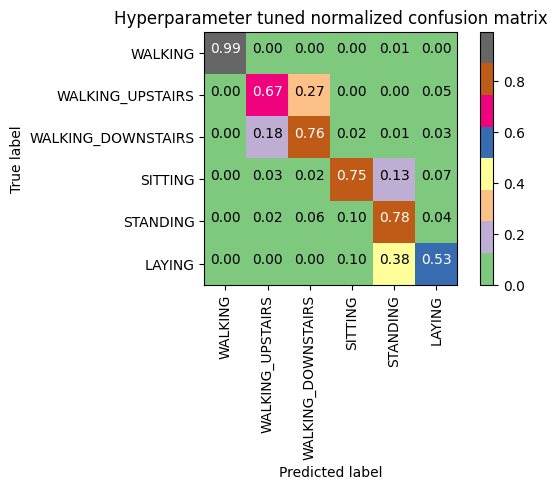

In [77]:
plot_confusion_matrix(cm, classes=labels, normalize=True, title='Hyperparameter tuned normalized confusion matrix', cmap = plt.cm.Accent)
plt.show()